<a href="https://colab.research.google.com/github/al-alamin/XGeoML/blob/main/AutoXGeoML.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Startup Codes

In [ ]:
%config Completer.use_jedi = False
# %load_ext autotime
import sys
from importlib import reload
%load_ext autoreload
%autoreload 2

sys.path.append(r'C:\Alamin\Dropbox\Codes')
sys.path.append(r'/home/mdabdullahal.alamin/alamin/Utility/')
sys.path.append(r"/content/drive/MyDrive/UofC/XGeoML/")
import Utility.utils as util
from Utility.basic_modules import *
PD = util.Pandas

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: UserWarning: Config option `use_jedi` not recognized by `IPCompleter`.
  """Entry point for launching an IPython kernel.
Traceback (most recent call last):
  File "/content/drive/MyDrive/UofC/XGeoML/Utility/basic_modules.py", line 28, in <module>
    import openai
ModuleNotFoundError: No module named 'openai'


Basic modules loaded successfully.


In [ ]:
from Utility.basic_modules import *

Basic modules loaded successfully.
time: 289 ms


Traceback (most recent call last):
  File "C:\Alamin\Dropbox\Codes\Utility\basic_modules.py", line 28, in <module>
    import openai
ModuleNotFoundError: No module named 'openai'


In [ ]:
## Uncomment and execute the codes in Google Colab environment
from google.colab import drive
drive.mount('/content/drive')
ROOT_DIR = r"/content/drive/MyDrive/UofC/XGeoML/"
%cd $ROOT_DIR

Mounted at /content/drive
/content/drive/MyDrive/UofC/XGeoML


# Helper methods

Common helper methods related to all the tasks such as ROP prediction, Vibration prediction can be found here.

**Pre-process**

In [ ]:
from sklearn.preprocessing import StandardScaler

def get_normalized_data(X_train, X_test, feature_columns):
    autoscaler = StandardScaler()
    autoscaler.fit(X_train)
    X_train[feature_columns] = autoscaler.transform(X_train[feature_columns])
    X_test[feature_columns] = autoscaler.transform(X_test[feature_columns])

    return X_train, X_test


from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_classification
from sklearn.metrics import mean_squared_error, r2_score

def get_train_test_set(df, feature_columns, train_stand, test_stand, pred_column="ROP"):
    df_data = df.copy(deep=True)
    # df_data.drop('Date_Time', axis = 1, inplace=True)
    df_data = df_data.fillna(0)

    df_train = df_data[df_data['Stand'].isin(train_stand)]
    df_test = df_data[df_data['Stand'].isin(test_stand)]
    print("Train size: %d and Test size: %d" % (len(df_train), len(df_test)))

    X_train = df_train[feature_columns]
    y_train = df_train[pred_column]
    X_test = df_test[feature_columns]
    y_test = df_test[pred_column]

    print(X_train.shape)
    print(X_test.shape)
    print(y_train.shape)
    print(y_test.shape)

    return X_train, X_test, y_train, y_test


def remove_small_stands(df, min_length=600):
    stands = df.groupby("Stand").size().tolist()
    stands_chosen = []
    for ind, size in enumerate(stands):
        stand_num = ind+1
        # print(stand_num, size)
        if(size > min_length):
            stands_chosen.append(stand_num)
    # print(stands_chosen)
    df_modified = df[df['Stand'].isin(stands_chosen)]
    # print(len(df), len(df_modified))
    # print(stands)
    return df_modified, stands_chosen

**Model**

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_classification

def get_prediction_LR(X_train, y_train, X_test):
    # creating an object of LinearRegression class
    LR = LinearRegression(normalize=True)
    # fitting the training data
    LR.fit(X_train, y_train)
    # print("Print Linear regression score: %0.2f" % LR.score(X_train, y_train))
    y_pred = LR.predict(X_test)
    return y_pred, LR


def get_prediction_RF(X_train, y_train, X_test, num_trees=100):
    clf = RandomForestRegressor(num_trees)
    clf.fit(X_train, y_train)
    # RandomForestClassifier(...)
    y_pred = clf.predict(X_test)
    return y_pred, clf

def get_prediction_SVM(X_train, y_train, X_test):
    regressor = SVR(kernel = 'rbf')
    regressor.fit(X_train, y_train)
    y_test = regressor.predict(X_test)
    return y_test, regressor

**Visualization**

All the common methods related to data visualization is kept here

In [ ]:
def plot_prediction(y_true, y_pred, title):
    y_pred = y_pred.clip(min=0)
    ax = plt.figure(figsize=(20, 5)) # 10 is width, 7 is height
    plt.plot(y_pred,  label='Prediction') 
    # plt.plot([1,2,3,4,5], [2,3,4,5,11],
    plt.plot(y_true,  label='Original Value')  # green dots
    plt.legend(loc='best')
    plt.title(title)
    plt.show()

def plot_original_and_smooth_graph(y_true, y_pred_LR, y_pred_RF, title, figsize = (22, 8)):    
    df = pd.DataFrame()
    df["RF prediction"] = get_smooth_data(y_pred_RF, N=10)
    df["LR prediction"] = get_smooth_data(y_pred_LR, N=10)
    df['Original'] = y_true
    df.plot(figsize=figsize, title=title)
    plt.show()

def get_smooth_data(data, N):
    ret = np.cumsum(data, dtype=float)
    ret[N:] = ret[N:] - ret[:-N]
    ret_avg =  ret[N - 1:] / N
    ret = np.concatenate([data[:N-1], ret_avg])
    assert len(data) == len(ret)
    return ret

### Plotly

In [ ]:
from numpy import random

In [ ]:
print(random.randint(-2, 2, size=10))

[ 1 -2 -1 -2 -2 -1 -2  0 -1 -1]


[None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, 51, 52, 53, 52, 51, 54, 51, 52, 52, 51, 50, 53, 52, 54, 50, 54, 50, 51, 50, 52]


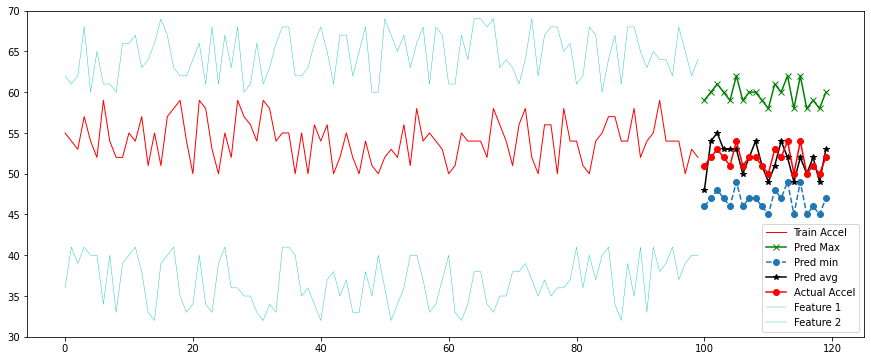

In [ ]:
train_data = 50 + random.randint(10, size=100)
pred_true = 50 + random.randint(5, size=20)
pred_avg = pred_true + random.randint(-3, 3, size=20)
pred_max = pred_true + 8
pred_min = pred_true - 5
# print(pred_true, pred_max)

f1 = list(32 + random.randint(10, size=100))
f2 = list(60 + random.randint(10, size=100))

# def plot_seq_prediction(train_data, pred_true, pred_avg, pred_max, pred_min):
delim = [None] * (len(train_data))
pred_true =  delim + list(pred_true)
pred_max = delim + list(pred_max)
pred_min = delim + list(pred_min)
pred_avg = delim + list(pred_avg)
print(pred_true)

fig = plt.figure(figsize=(15, 6)) # 10 is width, 7 is height
ax = fig.gca()
plt.plot(train_data, "r", label="Train Accel", linewidth=1)
plt.plot(pred_max, "gx-", label="Pred Max")
plt.plot(pred_min, "o--", label="Pred min")
plt.plot(pred_avg, "k*-", label="Pred avg")
plt.plot(pred_true, "ro-", label="Actual Accel")

plt.plot(f1, "c", label="Feature 1", linewidth=.4)
plt.plot(f2, "c", label="Feature 2", linewidth=.4)

ax.set_ylim((30, 70))
plt.legend(loc="best")
plt.show()

# plot_seq_prediction(train_data, pred_true, pred_avg, pred_max, pred_min)

In [ ]:
a = np.arange(100)
b = np.array([None, None, 50, 60, 70])
c = np.concatenate((a,b))
# print(a + b)
print(c)

[0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51
 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75
 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99
 None None 50 60 70]


In [ ]:
# !pip install jupyter-dash

In [ ]:
# %matplotlib inline
# import matplotlib.pylab as plt
# import plotly.express as px
# import dash_core_components as dcc
# import warnings
# warnings.filterwarnings('ignore')
# plt.rcParams['figure.figsize'] = [7, 4]
# plt.rcParams['figure.dpi'] = 100 # 200 e.g. is really fine, but slower

# def show_figures(figures, columns):
#   figures_traces = []
#   for i in range(len(figures)):
#     figure = figures[i]
#     figures_traces.append([])
#     for trace in range(len(figure["data"])):
#       figures_traces[i].append(figure["data"][trace])

#   #Create a 1x2 subplot
#   from plotly.subplots import make_subplots
#   this_figure = make_subplots(rows=(len(figures)), cols=1, shared_xaxes=True, x_title="Time") 
#   # Get the Express fig broken down as traces and add the traces to the proper plot within in the subplot
#   for i in range(len(figures_traces)):
#     figure_traces = figures_traces[i]
#     for traces in figure_traces:
#       this_figure.append_trace(traces, row=i+1, col=1)
#     this_figure.update_yaxes(title_text=columns[i], row=i+1, col=1)

#   #the subplot as shown in the above image
#   this_figure.update_layout(
#     autosize=False,
#     width=1000, 
#     height=200*len(figures),)
#   final_graph = dcc.Graph(figure=this_figure)
#   final_graph.figure.show()


# def plot_well_data(df, columns):
#   try:
#     x = df.Date_Time 
#   except:
#     x = df.index
#   figs = []
#   for column in columns:
#     figs.append(px.line(df, x=x, y=column))
#   show_figures(figs, columns)

# import pandas as pd
# df = pd.DataFrame()
# df["ROP"] = [1, 2, 3, 4, 2, 4]
# # df.head()
# plot_well_data(df, ["ROP"])

In [ ]:
# import plotly.express as px
# from jupyter_dash import JupyterDash
# import dash_core_components as dcc
# import dash_html_components as html
# from dash.dependencies import Input, Output
# # Load Data
# df = px.data.tips()
# # Build App
# app = JupyterDash(__name__)
# app.layout = html.Div([
#     html.H1("JupyterDash Demo"),
#     dcc.Graph(id='graph'),
#     html.Label([
#         "colorscale",
#         dcc.Dropdown(
#             id='colorscale-dropdown', clearable=False,
#             value='plasma', options=[
#                 {'label': c, 'value': c}
#                 for c in px.colors.named_colorscales()
#             ])
#     ]),
# ])
# # Define callback to update graph
# @app.callback(
#     Output('graph', 'figure'),
#     [Input("colorscale-dropdown", "value")]
# )
# def update_figure(colorscale):
#     return px.scatter(
#         df, x="total_bill", y="tip", color="size",
#         color_continuous_scale=colorscale,
#         render_mode="webgl", title="Tips"
#     )
# # Run app and display result inline in the notebook
# app.run_server(mode='inline')

# Task: Data Exploration

Data exploration related experiments on different dataset is conducted here

## Helper Methods

Helper methods related to data exploration is organized here

## Catoosa

Data visualization related to Catoosa Dataset can be found here

In [ ]:
data_file = r"C:\Alamin\courses\XGeoML\XGeoML\dataset\catoosa\catoosa_surface_downhole_run_15_to_19_computed_rundepth.csv"
df_org = pd.read_csv(data_file, dtype={'Stand': int})
print(len(df_org))

73627
time: 415 ms


In [ ]:
file = r"C:\Alamin\courses\XGeoML\XGeoML\dataset\processed\BHA18WellData_Filtered_withStand.csv"
df_org =  get_org_dataset(file)

### Data visualize

In [ ]:
df_org.set_index('Date_Time')["ROP"].plot(title="Original dataset ROP over time", rot=90)

In [ ]:
pd.DataFrame(y_true).plot(title="Test dataset ROP")

### Forge dataset

Data exploration related to forge dataset are experimented here. Future tasks

# Task: ROP Prediction

All the codes related to ROP prediction is organized here

In [ ]:
BASE_dir = r"C:\Alamin\courses\XGeoML\XGeoML"

time: 1e+03 µs


## Helper Methods

In [ ]:
def calculate_MSE(torque, rpm, wob, rop, D=8.5):
    mse = (480.0 * torque * rpm) / (rop * D**2) + 1.274 * wob / D**2
    return mse

def calculate_MSE_approx(torque, rpm, wob, D=8.5):
    mse = (480.0 * torque * rpm) / (D**2) + 1.274 * wob / D**2
    return mse

def calculate_bit_sharpness(torque, wob, D=8.5):
    return 36.0 * torque / (wob * D)


def add_MSE(df_data):
    df = df_data.copy(deep=True)
    values = []
    values2 = []
    new_col_name = "MSE"
    new_col_name2 = "MSE_approx"
    for index, row in df.iterrows():
        torque = row['Torque']
        rpm = row['RPM']
        wob = row['Weight_on_Bit']
        rop = row['ROP']
        mse = calculate_MSE(torque, rpm, wob, rop)
        mse2 = calculate_MSE_approx(torque, rpm, wob)
        values.append(mse)
        values2.append(mse2)
    if(new_col_name in df.columns):
      print("========> %s alreay exists need to drop it" % (new_col_name))
      df = df.drop(columns=new_col_name, axis = 1)
    if(new_col_name2 in df.columns):
      print("========> %s alreay exists need to drop it" % (new_col_name))
      df = df.drop(columns=new_col_name2, axis = 1)
    df[new_col_name] = values
    df[new_col_name2] = values2
    return df

def add_bit_sharpness(df_data):
    df = df_data.copy(deep=True)
    values = []
    new_col_name = "Bit_sharpness"
    for index, row in df.iterrows():
        torque = row['Torque']
        wob = row['Weight_on_Bit']
        val = calculate_bit_sharpness(torque, wob)
        values.append(val)
    if(new_col_name in df.columns):
      print("========> %s alreay exists need to drop it" % (new_col_name))
      df = df.drop(columns=new_col_name, axis = 1)
    df[new_col_name] = values
    return df

In [ ]:
def visualize_feature(dataset, stands, feature):
    for stand in stands:   
        df = dataset[dataset['Stand'] == stand][[feature]]
        title = "Stand: %d and #rows: %d" % (stand, len(df))
        df.plot(figsize=(20, 5), title=title)
        plt.show()
        print(stand)

def visualize_two_features(datset, stands, columns):
    for stand in stands:
        df = datset[datset['Stand'] == (stand)][columns]
        title = "Stand: %d and #rows: %d" % (stand, len(df))

        fig, ax = plt.subplots()
        ax2 = ax.twinx()

        fig.set_size_inches(15, 4)
        # ax3 = ax.twinx()

        ax.plot(df[columns[0]], color='red', label=columns[0])
        ax2.plot(df[columns[1]], color='blue', label=columns[1])
        # ax3.plot(df["Standpipe_Pressure"], color='green', label="ROP")
        
        fig.suptitle(title)

        lines, labels = ax.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        print(lines, lines2)
        print(labels, labels2)
        ax2.legend(lines + lines2, labels + labels2, loc="best")

        plt.show()
        
        print(stand)

def visualize_two_features(dataset, columns):

        df = dataset[dataset['Stand'] == (stand)][columns]
        title = "Stand: %d and #rows: %d" % (stand, len(df))

        fig, ax = plt.subplots()
        ax2 = ax.twinx()

        fig.set_size_inches(15, 4)
        # ax3 = ax.twinx()

        ax.plot(df[columns[0]], color='red', label=columns[0])
        ax2.plot(df[columns[1]], color='blue', label=columns[1])
        # ax3.plot(df["Standpipe_Pressure"], color='green', label="ROP")
        
        fig.suptitle(title)

        lines, labels = ax.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        print(lines, lines2)
        print(labels, labels2)
        ax2.legend(lines + lines2, labels + labels2, loc="best")

        plt.show()
        


## Load Dataset


### Catoosa

In [ ]:
catosa_without_stand_file = r"C:\Alamin\courses\XGeoML\XGeoML\dataset\Catoosa\catoosa_thunderbird_5_imperialwelldata_filtered_columns.csv"
catosa_stand_file = r"C:\Alamin\courses\XGeoML\XGeoML\dataset\Catoosa\catoosa_thunderbird_5_imperialwelldata_filtered_with_stand.csv"

catosa_without_stand_file = r"C:\Alamin\courses\XGeoML\XGeoML\dataset\Catoosa\catoosa_thunderbird_5_imperialwelldata_filtered_columns.csv"
catosa_stand_file = r"C:\Alamin\courses\XGeoML\XGeoML\dataset\Catoosa\catoosa_thunderbird_5_imperialwelldata_filtered_with_stand_15to19.csv"

df_catoosa_without_stand = pd.read_csv(catosa_without_stand_file)
df_catosa_stand = pd.read_csv(catosa_stand_file)

print(len(df_catoosa_without_stand))
print(len(df_catosa_stand))

3859276
73627
time: 6.67 s


In [ ]:
df_catosa_stand.head()

In [ ]:

df_dataset = add_MSE(df_catosa_stand)
df_dataset = add_bit_sharpness(df_dataset)
df_dataset.head()


#### Stand overview

In [ ]:
df_dataset.groupby("Stand").size()

Stand
1.0      415
2.0      528
3.0        3
4.0     6843
5.0       68
6.0     3405
7.0     1491
8.0       68
9.0     6307
10.0       3
11.0    7124
12.0     538
13.0    5801
14.0    9812
15.0    2942
16.0    2724
17.0    1694
18.0    3455
19.0    6894
20.0    5981
21.0    1220
22.0       3
23.0    3732
24.0    2576
dtype: int64

time: 9.99 ms


In [ ]:
df_dataset, dataset_stands = remove_small_stands(df_dataset)
print(len(stands))
df_dataset.groupby("Stand").size()

16


Stand
4.0     6843
6.0     3405
7.0     1491
9.0     6307
11.0    7124
13.0    5801
14.0    9812
15.0    2942
16.0    2724
17.0    1694
18.0    3455
19.0    6894
20.0    5981
21.0    1220
23.0    3732
24.0    2576
dtype: int64

time: 37 ms


In [ ]:
filename = os.path.join("Catoosa_with_additional_features.csv")
util.save_df(df_dataset, BASE_dir, filename)

time: 1.42 s


#### Stand visualization

In [ ]:
# for stand in range(24):    
#     df = df_catosa_stand[df_catosa_stand['Stand'] == (stand+1)][['ROP']]
#     title = "Stand: %d and #rows: %d" % (stand+1, len(df))
#     df.plot(figsize=(20, 5), title=title)
#     plt.show()
#     print(stand)

#### ROP vs Torque per stand

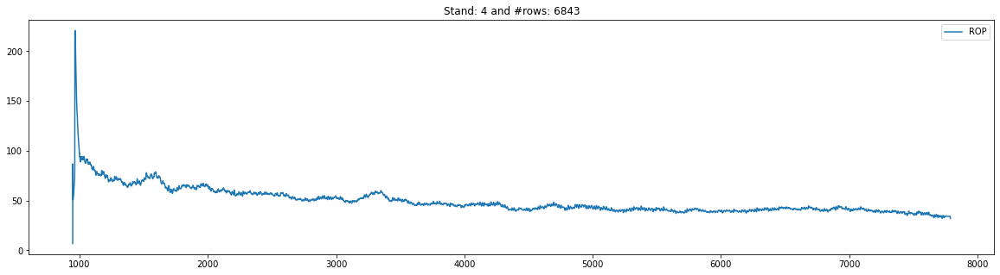

4


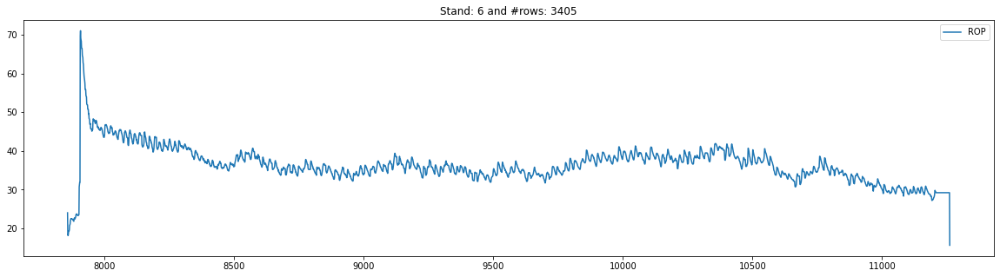

6


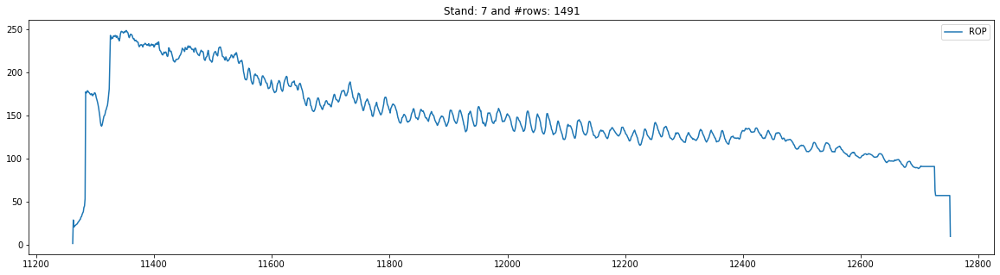

7


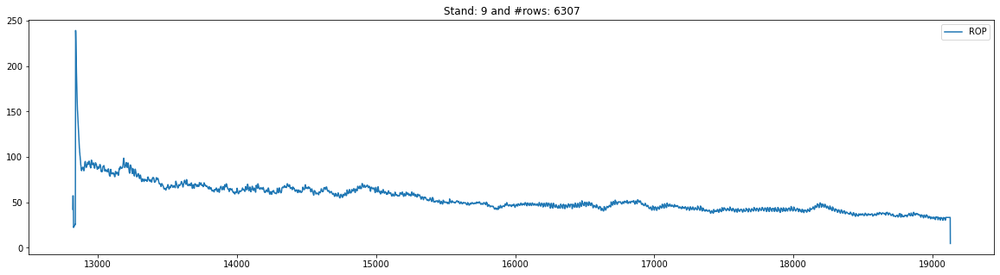

9


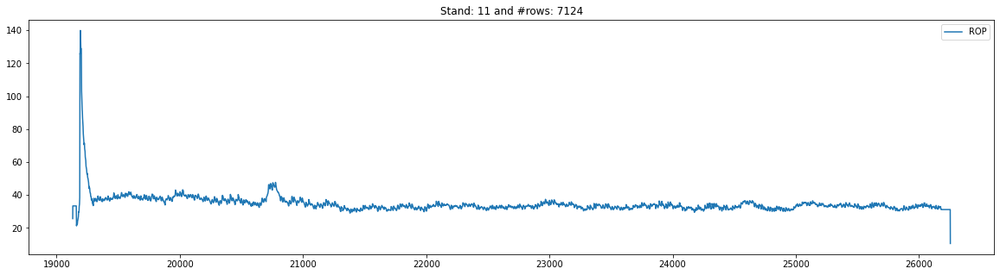

11


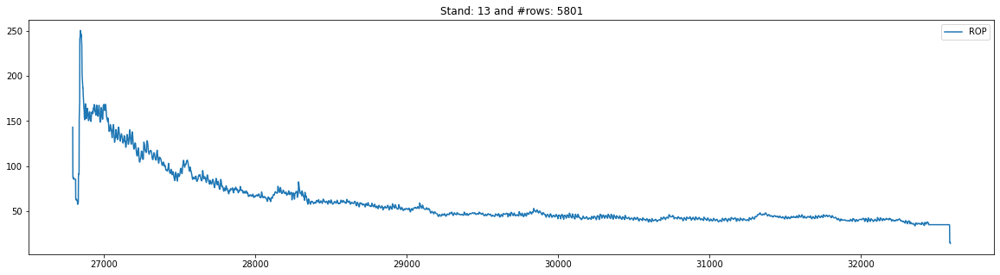

13


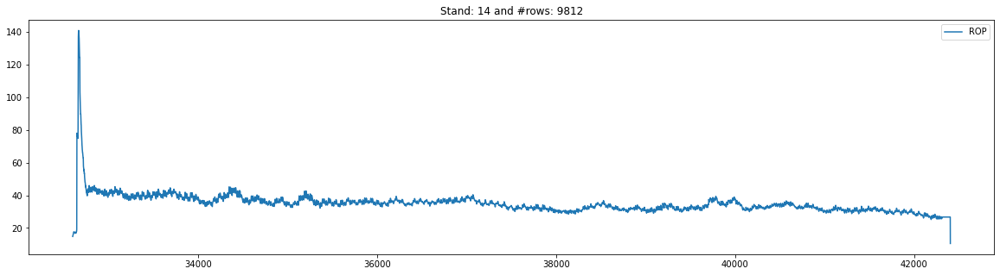

14


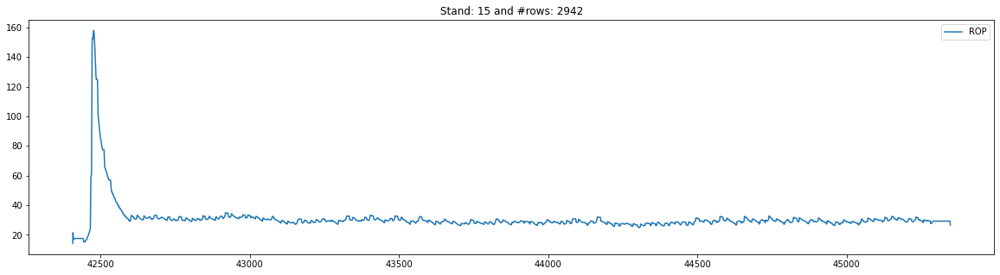

15


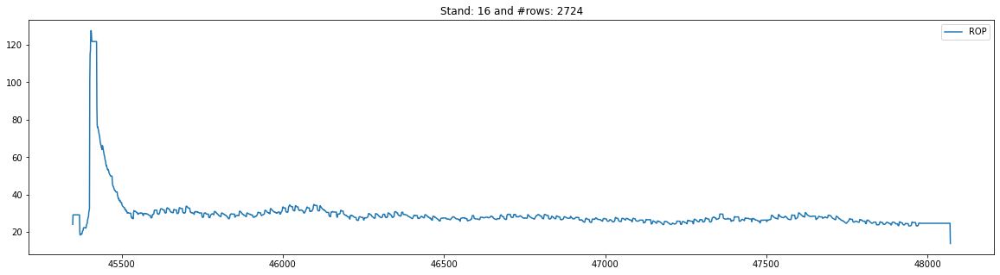

16


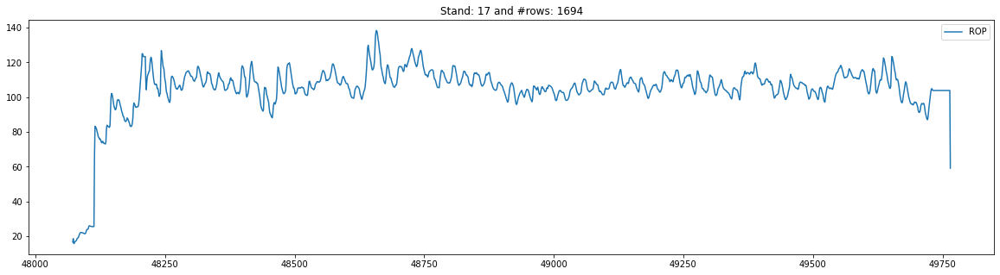

17


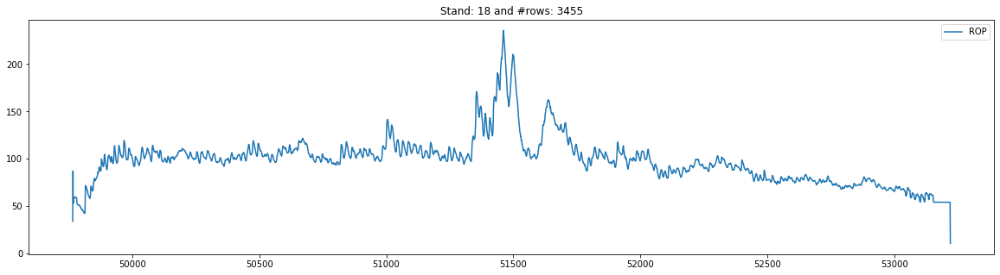

18


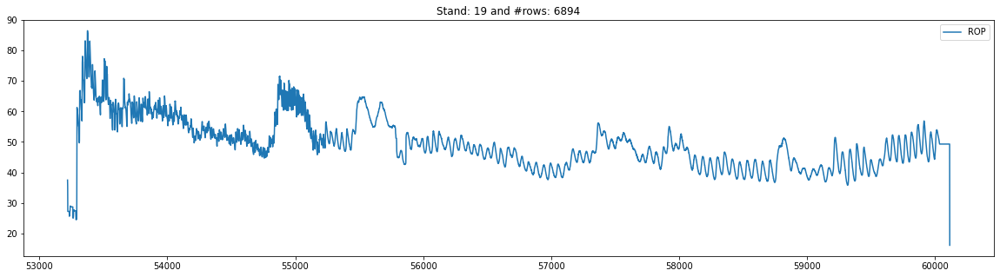

19


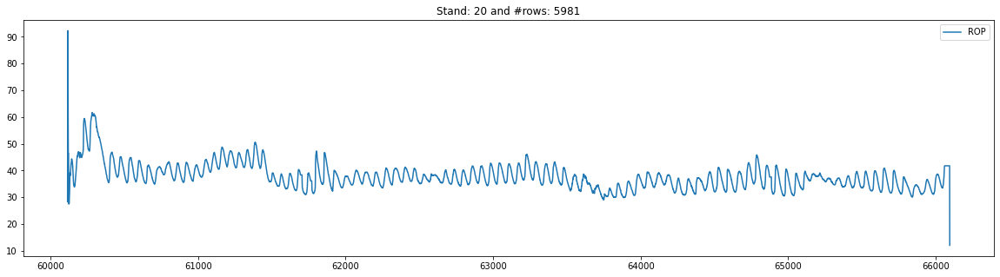

20


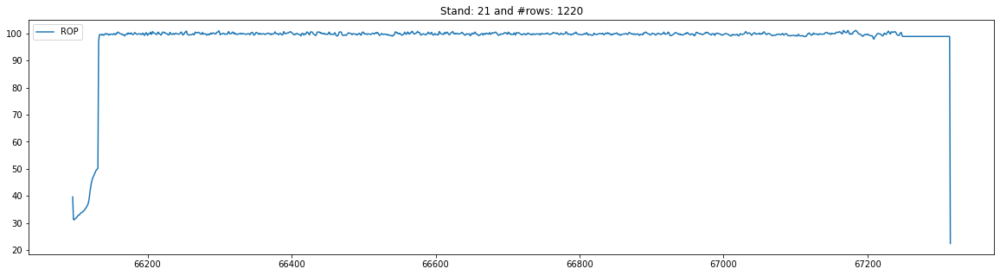

21


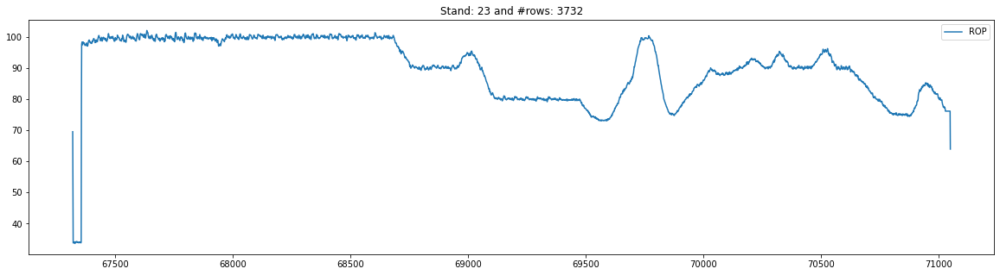

23


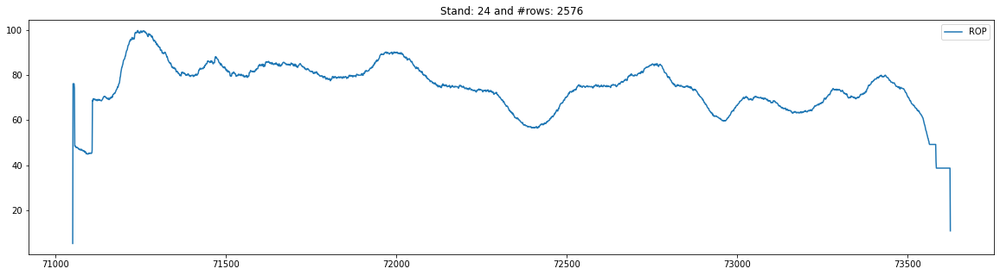

24
time: 3.2 s


In [ ]:
visualize_feature(df_dataset, dataset_stands, "ROP")

[<matplotlib.lines.Line2D object at 0x000001F2433ABD90>] [<matplotlib.lines.Line2D object at 0x000001F24448A100>]
['ROP'] ['Torque']


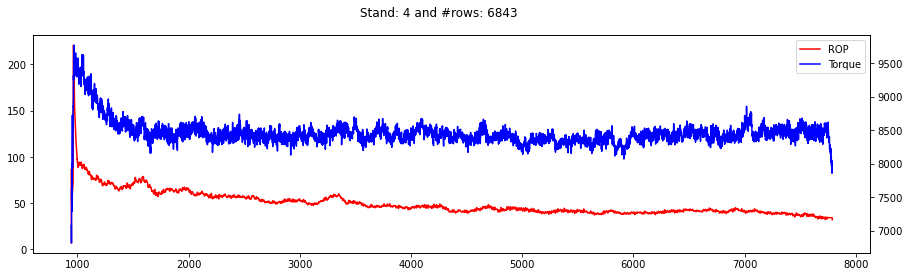

4
[<matplotlib.lines.Line2D object at 0x000001F243F23EE0>] [<matplotlib.lines.Line2D object at 0x000001F2430B8700>]
['ROP'] ['Torque']


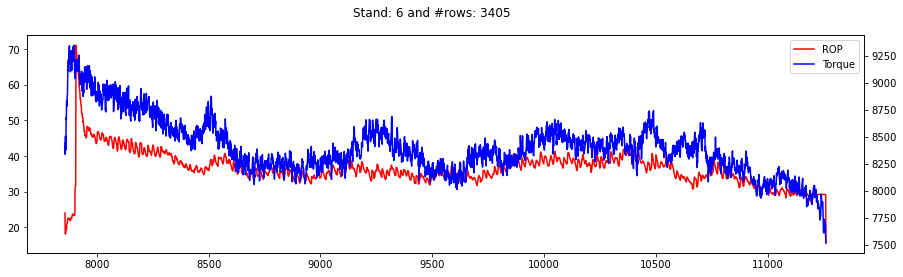

6
[<matplotlib.lines.Line2D object at 0x000001F243834100>] [<matplotlib.lines.Line2D object at 0x000001F243834460>]
['ROP'] ['Torque']


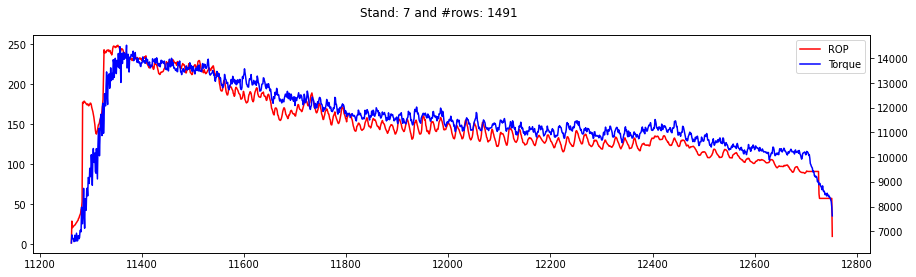

7
[<matplotlib.lines.Line2D object at 0x000001F24441E1C0>] [<matplotlib.lines.Line2D object at 0x000001F243F31040>]
['ROP'] ['Torque']


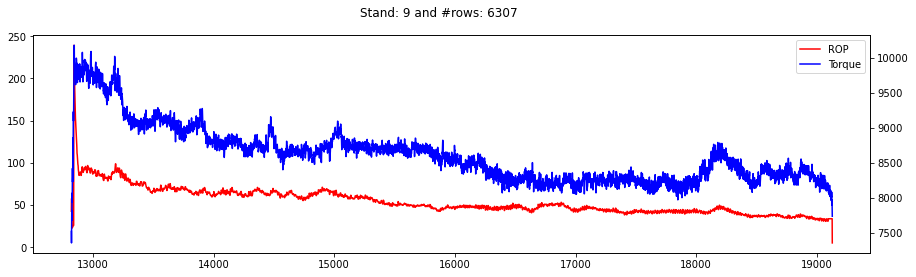

9
[<matplotlib.lines.Line2D object at 0x000001F243498220>] [<matplotlib.lines.Line2D object at 0x000001F243498580>]
['ROP'] ['Torque']


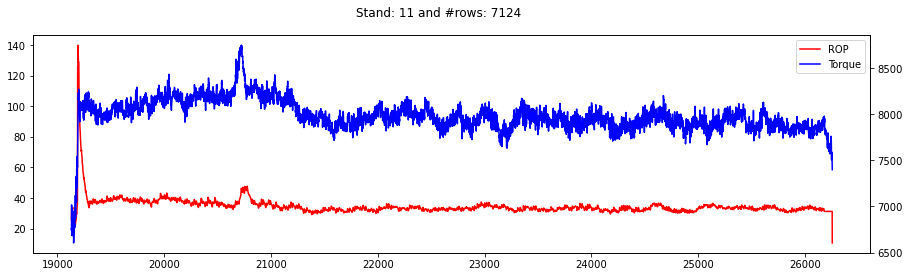

11
[<matplotlib.lines.Line2D object at 0x000001F243FB8CA0>] [<matplotlib.lines.Line2D object at 0x000001F243FC6040>]
['ROP'] ['Torque']


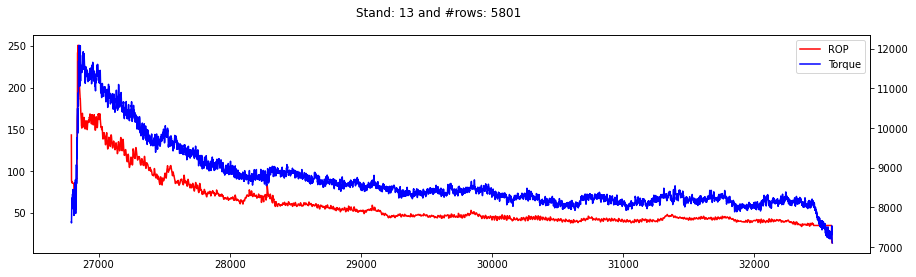

13
[<matplotlib.lines.Line2D object at 0x000001F2434B0820>] [<matplotlib.lines.Line2D object at 0x000001F2434B0DC0>]
['ROP'] ['Torque']


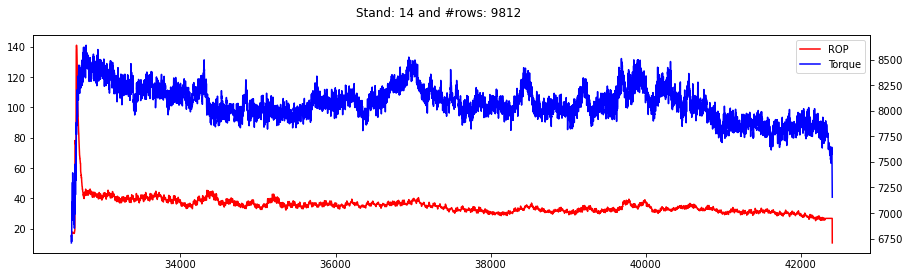

14
[<matplotlib.lines.Line2D object at 0x000001F24381FDC0>] [<matplotlib.lines.Line2D object at 0x000001F2441202E0>]
['ROP'] ['Torque']


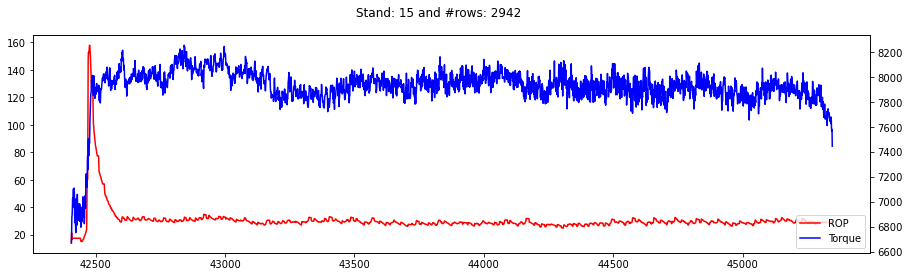

15
[<matplotlib.lines.Line2D object at 0x000001F2433AB3A0>] [<matplotlib.lines.Line2D object at 0x000001F2444C2430>]
['ROP'] ['Torque']


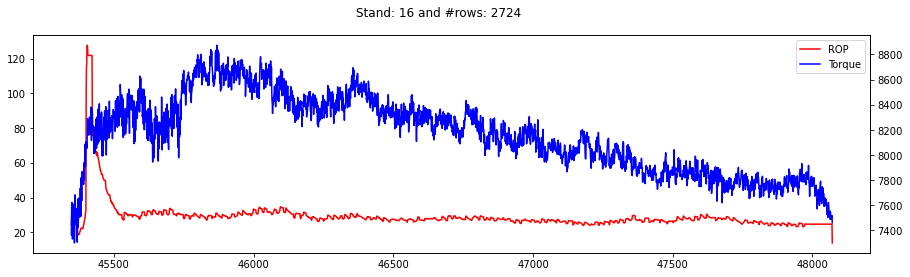

16
[<matplotlib.lines.Line2D object at 0x000001F24340A820>] [<matplotlib.lines.Line2D object at 0x000001F2434AD2E0>]
['ROP'] ['Torque']


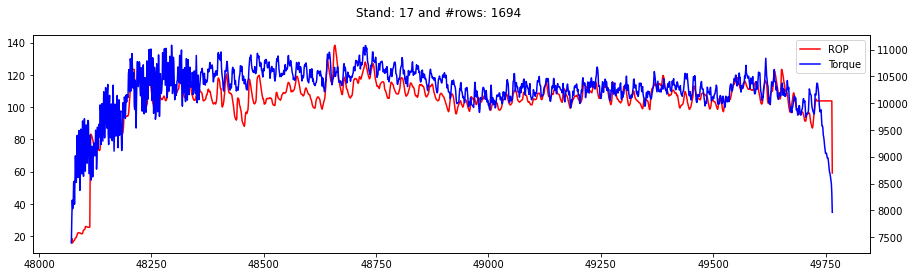

17
[<matplotlib.lines.Line2D object at 0x000001F244371E80>] [<matplotlib.lines.Line2D object at 0x000001F244449A00>]
['ROP'] ['Torque']


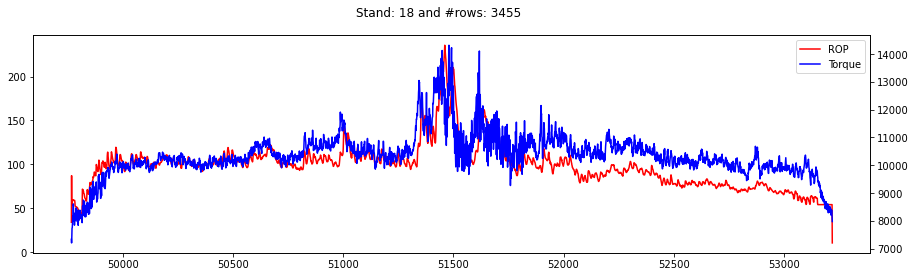

18
[<matplotlib.lines.Line2D object at 0x000001F24449C700>] [<matplotlib.lines.Line2D object at 0x000001F24449CA60>]
['ROP'] ['Torque']


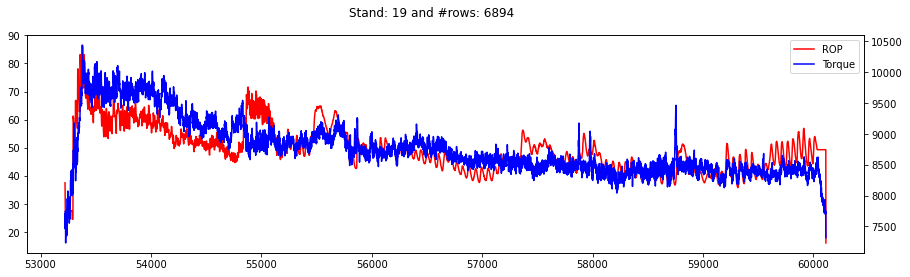

19
[<matplotlib.lines.Line2D object at 0x000001F243F0D340>] [<matplotlib.lines.Line2D object at 0x000001F243F2E190>]
['ROP'] ['Torque']


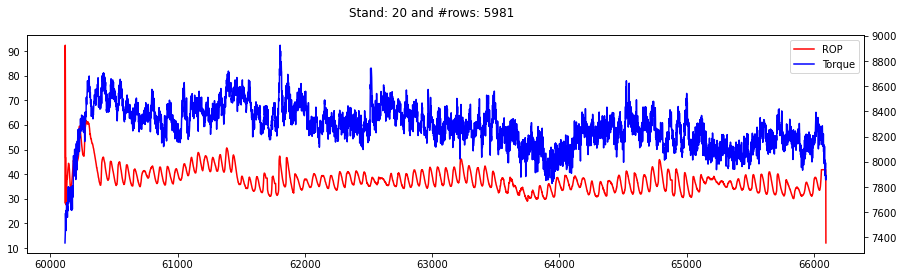

20
[<matplotlib.lines.Line2D object at 0x000001F244496610>] [<matplotlib.lines.Line2D object at 0x000001F244496A30>]
['ROP'] ['Torque']


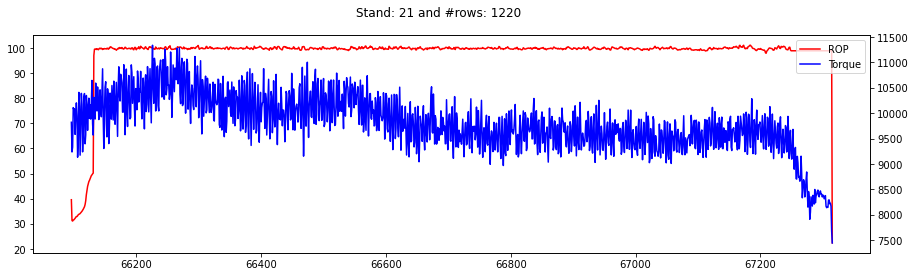

21
[<matplotlib.lines.Line2D object at 0x000001F24456BAC0>] [<matplotlib.lines.Line2D object at 0x000001F26B6A2910>]
['ROP'] ['Torque']


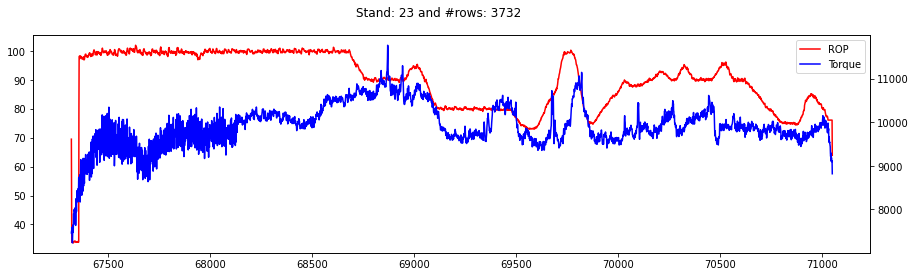

23
[<matplotlib.lines.Line2D object at 0x000001F244507310>] [<matplotlib.lines.Line2D object at 0x000001F2434ADEE0>]
['ROP'] ['Torque']


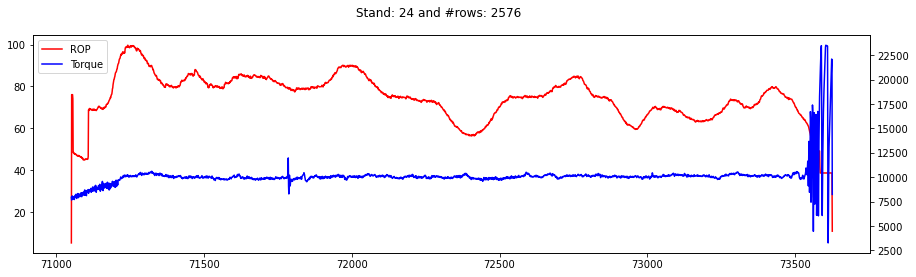

24
time: 4.93 s


In [ ]:
visualize_two_features (df_dataset, dataset_stands, columns = ['ROP', 'Torque'])

#### ROP vs Weight on bits

[<matplotlib.lines.Line2D object at 0x000001F2443A0E80>] [<matplotlib.lines.Line2D object at 0x000001F24380AF70>]
['ROP'] ['Weight_on_Bit']


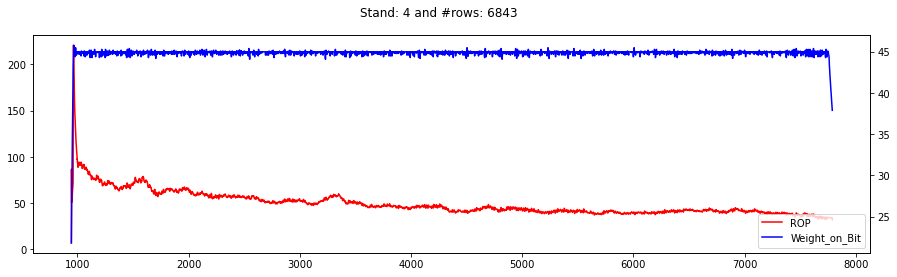

4
[<matplotlib.lines.Line2D object at 0x000001F2433FF5B0>] [<matplotlib.lines.Line2D object at 0x000001F2433FF910>]
['ROP'] ['Weight_on_Bit']


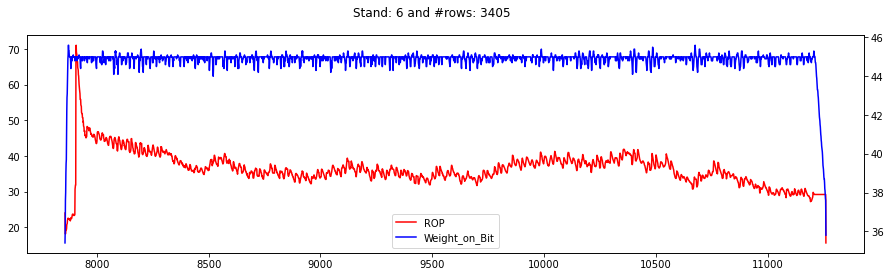

6
[<matplotlib.lines.Line2D object at 0x000001F26B69D5E0>] [<matplotlib.lines.Line2D object at 0x000001F26B69D940>]
['ROP'] ['Weight_on_Bit']


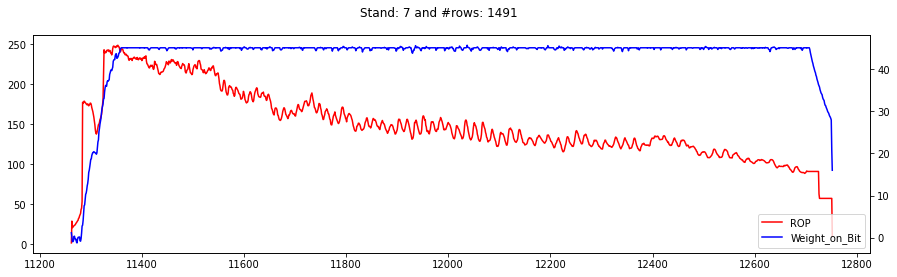

7
[<matplotlib.lines.Line2D object at 0x000001F244361520>] [<matplotlib.lines.Line2D object at 0x000001F244361880>]
['ROP'] ['Weight_on_Bit']


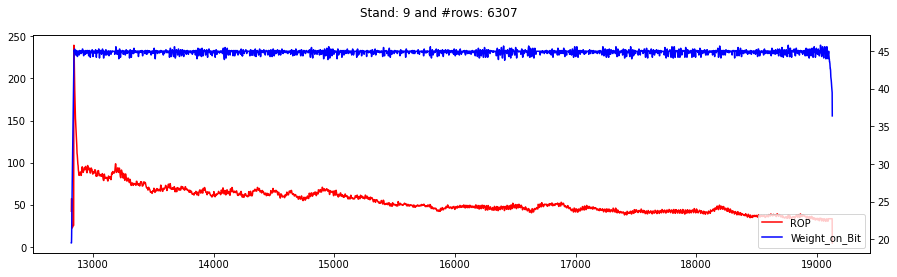

9
[<matplotlib.lines.Line2D object at 0x000001F24415A550>] [<matplotlib.lines.Line2D object at 0x000001F24415A8B0>]
['ROP'] ['Weight_on_Bit']


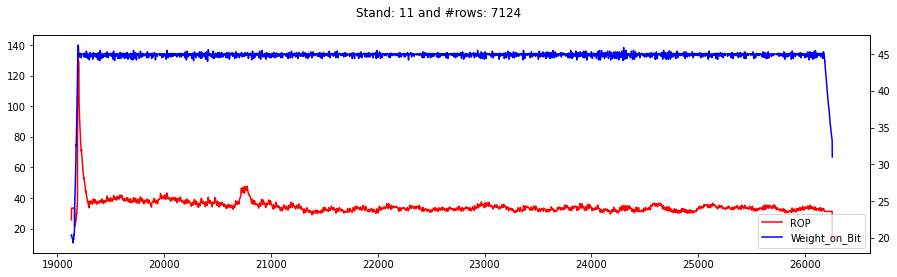

11
[<matplotlib.lines.Line2D object at 0x000001F2436825E0>] [<matplotlib.lines.Line2D object at 0x000001F24366B430>]
['ROP'] ['Weight_on_Bit']


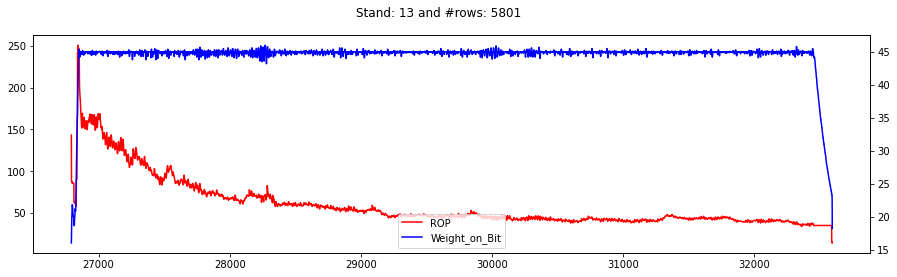

13
[<matplotlib.lines.Line2D object at 0x000001F243569D60>] [<matplotlib.lines.Line2D object at 0x000001F243569940>]
['ROP'] ['Weight_on_Bit']


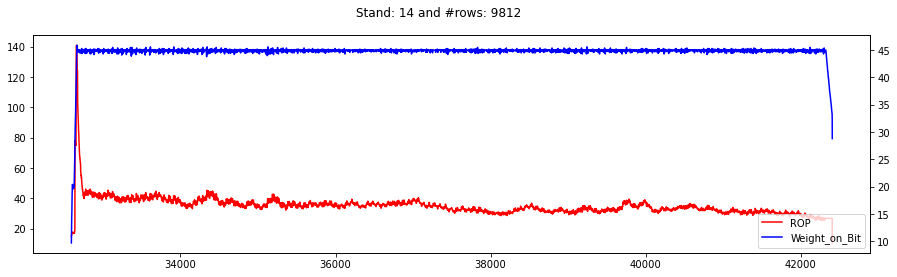

14
[<matplotlib.lines.Line2D object at 0x000001F24442AFA0>] [<matplotlib.lines.Line2D object at 0x000001F24442A6A0>]
['ROP'] ['Weight_on_Bit']


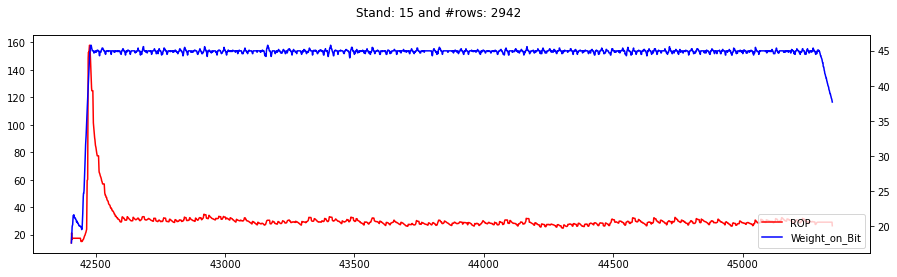

15
[<matplotlib.lines.Line2D object at 0x000001F24337D460>] [<matplotlib.lines.Line2D object at 0x000001F24337DD90>]
['ROP'] ['Weight_on_Bit']


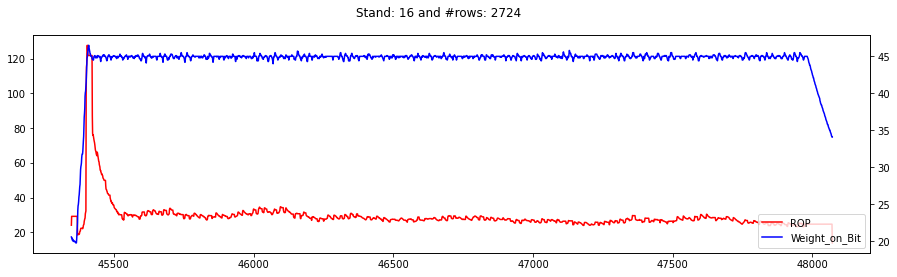

16
[<matplotlib.lines.Line2D object at 0x000001F2445074C0>] [<matplotlib.lines.Line2D object at 0x000001F2445078B0>]
['ROP'] ['Weight_on_Bit']


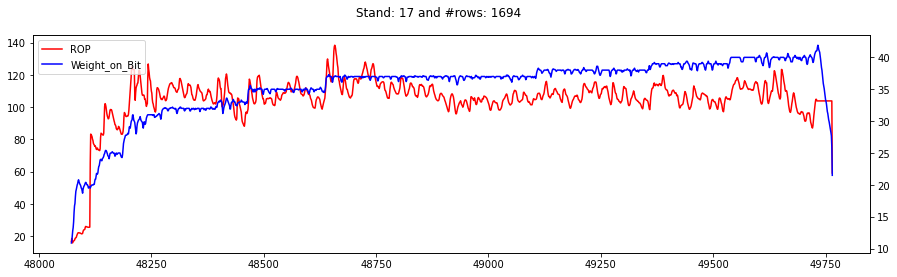

17
[<matplotlib.lines.Line2D object at 0x000001F2434E2250>] [<matplotlib.lines.Line2D object at 0x000001F24438E580>]
['ROP'] ['Weight_on_Bit']


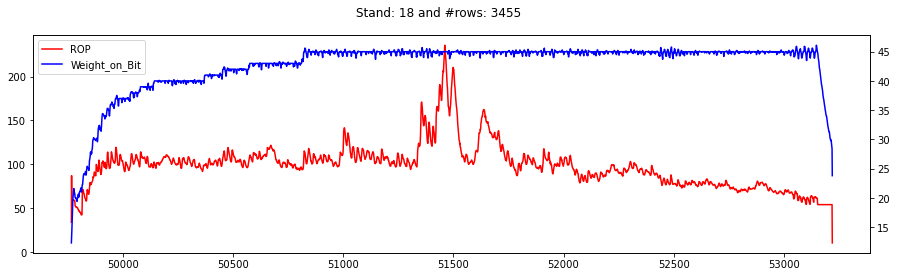

18
[<matplotlib.lines.Line2D object at 0x000001F24385C460>] [<matplotlib.lines.Line2D object at 0x000001F24385C7C0>]
['ROP'] ['Weight_on_Bit']


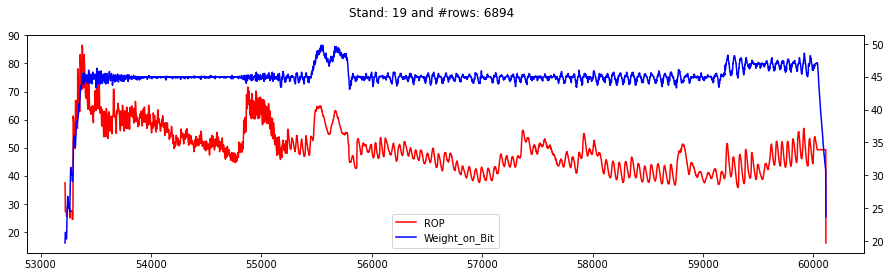

19
[<matplotlib.lines.Line2D object at 0x000001F243EFB0A0>] [<matplotlib.lines.Line2D object at 0x000001F243F04EB0>]
['ROP'] ['Weight_on_Bit']


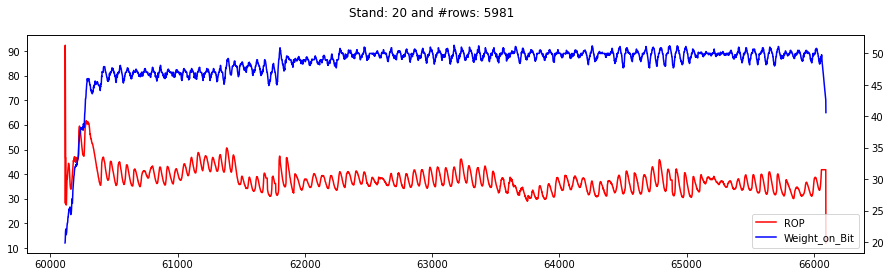

20
[<matplotlib.lines.Line2D object at 0x000001F2444F2850>] [<matplotlib.lines.Line2D object at 0x000001F2444E06A0>]
['ROP'] ['Weight_on_Bit']


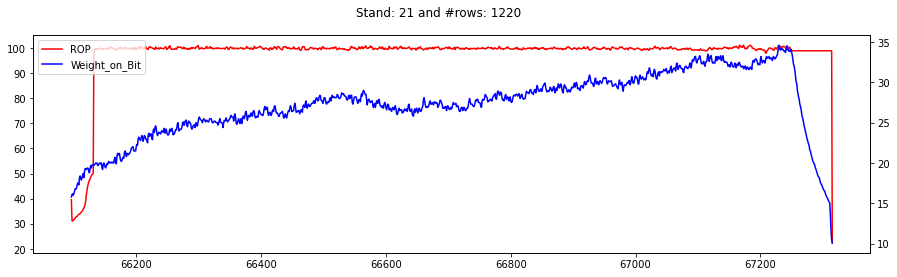

21
[<matplotlib.lines.Line2D object at 0x000001F244457610>] [<matplotlib.lines.Line2D object at 0x000001F244457220>]
['ROP'] ['Weight_on_Bit']


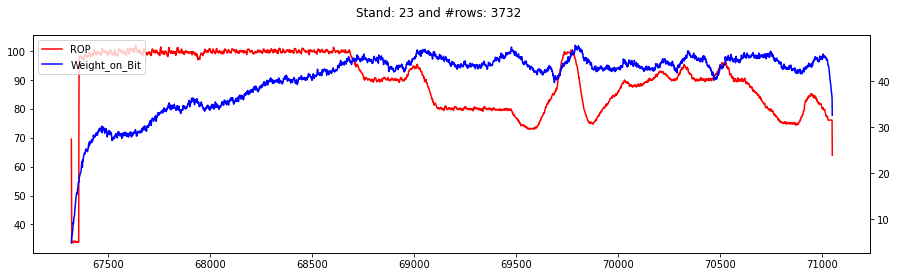

23
[<matplotlib.lines.Line2D object at 0x000001F2433CA100>] [<matplotlib.lines.Line2D object at 0x000001F2433CACA0>]
['ROP'] ['Weight_on_Bit']


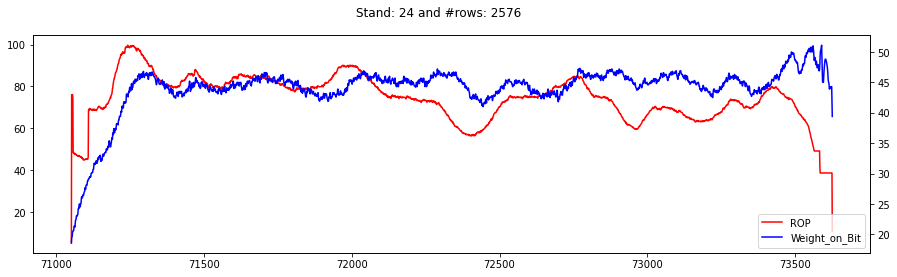

24
time: 4.78 s


In [ ]:
visualize_two_features (df_dataset, dataset_stands, columns = ['ROP', 'Weight_on_Bit'])

In [ ]:
visualize_two_features (df_dataset, dataset_stands, columns = ['ROP', 'Bit_sharpness'])

## Model

In [ ]:
print(dataset_stands)
all_feature_columns = ['Bit_Depth', 'Hole_Depth', 'Block_Height', 'Hook_Load',
    'Standpipe_Pressure', 'Torque', 'Weight_on_Bit', 'RPM', 'Total_Pump_Output']
selected_feature_columns = ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque',  'RPM', 'Total_Pump_Output']

In [ ]:
def overall_training_and_predict_pipelined(dataset, feature_columns, train_stand,\
                                           test_stand, model_save_name, pred_column="ROP", save_model=True):

    X_train, X_test, y_train, y_test = get_train_test_set(df_dataset, feature_columns,\
                                                          train_stand=train_stand, test_stand=test_stand, pred_column=pred_column)
    X_train, X_test = get_normalized_data(X_train, X_test, feature_columns)

    y_pred_RF, model_RF = get_prediction_RF(X_train, y_train, X_test)
    y_pred_LR, model_LR = get_prediction_LR(X_train, y_train, X_test)
    y_true = y_test.tolist()


    title="ML Prediction: %s\n Train_strands: %s\n Test_strands: %s\n Features: %s\n"\
     % ("Random Forrest (RF) and Linear Regression (RL)", train_stand, test_stand, feature_columns)
    print(title)

    plot_original_and_smooth_graph(y_true, y_pred_LR, y_pred_RF, title, figsize=(15, 5))


    if(save_model):
        util.save_obj(model_LR, BASE_dir, model_save_name + "_LR")
        util.save_obj(model_RF, BASE_dir, model_save_name + "_RF" )


# model_save_name = "trial_1"
# train_stand = [4, 6, 7, 9, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23]
# test_stand = [24]
# overall_training_and_predict_pipelined(df_dataset, selected_feature_columns, train_stand, test_stand, model_save_name)

time: 3 ms


#### High performing prediction

**Trial 1**

Train size: 68546 and Test size: 3455
(68546, 5)
(3455, 5)
(68546,)
(3455,)
Print Linear regression score: 0.80
ML Prediction: Random Forrest (RF) and Linear Regression (RL)
 Train_strands: [4, 6, 7, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 23, 24]
 Test_strands: [18]
 Features: ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque', 'RPM', 'Total_Pump_Output']



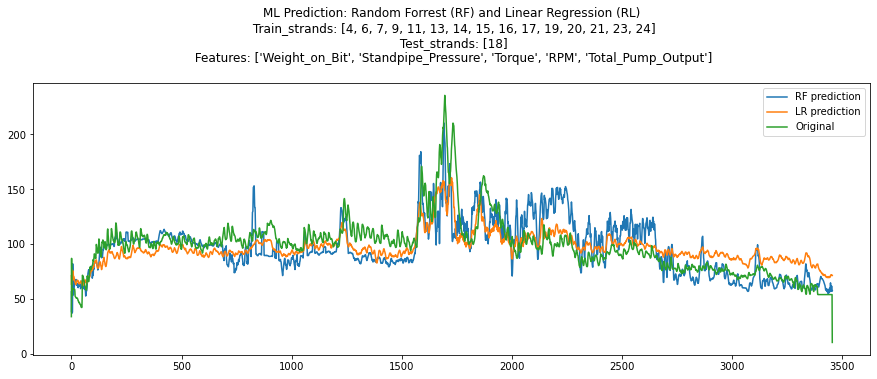

Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\trial_1_LR.pkl
Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\trial_1_RF.pkl
time: 25.4 s


In [ ]:
model_save_name = "trial_1"
train_stand = [4, 6, 7, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 23, 24]
test_stand = [18]
overall_training_and_predict_pipelined(df_dataset, selected_feature_columns, train_stand, test_stand, model_save_name)

Train size: 66200 and Test size: 5801
(66200, 5)
(5801, 5)
(66200,)
(5801,)
Print Linear regression score: 0.82
ML Prediction: Random Forrest (RF) and Linear Regression (RL)
 Train_strands: [4, 6, 7, 9, 11, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24]
 Test_strands: [13]
 Features: ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque', 'RPM', 'Total_Pump_Output']



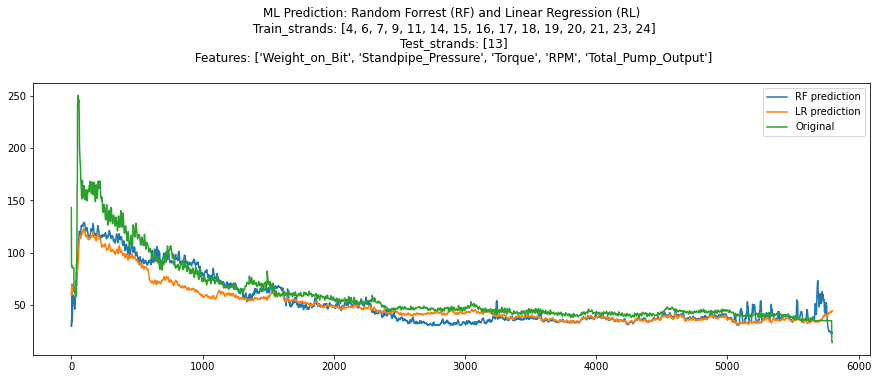

Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\trial_2_1_LR.pkl
Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\trial_2_1_RF.pkl
time: 22.8 s


In [ ]:
model_save_name = "trial_2_1"
train_stand = [4, 6, 7, 9, 11, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24]
test_stand = [13]
overall_training_and_predict_pipelined(df_dataset, selected_feature_columns, train_stand, test_stand, model_save_name)

**Trial 2**

Train size: 70510 and Test size: 1491
(70510, 5)
(1491, 5)
(70510,)
(1491,)
Print Linear regression score: 0.77
ML Prediction: Random Forrest (RF) and Linear Regression (RL)
 Train_strands: [4, 6, 9, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24]
 Test_strands: [7]
 Features: ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque', 'RPM', 'Total_Pump_Output']



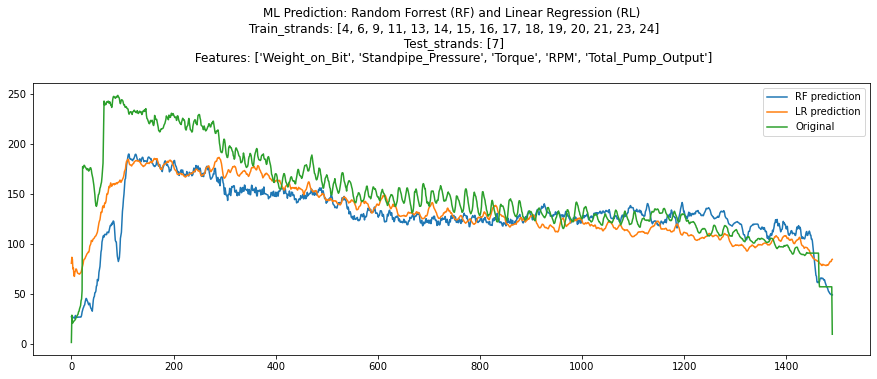

Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\trial_2_1_LR.pkl
Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\trial_2_1_RF.pkl
time: 23.7 s


In [ ]:
model_save_name = "trial_2_1"
train_stand = [4, 6, 9, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24]
test_stand = [7]
overall_training_and_predict_pipelined(df_dataset, selected_feature_columns, train_stand, test_stand, model_save_name)

Train size: 69277 and Test size: 2724
(69277, 5)
(2724, 5)
(69277,)
(2724,)
Print Linear regression score: 0.82
ML Prediction: Random Forrest (RF) and Linear Regression (RL)
 Train_strands: [4, 6, 7, 9, 11, 13, 14, 15, 17, 18, 19, 20, 21, 23, 24]
 Test_strands: [16]
 Features: ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque', 'RPM', 'Total_Pump_Output']



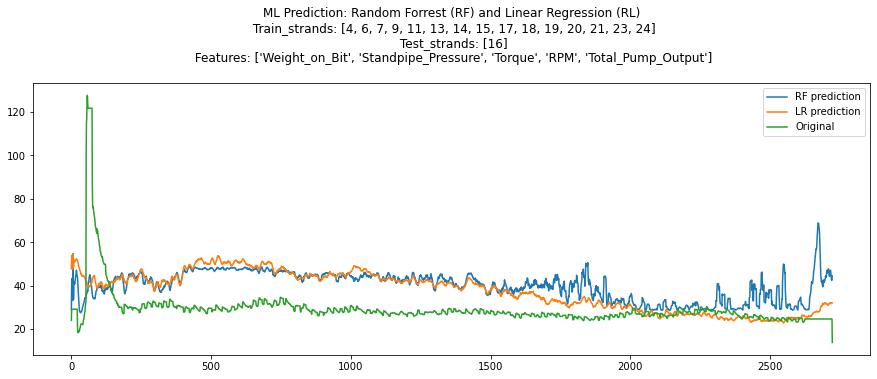

Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\trial_2_2_LR.pkl
Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\trial_2_2_RF.pkl
time: 24.5 s


In [ ]:
model_save_name = "trial_2_2"
train_stand = [4, 6, 7, 9, 11, 13,  14, 15, 17, 18, 19, 20, 21, 23, 24]
test_stand = [16]
# feature_columns = ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque',  'RPM', 'Total_Pump_Output', "Bit_sharpness"]
overall_training_and_predict_pipelined(df_dataset, selected_feature_columns, train_stand, test_stand, model_save_name)

Train size: 69277 and Test size: 2724
(69277, 6)
(2724, 6)
(69277,)
(2724,)
Print Linear regression score: 0.82
ML Prediction: Random Forrest (RF) and Linear Regression (RL)
 Train_strands: [4, 6, 7, 9, 11, 13, 14, 15, 17, 18, 19, 20, 21, 23, 24]
 Test_strands: [16]
 Features: ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque', 'RPM', 'Total_Pump_Output', 'Bit_sharpness']



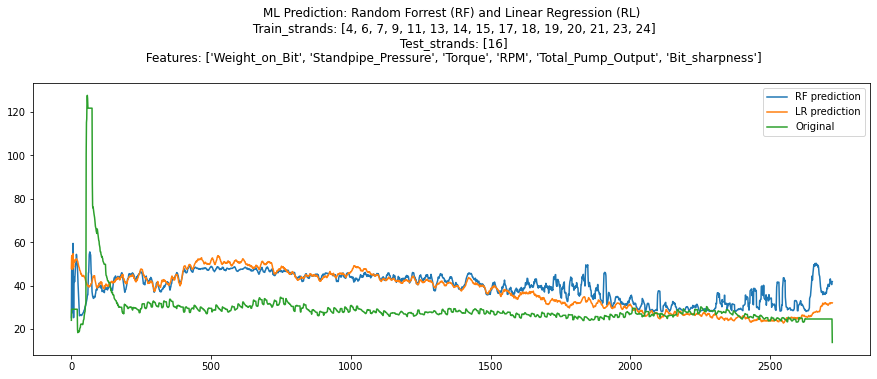

Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\trial_2_2_LR.pkl
Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\trial_2_2_RF.pkl
time: 30.9 s


In [ ]:
model_save_name = "trial_2_2"
train_stand = [4, 6, 7, 9, 11, 13,  14, 15, 17, 18, 19, 20, 21, 23, 24]
test_stand = [16]
feature_columns = ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque',  'RPM', 'Total_Pump_Output', "Bit_sharpness"]
overall_training_and_predict_pipelined(df_dataset, feature_columns, train_stand, test_stand, model_save_name)

**Trial 3**


Train size: 68269 and Test size: 3732
(68269, 5)
(3732, 5)
(68269,)
(3732,)
Print Linear regression score: 0.81
ML Prediction: Random Forrest (RF) and Linear Regression (RL)
 Train_strands: [4, 6, 7, 9, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 24]
 Test_strands: [23]
 Features: ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque', 'RPM', 'Total_Pump_Output']



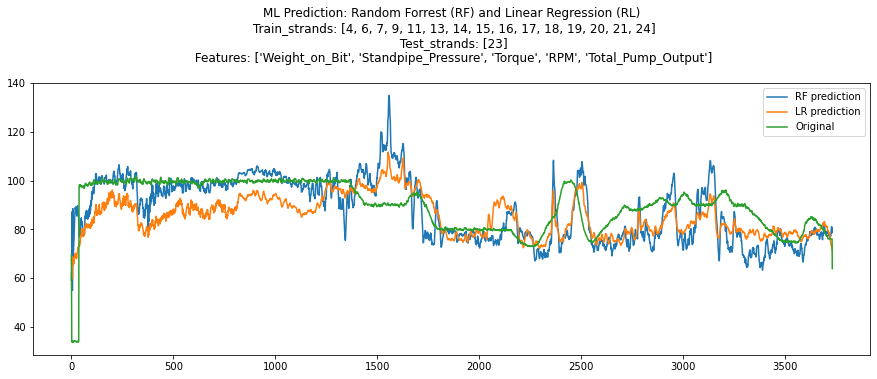

Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\trial_23_LR.pkl
Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\trial_23_RF.pkl
time: 25.1 s


In [ ]:
model_save_name = "trial_23"
train_stand = [4, 6, 7, 9, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 24]
test_stand = [23]
overall_training_and_predict_pipelined(df_dataset, selected_feature_columns, train_stand, test_stand, model_save_name)

Train size: 19247 and Test size: 3732
(19247, 5)
(3732, 5)
(19247,)
(3732,)
Print Linear regression score: 0.87
ML Prediction: Random Forrest (RF) and Linear Regression (RL)
 Train_strands: [17, 18, 19, 20, 21, 22]
 Test_strands: [23]
 Features: ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque', 'RPM', 'Total_Pump_Output']



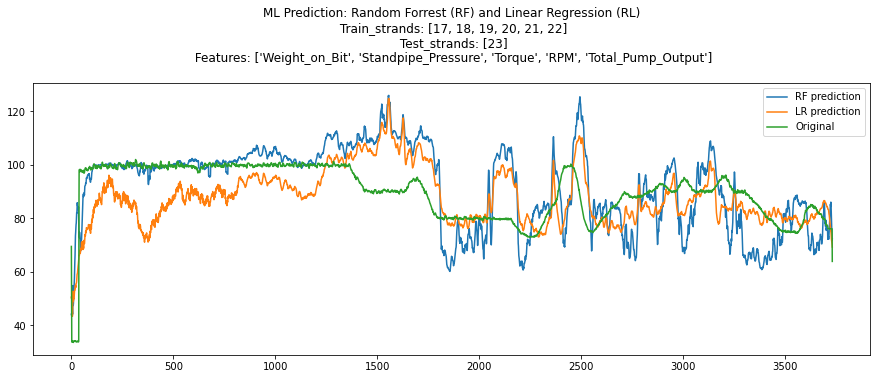

Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\LR_6.pkl
Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\RF_6.pkl
time: 7.12 s


In [ ]:
feature_columns = ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque',  'RPM', 'Total_Pump_Output']
train_stand=[17, 18, 19, 20, 21, 22]
test_stand=[23]
overall_training_and_predict_pipelined(df_catosa_stand, feature_columns, train_stand, test_stand, "6" )

#### Low performing prediction

Train size: 68269 and Test size: 3732
(68269, 5)
(3732, 5)
(68269,)
(3732,)
Print Linear regression score: 0.81
ML Prediction: Random Forrest (RF) and Linear Regression (RL)
 Train_strands: [4, 6, 7, 9, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 24]
 Test_strands: [23]
 Features: ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque', 'RPM', 'Total_Pump_Output']



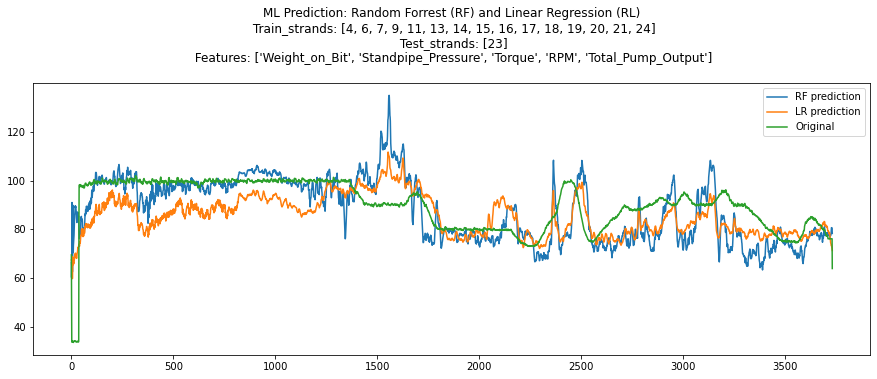

Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\trial_23_LR.pkl
Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\trial_23_RF.pkl
time: 24.3 s


In [ ]:
model_save_name = "trial_23"
train_stand = [4, 6, 7, 9, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 24]
test_stand = [23]
overall_training_and_predict_pipelined(df_dataset, selected_feature_columns, train_stand, test_stand, model_save_name)

Train size: 68269 and Test size: 3732
(68269, 7)
(3732, 7)
(68269,)
(3732,)
Print Linear regression score: 0.81
ML Prediction: Random Forrest (RF) and Linear Regression (RL)
 Train_strands: [4, 6, 7, 9, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 24]
 Test_strands: [23]
 Features: ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque', 'RPM', 'Total_Pump_Output', 'Bit_sharpness', 'MSE_approx']



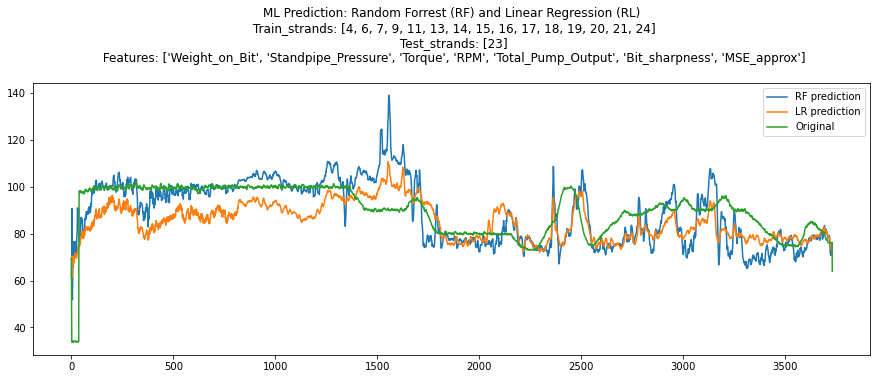

Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\trial_2_2_LR.pkl
Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\trial_2_2_RF.pkl
time: 37.1 s


In [ ]:
model_save_name = "trial_2_2"
train_stand = [4, 6, 7, 9, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 24]
test_stand = [23]
feature_columns = ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque',  'RPM', 'Total_Pump_Output', "Bit_sharpness", "MSE_approx"]
overall_training_and_predict_pipelined(df_dataset, feature_columns, train_stand, test_stand, model_save_name)

Train size: 59379 and Test size: 2576
(59379, 5)
(2576, 5)
(59379,)
(2576,)
Print Linear regression score: 0.84
ML Prediction: Random Forrest (RF) and Linear Regression (RL)
 Train_strands: [1, 2, 4, 6, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22]
 Test_strands: [24]
 Features: ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque', 'RPM', 'Total_Pump_Output']



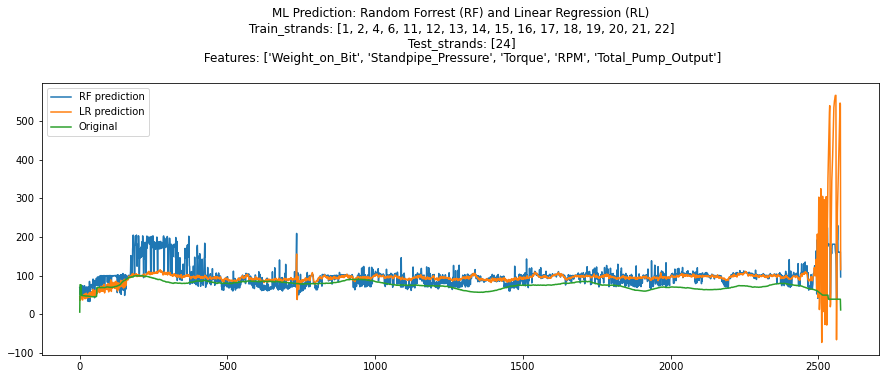

Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\LR_5.pkl
Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\RF_5.pkl


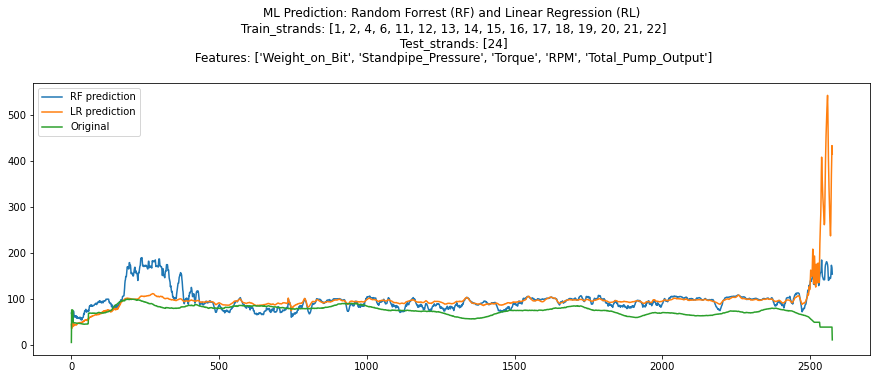

time: 23.7 s


#### MSE Perdiction

Train size: 68269 and Test size: 3732
(68269, 5)
(3732, 5)
(68269,)
(3732,)
Print Linear regression score: 0.36
ML Prediction: Random Forrest (RF) and Linear Regression (RL)
 Train_strands: [4, 6, 7, 9, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 24]
 Test_strands: [23]
 Features: ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque', 'RPM', 'Total_Pump_Output']



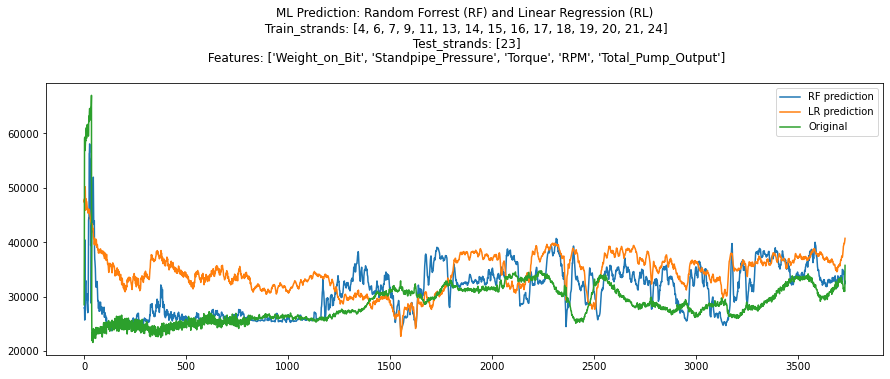

Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\trial_1_LR.pkl
Directory C:\Alamin\courses\XGeoML\XGeoML\pickle already exists and so returning.
Saved object to a file: C:\Alamin\courses\XGeoML\XGeoML\pickle\trial_1_RF.pkl
time: 25.1 s


In [ ]:
model_save_name = "trial_mse_pred"
train_stand = [4, 6, 7, 9, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 24]
test_stand = [23]
feature_columns = ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque',  'RPM', 'Total_Pump_Output']
overall_training_and_predict_pipelined(df_dataset, feature_columns, train_stand, test_stand, model_save_name=model_save_name, pred_column="MSE")

#### LR explanability

In [ ]:
importance = model.coef_

Train size: 415 and Test size: 528
(415, 5)
(528, 5)
(415,)
(528,)
Print Linear regression score: 0.87
ML Prediction: Random Forrest (RF) and Linear Regression (RL)
 Train_strands: [1]
 Test_strands: [2]
 Features: ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque', 'RPM', 'Total_Pump_Output']



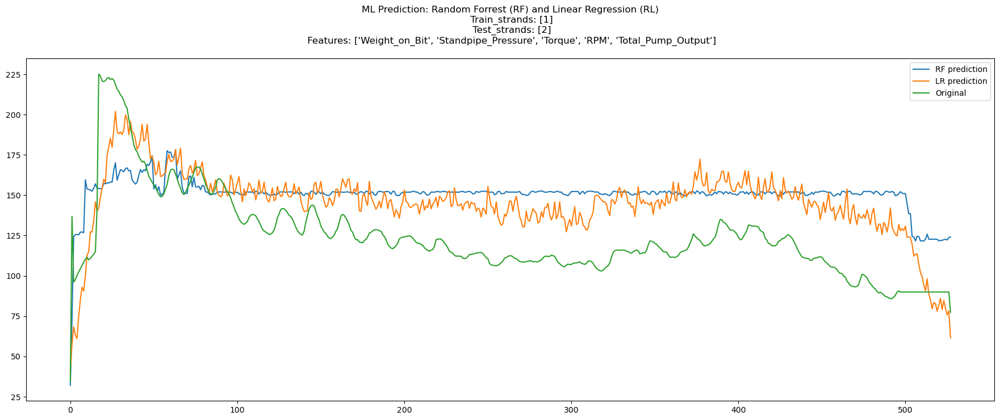

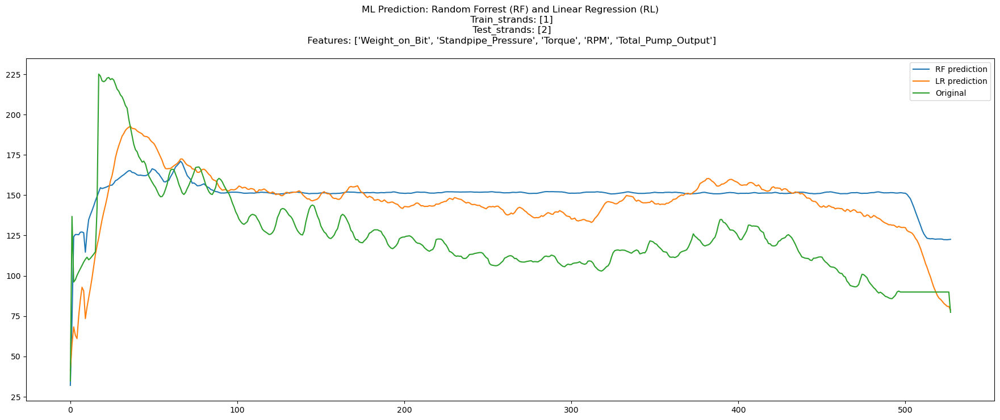

time: 1.02 s


In [ ]:
df_dataset = df_catosa_stand

feature_columns = ['Weight_on_Bit', 'Standpipe_Pressure', 'Torque',  'RPM', 'Total_Pump_Output']
train_stand=[1]
test_stand=[2]



X_train, X_test, y_train, y_test = get_train_test_set(df_dataset, feature_columns, train_stand=train_stand, test_stand=test_stand)
X_train, X_test = get_normalized_data(X_train, X_test, feature_columns)

y_pred_RF, model_RF = get_prediction_RF(X_train, y_train, X_test)
y_pred_LR, model_LR = get_prediction_LR(X_train, y_train, X_test)

y_true = y_test.tolist()


title="ML Prediction: %s\n Train_strands: %s\n Test_strands: %s\n Features: %s\n" % ("Random Forrest (RF) and Linear Regression (RL)", train_stand, test_stand, feature_columns)
print(title)

plot_original_and_smooth_graph(y_true, y_pred_LR, y_pred_RF, title)



In [ ]:
importance = model_LR.coef_
for i,v in enumerate(importance):
	print('Feature: %s, Score: %.5f' % (feature_columns[i],v))


Feature: Weight_on_Bit, Score: 18.20788
Feature: Standpipe_Pressure, Score: 11.32035
Feature: Torque, Score: 14.50242
Feature: RPM, Score: 3.24574
Feature: Total_Pump_Output, Score: -8.34998
time: 2 ms


In [ ]:
y_pred = get_prediction_LR(X_train, y_train, X_test)
y_true = y_test.tolist()
print("Test dataset MSE: %.2f and R^2: %.2f" % (mean_squared_error(y_true, y_pred), r2_score(y_true, y_pred)))

Print Linear regression score: 0.74
Test dataset MSE: 44.29 and R^2: -0.63
time: 12 ms


# Task: Vibration Prediction

## helper methods


In [ ]:
from sklearn.svm import SVR

from sklearn.preprocessing import StandardScaler



# import sklearn.metrics
# import autosklearn.regression

# def get_prediction_autoSKlearn(X_train, y_train, X_test, max_time = 600):

#     automl = autosklearn.regression.AutoSklearnRegressor(
#         time_left_for_this_task=max_time
#         )
#     automl.fit(X_train, y_train)

#     ensemble_dict = automl.show_models()
#     print(ensemble_dict)

#     y_test = automl.predict(X_test)
#     return y_test, automl



def plot_performance_metrices(all_perf_metrices, metric, title, x_ticks_labels=None, xlabel=None):
    # y_pred = y_pred.clip(min=0)
    print("==============> plot_performance_metrices %s " % all_perf_metrices)
    fig = plt.figure(figsize=(20, 5)) # 10 is width, 7 is height
    ax = fig.gca()

    if (x_ticks_labels):
        x_ticks = [i for i in range(len(x_ticks_labels))]
        ax.set_xticks(x_ticks)
        ax.set_xticklabels(x_ticks_labels)

    for algo in all_perf_metrices:
        print("==============> %s" % all_perf_metrices[algo])
        plt.plot(all_perf_metrices[algo][metric],  label=algo) 

    plt.legend(loc='best')
    plt.title(title)
    plt.ylabel(metric)
    if xlabel:
        plt.xlabel(xlabel)

    plt.show()

def classify_to_bins(df, bin_type, bin_size):
  # bin_type: depth or time
  # bin_size: foot, minute
  df = df.copy()
  bin_size = int(bin_size)
  if bin_type == 'depth':    
    bin_col = 'Bit_Depth'
    depth_bins = np.arange(math.floor(df[bin_col].min()), math.ceil(df[bin_col].max()) + bin_size, bin_size).tolist()
    bin_labels = depth_bins[:-1]
    df['Bins'] = pd.cut(df[bin_col], bins=depth_bins, labels=bin_labels)#.value_counts()
  if bin_type == 'time':
    time_bin_labels = []
    bin_id = 0
    while len(time_bin_labels) < len(df):
        tmp = [bin_id] * 60 * bin_size
        time_bin_labels += tmp
        bin_id += 1
    time_bin_labels = time_bin_labels[: len(df)]
    df['Bins'] = time_bin_labels
  return df

def get_bin_stamps(df):
    bins = df['Bins'].unique()
    time_stamps = []
    for bin in bins:
        t = df[df['Bins'] == bin].iloc[0].Date_Time
        # print(type(t))
        # print("Bin: %d time: %s" % (bin, t))
        time_stamps.append(t)
    # print(time_stamps)
    return time_stamps

    
# df_bin = classify_to_bins(df_org, bin_type="depth", bin_size=10)
# df_bin['Bins'].unique()
# df_bin.groupby("Bins").size()

# print(K_mse_lr)
# print(K_mse_rf)
# print(K_mse_svm)
# x_ticks_labels = [str(i+10) for i in range(47)]
# plot_mse(K_mses_bins_K_fold, title="Manual", x_ticks_labels = x_ticks_labels, xlabel="Test Bins")
# print(K_mses_bins_K_fold)

In [ ]:


# df_bin = classify_to_bins(df_15, bin_type="time", bin_size=10)
# test_time_stamps = get_bin_stamps(df_bin)
# print(time_stamps)

In [ ]:
# def plot_mse(data, title, x_ticks=None, xlabel=None):
#     # y_pred = y_pred.clip(min=0)
#     fig = plt.figure(figsize=(20, 5)) # 10 is width, 7 is height
#     ax = fig.gca()

#     if (x_ticks is not None):
#         # # print(ax.get_xticks())
#         # # print(x_ticks)
#         # ax.set_xticks(x_ticks)
#         # x_ticks_label = [str(i) for i in x_ticks]
#         # # ax.set_xlabels(x_ticks_label)
#         # ax.set_xticklabels(x_ticks_label)
#         # # print
#         # # plt.xticks(x_ticks, x_ticks)


#         ax.set_xticks([0,2,4,6])
#         ax.set_xticklabels(['zero','two','four','six'])


#     plt.plot(data,  label="Data 1")
#     data2 = [i+2 for i in data]
#     plt.plot(data2,  label="Data 2")

#     plt.legend(loc='best')
#     plt.title(title)
#     plt.ylabel("MSE (Mean Square Error)")
#     if xlabel:
#         plt.xlabel(xlabel)




#     plt.show()

# # print(K_mse_lr)
# # print(K_mse_rf)
# # print(K_mse_svm)
# x_ticks = [i+10 for i in range(17)]
# data = [i+5 for i in range(10)]
# plot_mse(data, title="Manual", x_ticks = x_ticks, xlabel="Test Bins")

## load dataset

In [ ]:
data_file = r"C:\Alamin\courses\XGeoML\XGeoML\dataset\catoosa\catoosa_surface_downhole_run_15_to_19_computed_rundepth.csv"
data_file = r"C:\Alamin\courses\XGeoML\XGeoML\dataset\catoosa\catoosa_surface_downhole_run_15_to_19_rundepth_filter_percentile_10ft_only_inputs_separately.csv"

# data_file = r"/content/drive/MyDrive/UofC/XGeoML/dataset/catoosa_surface_downhole_run_15_to_19_computed_rundepth.csv"
data_file = r"/content/drive/MyDrive/UofC/XGeoML/dataset/catoosa_surface_downhole_run_15_to_19_rundepth_filter_percentile_10ft_only_inputs_separately.csv"

# data_file = r"catoosa_surface_downhole_run_15_to_19_computed_rundepth.csv"
df_org = pd.read_csv(data_file, dtype={'Stand': int})
print(len(df_org))

df_15 = df_org[df_org['Run'] == 15]
df_16 = df_org[df_org['Run'] == 16]
df_17 = df_org[df_org['Run'] == 17]
df_18 = df_org[df_org['Run'] == 18]
df_19 = df_org[df_org['Run'] == 19]
print(len(df_15))

df_bin = classify_to_bins(df_org, bin_type="depth", bin_size=10)
print(len(df_bin))

62574
9155
62574


In [ ]:
# PD.static_save_df(df_15, "df_15.csv")

Dataframe has been saved in: df_15.csv
time: 444 ms


In [ ]:
df_org.columns
df_org[df_org['Run'] == 15]['Accel'].describe()

count    9155.000000
mean        4.374396
std         0.356863
min         3.110729
25%         4.215650
50%         4.429235
75%         4.621503
max         6.059430
Name: Accel, dtype: float64

time: 124 ms


In [ ]:
print(len(df_org))
df_org.groupby("Run").size()

62574


Run
15     9155
16    12474
17    17988
18    16209
19     6748
dtype: int64

time: 430 ms


In [ ]:
df_15.columns

Index(['Date_Time', 'axialrms', 'tangentialrms', 'lateralrms', 'rpmmed',
       'Accel', 'Velocity', 'Bit_Depth', 'Hole_Depth', 'Block_Height',
       'Hook_Load', 'ROP', 'Standpipe_Pressure', 'Torque', 'Weight_on_Bit',
       'RPM', 'Total_Pump_Output', 'Stand', 'Run', 'Run_Depth', 'Bins'],
      dtype='object')

time: 390 ms


In [ ]:
print(time_stamps)

['2021-09-15 11:35:23', '2021-09-15 11:55:35', '2021-09-15 12:16:24', '2021-09-15 12:28:37', '2021-09-15 12:40:26', '2021-09-15 12:53:04', '2021-09-15 13:04:51', '2021-09-15 13:17:10', '2021-09-15 13:28:56', '2021-09-15 13:39:57', '2021-09-15 13:51:38', '2021-09-15 14:16:37', '2021-09-15 14:29:13', '2021-09-15 14:41:31', '2021-09-15 14:53:40', '2021-09-15 15:04:00']
time: 294 ms


In [ ]:
l1 = [1, 2, 3]
l2 = list(l1)
print(l1, l2)
l2[0] = 100
print(l1, l2)

[1, 2, 3] [1, 2, 3]
[1, 2, 3] [100, 2, 3]
time: 263 ms


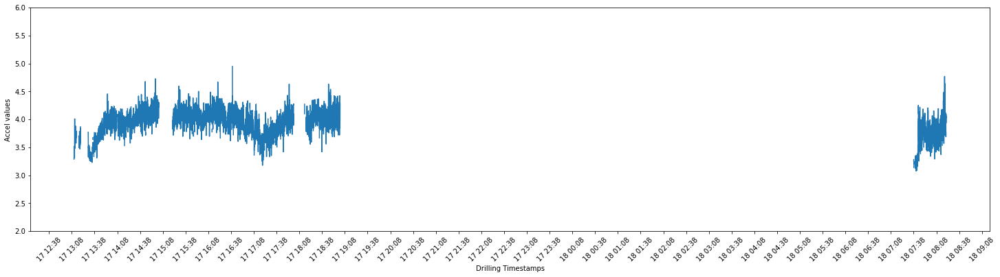

time: 861 ms


In [ ]:
plot_time_series_data(df_17, col="Accel", interval=30)

In [ ]:
print(x[0])
print(type(x[0]), len(x))

2021-09-15T11:35:23.000000000
<class 'numpy.datetime64'> 12672
time: 257 ms


In [ ]:
PD.static_save_df(df, "df_15.csv")

Dataframe has been saved in: df_15.csv
time: 484 ms


In [ ]:
# print(len(df_bin))
# res = df_bin.groupby(["Run", "Bins"]).size()
# print(type(res))
# print(res.to_string())

for run in range (15, 20):
    df_temp = df_bin.copy(deep=True)
    df_temp = df_temp[df_temp['Run'] == run]
    print("\n\n%s Run: %d  Len: %d" % ("=" * 30, run, len(df_temp)))
    bins = df_temp['Bins'].unique().tolist()
    print(bins)
    df = df_temp.groupby(["Bins"]).size().reset_index(name='counts')
    df = df[df['counts'] > 0]
    print(df)
    # print(df_temp)

    # break




============================== Run: 15  Len: 9155
[5427, 5437, 5447, 5457, 5467, 5477, 5487, 5497, 5507, 5517, 5527, 5537, 5547, 5557, 5567, 5577, 5587]
    Bins  counts
0   5427     107
1   5437      38
2   5447     276
3   5457     291
4   5467     408
5   5477     446
6   5487     566
7   5497     524
8   5507     671
9   5517     695
10  5527     758
11  5537     781
12  5547     760
13  5557     739
14  5567     842
15  5577     834
16  5587     419


============================== Run: 16  Len: 12474
[5587, 5597, 5607, 5617, 5627, 5637, 5647, 5657, 5667, 5677, 5687, 5697, 5707, 5717, 5727, 5737, 5747, 5757, 5767, 5777, 5787, 5797, 5807]
    Bins  counts
16  5587      18
17  5597     157
18  5607     170
19  5617     197
20  5627     231
21  5637     268
22  5647     301
23  5657     411
24  5667     411
25  5677     482
26  5687     500
27  5697     662
28  5707     656
29  5717     665
30  5727     740
31  5737     661
32  5747     859
33  5757     800
34  5767    1033
35  577

## Model

### Helper

In [ ]:
def get_performance_metric(y_true, y_pred, metric):
    ans = None
    if metric == "MSE":
        ans = mean_squared_error(y_true, y_pred)
    if metric == "RMSE":
        ans = math.sqrt(mean_squared_error(y_true, y_pred))
    if metric == "RMSLE":
        ans = math.sqrt(mean_squared_log_error(y_true, y_pred))
    return ans





def save_prediction(self):
    if self.output_file is not None:
        try:
            self.all_prediction_df.to_csv(self.output_file, index=False, quotechar='"', quoting=csv.QUOTE_NONNUMERIC)
            print("The predictions of the models have been saved in file %s" % self.output_file)
        except:
            print("\n\n%s\n" % ("#" * 20))
            print("Error in trying to save the output to output file: %s" % (self.output_file))

### Data preparation

In [ ]:
def K_fold_train_test_dataset(df_data, run, features, target, K, random, debug):
    df_run = df_data[df_data['Run'] == run]
    print(len(df_run))
    cur_columns = features + [target]
    df_run = df_run[cur_columns]
    # print(df_run.head())
    kf = KFold(n_splits=K, shuffle=random)

    if (debug >= 1):
        print(df_run[target].describe())

    train_test_pairs = []
    for train_index, test_index in kf.split(df_run):
        df_train = df_run.iloc[train_index] 
        df_test =  df_run.iloc[test_index]
        
        X_train = df_train[features]
        y_train = df_train[target]
        X_test = df_test[features]
        y_test = df_test[target]
        train_test_pair = (X_train, y_train, X_test, y_test)

        train_test_pairs.append(train_test_pair)
    return train_test_pairs



def Bins_K_fold_train_test_dataset(df_data, run, features, target, K, bin_size):
    df_bin = classify_to_bins(df_data, bin_type="depth", bin_size=10)
    df_run = df_bin[df_bin['Run'] == run]
    print(len(df_run))
    cur_columns = features + [target, "Bins"]
    df_run = df_run[cur_columns]

    bins = df_run['Bins'].unique().tolist()
    print(len(bins))
    print(bins)
    
    train_test_pairs = []
    test_bins = []


    for test_bin in bins:
        train_bin = bins.copy()
        train_bin.remove(test_bin)
        test_bins.append(test_bin)
        # print(train_bin, test_bin)
        # test_bin = [bins[i] for i in test_bin_idx]
        # print(train_bin, test_bin)
        df_train = df_run[df_run["Bins"].isin(train_bin)]
        df_test =  df_run[df_run["Bins"] == test_bin]
        
        X_train = df_train[features]
        y_train = df_train[target]
        X_test = df_test[features]
        y_test = df_test[target]
        train_test_pair = (X_train, y_train, X_test, y_test)

        train_test_pairs.append(train_test_pair)

    return train_test_pairs, test_bins


def relational_Bins_train_test(self):

    if(self.debug > 1):
        print("Run: %d and total data points: %d" % (self.run, len(self.df_run_bin)))
    cur_columns = features + [target, "Bins"]
    df_run_bin = self.df_run_bin[cur_columns]

    bins = self.df_run_bin['Bins'].unique().tolist()
    # if(self.debug > 1):
    #     print("Total bins: %d: %s" % (len(bins), bins))
    
    train_test_pairs = []
    test_bins = []
    start_bin = self.test_bin_start
    end_bin = min(self.test_bin_end+1, len(bins))
    for test_bin_ind in range(start_bin, end_bin):
        train_bin = [bins[i] for i in range(test_bin_ind)][-self.rolling_bin_size-1:]
        test_bin = bins[test_bin_ind]
        test_bins.append(test_bin)
        # if(self.debug > 1):
        #     print("Train bins: %s and Test bin: %s" % (train_bin, test_bin))
        df_train = df_run_bin[df_run_bin["Bins"].isin(train_bin)]
        df_test =  df_run_bin[df_run_bin["Bins"] == test_bin]
        
        X_train = df_train[features]
        y_train = df_train[target]
        X_test = df_test[features]
        y_test = df_test[target]
        train_test_pair = (X_train, y_train, X_test, y_test)
        train_test_pairs.append(train_test_pair)

        if(self.debug > 2):
            print("Test bin index: %d Train bins: %s and Test bin: %s #X_train: %d #X_test: %d" % 
                  (test_bin_ind, train_bin, test_bin, len(X_train), len(X_test)))
    return train_test_pairs, test_bins




### Model Design

### Visualization

In [ ]:
def plot_prediction(map_preds, plot_title):
    # plot_title = "Original Acceleration vs predicted Accel on Test Bin %d" % (test_bin)
    ax = plt.figure(figsize=(20, 8)) # width, height

    for algo in map_preds:
        plt.plot(map_preds[algo],  label=algo) 

    plt.legend(loc='best')
    plt.title(plot_title)
    plt.show()

def visualize_test_data_bin(df_data, plot_title):
    # plot_title = "Visualizing Original dataset for Bin: %d" % (test_bin)
    # ax = plt.figure(figsize=(20, 5)) # width, height
    # df_data = df[df["Bins"] == test_bin]
    columns = df_data.columns.tolist()
   
    print(columns, type(columns))
    columns.remove("Bins")
    columns.remove("Run_Depth")
    for col in columns:
        fig = plt.figure(figsize=(10, 2)) # width, height
        plt.plot(df_data[col], label=col)
        plt.legend(loc='best')
        plt.title(plot_title)
    plt.show()


def generate_metrics_plot(self, include_SD=True):
    for metric in self.metrics:
        plot_title = "Relational (Sequential) Rolling window Bin (%d prev bins) \
for RUN: %d" % (self.rolling_bin_size, self.run)
        x_ticks_labels = [str(bin) for bin in self.test_bins]
        xlabel="Test Bin (Drilling depth: %d feet)" % self.bin_depth
        labels = self.models.copy()
        values = []
        # print(self.models)
        for model in self.models:
            col = "%s_%s" % (model, metric)
            v = self.all_prediction_df[col].tolist()
            values.append(v)
        
        if include_SD:
            labels.append("SD")
            values.append(self.all_prediction_df["StandardDeviation"].tolist())
        
        line_plots(values, labels, title=plot_title,
                                    x_ticks_labels=x_ticks_labels, xlabel=xlabel, ylabel=metric)
        








def plot_features(self, test_bin):
    df_plot_data = self.df_run_bin[self.df_run_bin["Bins"] == test_bin]
    plot_cols = [target] + self.features
    df_plot_data = df_plot_data[plot_cols]
    if self.debug > 1:
        print("Test Bin: %d and its len: %d" % (test_bin, len(df_plot_data)))
    plot_title = "Visualizing features of the dataset for Test Bin %s and Run: %d" % (test_bin, self.run)
    df_plot_data.plot(subplots=True, figsize=(15, 8), title=plot_title)


from collections import OrderedDict
def get_model_rank(self, test_bin, metric):
    df = self.all_prediction_df.copy()
    df = df[df['Test_bin'] == test_bin]
    m = {}
    for model in self.models:
        col = "%s_%s" % (model, metric)
        val = df[col].tolist()[0]
        m[model] = val
    mean = df["mean"].tolist()[0]
    SD = df["StandardDeviation"].tolist()[0]
    
    ranked_model = OrderedDict(sorted(m.items(), key=lambda x: x[1]))
    res_str = ""
    print("==========>\nRank of the models for Metric: %s" % metric)
    res_str += ("Test Bin (%d) \nMean: %.2f and SD: %.2f\n" % (test_bin, mean, SD))
    for model in ranked_model:
        res_str += ("%s => %0.2f (%s)\n" % (model, ranked_model[model], metric))
    print(res_str)
    return ranked_model, res_str

def plot_model_predictions(self, test_bin, smooth_N=None, text=None):
    df_plot_data = self.all_prediction_df.copy()
    df_plot_data = df_plot_data[df_plot_data['Test_bin'] == test_bin]
    labels = self.models.copy()
    values = []

    for model in self.models:
        col = "%s_y_pred" % (model)
        v = df_plot_data[col].tolist()[0]
        if smooth_N:
            v = get_smooth_data(v, N=smooth_N)
        values.append(v)
    labels.append(self.target)
    values.append(df_plot_data["OriginalValue"].tolist()[0])
    plot_title = "Visualizing the predictions of the models for Test Bin %s and Run: %d" % (test_bin, self.run)
    ranked_model, ranked_text = self.get_model_rank(test_bin, self.metrics[0])
    line_plots(values, labels, title=plot_title, xlabel="Depth", ylabel=self.target, text=ranked_text)

    for metric in self.metrics:
        ranked_model, ranked_text = self.get_model_rank(test_bin, metric)


def line_plots(values, labels, title, x_ticks_labels=None, 
               xlabel=None, ylabel=None, ylim=None, text=None):
    # y_pred = y_pred.clip(min=0)
    # print("==============> plot_performance_metrices %s " % all_perf_metrices)
    fig = plt.figure(figsize=(15, 5)) # 10 is width, 7 is height
    ax = fig.gca()


    if (x_ticks_labels):
        x_ticks = [i for i in range(len(x_ticks_labels))]
        ax.set_xticks(x_ticks)
        ax.set_xticklabels(x_ticks_labels)

    for value, label in zip(values, labels):
        # print("==============> %s" % all_perf_metrices[algo])
        # print(type(value), len(value))
        # print(value)
        plt.plot(value,  label=label)

    if ylim:
        ax.set_ylim(ylim)
    if text:
        # print("Y_lim is: %s" % ax.get_ylim())
        print(ax.get_ylim())
        # ax.text(0, 20, text, color="blue")
    plt.legend(loc='best')
    plt.title(title)
    # plt.ylabel(metric)
    if xlabel:
        plt.xlabel(xlabel)
    if ylabel:
        plt.ylabel(ylabel)   
    if text:
        plt.figtext(-.05, .5, text, color="blue", fontsize=10)
    plt.show()

# values = [np.arange(10), np.arange(30, 40)]
# labels = [str(v) for v in values]
# line_plots(values, labels, title="test", text="Alamin sdj \n sdj sfda 02.3\n This is good")

In [ ]:
features = ["ROP", "Torque", "Weight_on_Bit", "Run_Depth"]
features = ["ROP", "Torque", "Weight_on_Bit"]
target = "Accel"


models=["SD", "LR", "RF", "RNN"]
models=["LR", "RF"]

metrics = ["RMSE", "RMSLE"]
output_file = "predicted_outputs.csv"

['Test bin: 0\n2021-09-15 11:35:23', 'Test bin: 1\n2021-09-15 11:55:35', 'Test bin: 2\n2021-09-15 12:16:24', 'Test bin: 3\n2021-09-15 12:28:37', 'Test bin: 4\n2021-09-15 12:40:26', 'Test bin: 5\n2021-09-15 12:53:04', 'Test bin: 6\n2021-09-15 13:04:51', 'Test bin: 7\n2021-09-15 13:17:10', 'Test bin: 8\n2021-09-15 13:28:56', 'Test bin: 9\n2021-09-15 13:39:57', 'Test bin: 10\n2021-09-15 13:51:38', 'Test bin: 11\n2021-09-15 14:16:37', 'Test bin: 12\n2021-09-15 14:29:13', 'Test bin: 13\n2021-09-15 14:41:31', 'Test bin: 14\n2021-09-15 14:53:40', 'Test bin: 15\n2021-09-15 15:04:00']


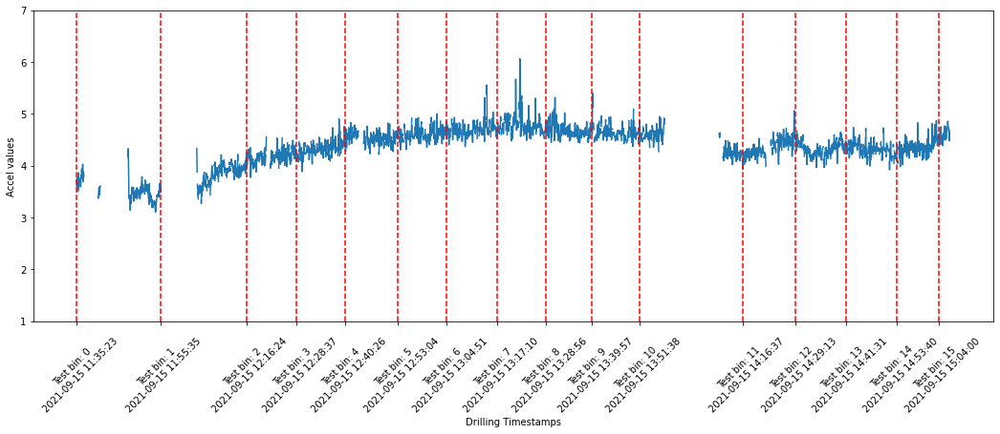

In [ ]:
import matplotlib.dates as md


def plot_time_series_data(data_df, col, interval=10, xticks=None):
    df = data_df.copy(deep=True)
    df['Date_Time'] = pd.to_datetime(df['Date_Time'])
    df = df.set_index(['Date_Time'])
    df = df.reindex(pd.date_range(start=df.index[0], end=df.index[-1], freq='1s'))

    # x = df['Date_Time'].tolist()
    x = df.index.values
    y = df[col].tolist()


    fig = plt.figure(figsize=(18, 6)) # 10 is width, 7 is height
    ax = fig.gca()
    plt.plot(x, y)
    ax.set_ylim(1, 7)

    if(xticks):
        # print(type(xticks[0]))
        xticks = [pd.to_datetime(x) for x in xticks]
        # print(type(xx[0]))
        ax.set_xticks(xticks)
        x_ticks_labels = list(xticks)
        for i in range(len(x_ticks_labels)):
            x_ticks_labels[i] = "Test bin: %d\n%s"  % (i,  xticks[i])
        print(x_ticks_labels)
        ax.set_xticklabels(x_ticks_labels)
    else:
        xfmt = md.DateFormatter('%d %H:%M')
        ax.xaxis.set_major_formatter(xfmt)
        ax.xaxis.set_major_locator(md.MinuteLocator(interval=interval))

    # plt.legend(loc="best")
    plt.xticks( rotation=45 )
    plt.xlabel("Drilling Timestamps")
    plt.ylabel("%s values" % col)

    for i in range(len(xticks)):
        plt.axvline(x=pd.to_datetime(xticks[i]), color="r", linestyle="--")

    plt.show()


df_bin = classify_to_bins(df_15, bin_type="time", bin_size=10)
test_time_stamps = get_bin_stamps(df_bin)
# print(time_stamps)
plot_time_series_data(df_15, col="Accel", xticks=test_time_stamps)




### Model Train and Pred

In [ ]:
y_test = random.randint(10, 12, size=100)

y_pred_avg = list(y_test) + random.randint(-3, 3, size=len(y_test))
y_pred_max = list(y_test) +  random.randint(2, 3, size=len(y_test))
y_pred_min = list(y_test) - random.randint(2, 4, size=len(y_test))
pred = {"Avg": y_pred_avg, "Max": y_pred_max, "Min": y_pred_min}

print(y_test)
print(pred)

y_pred_avg, y_pred_max, y_pred_min = pred['Avg'], pred["Max"], pred['Min']
# print(y_pred_avg)
# print(y_pred_max)
# print(y_pred_min)

[11 10 10 11 11 11 10 11 10 11 11 11 10 11 10 10 11 11 10 10 10 10 11 10
 10 11 11 11 10 11 10 10 11 10 11 10 10 10 11 11 11 11 11 11 11 11 11 11
 11 11 11 11 11 10 10 10 10 11 11 10 10 10 11 10 10 10 10 11 10 10 10 11
 11 10 11 10 10 11 10 10 11 10 11 10 10 11 11 11 11 10 11 11 10 11 11 10
 10 11 11 10]
{'Avg': array([ 8, 12, 11,  9, 13, 13, 12, 10,  8,  9, 12, 13, 10, 11,  8, 11, 12,
       11,  9,  7,  9, 11, 10, 12,  8, 10,  9, 13, 11, 12,  9,  8, 11, 12,
        8,  8,  9, 11, 13, 13,  9, 10, 13, 11, 11,  9, 10, 12, 12, 11,  8,
       12, 10,  8, 10, 10, 12,  8, 11, 12, 10, 11,  8,  8,  8,  8,  9, 13,
       11, 12, 10,  8, 11, 10, 12, 10, 11, 10,  8,  7, 12,  8, 12, 10,  7,
       10, 13,  9,  9,  8,  9, 11, 11, 10, 10, 12, 12, 11, 12,  8]), 'Max': array([13, 12, 12, 13, 13, 13, 12, 13, 12, 13, 13, 13, 12, 13, 12, 12, 13,
       13, 12, 12, 12, 12, 13, 12, 12, 13, 13, 13, 12, 13, 12, 12, 13, 12,
       13, 12, 12, 12, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13,
       13,

In [ ]:
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_squared_log_error
import statistics


from keras.models import Sequential
from keras.layers import LSTM, Dense
from keras.preprocessing.sequence import TimeseriesGenerator

 



def relational_Bins_train_test(self):

    if(self.debug > 1):
        print("Run: %d and total data points: %d" % (self.run, len(self.df_run)))
    cur_columns = features + [target, "Bins"]

    if(self.experiment_settings == "Relational_Bins"):
        df = self.df_depth_bin
    if(self.experiment_settings == "Forecast"):
        df = self.df_time_bin
    bins = df['Bins'].unique().tolist()
    # if(self.debug > 1):
    #     print("Total bins: %d: %s" % (len(bins), bins))
    
    train_test_pairs = []
    test_bins = []
    start_bin = self.test_bin_start
    end_bin = min(self.test_bin_end+1, len(bins))
    for test_bin_ind in range(start_bin, end_bin):
        train_bin = [bins[i] for i in range(test_bin_ind)][-self.rolling_bin_size-1:]
        test_bin = bins[test_bin_ind]
        test_bins.append(test_bin)
        # if(self.debug > 1):
        #     print("Train bins: %s and Test bin: %s" % (train_bin, test_bin))
        df_train = df[df["Bins"].isin(train_bin)]
        df_test =  df[df["Bins"] == test_bin]
        
        X_train = df_train[features]
        y_train = df_train[target]
        X_test = df_test[features]
        y_test = df_test[target]
        train_test_pair = (X_train, y_train, X_test, y_test)
        train_test_pairs.append(train_test_pair)

        if(self.debug > 3):
            print("Test bin index: %d Train bins: %s and Test bin: %s #X_train: %d #X_test: %d" % 
                  (test_bin_ind, train_bin, test_bin, len(X_train), len(X_test)))
    return train_test_pairs, test_bins

def get_train_test_pair(self):
    if(self.experiment_settings == "Random_K_fold"):
        return K_fold_train_test_dataset(df_data, run, features, target, K_fold, random = True, debug=debug)
    if(self.experiment_settings == "Seqential_K_fold"):
        return  K_fold_train_test_dataset(df_data, run, features, target, K_fold, random = False, debug=debug)         
    if(self.experiment_settings == "Non_relational_Bins_K_fold"):
        return Bins_K_fold_train_test_dataset(df_data, run, features, target, K, bin_size)            
    if(self.experiment_settings == "Relational_Bins"):
        return self.relational_Bins_train_test()
    if(self.experiment_settings == "Forecast"):
        return self.relational_Bins_train_test()




class ModelPredictionGenerator():
    def __init__(self, experiment_settings, models, features, target,  df_data, run, metrics = ["RMSE"],
                    K_fold=10, relational_bin_config = None, forecast_config = None,
                    lstm_forecast_time_step = None, lstm_forecast_look_back = None,
                    metrics_plot=True, debug=0, feature_plot=False, output_file=None):
        # Store the raw data.
        self.experiment_settings = experiment_settings
        self.models = models
        self.features = features
        self.target = target
        self.df_data = df_data
        self.run = run
        self.metrics = metrics
        self.K_fold = K_fold
        self.relational_bin_config = relational_bin_config
        self.forecast_config = forecast_config

        self.df_run = df_data[df_data['Run'] == self.run]

        if self.relational_bin_config is not None:
            self.bin_depth = relational_bin_config["bin_depth"]
            self.test_bin_start = relational_bin_config["test_bin_start"]
            self.test_bin_end = relational_bin_config["test_bin_end"]
            self.rolling_bin_size = relational_bin_config["rolling_bin_size"]
            self.df_depth_bin = classify_to_bins(self.df_run, bin_type="depth", bin_size=self.bin_depth)
            

        if self.forecast_config is not None:
            self.bin_size = forecast_config["bin_size"]
            self.test_bin_start = forecast_config["test_bin_start"]
            self.test_bin_end = forecast_config["test_bin_end"]
            self.rolling_bin_size = forecast_config["rolling_bin_size"]
            self.skip_training = forecast_config["skip_training"]
            self.df_time_bin = classify_to_bins(self.df_run, bin_type="time", bin_size=self.bin_size)
            self.test_bin_time_stamps = get_bin_stamps(self.df_time_bin)

        # self.lstm_forecast_time_step = lstm_forecast_time_step
        self.lstm_forecast_look_back = lstm_forecast_look_back
        self.debug = debug
        self.metrics_plot = metrics_plot
        self.feature_plot = feature_plot
        self.output_file = output_file

        

        

    

def train_models_and_predict(self, train_test_pair, test_bin=None):
    (X_train, y_train, X_test, y_test) = train_test_pair
    # print(train_test_pair)
    X_train, X_test = get_normalized_data(X_train, X_test, self.features)
    # print(train_test_pair)

    res = {}
    for algo in models:
        if (algo == "LR"):
            y_pred, model_LR = get_prediction_LR(X_train, y_train, X_test)
        if (algo == "RF"):
            y_pred, model_RF = get_prediction_RF(X_train, y_train, X_test)            
        if (algo == "SVM"):
            y_pred, model_SVM = get_prediction_SVM(X_train, y_train, X_test)            
        if (algo == "AutoSKlearn"):
            y_pred, model_SVM = get_prediction_autoSKlearn(X_train, y_train, X_test, max_time=120)
        if (algo == "RNN"):
            # y_pred, model_RNN = get_prediction_RNN(X_train, y_train, X_test)
            lstm_model = LSTM_Model(train_test_pair, time_steps=self.lstm_time_step)
            model_checkpoint_path = "LSTM_%s.h5" % test_bin 
            y_pred, model_RNN = lstm_model.get_prediction_RNN(model_checkpoint_path)
        # if (algo == "LSTM_SF"):
        #     y_pred, model_RNN = get_prediction_LSTM_SF(y_train, y_test, look_back=self.lstm_sf_look_back)        
        if (algo == "LSTM_forecast"):
            y_preds, model_RNN = get_prediction_LSTM_forecast(y_train, y_test, look_back=self.lstm_forecast_look_back, skip_training=self.skip_training)
            y_pred, y_pred_max, y_pred_min = y_preds['Pred'], y_preds["Max"], y_preds['Min']
            res["Pred_max"] = y_pred_max
            res["Pred_min"] = y_pred_min
        
        # if(self.debug >= 2):
        #     print("==========> Algo: %s and pred: %s" % (algo, y_pred))
        
        y_pred_list = y_pred.tolist()
        y_true = y_test.tolist()
        key = "%s_y_pred" % algo
        res[key] = y_pred_list
        for metric in self.metrics:
            performance_metric = get_performance_metric(y_true=y_true, y_pred=y_pred_list, metric=metric)
            key = "%s_%s" % (algo, metric)
            res[key] = performance_metric

    res["OriginalValue"] = y_true
    res["StandardDeviation"] =  statistics.stdev(y_true)
    res["mean"] =  statistics.mean(y_true)    
    return res

def calculate_model_predictions(self):
    all_prediction_df = pd.DataFrame()
    self.train_test_pairs, self.test_bins = self.get_train_test_pair()

    assert len(self.train_test_pairs) == len(self.test_bins)
    for test_bin, train_test_pair in zip(self.test_bins, self.train_test_pairs):
        if (self.debug >= 1):
            print("====> Test bin: %d" % (test_bin))
        model_predictions = self.train_models_and_predict(train_test_pair, test_bin=test_bin)
        if (self.debug >= 5):
            print("%s bin %s" % (test_bin, model_predictions))        
        model_predictions["Run"] = self.run
        model_predictions["Test_bin"] = test_bin
        all_prediction_df = all_prediction_df.append(model_predictions, ignore_index=True)

    if(self.debug >= 2):
        print("===> All predictions: %s" % all_prediction_df)
    self.all_prediction_df = all_prediction_df.copy(deep=True)
    if(self.output_file):
        self.save_prediction()
    # if self.metrics_plot:
    #     self.generate_metrics_plot()
    return self.all_prediction_df, self.test_bins


def calculate_LSTM_forecast(self):
    all_prediction_df = pd.DataFrame()
    self.train_test_pairs, self.test_bins = self.get_train_test_pair()
    for test_bin, train_test_pair in zip(self.test_bins, self.train_test_pairs):
        if (self.debug >= 1):
            print("====> Test bin: %d" % (test_bin))
        preds, _ = get_prediction_LSTM_forecast(train_test_pair, test_bin=test_bin)
        y_pred, y_pred_max, y_pred_min = pred['Avg'], pred["Max"], pred['Min']




def get_time_indexed_df(df):
    df = df.copy(deep=True)
    df['Date_Time'] = pd.to_datetime(df['Date_Time'])
    df = df.set_index(['Date_Time'])
    df = df.reindex(pd.date_range(start=df.index[0], end=df.index[-1], freq='1s'))
    return df

def plot_time_series_data(self, plot_prediction = False, interval=10, xticks=None,  ylim=(1, 7)):
    # df = self.df_time_bin.copy(deep=True)
    # df['Date_Time'] = pd.to_datetime(df['Date_Time'])
    # # df['Date_Time2'] = pd.to_datetime(df['Date_Time'])
    # df = df.set_index(['Date_Time'])
    # df = df.reindex(pd.date_range(start=df.index[0], end=df.index[-1], freq='1s'))

    df = get_time_indexed_df(self.df_time_bin)
    # x = df['Date_Time'].tolist()
    x = df.index.values
    y = df[self.target].tolist()


    fig = plt.figure(figsize=(18, 6)) # 10 is width, 7 is height
    ax = fig.gca()
    plt.plot(x, y)
    ax.set_ylim(ylim)
    xticks = self.test_bin_time_stamps
    if(xticks):
        xticks = [pd.to_datetime(x) for x in xticks]
        ax.set_xticks(xticks)
        x_ticks_labels = list(xticks)
        for i in range(len(x_ticks_labels)):
            x_ticks_labels[i] = "Test bin: %d\n%s"  % (i,  xticks[i])
        print(x_ticks_labels)
        ax.set_xticklabels(x_ticks_labels)
    # else:
    #     xfmt = md.DateFormatter('%d %H:%M')
    #     ax.xaxis.set_major_formatter(xfmt)
    #     ax.xaxis.set_major_locator(md.MinuteLocator(interval=interval))

    # plt.legend(loc="best")
    plt.xticks( rotation=45 )
    plt.xlabel("Drilling Timestamps")
    plt.ylabel("%s values" % self.target)

    for i in range(len(xticks)):
        plt.axvline(x=pd.to_datetime(xticks[i]), color="r", linestyle="--")
    
    if plot_prediction:
        for test_bin in self.test_bins:
            # print(test_bin)
            res_df = self.all_prediction_df[self.all_prediction_df['Test_bin'] == test_bin].iloc[0]
            y_pred, y_pred_smooth, y_pred_max, y_pred_max_smooth, y_pred_min, y_pred_min_smooth = get_pred_data(res_df)
            df_tmp = self.df_time_bin[self.df_time_bin['Bins'] == test_bin]
            df_tmp = get_time_indexed_df(df_tmp)
            x_pred = df_tmp.index.values[:len(y_pred)]

            # print("Test bin: %d df_tmp: %d y_pred: %d" % (test_bin, len(df_tmp), len(y_pred)))
            # print(x_pred)
            plt.plot(x_pred, y_pred_smooth, "r", label="Pred Avg" )
            plt.plot(x_pred, y_pred_max_smooth, "r--", label="Pred Max" )
            plt.plot(x_pred, y_pred_min_smooth, "r--", label="Pred Min" )


    plt.show()


def plot_overall_data_visualization(self):    
    # print(time_stamps)
    self.plot_time_series_data()

def plot_overall_forecast_visualization(self):
    test_time_stamps = get_bin_stamps(self.df_time_bin)
    self.plot_time_series_data(plot_prediction=True)

def plot_binwise_details_forecast(self):
    for test_bin in self.test_bins:
        self.plot_binwise_details_forecast2(test_bin)

def get_pred_data(pred_df):
    y_pred = pred_df['LSTM_forecast_y_pred']
    y_pred_smooth = get_smooth_data(y_pred, N=10)
    y_pred_max = pred_df['Pred_max']
    y_pred_max_smooth = get_smooth_data(y_pred_max, N=10)
    y_pred_min = pred_df['Pred_min']
    y_pred_min_smooth = get_smooth_data(y_pred_min, N=10)
    # y_original = pred_df['OriginalValue']

    return y_pred, y_pred_smooth, y_pred_max, y_pred_max_smooth, y_pred_min, y_pred_min_smooth

def plot_binwise_details_forecast2(self, test_bin, ylim=(1,7)):
    res_df = self.all_prediction_df[self.all_prediction_df['Test_bin'] == test_bin].iloc[0]

    y_pred, y_pred_smooth, y_pred_max, y_pred_max_smooth, y_pred_min, y_pred_min_smooth = get_pred_data(res_df)
    # print(len(y_pred))
    # print(y_pred)
    df_data = self.df_time_bin[self.df_time_bin['Bins'] == test_bin]
    df = get_time_indexed_df(df_data)
    x_pred = df.index.values[:len(y_pred)]
    # print(len(df_data))

    # df = df_data.copy(deep=True)
    # df['Date_Time'] = pd.to_datetime(df['Date_Time'])
    # df = df.set_index(['Date_Time'])
    # df = df.reindex(pd.date_range(start=df.index[0], end=df.index[-1], freq='1s'))
    


    # # x = df['Date_Time'].tolist()
    x_true = df.index.values
    y_true = df[self.target].tolist()


    fig = plt.figure(figsize=(18, 6)) # 10 is width, 7 is height
    ax = fig.gca()
    plt.plot(x_true, y_true, "b", label="True Val",  linewidth=2 )
    plt.plot(x_pred, y_pred_smooth, "r", label="Pred Avg" )
    plt.plot(x_pred, y_pred_max_smooth, "r--", label="Pred Max" )
    plt.plot(x_pred, y_pred_min_smooth, "r--", label="Pred Min" )
    # plt.plot(x_pred, y_original, "g--", label="OriginalValue" )
    ax.set_ylim(ylim)
# plt.plot(train_data, "r", label="Train Accel", linewidth=1)
# plt.plot(pred_max, "gx-", label="Pred Max")

    xfmt = md.DateFormatter('%d %H:%M')
    ax.xaxis.set_major_formatter(xfmt)
    ax.xaxis.set_major_locator(md.MinuteLocator(interval=1))

    plt.legend(loc="best")
    plt.xticks( rotation=45 )
    plt.xlabel("Drilling Timestamps")
    plt.ylabel("%s values" % self.target)

    title = "Forcasting for Run: %d Test_bin: %d" % (self.run, test_bin)

    # for i in range(len(xticks)):
    #     plt.axvline(x=pd.to_datetime(xticks[i]), color="r", linestyle="--")

    plt.title(title)
    plt.show()



def get_prediction_LSTM_forecast(y_train, y_test, look_back, num_epochs=100, verbose=0, skip_training=False):
    # (X_train, y_train, X_test, y_test) = train_test_pair
    y_train = y_train.tolist()
    y_test = y_test.tolist()


    

    train_generator = TimeseriesGenerator(y_train, y_train, length=look_back, batch_size=32)
    # test_values = y_train[-look_back:] + y_test
    # test_generator = TimeseriesGenerator(t_values, t_values, length=look_back)


    early_stopping = tf.keras.callbacks.EarlyStopping(monitor='loss',
                                                        patience=2,
                                                        mode='min')
                                                        


    model = Sequential()
    model.add(
        LSTM(64,
            # activation='relu',
            input_shape=(look_back, 1))
    )
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mse',  run_eagerly=True)

    model_save_path = "LSTM_forecast.h5"
    if skip_training and os.path.exists(model_save_path):
        model = tf.keras.models.load_model(model_save_path)
        print("=========> Skipping trainging and loading previously trained weights")
    else:
        model.fit(train_generator, epochs=num_epochs, callbacks=[early_stopping], verbose=verbose)
        model.save(model_save_path)

    print("About to make predictions")

    y_pred = []
    test_data = list(y_train)
    test_data = list(get_smooth_data(test_data, N=10))  
    for i in range(len(y_test)):
        test_data = test_data[-(look_back+1):]
        # test_data = list(get_smooth_data(test_data, N=2))
        # sd = statistics.stdev(test_data)
        # noise = random.uniform( -sd, sd)
        
        test_gen = TimeseriesGenerator(test_data, test_data, length=look_back)
        pred = model.predict(test_gen)[0][0]
        # print(sd, noise, pred)
        y_pred.append(pred)
        test_data.append(pred)
    y_pred = np.clip(y_pred, 0, max(y_pred))
    PD.static_save_obj(y_pred, "y_pred")

    y_pred = PD.static_load_obj("y_pred")

    # y_pred = [p[0] for p in y_pred]
    # y_pred = np.array(y_pred)
    # print(y_pred)


    sd_data = list(y_train)[:3 * 60 * 10]
    sd = statistics.stdev(sd_data)
    y_pred_max = [ d + random.uniform(sd, 2 * sd) for d in y_pred]
    y_pred_min = [ d - random.uniform(sd, 2 * sd) for d in y_pred]

    # y_pred = list(y_test) + random.randint(-1, 1, size=len(y_test))
    # y_pred_max = list(y_test) +  random.randint(2, 3, size=len(y_test))
    # y_pred_min = list(y_test) - random.randint(2, 4, size=len(y_test))
    preds = {"Pred": y_pred, "Max": y_pred_max, "Min": y_pred_min}
    return preds, model
    # return preds, None




ModelPredictionGenerator.relational_Bins_train_test = relational_Bins_train_test
ModelPredictionGenerator.calculate_model_predictions = calculate_model_predictions
ModelPredictionGenerator.train_models_and_predict = train_models_and_predict
ModelPredictionGenerator.generate_metrics_plot = generate_metrics_plot
ModelPredictionGenerator.plot_features = plot_features
ModelPredictionGenerator.plot_model_predictions = plot_model_predictions
ModelPredictionGenerator.get_model_rank = get_model_rank
ModelPredictionGenerator.save_prediction = save_prediction
ModelPredictionGenerator.get_train_test_pair = get_train_test_pair
ModelPredictionGenerator.calculate_LSTM_forecast = calculate_LSTM_forecast
ModelPredictionGenerator.plot_binwise_details_forecast = plot_binwise_details_forecast
ModelPredictionGenerator.plot_binwise_details_forecast2 = plot_binwise_details_forecast2
ModelPredictionGenerator.plot_overall_data_visualization = plot_overall_data_visualization
ModelPredictionGenerator.plot_overall_forecast_visualization = plot_overall_forecast_visualization
ModelPredictionGenerator.plot_time_series_data = plot_time_series_data
# ModelPredictionGenerator.
# ModelPredictionGenerator.
# ModelPredictionGenerator.
# ModelPredictionGenerator.
# ModelPredictionGenerator.



models=["LSTM_forecast"]


# mpg = ModelPredictionGenerator(
#     experiment_settings="Forecast", df_data= df_org, run=15, 
#     features=features, target=target, models = models, metrics = ["RMSE"],
#     # relational_bin_config = {"bin_depth": 10, "test_bin_start": 10, "test_bin_end": 10, "rolling_bin_size": 20},
#     forecast_config = {"bin_size": 10, "test_bin_start": 12, "test_bin_end": 14, "rolling_bin_size": 20, "skip_training": False},
#     # lstm_forecast_time_step = 30, 
#     lstm_forecast_look_back=30,
#     debug = 0, metrics_plot=True, output_file = output_file)

# all_prediction_df, test_bins = mpg.calculate_model_predictions()
# mpg.plot_overall_data_visualization()
# mpg.plot_binwise_details_forecast()
# mpg.plot_overall_forecast_visualization()

# # mpg.plot_features(test_bin=5534)
# for test_bin in test_bins:
#     mpg.plot_model_predictions(test_bin=test_bin, smooth_N=5)

About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
The predictions of the models have been saved in file predicted_outputs.csv
['Test bin: 0\n2021-09-15 11:35:23', 'Test bin: 1\n2021-09-15 11:55:35', 'Test bin: 2\n2021-09-15 12:16:24', 'Test bin: 3\n2021-09-15 12:28:37', 'Test bin: 4\n2021-09-15 12:40:26', 'Test bin: 5\n2021-09-15 12:53:04', 'Test bin: 6\n2021-09-15 13:04:51', 'Test bin: 7\n2021-09-15 13:17:10', 'Test bin: 8\n2021-09-15 13:28:56', 'Test bin: 9\n2021-09-15 13:3

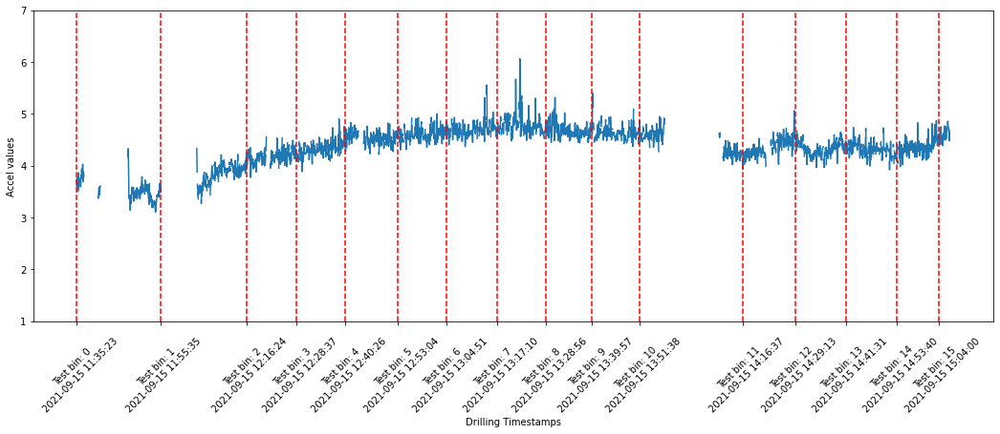

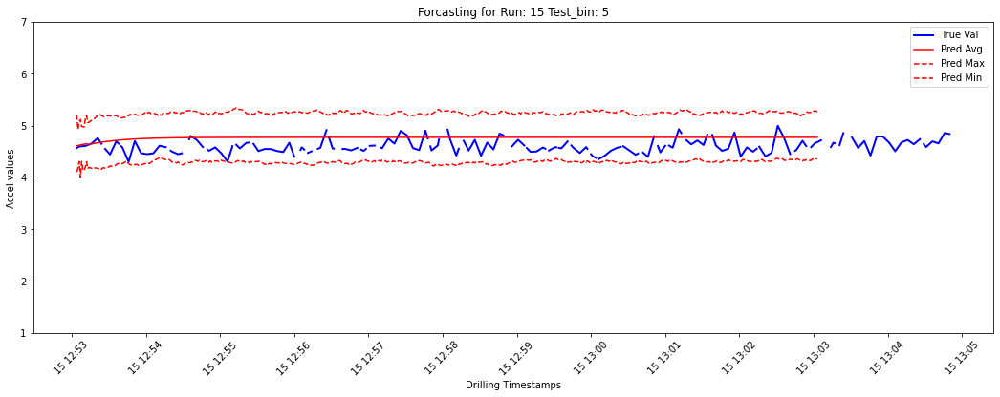

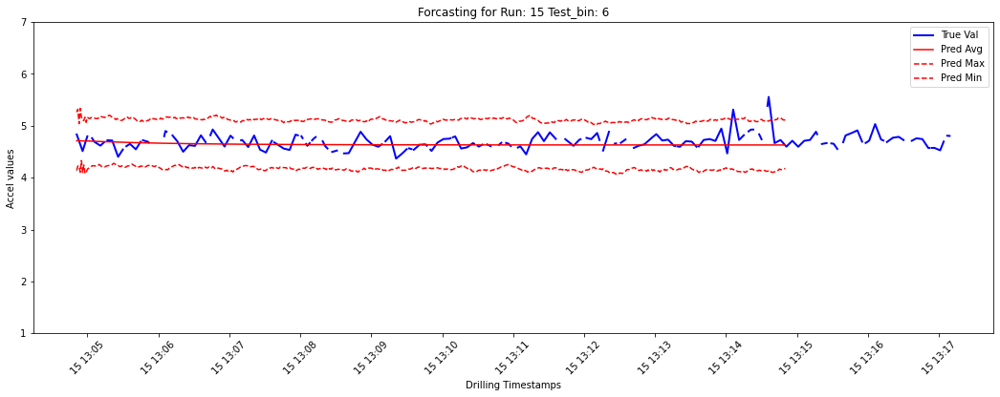

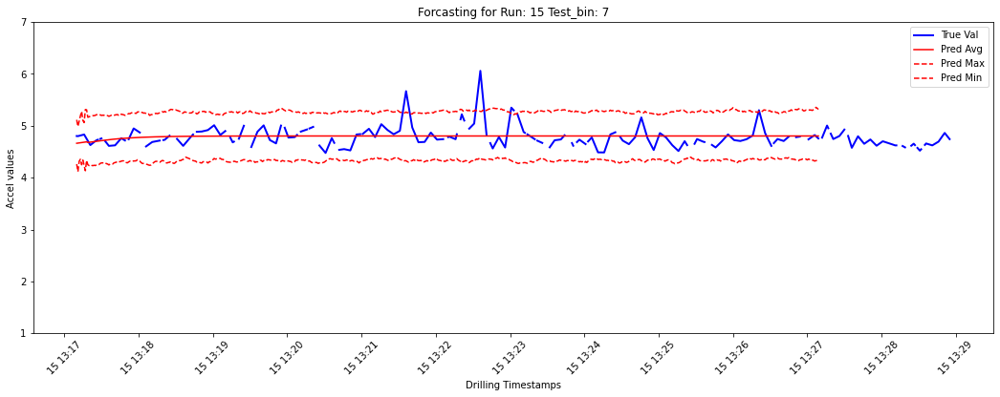

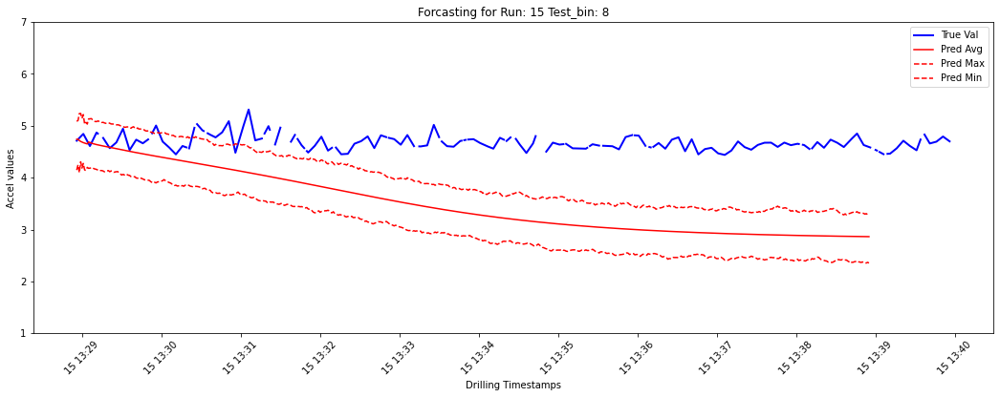

...

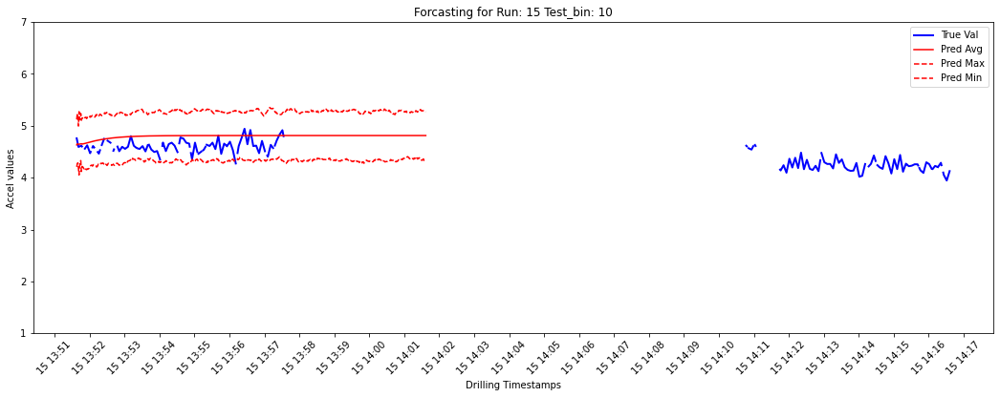

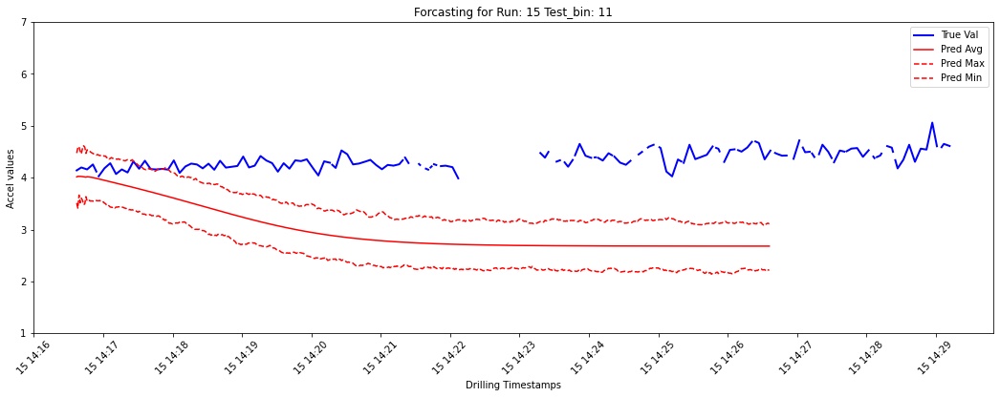

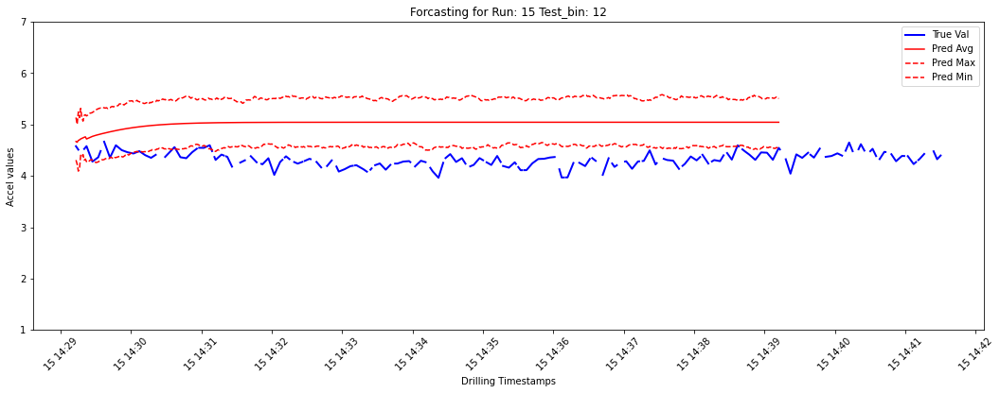

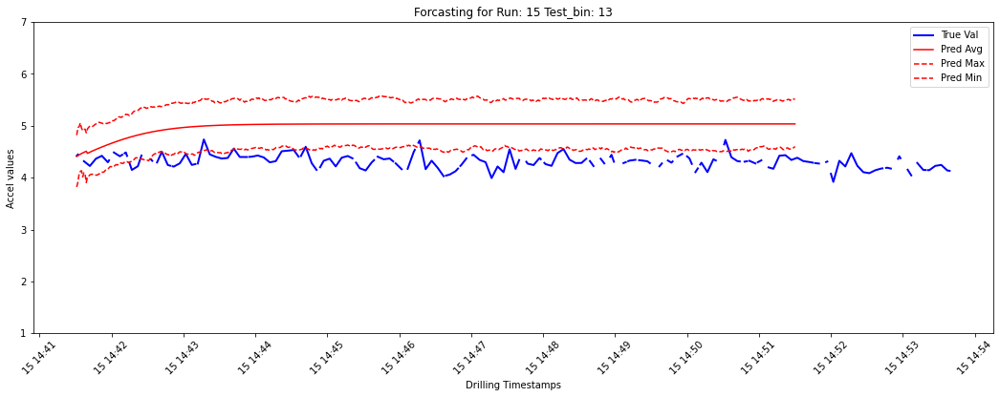

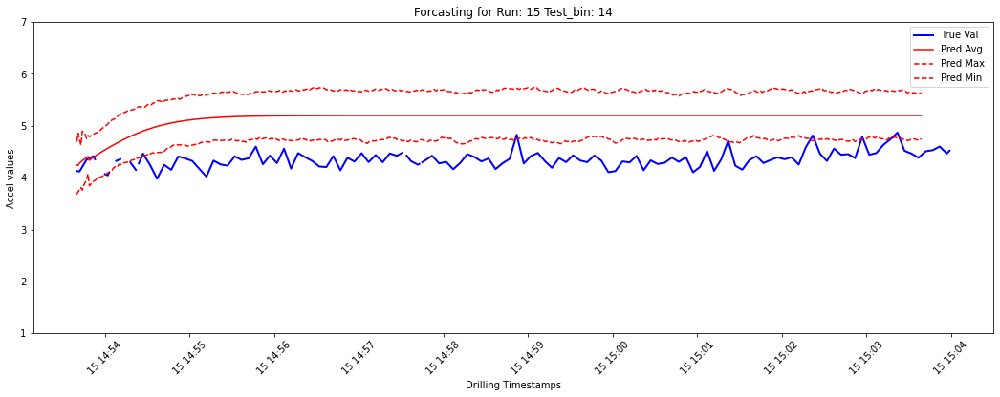

['Test bin: 0\n2021-09-15 11:35:23', 'Test bin: 1\n2021-09-15 11:55:35', 'Test bin: 2\n2021-09-15 12:16:24', 'Test bin: 3\n2021-09-15 12:28:37', 'Test bin: 4\n2021-09-15 12:40:26', 'Test bin: 5\n2021-09-15 12:53:04', 'Test bin: 6\n2021-09-15 13:04:51', 'Test bin: 7\n2021-09-15 13:17:10', 'Test bin: 8\n2021-09-15 13:28:56', 'Test bin: 9\n2021-09-15 13:39:57', 'Test bin: 10\n2021-09-15 13:51:38', 'Test bin: 11\n2021-09-15 14:16:37', 'Test bin: 12\n2021-09-15 14:29:13', 'Test bin: 13\n2021-09-15 14:41:31', 'Test bin: 14\n2021-09-15 14:53:40', 'Test bin: 15\n2021-09-15 15:04:00']


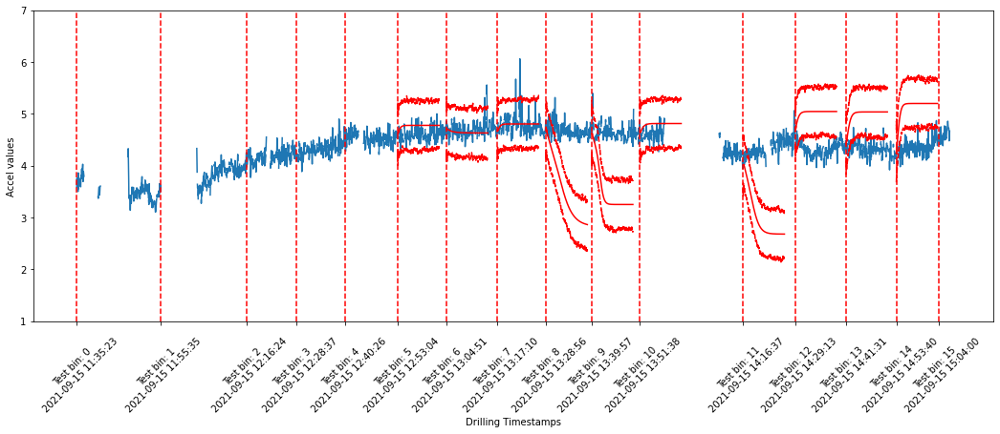

In [ ]:
mpg = ModelPredictionGenerator(
    experiment_settings="Forecast", df_data= df_org, run=15, 
    features=features, target=target, models = models, metrics = ["RMSE"],
    # relational_bin_config = {"bin_depth": 10, "test_bin_start": 10, "test_bin_end": 10, "rolling_bin_size": 20},
    forecast_config = {"bin_size": 10, "test_bin_start": 5, "test_bin_end": 14, "rolling_bin_size": 20, "skip_training": False},
    # lstm_forecast_time_step = 30, 
    lstm_forecast_look_back=30,
    debug = 0, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
mpg.plot_overall_data_visualization()
mpg.plot_binwise_details_forecast()
mpg.plot_overall_forecast_visualization()

About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
The predictions of the models have been saved in file predicted_outputs.csv
['Test bin: 0\n2021-09-15 11:35:23', 'Test bin: 1\n2021-09-15 11:55:35', 'Test bin: 2\n2021-09-15 12:16:24', 'Test bin: 3\n2021-09-15 12:28:37', 'Test bin: 4\n2021-09-15 12:40:26', 'Test bin: 5\n2021-09-15 12:53:04', 'Test bin: 6\n2021-09-15 13:04:51', 'Test bin: 7\n2021-09-15 13:17:10', 'Test bin: 8\n2021-09-15 13:28:56', 'Test bin: 9\n2021-09-15 13:3

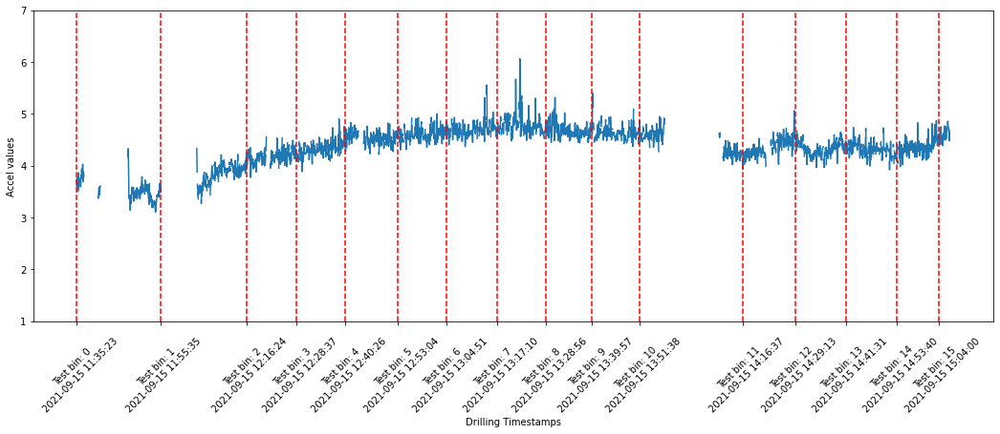

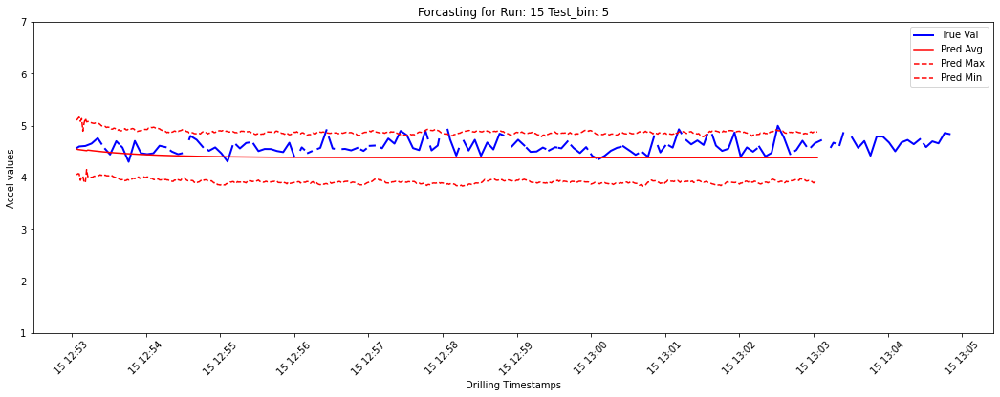

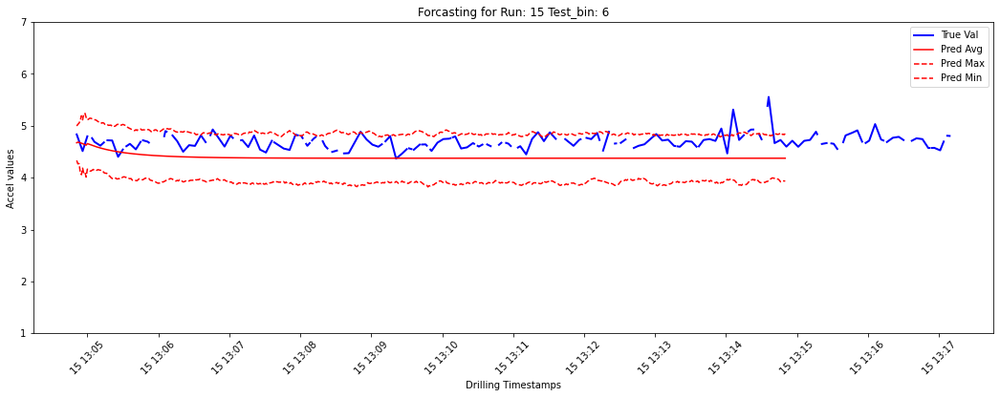

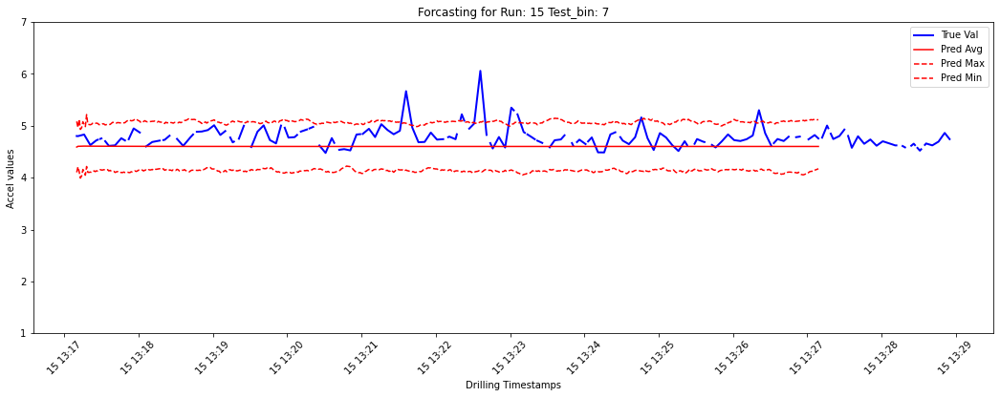

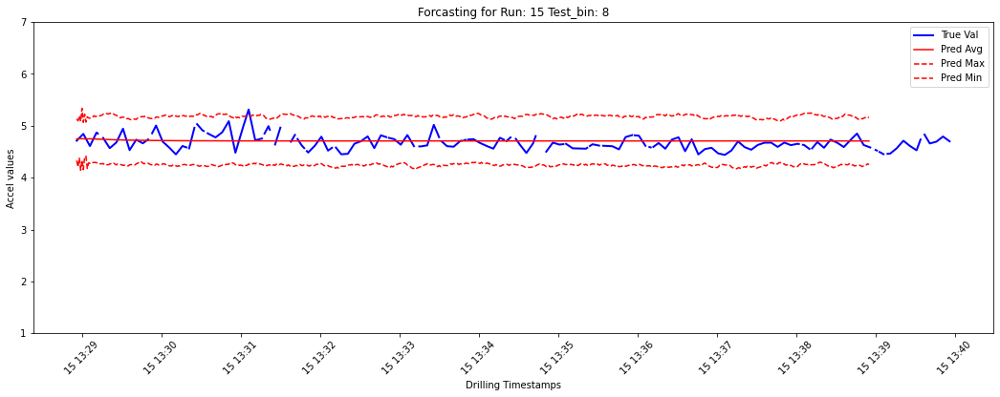

...

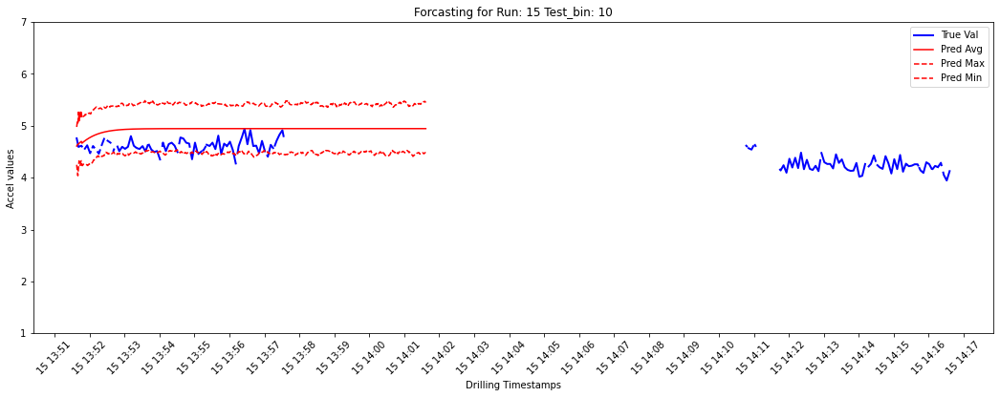

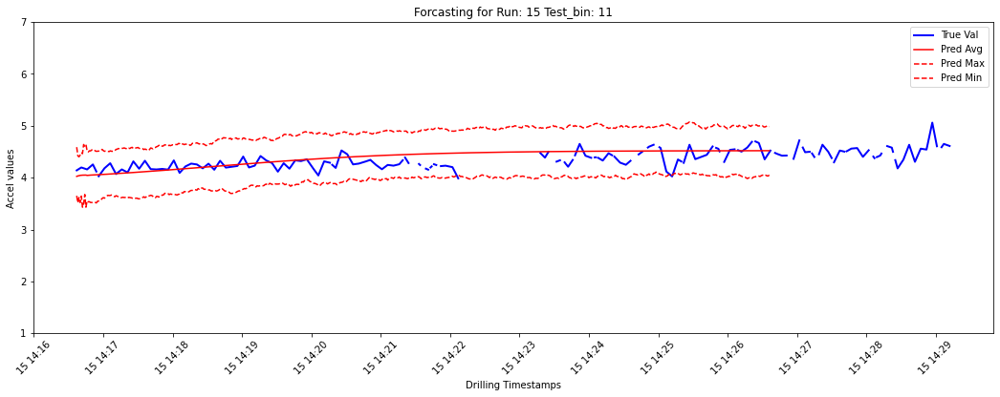

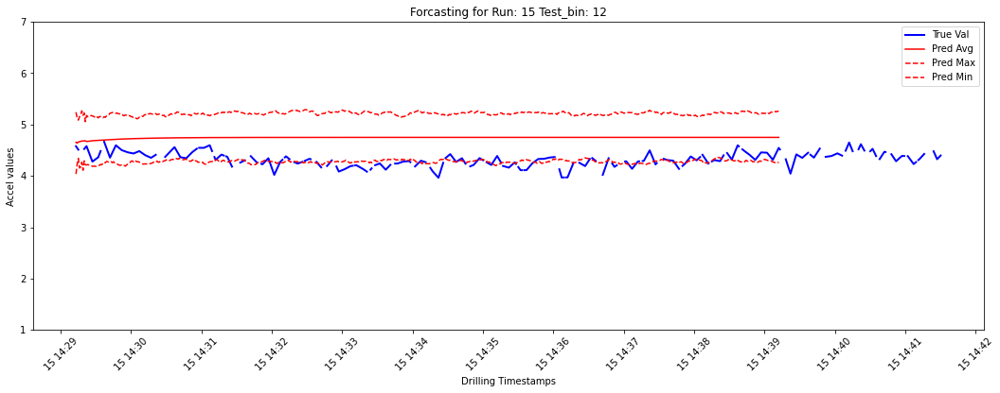

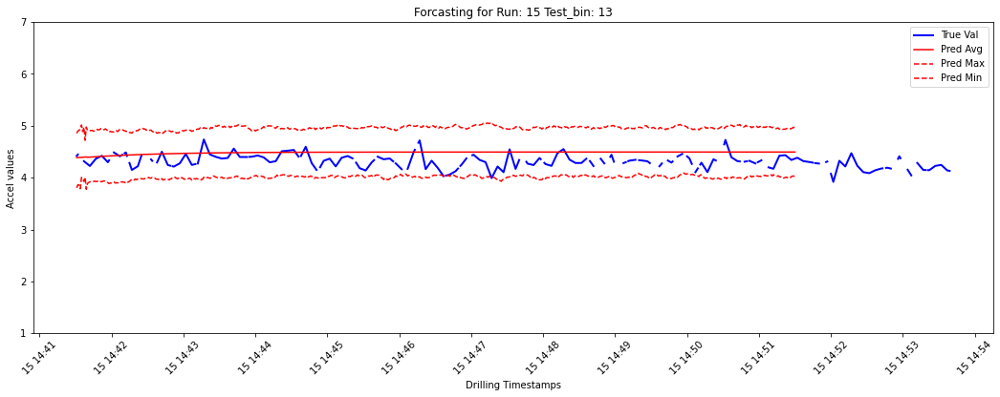

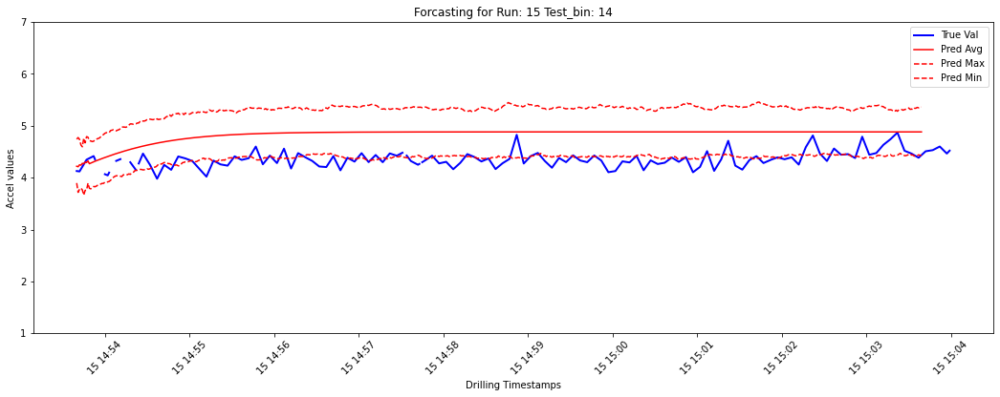

['Test bin: 0\n2021-09-15 11:35:23', 'Test bin: 1\n2021-09-15 11:55:35', 'Test bin: 2\n2021-09-15 12:16:24', 'Test bin: 3\n2021-09-15 12:28:37', 'Test bin: 4\n2021-09-15 12:40:26', 'Test bin: 5\n2021-09-15 12:53:04', 'Test bin: 6\n2021-09-15 13:04:51', 'Test bin: 7\n2021-09-15 13:17:10', 'Test bin: 8\n2021-09-15 13:28:56', 'Test bin: 9\n2021-09-15 13:39:57', 'Test bin: 10\n2021-09-15 13:51:38', 'Test bin: 11\n2021-09-15 14:16:37', 'Test bin: 12\n2021-09-15 14:29:13', 'Test bin: 13\n2021-09-15 14:41:31', 'Test bin: 14\n2021-09-15 14:53:40', 'Test bin: 15\n2021-09-15 15:04:00']


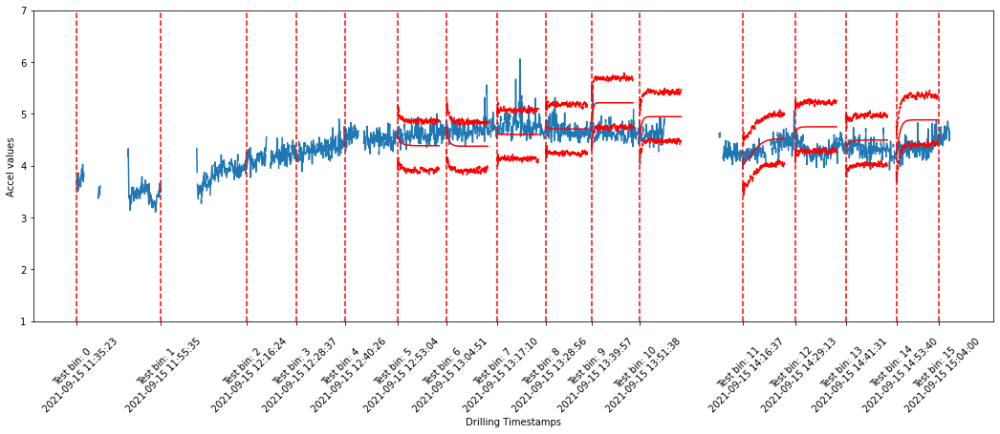

In [ ]:
mpg = ModelPredictionGenerator(
    experiment_settings="Forecast", df_data= df_org, run=15, 
    features=features, target=target, models = models, metrics = ["RMSE"],
    # relational_bin_config = {"bin_depth": 10, "test_bin_start": 10, "test_bin_end": 10, "rolling_bin_size": 20},
    forecast_config = {"bin_size": 10, "test_bin_start": 5, "test_bin_end": 14, "rolling_bin_size": 20, "skip_training": False},
    # lstm_forecast_time_step = 30, 
    lstm_forecast_look_back=10,
    debug = 0, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
mpg.plot_overall_data_visualization()
mpg.plot_binwise_details_forecast()
mpg.plot_overall_forecast_visualization()

About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
The predictions of the models have been saved in file predicted_outputs.csv
['Test bin: 0\n2021-09-15 11:35:23', 'Test bin: 1\n2021-09-15 11:55:35', 'Test bin: 2\n2021-09-15 12:16:24', 'Test bin: 3\n2021-09-15 12:28:37', 'Test bin: 4\n2021-09-15 12:40:26', 'Test bin: 5\n2021-09-15 12:53:04', 'Test bin: 6\n2021-09-15 13:04:51', 'Test bin: 7\n2021-09-15 13:17:10', 'Test bi

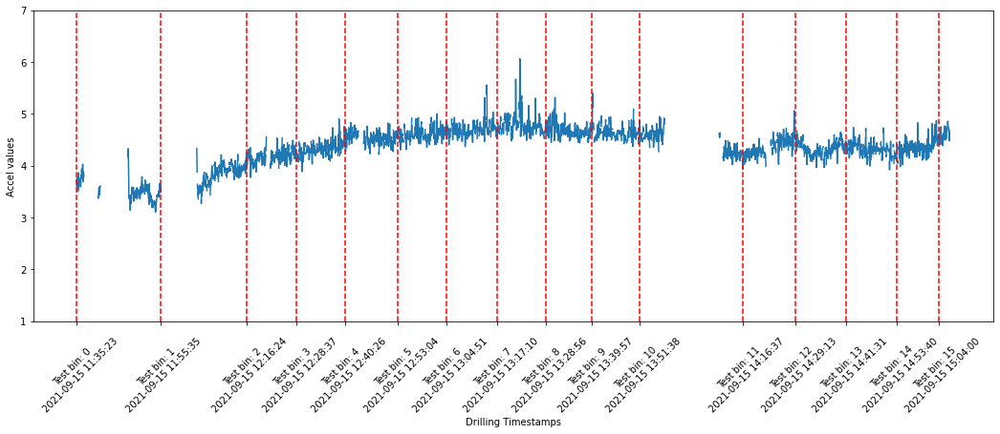

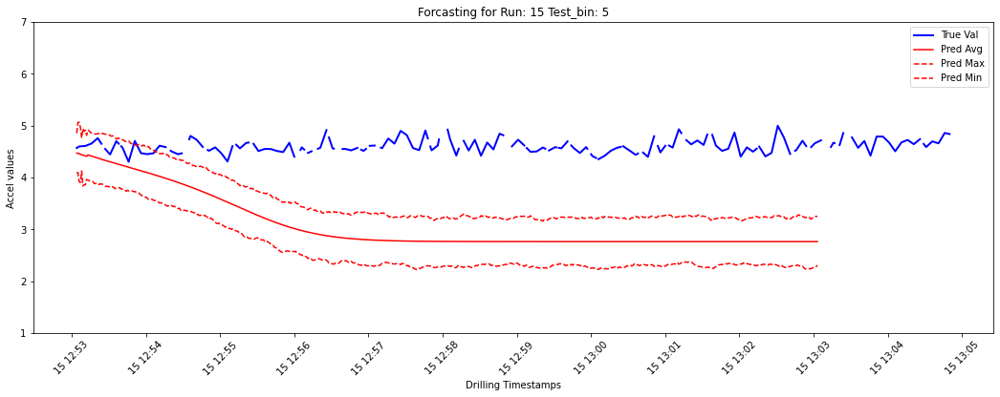

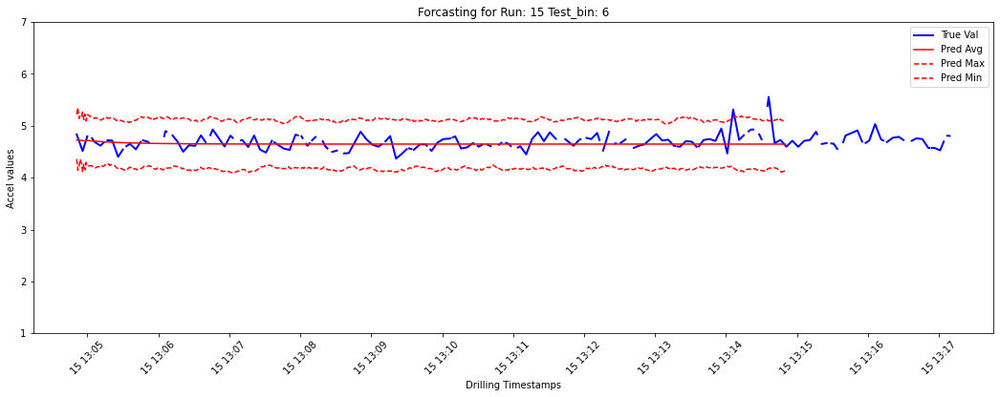

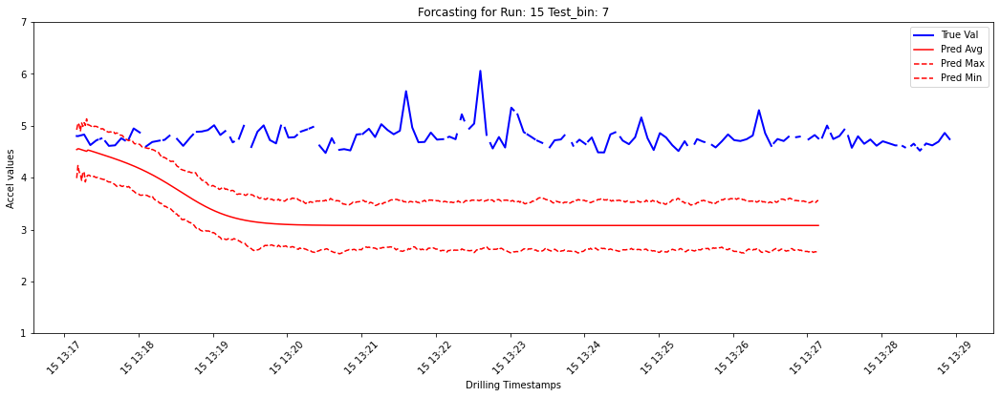

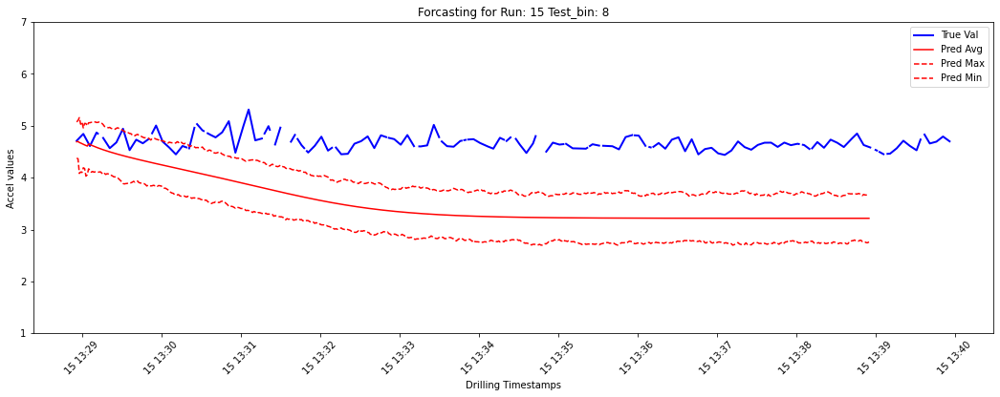

...

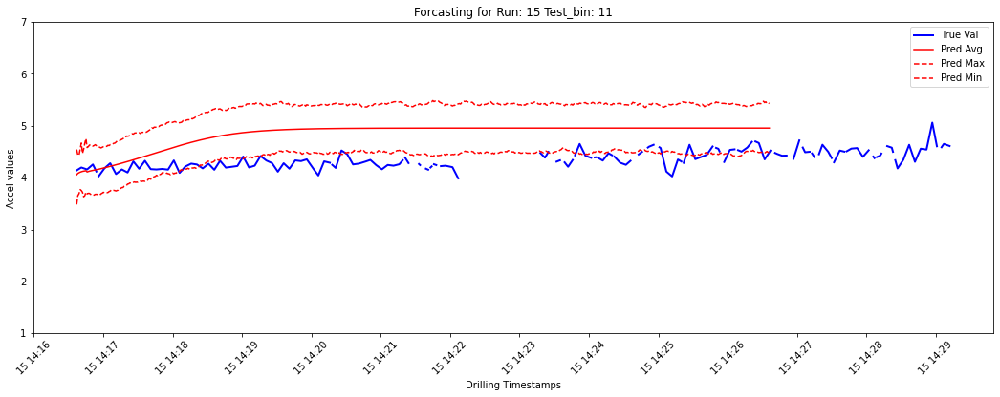

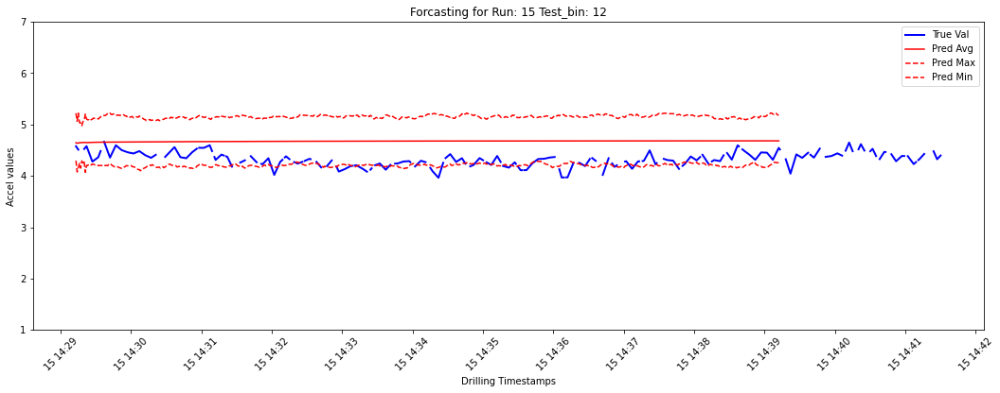

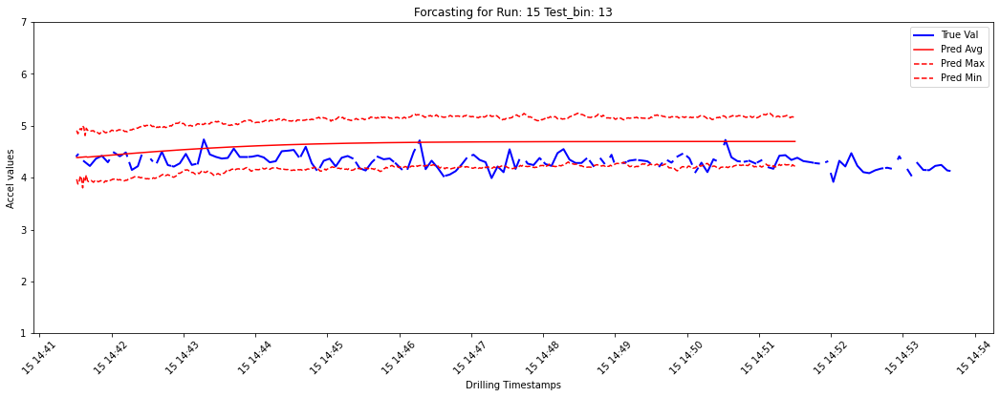

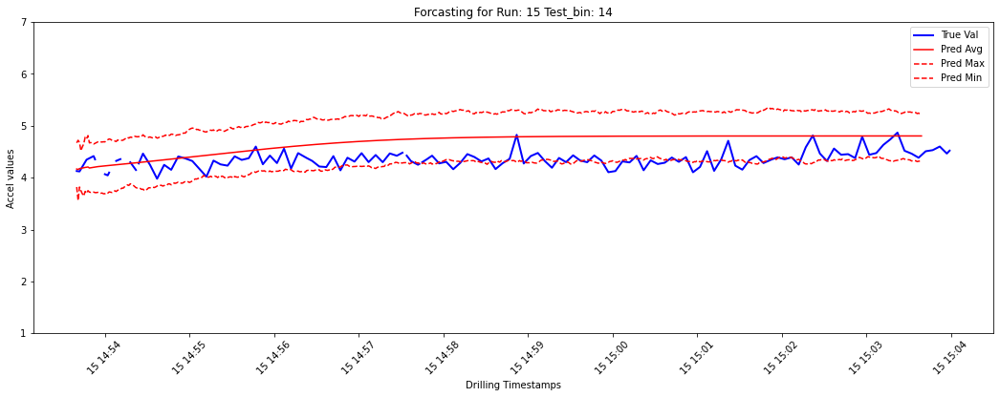

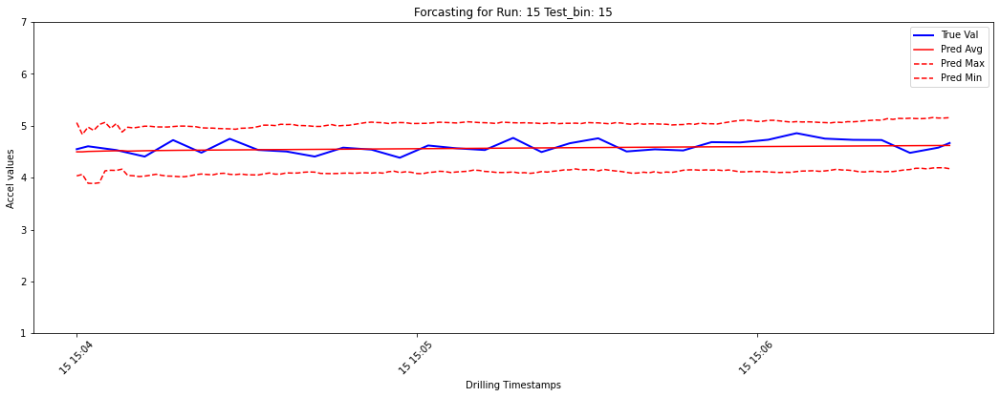

['Test bin: 0\n2021-09-15 11:35:23', 'Test bin: 1\n2021-09-15 11:55:35', 'Test bin: 2\n2021-09-15 12:16:24', 'Test bin: 3\n2021-09-15 12:28:37', 'Test bin: 4\n2021-09-15 12:40:26', 'Test bin: 5\n2021-09-15 12:53:04', 'Test bin: 6\n2021-09-15 13:04:51', 'Test bin: 7\n2021-09-15 13:17:10', 'Test bin: 8\n2021-09-15 13:28:56', 'Test bin: 9\n2021-09-15 13:39:57', 'Test bin: 10\n2021-09-15 13:51:38', 'Test bin: 11\n2021-09-15 14:16:37', 'Test bin: 12\n2021-09-15 14:29:13', 'Test bin: 13\n2021-09-15 14:41:31', 'Test bin: 14\n2021-09-15 14:53:40', 'Test bin: 15\n2021-09-15 15:04:00']


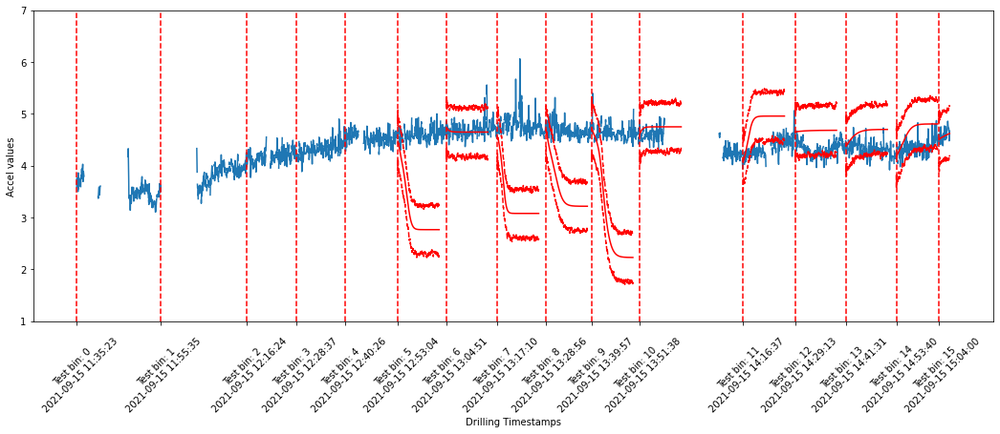

In [ ]:
mpg = ModelPredictionGenerator(
    experiment_settings="Forecast", df_data= df_org, run=15, 
    features=features, target=target, models = models, metrics = ["RMSE"],
    # relational_bin_config = {"bin_depth": 10, "test_bin_start": 10, "test_bin_end": 10, "rolling_bin_size": 20},
    forecast_config = {"bin_size": 10, "test_bin_start": 5, "test_bin_end": 20, "rolling_bin_size": 20, "skip_training": False},
    # lstm_forecast_time_step = 30, 
    lstm_forecast_look_back=120,
    debug = 0, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
mpg.plot_overall_data_visualization()
mpg.plot_binwise_details_forecast()
mpg.plot_overall_forecast_visualization()

In [ ]:
ssd

In [ ]:
mpg = ModelPredictionGenerator(
    experiment_settings="Forecast", df_data= df_org, run=15, 
    features=features, target=target, models = models, metrics = ["RMSE"],
    # relational_bin_config = {"bin_depth": 10, "test_bin_start": 10, "test_bin_end": 10, "rolling_bin_size": 20},
    forecast_config = {"bin_size": 10, "test_bin_start": 5, "test_bin_end": 20, "rolling_bin_size": 20, "skip_training": False},
    # lstm_forecast_time_step = 30, 
    lstm_forecast_look_back=200,
    debug = 0, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
mpg.plot_overall_data_visualization()
mpg.plot_binwise_details_forecast()
mpg.plot_overall_forecast_visualization()

About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions


About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
About to make predictions
Saved object to a file: y_pred
The predictions of the models have been saved in file predicted_outputs.csv
['Test bin: 0\n2021-09-15 11:35:23', 'Test bin: 1\n2021-09-15 11:55:35', 'Test bin: 2\n2021-09-15 12:16:24', 'Test bin: 3\n2021-09-15 12:28:37', 'Test bin: 4\n2021-09-15 12:40:26', 'Test bin: 5\n2021-09-15 12:53:04', 'Test bin: 6\n2021-09-15 13:04:51', 'Test bin: 7\n2021-09-15 13:17:10', 'Test bin: 8\n2021-09-15 13:28:56', 'Test bin: 9\n2021-09-15 13:39:57', 'Test bin: 10\n2021-09-15 13:51:38', 'Test bin: 11

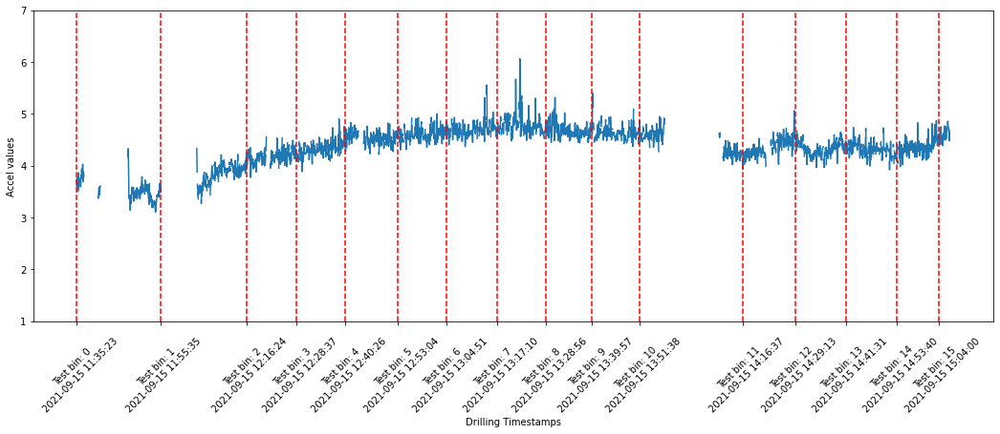

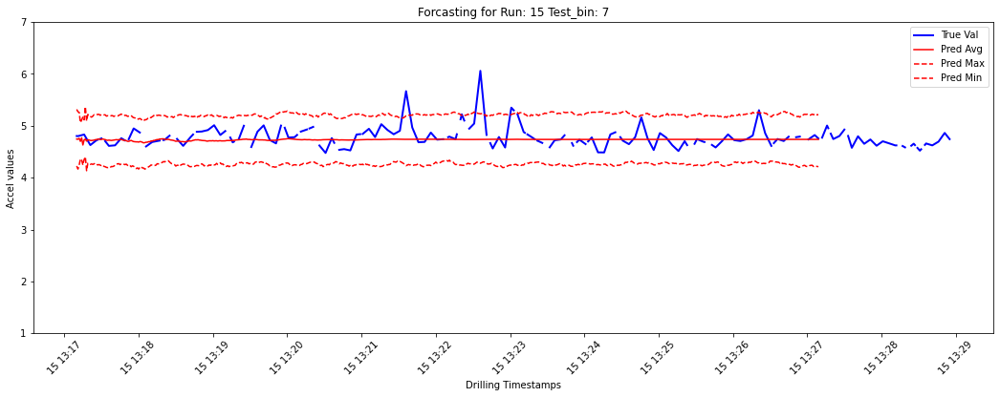

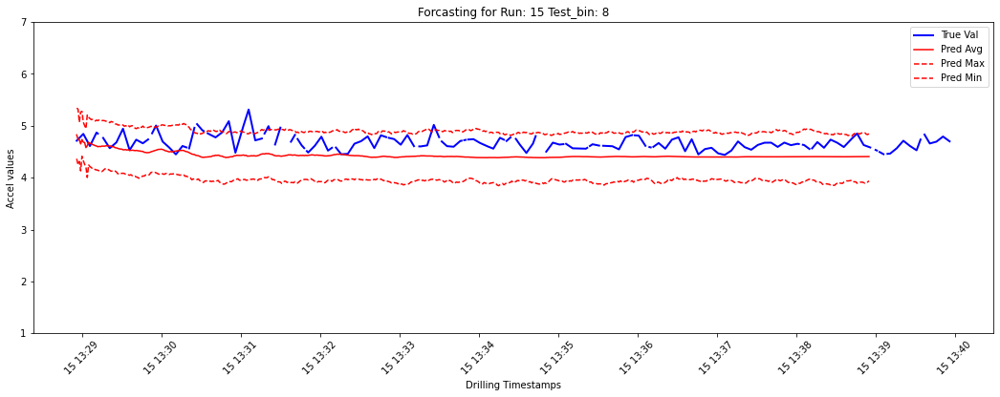

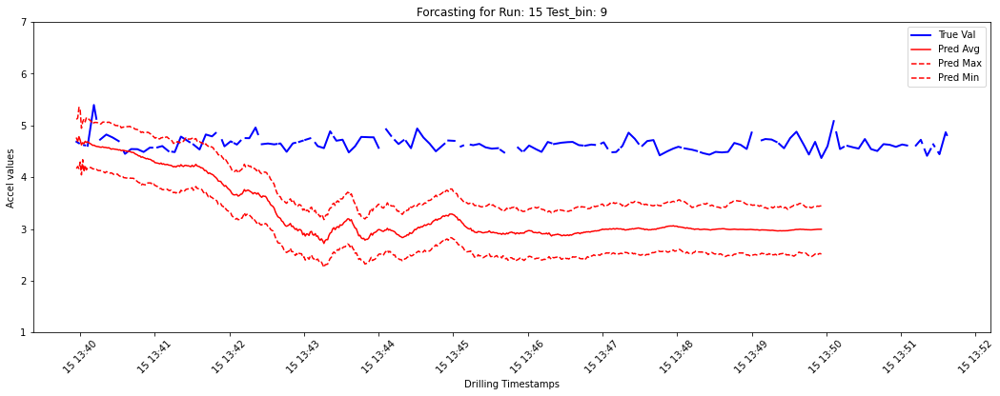

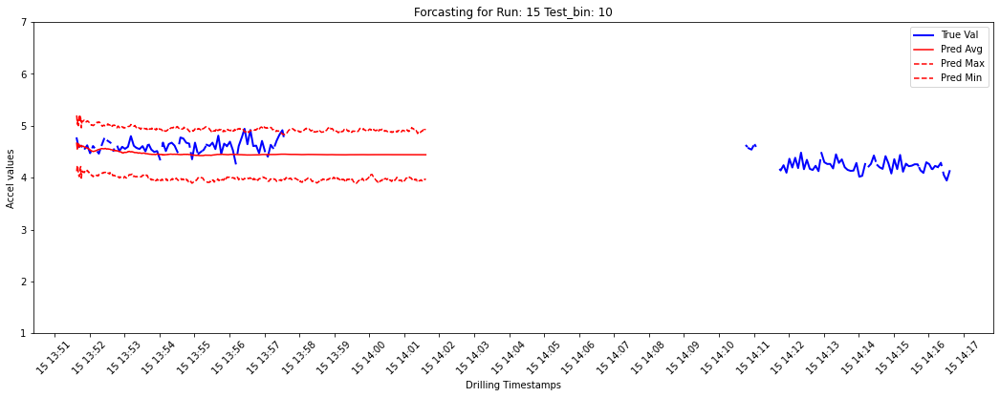

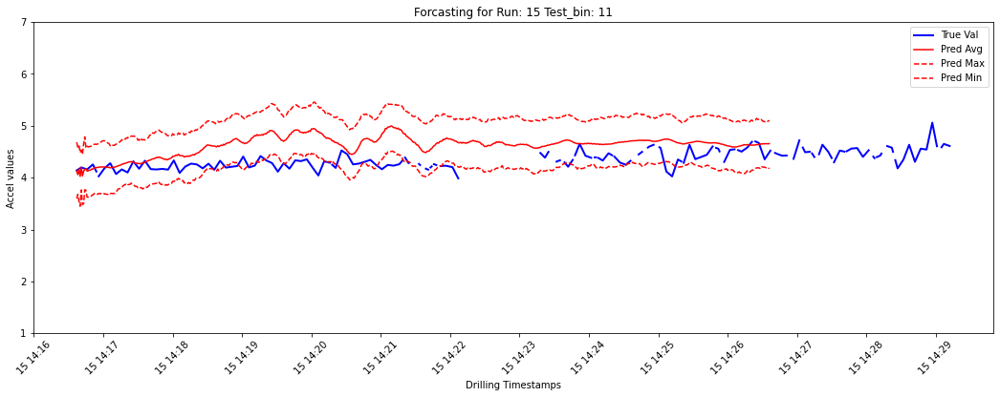

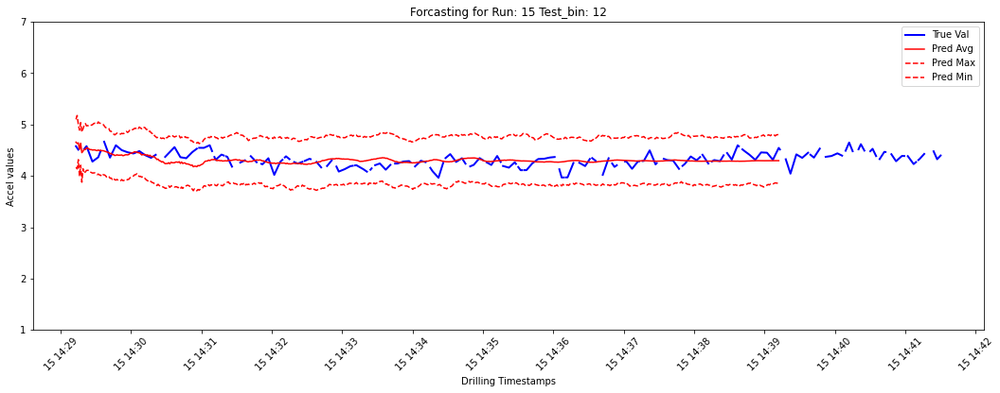

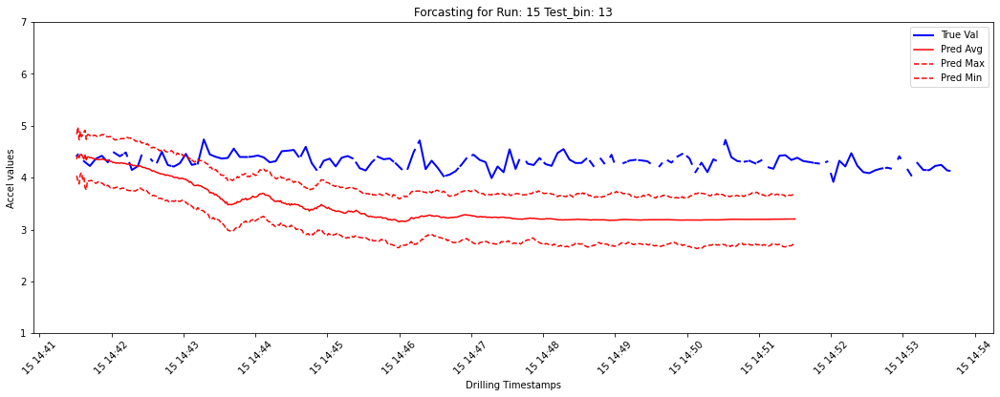

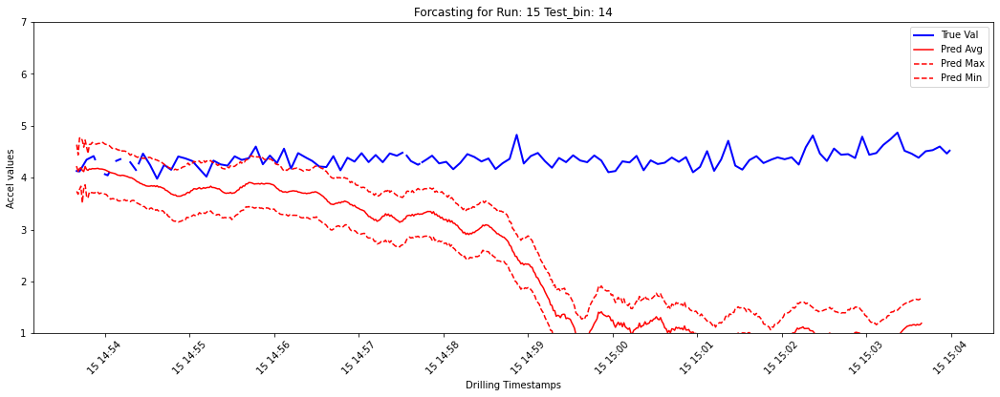

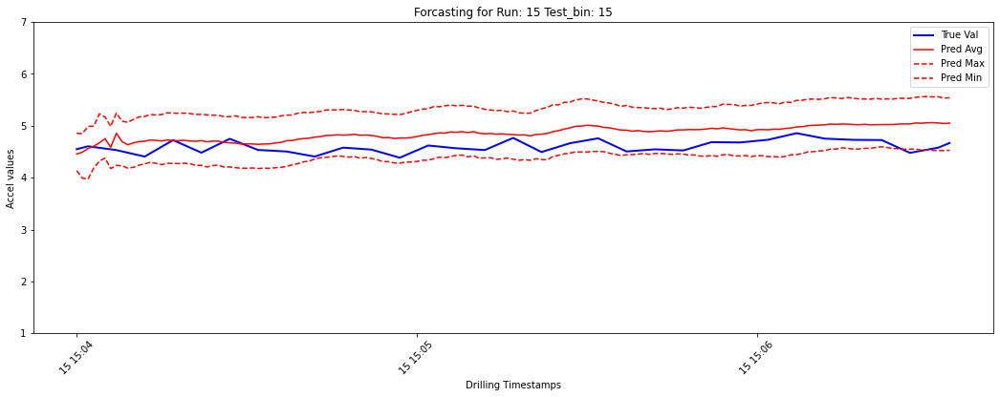

['Test bin: 0\n2021-09-15 11:35:23', 'Test bin: 1\n2021-09-15 11:55:35', 'Test bin: 2\n2021-09-15 12:16:24', 'Test bin: 3\n2021-09-15 12:28:37', 'Test bin: 4\n2021-09-15 12:40:26', 'Test bin: 5\n2021-09-15 12:53:04', 'Test bin: 6\n2021-09-15 13:04:51', 'Test bin: 7\n2021-09-15 13:17:10', 'Test bin: 8\n2021-09-15 13:28:56', 'Test bin: 9\n2021-09-15 13:39:57', 'Test bin: 10\n2021-09-15 13:51:38', 'Test bin: 11\n2021-09-15 14:16:37', 'Test bin: 12\n2021-09-15 14:29:13', 'Test bin: 13\n2021-09-15 14:41:31', 'Test bin: 14\n2021-09-15 14:53:40', 'Test bin: 15\n2021-09-15 15:04:00']


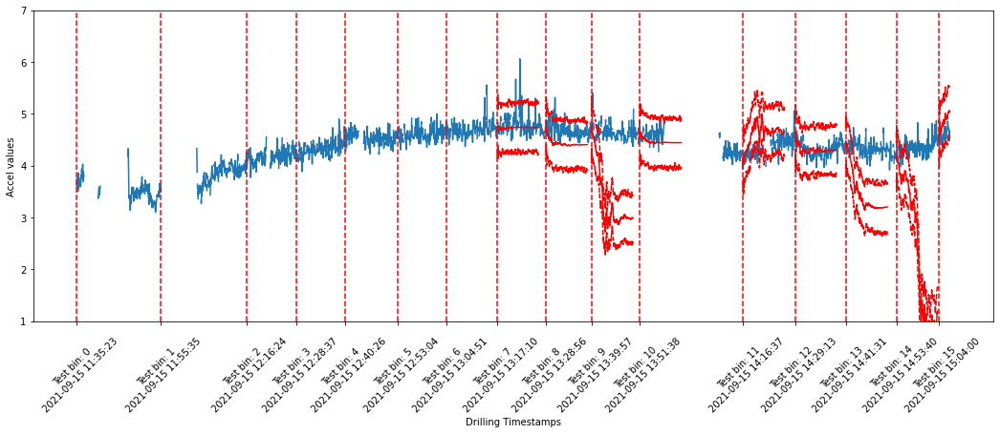

In [ ]:

mpg = ModelPredictionGenerator(
    experiment_settings="Forecast", df_data= df_org, run=15, 
    features=features, target=target, models = models, metrics = ["RMSE"],
    # relational_bin_config = {"bin_depth": 10, "test_bin_start": 10, "test_bin_end": 10, "rolling_bin_size": 20},
    forecast_config = {"bin_size": 10, "test_bin_start": 7, "test_bin_end": 20, "rolling_bin_size": 20, "skip_training": False},
    # lstm_forecast_time_step = 30, 
    lstm_forecast_look_back=100,
    debug = 0, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
mpg.plot_overall_data_visualization()
mpg.plot_binwise_details_forecast()
mpg.plot_overall_forecast_visualization()

In [ ]:
mpg = ModelPredictionGenerator(
    experiment_settings="Forecast", df_data= df_org, run=15, 
    features=features, target=target, models = models, metrics = ["RMSE"],
    # relational_bin_config = {"bin_depth": 10, "test_bin_start": 10, "test_bin_end": 10, "rolling_bin_size": 20},
    forecast_config = {"bin_size": 10, "test_bin_start": 12, "test_bin_end": 12, "rolling_bin_size": 20, "skip_training": False},
    # lstm_forecast_time_step = 30, 
    lstm_forecast_look_back=400,
    debug = 0, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
mpg.plot_overall_data_visualization()
mpg.plot_binwise_details_forecast()
mpg.plot_overall_forecast_visualization()

In [ ]:
data = random.uniform( -1.2, 1.2)
print(data)

-0.2662518104468181


In [ ]:
mpg.plot_overall_forecast_visualization()

In [ ]:
y_train = random.randint(40, 45, size=100)
y_pred = np.arange(10)
sd = statistics.stdev(y_train)
y_pred_max = [ d+sd for d in y_pred]
y_pred_min = [ d-sd for d in y_pred]
# print(y_train)
print(sd)
print(y_pred_max)
print(y_pred_min)


1.4142135623730951
[1.4142135623730951, 2.414213562373095, 3.414213562373095, 4.414213562373095, 5.414213562373095, 6.414213562373095, 7.414213562373095, 8.414213562373096, 9.414213562373096, 10.414213562373096]
[-1.4142135623730951, -0.41421356237309515, 0.5857864376269049, 1.5857864376269049, 2.585786437626905, 3.585786437626905, 4.585786437626905, 5.585786437626905, 6.585786437626905, 7.585786437626905]
time: 273 ms


In [ ]:
data = np.arange(10)
tsg = TimeseriesGenerator(data, data, length=9)
print(tsg[0])
# for d in tsg:
#     print(d)

(array([[0, 1, 2, 3, 4, 5, 6, 7, 8]]), array([9]))
time: 276 ms


In [ ]:
m1 = {'k1': 4, 'k2': 5}
m2 = {'k3': 4, 'k4': 5}
m = {**m1, **m2}

print(m)

{'k1': 4, 'k2': 5, 'k3': 4, 'k4': 5}
time: 264 ms


#### LSTM_SF

In [ ]:






from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from tensorflow import keras


class LSTM_Model():
    def __init__(self, train_test_pair, time_steps):
        self.X_train, self.y_train, self.X_test, self.y_test = train_test_pair
        self.time_steps = time_steps

        # print(self.X_train)
    

    def get_LSTM_Model(self):
        lstm_model = tf.keras.models.Sequential([
        # Shape [batch, time, features] => [batch, time, lstm_units]
        tf.keras.layers.LSTM(32, return_sequences=False),
        # Shape => [batch, time, features]
        tf.keras.layers.Dense(units=1)
        ])
        return lstm_model



    def RNN_compile_and_fit(self, model, train_ds, model_checkpoint_path, max_epochs = 100, patience=2):
        early_stopping = tf.keras.callbacks.EarlyStopping(monitor='loss',
                                                            patience=patience,
                                                            mode='min')
                                                          
        monitor_it = tf.keras.callbacks.ModelCheckpoint(model_checkpoint_path, monitor='loss',\
                                                    verbose=0, save_best_only=True,\
                                                    save_weights_only=False,\
                                                    mode='min')

        model.compile(loss=tf.losses.MeanSquaredError(),
                        optimizer=tf.optimizers.Adam(),
                        metrics=[tf.metrics.MeanSquaredError(), tf.metrics.MeanSquaredLogarithmicError()],
                        run_eagerly=True
                        )

        history = model.fit(train_ds, epochs=max_epochs, callbacks=[early_stopping, monitor_it], verbose=0)
        return history


    def make_dataset(self, X, y, batch_size=32, suffle=False):
        # print("========> make dataset method")
        # print(X)
        data = np.array(X, dtype=np.float32)
        target = np.array(y, dtype=np.float32)
        ds = tf.keras.utils.timeseries_dataset_from_array(data=data, 
                                                          targets=target, 
                                                          sequence_length=self.time_steps, 
                                                          sequence_stride=1, 
                                                          shuffle=suffle, 
                                                          batch_size=batch_size)
        return ds


    def get_train_test_dataset(self):
        # Make train dataset
        X = self.X_train.copy()
        y = self.y_train[self.time_steps-1:]
        # print("Len X: %d Len y: %d" % (len(X), len(y)))
        train_ds = self.make_dataset(X, y, suffle=True)


        # print("Test dataset X: ")
        
        # Make test dataset
        X = self.X_train.tail(self.time_steps-1)
        # print(self.X_test)
        X = X.append(self.X_test)
        # print(X)
        y = self.y_test

        # print("Test dataset Len X: %d Len y: %d" % (len(X), len(y)))
        test_ds = self.make_dataset(X, y, suffle=False)

        # for ds in test_ds:
        #     print(ds)

        return train_ds, test_ds





    def get_prediction_RNN(self, model_checkpoint_path, skip_training=True, max_epochs=100):
        train_ds, test_ds = self.get_train_test_dataset()
        lstm_model = self.get_LSTM_Model()

        if skip_training and os.path.exists(model_checkpoint_path):
            lstm_model = tf.keras.models.load_model(model_checkpoint_path)
            print("=========> Skipping trainging and loading previously trained weights")
        else:
            self.RNN_compile_and_fit(lstm_model, train_ds, model_checkpoint_path, max_epochs = max_epochs, patience=2)
            # lstm_model.save(model_save_path)

        y_pred = lstm_model.predict(test_ds)
        y_pred = np.clip(y_pred, 0, max(y_pred))
        y_pred = [p[0] for p in y_pred]
        y_pred = np.array(y_pred)
        return y_pred, lstm_model




In [ ]:
models=["LSTM_SF", "RNN", "LR", "RF"]

mpg = ModelPredictionGenerator(
    experiment_settings="Relational_Bins", df_data= df_org, run=15, 
    features=features, target=target, models = models, metrics = metrics,
    K_fold=10,
    relational_bin_config = {"bin_depth": 10, "test_bin_start": 10, "test_bin_end": 10, "rolling_bin_size": 20},
    lstm_time_step = 60, lstm_sf_look_back=300,
    debug = 2, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
mpg.generate_metrics_plot()

# mpg.plot_features(test_bin=5534)
for test_bin in test_bins:
    mpg.plot_model_predictions(test_bin=test_bin, smooth_N=5)

Run: 15 and total data points: 11262
====> Test bin: 5524
Epoch 1/100
143/143 [==============================] - 9s 62ms/step - loss: 1.8452
Epoch 2/100
143/143 [==============================] - 9s 62ms/step - loss: 0.0675
Epoch 3/100
143/143 [==============================] - 10s 67ms/step - loss: 0.0287
Epoch 4/100
143/143 [==============================] - 9s 62ms/step - loss: 0.0240
Epoch 5/100
143/143 [==============================] - 9s 62ms/step - loss: 0.0200
Epoch 6/100
143/143 [==============================] - 9s 62ms/step - loss: 0.0195
Epoch 7/100
143/143 [==============================] - 9s 62ms/step - loss: 0.0187
Epoch 8/100
143/143 [==============================] - 9s 62ms/step - loss: 0.0190
Epoch 9/100
143/143 [==============================] - 9s 61ms/step - loss: 0.0169
Epoch 10/100
143/143 [==============================] - 9s 62ms/step - loss: 0.0160
Epoch 11/100
143/143 [==============================] - 9s 62ms/step - loss: 0.0152
Epoch 12/100
143/143 [====

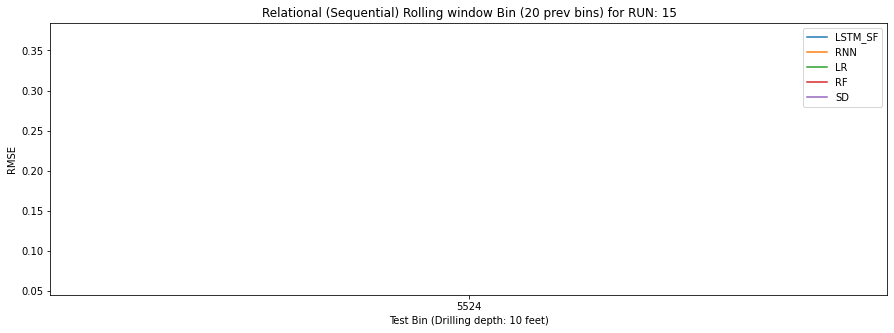

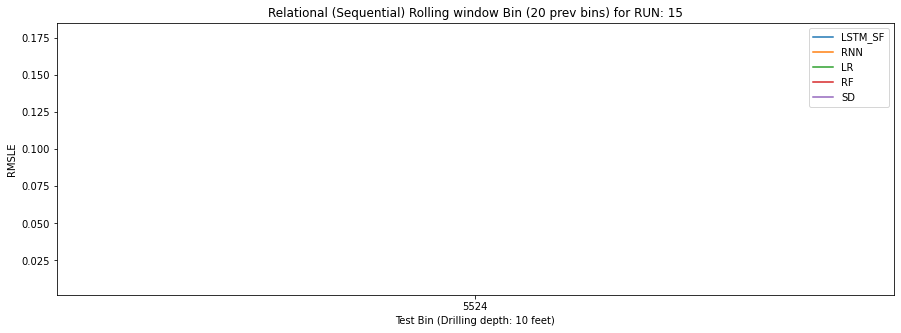

==========>
Rank of the models for Metric: RMSE
Test Bin (5524) 
Mean: 4.76 and SD: 0.18
LSTM_SF => 0.06 (RMSE)
RF => 0.20 (RMSE)
RNN => 0.25 (RMSE)
LR => 0.37 (RMSE)

(4.286672230230571, 6.143847165562192)


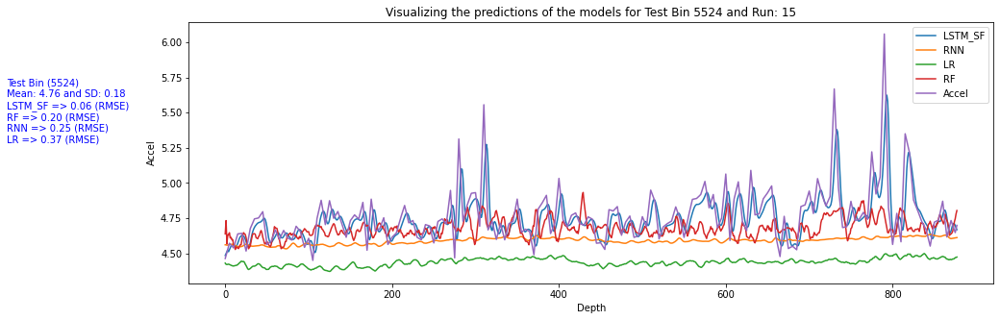

==========>
Rank of the models for Metric: RMSE
Test Bin (5524) 
Mean: 4.76 and SD: 0.18
LSTM_SF => 0.06 (RMSE)
RF => 0.20 (RMSE)
RNN => 0.25 (RMSE)
LR => 0.37 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5524) 
Mean: 4.76 and SD: 0.18
LSTM_SF => 0.01 (RMSLE)
RF => 0.03 (RMSLE)
RNN => 0.04 (RMSLE)
LR => 0.06 (RMSLE)



In [ ]:
models=["LSTM_SF", "RNN", "LR", "RF"]
mpg = ModelPredictionGenerator(
    experiment_settings="Relational_Bins", df_data= df_org, run=15, 
    features=features, target=target, models = models, metrics = metrics,
    K_fold=10,
    relational_bin_config = {"bin_depth": 10, "test_bin_start": 10, "test_bin_end": 10, "rolling_bin_size": 20},
    lstm_time_step = 60, lstm_sf_look_back=300,
    debug = 2, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
# mpg.generate_metrics_plot()

# mpg.plot_features(test_bin=5534)
for test_bin in test_bins:
    mpg.plot_model_predictions(test_bin=test_bin, smooth_N=5)

====> Test bin: 5524
Epoch 1/100
150/150 [==============================] - 7s 44ms/step - loss: 2.1518
Epoch 2/100
150/150 [==============================] - 6s 37ms/step - loss: 0.1686
Epoch 3/100
150/150 [==============================] - 6s 39ms/step - loss: 0.1239
Epoch 4/100
150/150 [==============================] - 10s 67ms/step - loss: 0.0383
Epoch 5/100
150/150 [==============================] - 6s 40ms/step - loss: 0.0215
Epoch 6/100
150/150 [==============================] - 6s 38ms/step - loss: 0.0222
Epoch 7/100
150/150 [==============================] - 8s 52ms/step - loss: 0.0185
Epoch 8/100
150/150 [==============================] - 7s 44ms/step - loss: 0.0181
Epoch 9/100
150/150 [==============================] - 7s 48ms/step - loss: 0.0167
Epoch 10/100
150/150 [==============================] - 6s 37ms/step - loss: 0.0171
Epoch 11/100
150/150 [==============================] - 6s 37ms/step - loss: 0.0159
Epoch 12/100
150/150 [==============================] - 6s 40ms

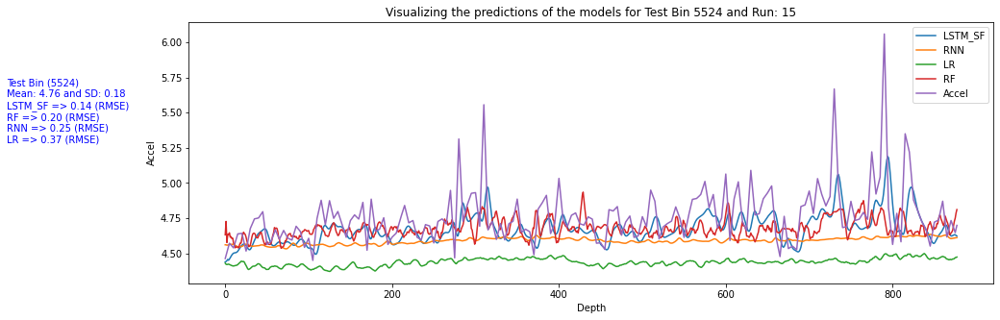

==========>
Rank of the models for Metric: RMSE
Test Bin (5524) 
Mean: 4.76 and SD: 0.18
LSTM_SF => 0.14 (RMSE)
RF => 0.20 (RMSE)
RNN => 0.25 (RMSE)
LR => 0.37 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5524) 
Mean: 4.76 and SD: 0.18
LSTM_SF => 0.02 (RMSLE)
RF => 0.03 (RMSLE)
RNN => 0.04 (RMSLE)
LR => 0.06 (RMSLE)



In [ ]:
models=["LSTM_SF", "RNN", "LR", "RF"]
mpg = ModelPredictionGenerator(
    experiment_settings="Relational_Bins", df_data= df_org, run=15, 
    features=features, target=target, models = models, metrics = metrics,
    K_fold=10,
    relational_bin_config = {"bin_depth": 10, "test_bin_start": 10, "test_bin_end": 10, "rolling_bin_size": 20},
    lstm_time_step = 60, lstm_sf_look_back=100,
    debug = 1, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
# mpg.generate_metrics_plot()

# mpg.plot_features(test_bin=5534)
for test_bin in test_bins:
    mpg.plot_model_predictions(test_bin=test_bin, smooth_N=5)

### Experiment Results

====> Test bin: 5524
=========> Skipping trainging and loading previously trained weights
The predictions of the models have been saved in file predicted_outputs.csv
==========>
Rank of the models for Metric: RMSE
Test Bin (5524) 
Mean: 4.76 and SD: 0.18
LSTM_SF => 0.16 (RMSE)
RF => 0.19 (RMSE)
RNN => 0.25 (RMSE)
LR => 0.37 (RMSE)

(4.286672230230571, 6.143847165562192)


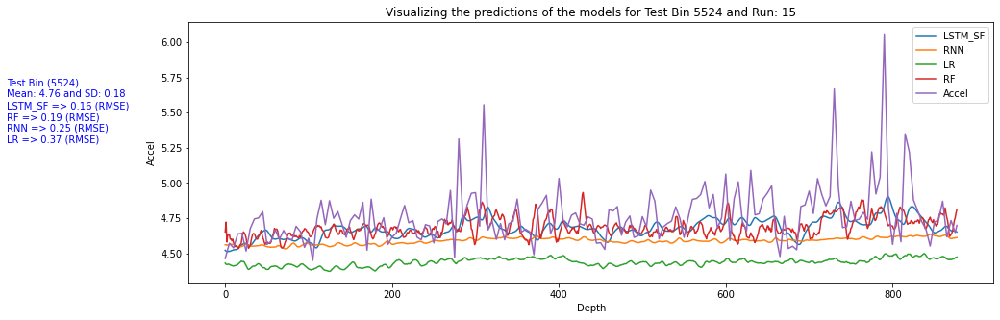

==========>
Rank of the models for Metric: RMSE
Test Bin (5524) 
Mean: 4.76 and SD: 0.18
LSTM_SF => 0.16 (RMSE)
RF => 0.19 (RMSE)
RNN => 0.25 (RMSE)
LR => 0.37 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5524) 
Mean: 4.76 and SD: 0.18
LSTM_SF => 0.03 (RMSLE)
RF => 0.03 (RMSLE)
RNN => 0.04 (RMSLE)
LR => 0.06 (RMSLE)



In [ ]:
models=["LSTM_SF", "RNN", "LR", "RF"]
mpg = ModelPredictionGenerator(
    experiment_settings="Relational_Bins", df_data= df_org, run=15, 
    features=features, target=target, models = models, metrics = metrics,
    K_fold=10,
    relational_bin_config = {"bin_depth": 10, "test_bin_start": 10, "test_bin_end": 10, "rolling_bin_size": 20},
    lstm_time_step = 60, lstm_sf_look_back=500,
    debug = 1, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
# mpg.generate_metrics_plot()

# mpg.plot_features(test_bin=5534)
for test_bin in test_bins:
    mpg.plot_model_predictions(test_bin=test_bin, smooth_N=5)

====> Test bin: 5554
=========> Skipping trainging and loading previously trained weights
The predictions of the models have been saved in file predicted_outputs.csv
==========>
Rank of the models for Metric: RMSE
Test Bin (5554) 
Mean: 4.09 and SD: 0.99
RNN => 0.38 (RMSE)
LSTM_SF => 0.42 (RMSE)
RF => 0.62 (RMSE)
LR => 0.81 (RMSE)

(-0.029725294263100666, 5.375649606489816)


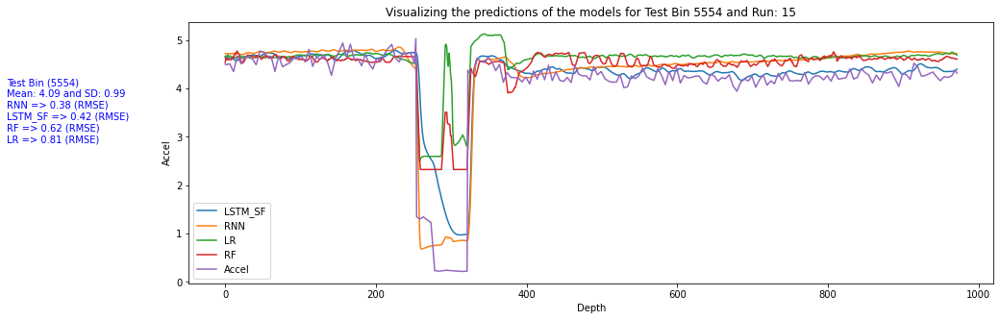

==========>
Rank of the models for Metric: RMSE
Test Bin (5554) 
Mean: 4.09 and SD: 0.99
RNN => 0.38 (RMSE)
LSTM_SF => 0.42 (RMSE)
RF => 0.62 (RMSE)
LR => 0.81 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5554) 
Mean: 4.09 and SD: 0.99
RNN => 0.12 (RMSLE)
LSTM_SF => 0.17 (RMSLE)
RF => 0.25 (RMSLE)
LR => 0.29 (RMSLE)



In [ ]:
models=["LSTM_SF", "RNN", "LR", "RF"]
mpg = ModelPredictionGenerator(
    experiment_settings="Relational_Bins", df_data= df_org, run=15, 
    features=features, target=target, models = models, metrics = metrics,
    K_fold=10,
    relational_bin_config = {"bin_depth": 10, "test_bin_start": 13, "test_bin_end": 13, "rolling_bin_size": 20},
    lstm_time_step = 60, lstm_sf_look_back=200,
    debug = 1, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
# mpg.generate_metrics_plot()

# mpg.plot_features(test_bin=5534)
for test_bin in test_bins:
    mpg.plot_model_predictions(test_bin=test_bin, smooth_N=5)

====> Test bin: 5544
=========> Skipping trainging and loading previously trained weights
The predictions of the models have been saved in file predicted_outputs.csv
==========>
Rank of the models for Metric: RMSE
Test Bin (5544) 
Mean: 4.63 and SD: 0.12
LSTM_SF => 0.03 (RMSE)
LR => 0.14 (RMSE)
RNN => 0.14 (RMSE)
RF => 0.20 (RMSE)

(4.231161980212564, 5.45261919814726)


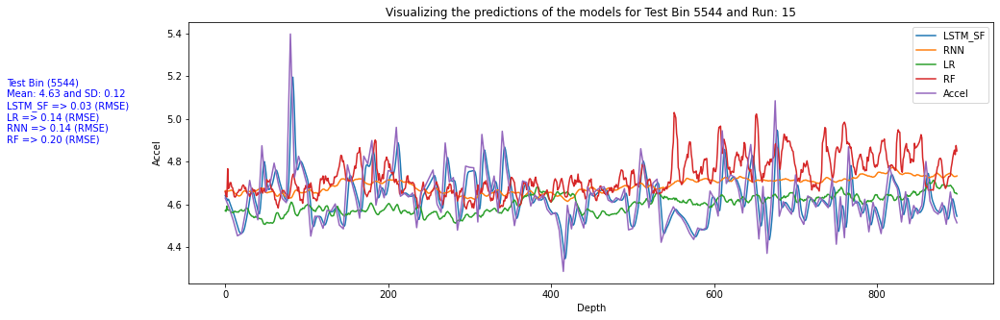

==========>
Rank of the models for Metric: RMSE
Test Bin (5544) 
Mean: 4.63 and SD: 0.12
LSTM_SF => 0.03 (RMSE)
LR => 0.14 (RMSE)
RNN => 0.14 (RMSE)
RF => 0.20 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5544) 
Mean: 4.63 and SD: 0.12
LSTM_SF => 0.00 (RMSLE)
LR => 0.02 (RMSLE)
RNN => 0.02 (RMSLE)
RF => 0.03 (RMSLE)



In [ ]:
models=["LSTM_SF", "RNN", "LR", "RF"]
mpg = ModelPredictionGenerator(
    experiment_settings="Relational_Bins", df_data= df_org, run=15, 
    features=features, target=target, models = models, metrics = metrics,
    K_fold=10,
    relational_bin_config = {"bin_depth": 10, "test_bin_start": 12, "test_bin_end": 12, "rolling_bin_size": 20},
    lstm_time_step = 60, lstm_sf_look_back=200,
    debug = 1, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
# mpg.generate_metrics_plot()

# mpg.plot_features(test_bin=5534)
for test_bin in test_bins:
    mpg.plot_model_predictions(test_bin=test_bin, smooth_N=5)

#### RNN exp1


Run: 15 and total data points: 11262
Test bin index: 2 Train bins: [5424, 5434] and Test bin: 5444 #X_train: 368 #X_test: 256
Test bin index: 3 Train bins: [5424, 5434, 5444] and Test bin: 5454 #X_train: 624 #X_test: 341
Test bin index: 4 Train bins: [5424, 5434, 5444, 5454] and Test bin: 5464 #X_train: 965 #X_test: 477
Test bin index: 5 Train bins: [5424, 5434, 5444, 5454, 5464] and Test bin: 5474 #X_train: 1442 #X_test: 540
Test bin index: 6 Train bins: [5424, 5434, 5444, 5454, 5464, 5474] and Test bin: 5484 #X_train: 1982 #X_test: 627
Test bin index: 7 Train bins: [5424, 5434, 5444, 5454, 5464, 5474, 5484] and Test bin: 5494 #X_train: 2609 #X_test: 689
Test bin index: 8 Train bins: [5424, 5434, 5444, 5454, 5464, 5474, 5484, 5494] and Test bin: 5504 #X_train: 3298 #X_test: 750
Test bin index: 9 Train bins: [5424, 5434, 5444, 5454, 5464, 5474, 5484, 5494, 5504] and Test bin: 5514 #X_train: 4048 #X_test: 823
Test bin index: 10 Train bins: [5424, 5434, 5444, 5454, 5464, 5474, 5484, 5494

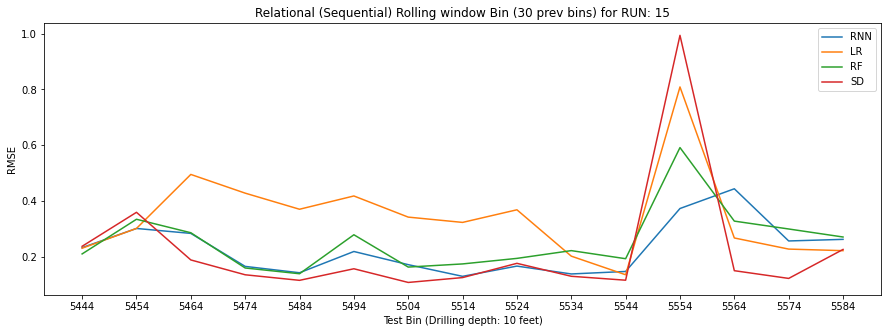

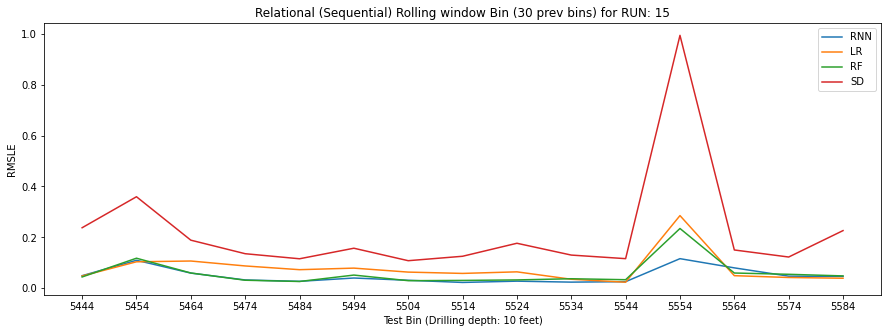

==========>
Rank of the models for Metric: RMSE
Test Bin (5444) 
Mean: 3.55 and SD: 0.24
RF => 0.21 (RMSE)
LR => 0.23 (RMSE)
RNN => 0.23 (RMSE)

(3.073642875551498, 4.509801028268492)


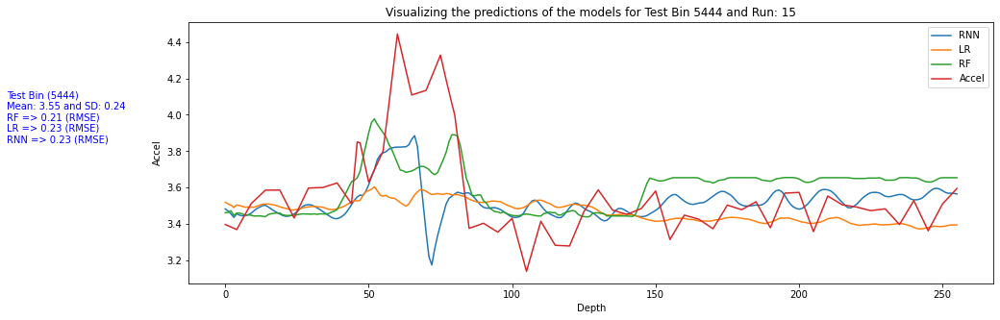

==========>
Rank of the models for Metric: RMSE
Test Bin (5444) 
Mean: 3.55 and SD: 0.24
RF => 0.21 (RMSE)
LR => 0.23 (RMSE)
RNN => 0.23 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5444) 
Mean: 3.55 and SD: 0.24
RF => 0.04 (RMSLE)
LR => 0.05 (RMSLE)
RNN => 0.05 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5454) 
Mean: 3.47 and SD: 0.36
RNN => 0.30 (RMSE)
LR => 0.30 (RMSE)
RF => 0.33 (RMSE)

(0.025938613193433158, 4.435988451086988)


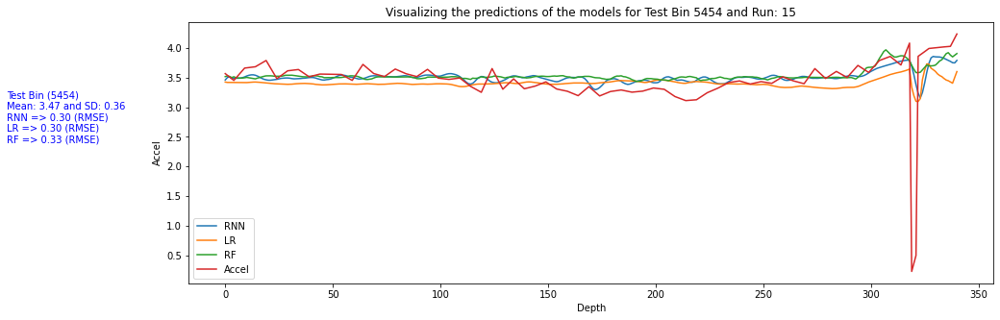

==========>
Rank of the models for Metric: RMSE
Test Bin (5454) 
Mean: 3.47 and SD: 0.36
RNN => 0.30 (RMSE)
LR => 0.30 (RMSE)
RF => 0.33 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5454) 
Mean: 3.47 and SD: 0.36
LR => 0.10 (RMSLE)
RNN => 0.11 (RMSLE)
RF => 0.12 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5464) 
Mean: 3.80 and SD: 0.19
RNN => 0.28 (RMSE)
RF => 0.29 (RMSE)
LR => 0.50 (RMSE)

(3.2176165243516897, 4.430010313261531)


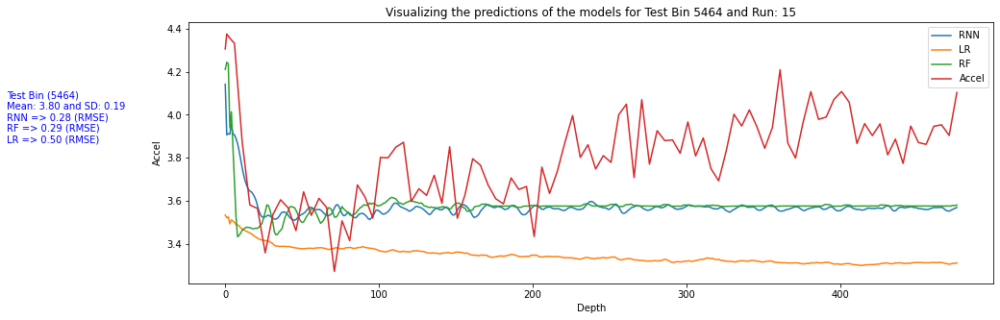

==========>
Rank of the models for Metric: RMSE
Test Bin (5464) 
Mean: 3.80 and SD: 0.19
RNN => 0.28 (RMSE)
RF => 0.29 (RMSE)
LR => 0.50 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5464) 
Mean: 3.80 and SD: 0.19
RNN => 0.06 (RMSLE)
RF => 0.06 (RMSLE)
LR => 0.11 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5474) 
Mean: 4.05 and SD: 0.14
RF => 0.16 (RMSE)
RNN => 0.17 (RMSE)
LR => 0.43 (RMSE)

(3.577390607378868, 4.597367506754098)


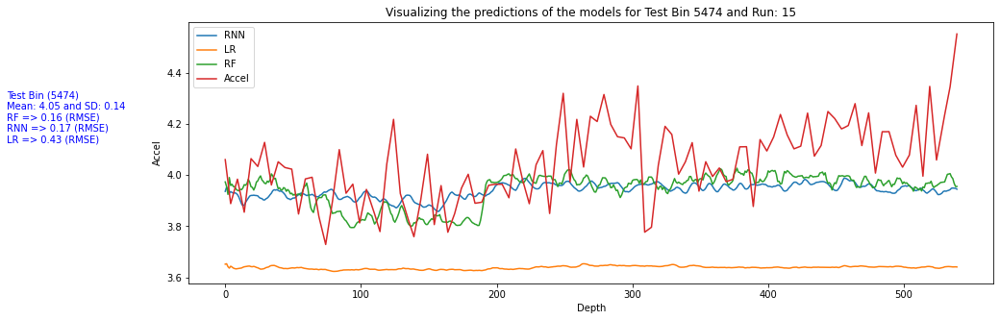

==========>
Rank of the models for Metric: RMSE
Test Bin (5474) 
Mean: 4.05 and SD: 0.14
RF => 0.16 (RMSE)
RNN => 0.17 (RMSE)
LR => 0.43 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5474) 
Mean: 4.05 and SD: 0.14
RF => 0.03 (RMSLE)
RNN => 0.03 (RMSLE)
LR => 0.09 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5484) 
Mean: 4.21 and SD: 0.12
RF => 0.14 (RMSE)
RNN => 0.14 (RMSE)
LR => 0.37 (RMSE)

(3.804254639502038, 4.57601010664254)


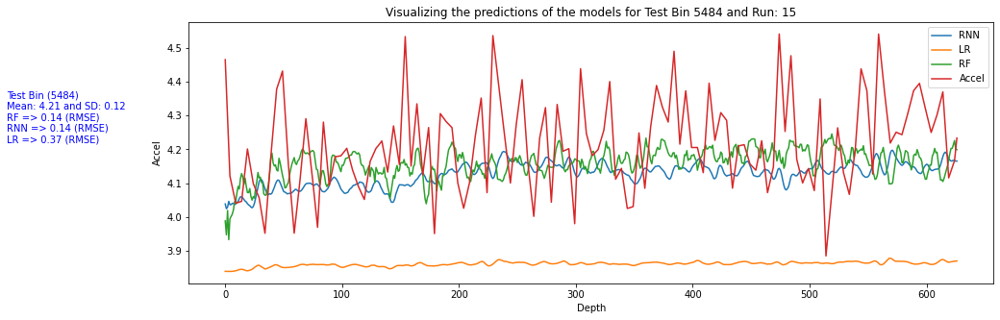

==========>
Rank of the models for Metric: RMSE
Test Bin (5484) 
Mean: 4.21 and SD: 0.12
RF => 0.14 (RMSE)
RNN => 0.14 (RMSE)
LR => 0.37 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5484) 
Mean: 4.21 and SD: 0.12
RF => 0.03 (RMSLE)
RNN => 0.03 (RMSLE)
LR => 0.07 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5494) 
Mean: 4.42 and SD: 0.16
RNN => 0.22 (RMSE)
RF => 0.28 (RMSE)
LR => 0.42 (RMSE)

(3.957219610790768, 4.943740806489766)


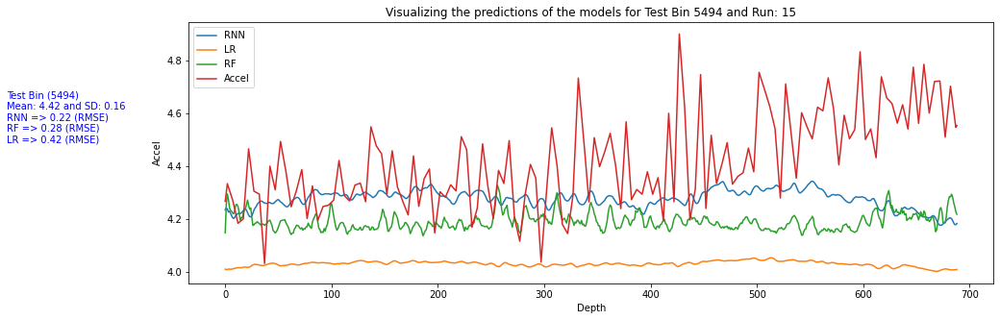

==========>
Rank of the models for Metric: RMSE
Test Bin (5494) 
Mean: 4.42 and SD: 0.16
RNN => 0.22 (RMSE)
RF => 0.28 (RMSE)
LR => 0.42 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5494) 
Mean: 4.42 and SD: 0.16
RNN => 0.04 (RMSLE)
RF => 0.05 (RMSLE)
LR => 0.08 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5504) 
Mean: 4.52 and SD: 0.11
RF => 0.16 (RMSE)
RNN => 0.17 (RMSE)
LR => 0.34 (RMSE)

(4.0847881797561065, 4.857035746341583)


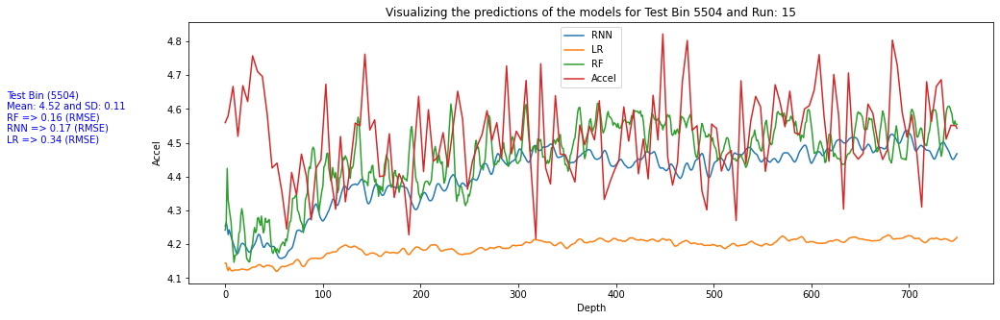

==========>
Rank of the models for Metric: RMSE
Test Bin (5504) 
Mean: 4.52 and SD: 0.11
RF => 0.16 (RMSE)
RNN => 0.17 (RMSE)
LR => 0.34 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5504) 
Mean: 4.52 and SD: 0.11
RF => 0.03 (RMSLE)
RNN => 0.03 (RMSLE)
LR => 0.06 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5514) 
Mean: 4.64 and SD: 0.13
RNN => 0.13 (RMSE)
RF => 0.17 (RMSE)
LR => 0.32 (RMSE)

(4.240867013364249, 5.2551830278929295)


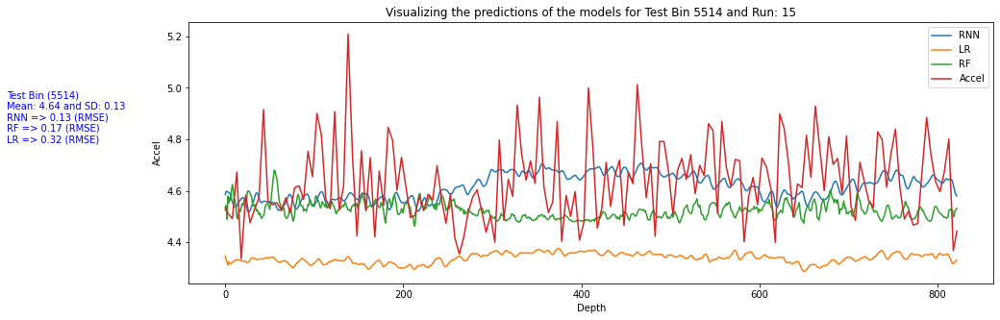

==========>
Rank of the models for Metric: RMSE
Test Bin (5514) 
Mean: 4.64 and SD: 0.13
RNN => 0.13 (RMSE)
RF => 0.17 (RMSE)
LR => 0.32 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5514) 
Mean: 4.64 and SD: 0.13
RNN => 0.02 (RMSLE)
RF => 0.03 (RMSLE)
LR => 0.06 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5524) 
Mean: 4.76 and SD: 0.18
RNN => 0.17 (RMSE)
RF => 0.19 (RMSE)
LR => 0.37 (RMSE)

(4.286672230230571, 6.143847165562192)


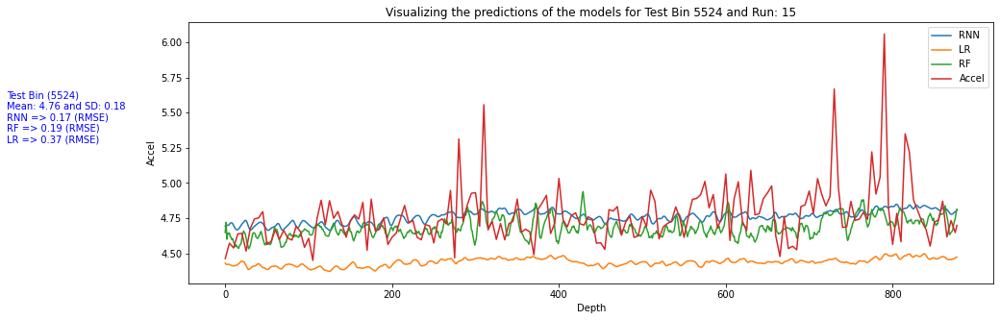

==========>
Rank of the models for Metric: RMSE
Test Bin (5524) 
Mean: 4.76 and SD: 0.18
RNN => 0.17 (RMSE)
RF => 0.19 (RMSE)
LR => 0.37 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5524) 
Mean: 4.76 and SD: 0.18
RNN => 0.03 (RMSLE)
RF => 0.03 (RMSLE)
LR => 0.06 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5534) 
Mean: 4.70 and SD: 0.13
RNN => 0.14 (RMSE)
LR => 0.20 (RMSE)
RF => 0.22 (RMSE)

(4.389809394259399, 5.465014713956167)


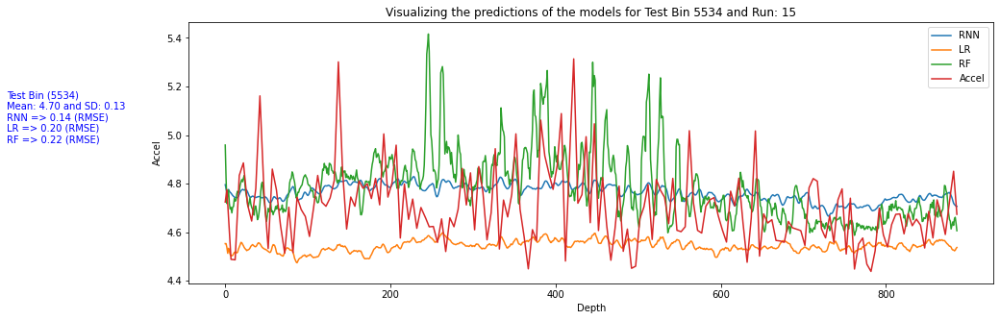

==========>
Rank of the models for Metric: RMSE
Test Bin (5534) 
Mean: 4.70 and SD: 0.13
RNN => 0.14 (RMSE)
LR => 0.20 (RMSE)
RF => 0.22 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5534) 
Mean: 4.70 and SD: 0.13
RNN => 0.02 (RMSLE)
LR => 0.04 (RMSLE)
RF => 0.04 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5544) 
Mean: 4.63 and SD: 0.12
LR => 0.14 (RMSE)
RNN => 0.15 (RMSE)
RF => 0.19 (RMSE)

(4.231161980212564, 5.45261919814726)


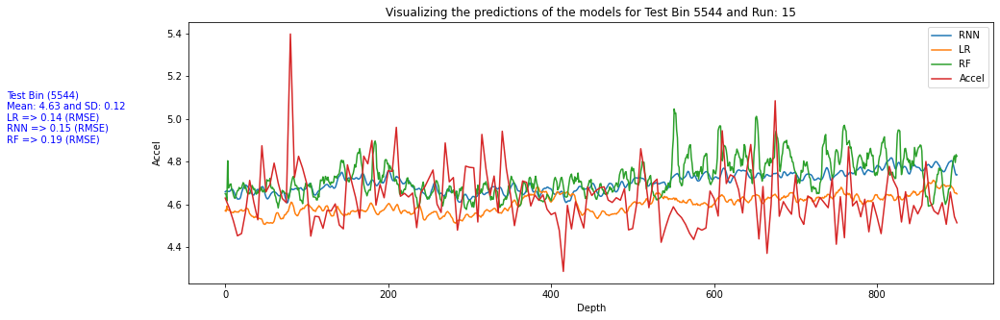

==========>
Rank of the models for Metric: RMSE
Test Bin (5544) 
Mean: 4.63 and SD: 0.12
LR => 0.14 (RMSE)
RNN => 0.15 (RMSE)
RF => 0.19 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5544) 
Mean: 4.63 and SD: 0.12
LR => 0.02 (RMSLE)
RNN => 0.03 (RMSLE)
RF => 0.03 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5554) 
Mean: 4.09 and SD: 0.99
RNN => 0.37 (RMSE)
RF => 0.59 (RMSE)
LR => 0.81 (RMSE)

(-0.029725294263100666, 5.375649606489816)


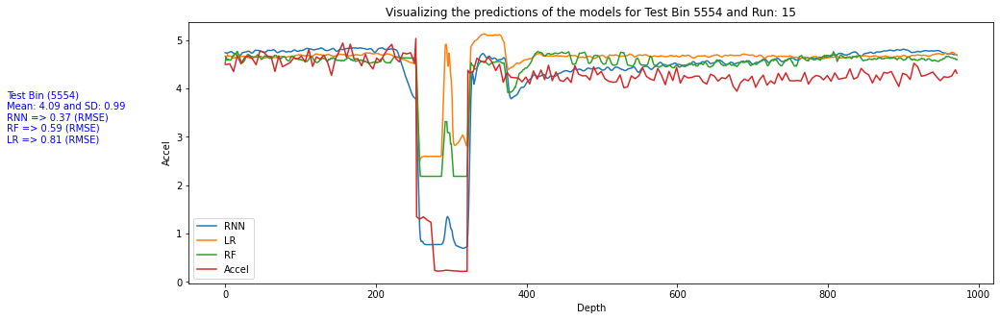

==========>
Rank of the models for Metric: RMSE
Test Bin (5554) 
Mean: 4.09 and SD: 0.99
RNN => 0.37 (RMSE)
RF => 0.59 (RMSE)
LR => 0.81 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5554) 
Mean: 4.09 and SD: 0.99
RNN => 0.12 (RMSLE)
RF => 0.23 (RMSLE)
LR => 0.29 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5564) 
Mean: 4.35 and SD: 0.15
LR => 0.27 (RMSE)
RF => 0.33 (RMSE)
RNN => 0.44 (RMSE)

(3.908418009354963, 5.116011106371447)


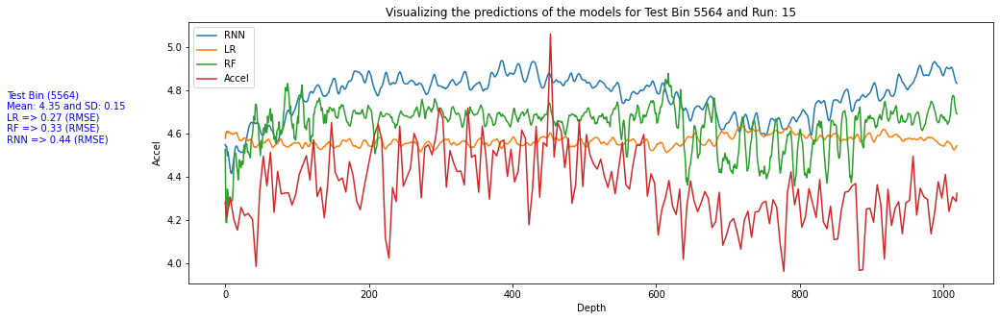

==========>
Rank of the models for Metric: RMSE
Test Bin (5564) 
Mean: 4.35 and SD: 0.15
LR => 0.27 (RMSE)
RF => 0.33 (RMSE)
RNN => 0.44 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5564) 
Mean: 4.35 and SD: 0.15
LR => 0.05 (RMSLE)
RF => 0.06 (RMSLE)
RNN => 0.08 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5574) 
Mean: 4.33 and SD: 0.12
LR => 0.23 (RMSE)
RNN => 0.26 (RMSE)
RF => 0.30 (RMSE)

(3.8719822598452365, 4.9033097496895035)


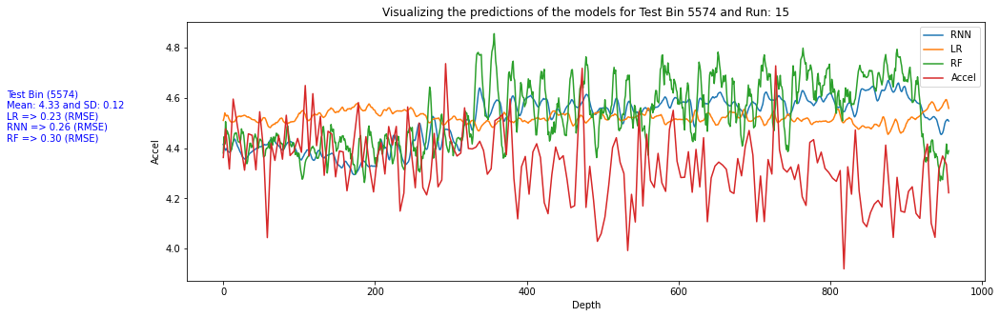

==========>
Rank of the models for Metric: RMSE
Test Bin (5574) 
Mean: 4.33 and SD: 0.12
LR => 0.23 (RMSE)
RNN => 0.26 (RMSE)
RF => 0.30 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5574) 
Mean: 4.33 and SD: 0.12
LR => 0.04 (RMSLE)
RNN => 0.05 (RMSLE)
RF => 0.05 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5584) 
Mean: 4.44 and SD: 0.23
LR => 0.22 (RMSE)
RNN => 0.26 (RMSE)
RF => 0.27 (RMSE)

(3.862199235695802, 6.446158304890691)


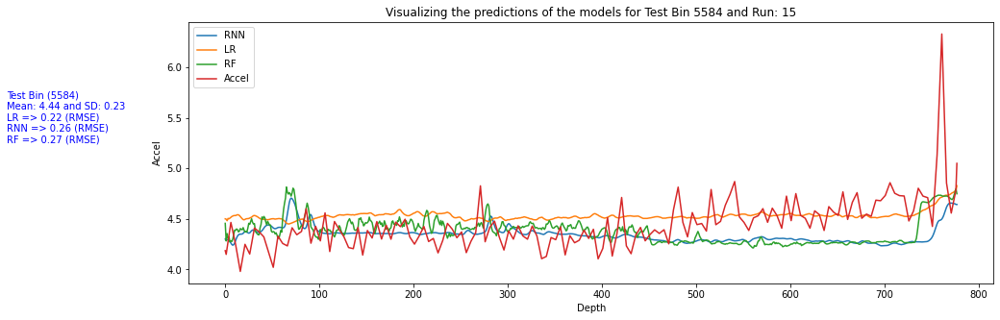

==========>
Rank of the models for Metric: RMSE
Test Bin (5584) 
Mean: 4.44 and SD: 0.23
LR => 0.22 (RMSE)
RNN => 0.26 (RMSE)
RF => 0.27 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5584) 
Mean: 4.44 and SD: 0.23
LR => 0.04 (RMSLE)
RNN => 0.05 (RMSLE)
RF => 0.05 (RMSLE)



In [ ]:
models=["RNN", "LR", "RF"]
mpg = ModelPredictionGenerator(
    experiment_settings="Relational_Bins", df_data= df_org, run=15, 
    features=features, target=target, models = models, metrics = metrics,
    K_fold=10,
    relational_bin_config = {"bin_depth": 10, "test_bin_start": 2, "test_bin_end": 25, "rolling_bin_size": 30},
    lstm_time_step = 5,
    debug = 4, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
mpg.generate_metrics_plot()

# mpg.plot_features(test_bin=5534)
for test_bin in test_bins:
    mpg.plot_model_predictions(test_bin=test_bin, smooth_N=5)

#### RNN exp2


In [ ]:
models=["RNN", "LR", "RF"]
mpg = ModelPredictionGenerator(
    experiment_settings="Relational_Bins", df_data= df_org, run=15, 
    features=features, target=target, models = models, metrics = metrics,
    K_fold=10,
    relational_bin_config = {"bin_depth": 10, "test_bin_start": 5, "test_bin_end": 25, "rolling_bin_size": 30},
    lstm_time_step = 10,
    debug = 2, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
mpg.generate_metrics_plot()

# mpg.plot_features(test_bin=5534)
for test_bin in test_bins:
    mpg.plot_model_predictions(test_bin=test_bin, smooth_N=5)

#### RNN exp3

In [ ]:
models=["RNN", "LR", "RF"]
mpg = ModelPredictionGenerator(
    experiment_settings="Relational_Bins", df_data= df_org, run=15, 
    features=features, target=target, models = models, metrics = metrics,
    K_fold=20,
    relational_bin_config = {"bin_depth": 10, "test_bin_start": 2, "test_bin_end": 25, "rolling_bin_size": 30},
    lstm_time_step = 20,
    debug = 4, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
mpg.generate_metrics_plot()

# mpg.plot_features(test_bin=5534)
for test_bin in test_bins:
    mpg.plot_model_predictions(test_bin=test_bin, smooth_N=5)

#### RNN exp4

Run: 15 and total data points: 11262
====> Test bin: 5474
====> Test bin: 5484
====> Test bin: 5494
====> Test bin: 5504
====> Test bin: 5514
====> Test bin: 5524
====> Test bin: 5534
====> Test bin: 5544
====> Test bin: 5554
====> Test bin: 5564
====> Test bin: 5574
====> Test bin: 5584
The predictions of the models have been saved in file predicted_outputs.csv


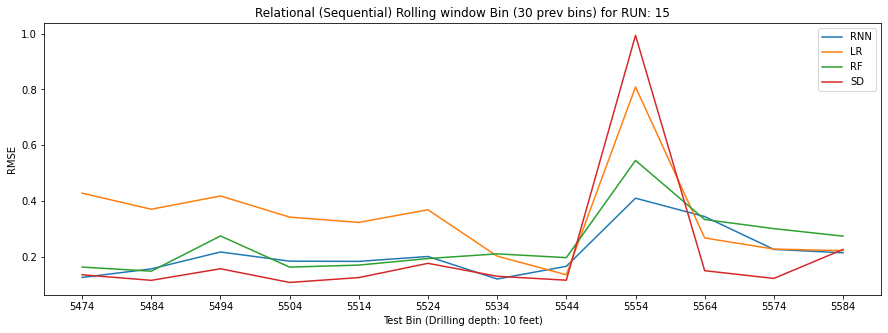

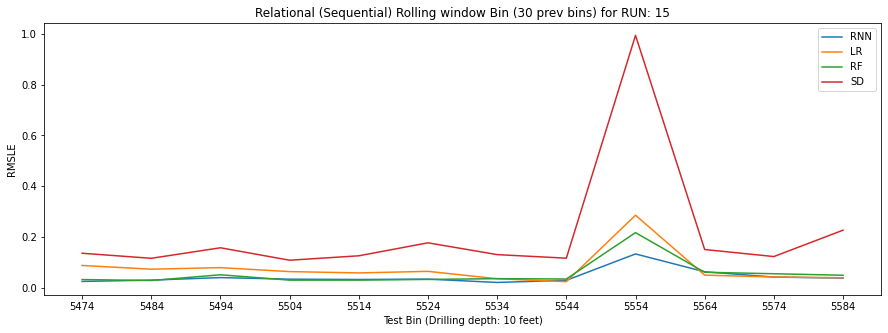

==========>
Rank of the models for Metric: RMSE
Test Bin (5474) 
Mean: 4.05 and SD: 0.14
RNN => 0.13 (RMSE)
RF => 0.16 (RMSE)
LR => 0.43 (RMSE)

(3.577390607378868, 4.597367506754098)


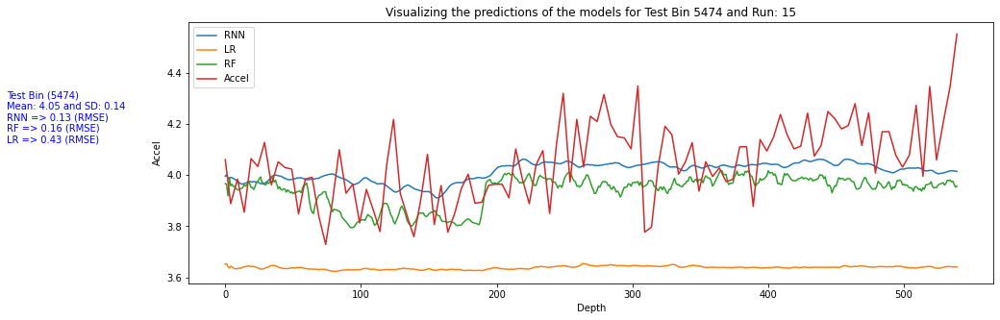

==========>
Rank of the models for Metric: RMSE
Test Bin (5474) 
Mean: 4.05 and SD: 0.14
RNN => 0.13 (RMSE)
RF => 0.16 (RMSE)
LR => 0.43 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5474) 
Mean: 4.05 and SD: 0.14
RNN => 0.02 (RMSLE)
RF => 0.03 (RMSLE)
LR => 0.09 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5484) 
Mean: 4.21 and SD: 0.12
RF => 0.15 (RMSE)
RNN => 0.16 (RMSE)
LR => 0.37 (RMSE)

(3.804254639502038, 4.57601010664254)


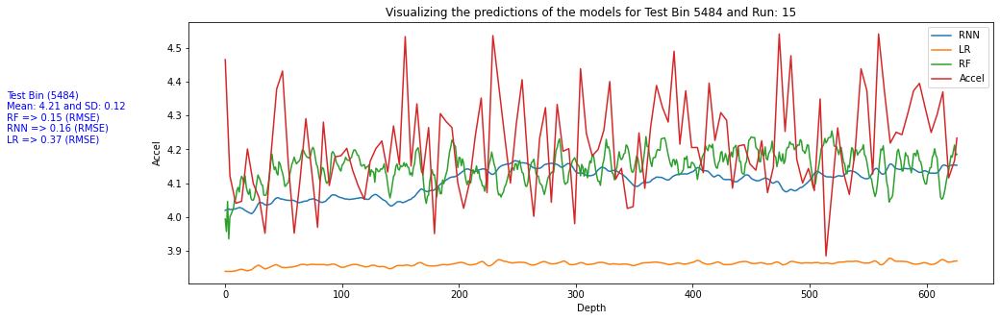

==========>
Rank of the models for Metric: RMSE
Test Bin (5484) 
Mean: 4.21 and SD: 0.12
RF => 0.15 (RMSE)
RNN => 0.16 (RMSE)
LR => 0.37 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5484) 
Mean: 4.21 and SD: 0.12
RF => 0.03 (RMSLE)
RNN => 0.03 (RMSLE)
LR => 0.07 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5494) 
Mean: 4.42 and SD: 0.16
RNN => 0.22 (RMSE)
RF => 0.28 (RMSE)
LR => 0.42 (RMSE)

(3.957219610790768, 4.943740806489766)


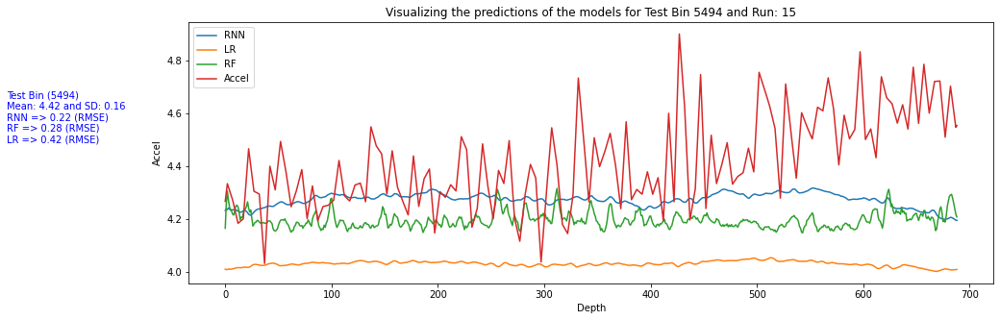

==========>
Rank of the models for Metric: RMSE
Test Bin (5494) 
Mean: 4.42 and SD: 0.16
RNN => 0.22 (RMSE)
RF => 0.28 (RMSE)
LR => 0.42 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5494) 
Mean: 4.42 and SD: 0.16
RNN => 0.04 (RMSLE)
RF => 0.05 (RMSLE)
LR => 0.08 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5504) 
Mean: 4.52 and SD: 0.11
RF => 0.16 (RMSE)
RNN => 0.18 (RMSE)
LR => 0.34 (RMSE)

(4.0847881797561065, 4.857035746341583)


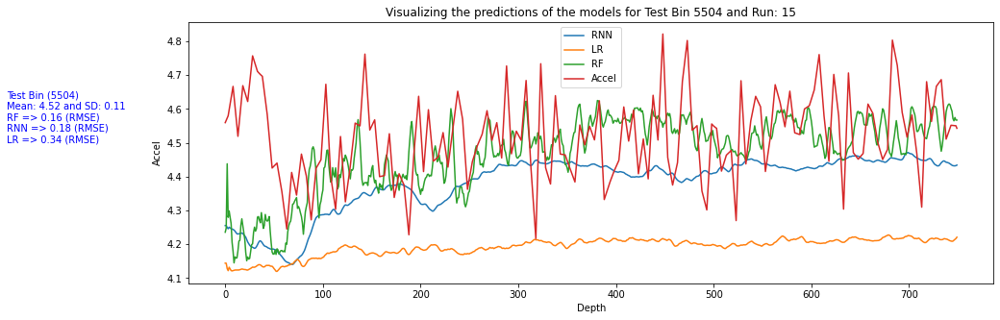

==========>
Rank of the models for Metric: RMSE
Test Bin (5504) 
Mean: 4.52 and SD: 0.11
RF => 0.16 (RMSE)
RNN => 0.18 (RMSE)
LR => 0.34 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5504) 
Mean: 4.52 and SD: 0.11
RF => 0.03 (RMSLE)
RNN => 0.03 (RMSLE)
LR => 0.06 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5514) 
Mean: 4.64 and SD: 0.13
RF => 0.17 (RMSE)
RNN => 0.18 (RMSE)
LR => 0.32 (RMSE)

(4.240867013364249, 5.2551830278929295)


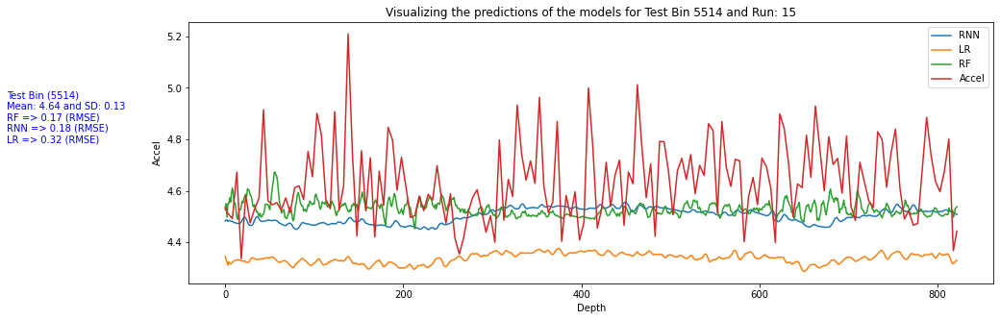

==========>
Rank of the models for Metric: RMSE
Test Bin (5514) 
Mean: 4.64 and SD: 0.13
RF => 0.17 (RMSE)
RNN => 0.18 (RMSE)
LR => 0.32 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5514) 
Mean: 4.64 and SD: 0.13
RF => 0.03 (RMSLE)
RNN => 0.03 (RMSLE)
LR => 0.06 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5524) 
Mean: 4.76 and SD: 0.18
RF => 0.19 (RMSE)
RNN => 0.20 (RMSE)
LR => 0.37 (RMSE)

(4.286672230230571, 6.143847165562192)


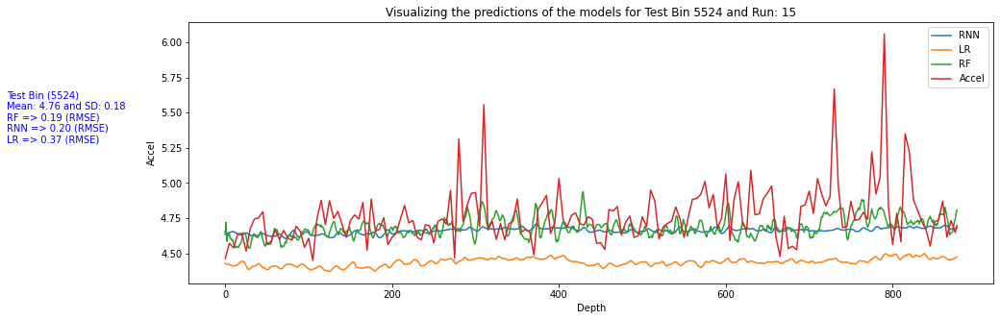

==========>
Rank of the models for Metric: RMSE
Test Bin (5524) 
Mean: 4.76 and SD: 0.18
RF => 0.19 (RMSE)
RNN => 0.20 (RMSE)
LR => 0.37 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5524) 
Mean: 4.76 and SD: 0.18
RF => 0.03 (RMSLE)
RNN => 0.03 (RMSLE)
LR => 0.06 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5534) 
Mean: 4.70 and SD: 0.13
RNN => 0.12 (RMSE)
LR => 0.20 (RMSE)
RF => 0.21 (RMSE)

(4.392377781603202, 5.411078579736287)


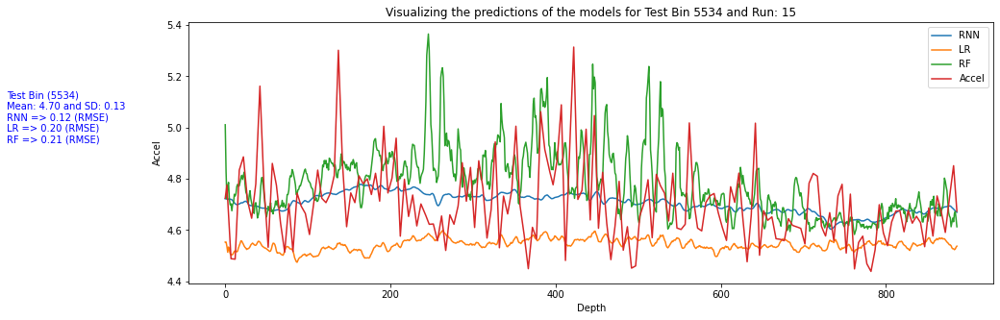

==========>
Rank of the models for Metric: RMSE
Test Bin (5534) 
Mean: 4.70 and SD: 0.13
RNN => 0.12 (RMSE)
LR => 0.20 (RMSE)
RF => 0.21 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5534) 
Mean: 4.70 and SD: 0.13
RNN => 0.02 (RMSLE)
LR => 0.04 (RMSLE)
RF => 0.04 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5544) 
Mean: 4.63 and SD: 0.12
LR => 0.14 (RMSE)
RNN => 0.17 (RMSE)
RF => 0.20 (RMSE)

(4.231161980212564, 5.45261919814726)


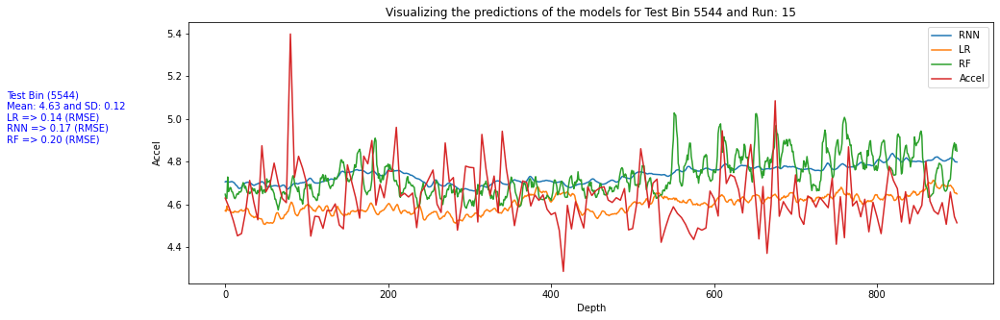

==========>
Rank of the models for Metric: RMSE
Test Bin (5544) 
Mean: 4.63 and SD: 0.12
LR => 0.14 (RMSE)
RNN => 0.17 (RMSE)
RF => 0.20 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5544) 
Mean: 4.63 and SD: 0.12
LR => 0.02 (RMSLE)
RNN => 0.03 (RMSLE)
RF => 0.03 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5554) 
Mean: 4.09 and SD: 0.99
RNN => 0.41 (RMSE)
RF => 0.55 (RMSE)
LR => 0.81 (RMSE)

(-0.029725294263100666, 5.375649606489816)


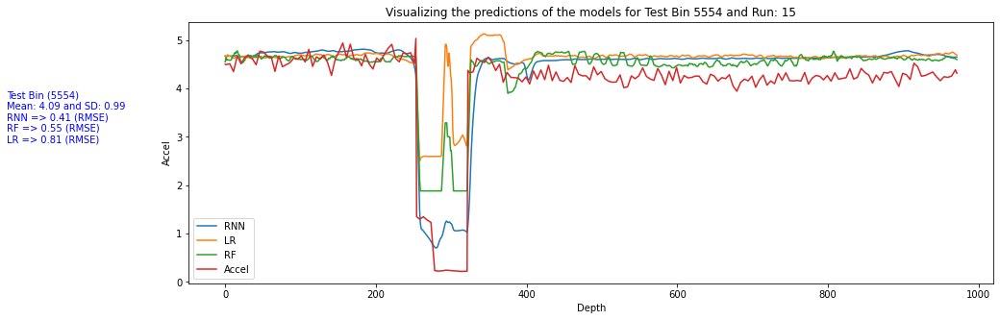

==========>
Rank of the models for Metric: RMSE
Test Bin (5554) 
Mean: 4.09 and SD: 0.99
RNN => 0.41 (RMSE)
RF => 0.55 (RMSE)
LR => 0.81 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5554) 
Mean: 4.09 and SD: 0.99
RNN => 0.13 (RMSLE)
RF => 0.22 (RMSLE)
LR => 0.29 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5564) 
Mean: 4.35 and SD: 0.15
LR => 0.27 (RMSE)
RF => 0.33 (RMSE)
RNN => 0.34 (RMSE)

(3.908418009354963, 5.116011106371447)


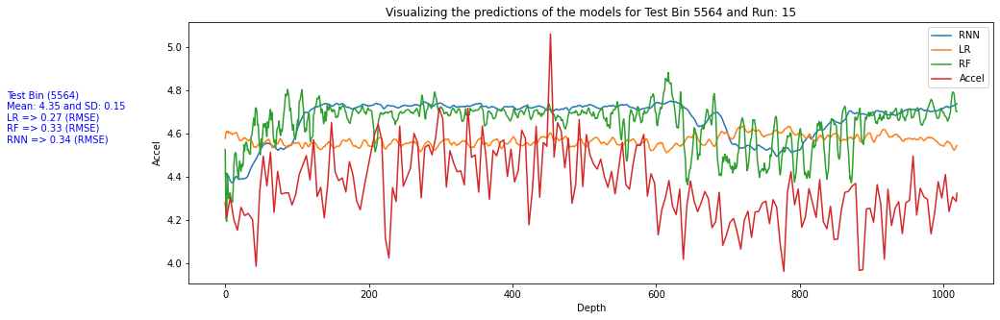

==========>
Rank of the models for Metric: RMSE
Test Bin (5564) 
Mean: 4.35 and SD: 0.15
LR => 0.27 (RMSE)
RF => 0.33 (RMSE)
RNN => 0.34 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5564) 
Mean: 4.35 and SD: 0.15
LR => 0.05 (RMSLE)
RF => 0.06 (RMSLE)
RNN => 0.06 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5574) 
Mean: 4.33 and SD: 0.12
RNN => 0.23 (RMSE)
LR => 0.23 (RMSE)
RF => 0.30 (RMSE)

(3.8733516832821793, 4.874551857513707)


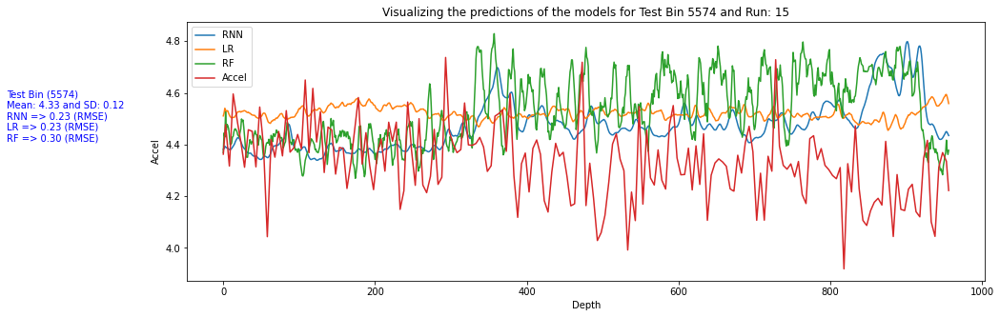

==========>
Rank of the models for Metric: RMSE
Test Bin (5574) 
Mean: 4.33 and SD: 0.12
RNN => 0.23 (RMSE)
LR => 0.23 (RMSE)
RF => 0.30 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5574) 
Mean: 4.33 and SD: 0.12
RNN => 0.04 (RMSLE)
LR => 0.04 (RMSLE)
RF => 0.06 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5584) 
Mean: 4.44 and SD: 0.23
RNN => 0.21 (RMSE)
LR => 0.22 (RMSE)
RF => 0.27 (RMSE)

(3.862199235695802, 6.446158304890691)


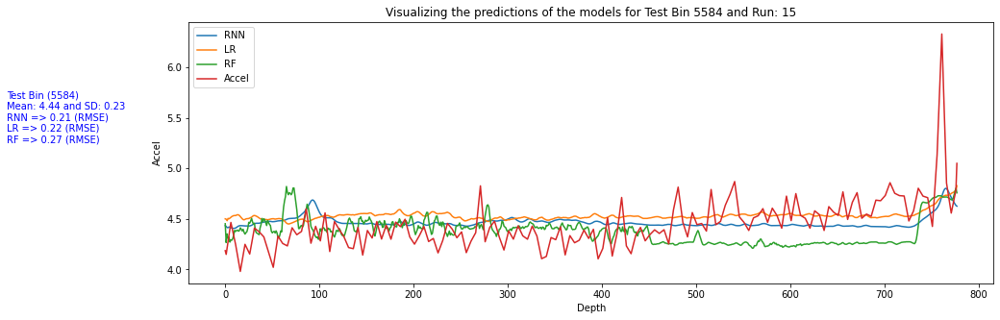

==========>
Rank of the models for Metric: RMSE
Test Bin (5584) 
Mean: 4.44 and SD: 0.23
RNN => 0.21 (RMSE)
LR => 0.22 (RMSE)
RF => 0.27 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5584) 
Mean: 4.44 and SD: 0.23
RNN => 0.04 (RMSLE)
LR => 0.04 (RMSLE)
RF => 0.05 (RMSLE)



In [ ]:
models=["RNN", "LR", "RF"]
mpg = ModelPredictionGenerator(
    experiment_settings="Relational_Bins", df_data= df_org, run=15, 
    features=features, target=target, models = models, metrics = metrics,
    K_fold=10,
    relational_bin_config = {"bin_depth": 10, "test_bin_start": 5, "test_bin_end": 25, "rolling_bin_size": 30},
    lstm_time_step = 30,
    debug = 2, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
mpg.generate_metrics_plot()

# mpg.plot_features(test_bin=5534)
for test_bin in test_bins:
    mpg.plot_model_predictions(test_bin=test_bin, smooth_N=5)

#### RNN exp5

Run: 15 and total data points: 11262
====> Test bin: 5474
====> Test bin: 5484
====> Test bin: 5494
====> Test bin: 5504
====> Test bin: 5514
====> Test bin: 5524
====> Test bin: 5534
====> Test bin: 5544
====> Test bin: 5554
====> Test bin: 5564
====> Test bin: 5574
====> Test bin: 5584
The predictions of the models have been saved in file predicted_outputs.csv


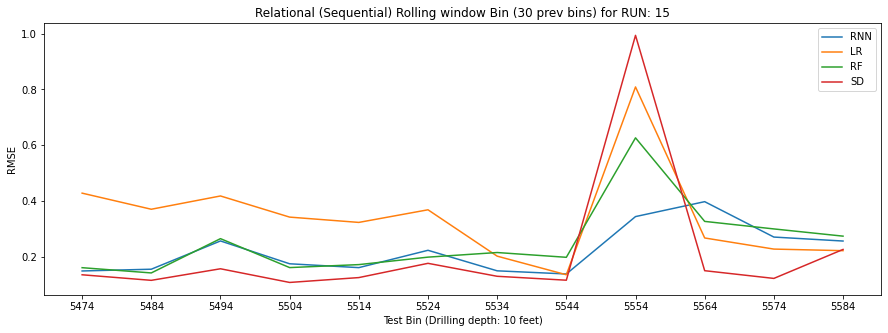

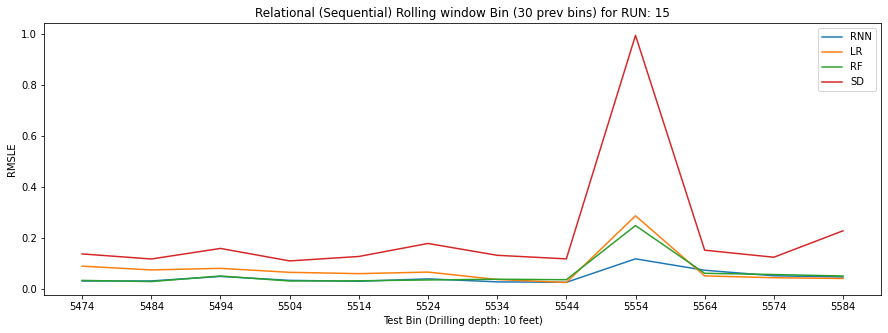

==========>
Rank of the models for Metric: RMSE
Test Bin (5474) 
Mean: 4.05 and SD: 0.14
RNN => 0.15 (RMSE)
RF => 0.16 (RMSE)
LR => 0.43 (RMSE)

(3.577390607378868, 4.597367506754098)


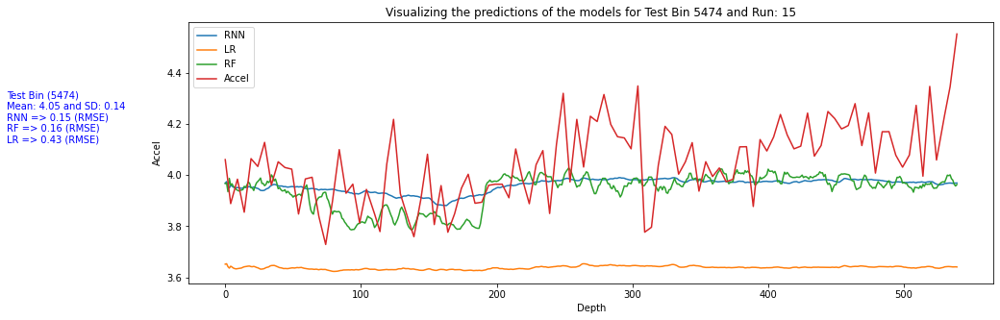

==========>
Rank of the models for Metric: RMSE
Test Bin (5474) 
Mean: 4.05 and SD: 0.14
RNN => 0.15 (RMSE)
RF => 0.16 (RMSE)
LR => 0.43 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5474) 
Mean: 4.05 and SD: 0.14
RNN => 0.03 (RMSLE)
RF => 0.03 (RMSLE)
LR => 0.09 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5484) 
Mean: 4.21 and SD: 0.12
RF => 0.14 (RMSE)
RNN => 0.16 (RMSE)
LR => 0.37 (RMSE)

(3.804254639502038, 4.57601010664254)


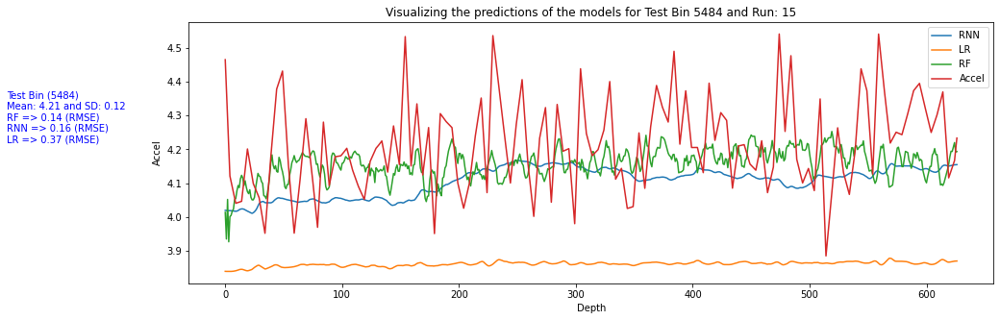

==========>
Rank of the models for Metric: RMSE
Test Bin (5484) 
Mean: 4.21 and SD: 0.12
RF => 0.14 (RMSE)
RNN => 0.16 (RMSE)
LR => 0.37 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5484) 
Mean: 4.21 and SD: 0.12
RF => 0.03 (RMSLE)
RNN => 0.03 (RMSLE)
LR => 0.07 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5494) 
Mean: 4.42 and SD: 0.16
RNN => 0.26 (RMSE)
RF => 0.27 (RMSE)
LR => 0.42 (RMSE)

(3.957219610790768, 4.943740806489766)


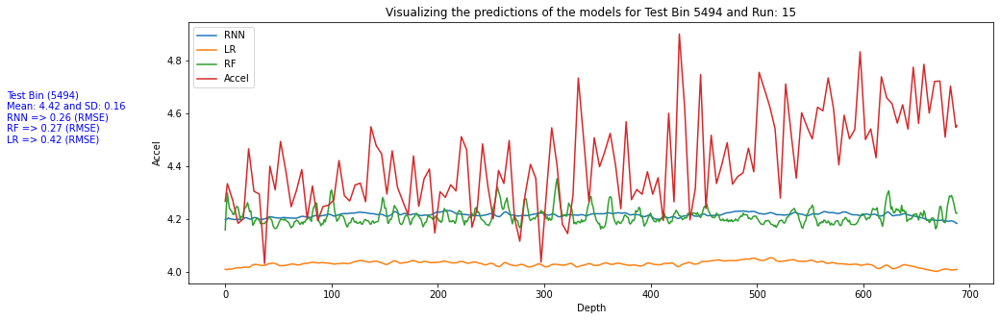

==========>
Rank of the models for Metric: RMSE
Test Bin (5494) 
Mean: 4.42 and SD: 0.16
RNN => 0.26 (RMSE)
RF => 0.27 (RMSE)
LR => 0.42 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5494) 
Mean: 4.42 and SD: 0.16
RNN => 0.05 (RMSLE)
RF => 0.05 (RMSLE)
LR => 0.08 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5504) 
Mean: 4.52 and SD: 0.11
RF => 0.16 (RMSE)
RNN => 0.18 (RMSE)
LR => 0.34 (RMSE)

(4.0847881797561065, 4.857035746341583)


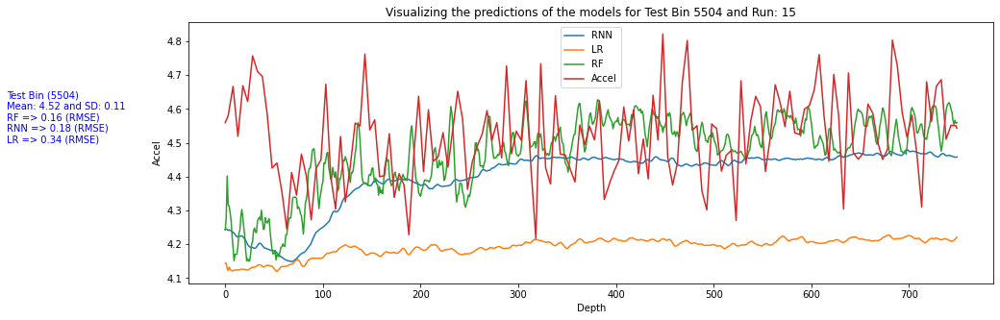

==========>
Rank of the models for Metric: RMSE
Test Bin (5504) 
Mean: 4.52 and SD: 0.11
RF => 0.16 (RMSE)
RNN => 0.18 (RMSE)
LR => 0.34 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5504) 
Mean: 4.52 and SD: 0.11
RF => 0.03 (RMSLE)
RNN => 0.03 (RMSLE)
LR => 0.06 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5514) 
Mean: 4.64 and SD: 0.13
RNN => 0.16 (RMSE)
RF => 0.17 (RMSE)
LR => 0.32 (RMSE)

(4.240867013364249, 5.2551830278929295)


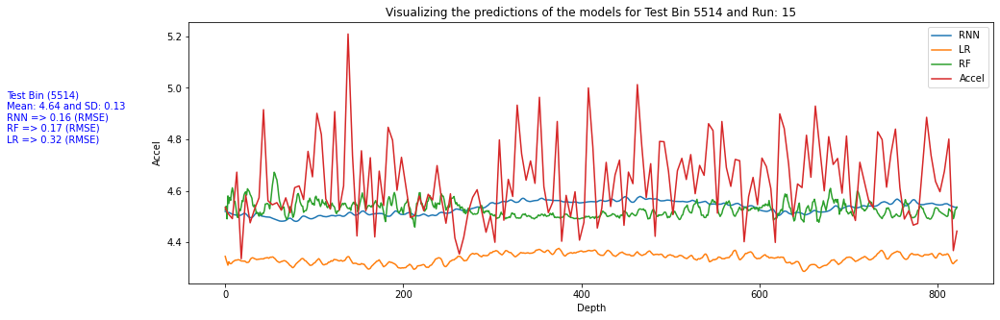

==========>
Rank of the models for Metric: RMSE
Test Bin (5514) 
Mean: 4.64 and SD: 0.13
RNN => 0.16 (RMSE)
RF => 0.17 (RMSE)
LR => 0.32 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5514) 
Mean: 4.64 and SD: 0.13
RNN => 0.03 (RMSLE)
RF => 0.03 (RMSLE)
LR => 0.06 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5524) 
Mean: 4.76 and SD: 0.18
RF => 0.20 (RMSE)
RNN => 0.22 (RMSE)
LR => 0.37 (RMSE)

(4.286672230230571, 6.143847165562192)


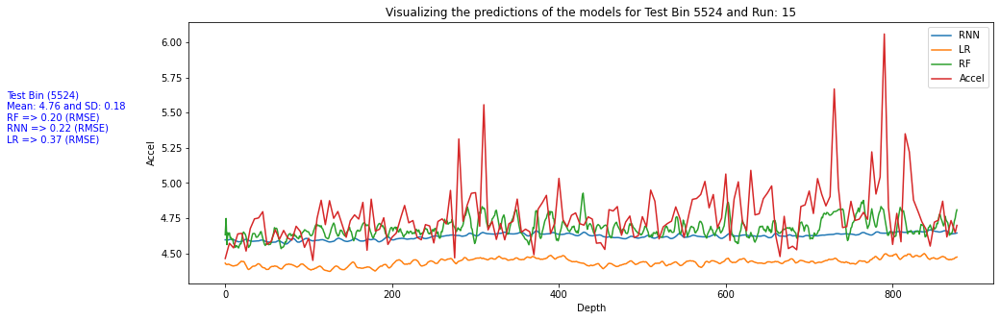

==========>
Rank of the models for Metric: RMSE
Test Bin (5524) 
Mean: 4.76 and SD: 0.18
RF => 0.20 (RMSE)
RNN => 0.22 (RMSE)
LR => 0.37 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5524) 
Mean: 4.76 and SD: 0.18
RF => 0.03 (RMSLE)
RNN => 0.04 (RMSLE)
LR => 0.06 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5534) 
Mean: 4.70 and SD: 0.13
RNN => 0.15 (RMSE)
LR => 0.20 (RMSE)
RF => 0.22 (RMSE)

(4.391803977806887, 5.423128459458896)


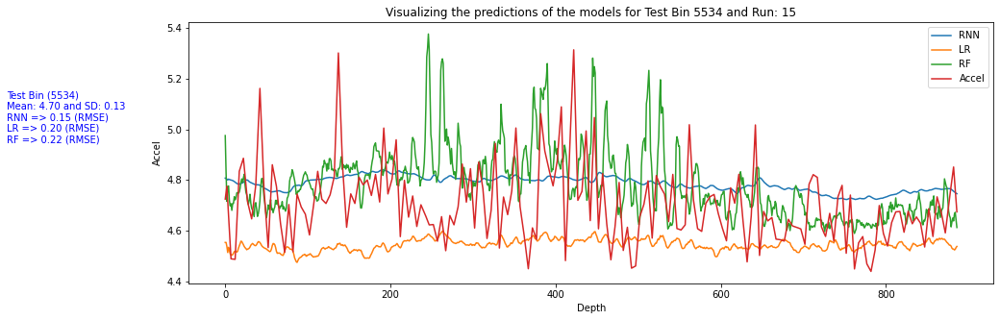

==========>
Rank of the models for Metric: RMSE
Test Bin (5534) 
Mean: 4.70 and SD: 0.13
RNN => 0.15 (RMSE)
LR => 0.20 (RMSE)
RF => 0.22 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5534) 
Mean: 4.70 and SD: 0.13
RNN => 0.03 (RMSLE)
LR => 0.04 (RMSLE)
RF => 0.04 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5544) 
Mean: 4.63 and SD: 0.12
LR => 0.14 (RMSE)
RNN => 0.14 (RMSE)
RF => 0.20 (RMSE)

(4.231161980212564, 5.45261919814726)


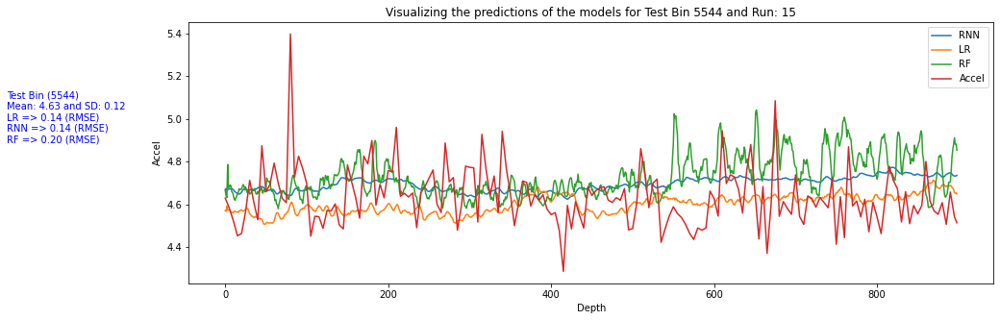

==========>
Rank of the models for Metric: RMSE
Test Bin (5544) 
Mean: 4.63 and SD: 0.12
LR => 0.14 (RMSE)
RNN => 0.14 (RMSE)
RF => 0.20 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5544) 
Mean: 4.63 and SD: 0.12
LR => 0.02 (RMSLE)
RNN => 0.02 (RMSLE)
RF => 0.03 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5554) 
Mean: 4.09 and SD: 0.99
RNN => 0.34 (RMSE)
RF => 0.63 (RMSE)
LR => 0.81 (RMSE)

(-0.029725294263100666, 5.375649606489816)


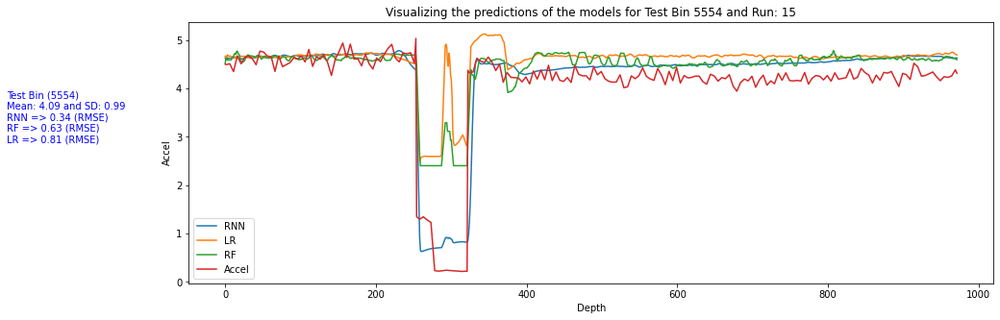

==========>
Rank of the models for Metric: RMSE
Test Bin (5554) 
Mean: 4.09 and SD: 0.99
RNN => 0.34 (RMSE)
RF => 0.63 (RMSE)
LR => 0.81 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5554) 
Mean: 4.09 and SD: 0.99
RNN => 0.12 (RMSLE)
RF => 0.25 (RMSLE)
LR => 0.29 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5564) 
Mean: 4.35 and SD: 0.15
LR => 0.27 (RMSE)
RF => 0.33 (RMSE)
RNN => 0.40 (RMSE)

(3.908418009354963, 5.116011106371447)


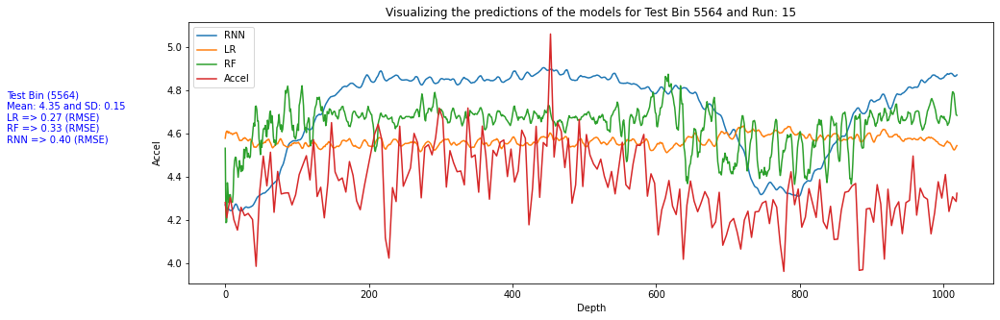

==========>
Rank of the models for Metric: RMSE
Test Bin (5564) 
Mean: 4.35 and SD: 0.15
LR => 0.27 (RMSE)
RF => 0.33 (RMSE)
RNN => 0.40 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5564) 
Mean: 4.35 and SD: 0.15
LR => 0.05 (RMSLE)
RF => 0.06 (RMSLE)
RNN => 0.07 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5574) 
Mean: 4.33 and SD: 0.12
LR => 0.23 (RMSE)
RNN => 0.27 (RMSE)
RF => 0.30 (RMSE)

(3.872643354506555, 4.889426761801821)


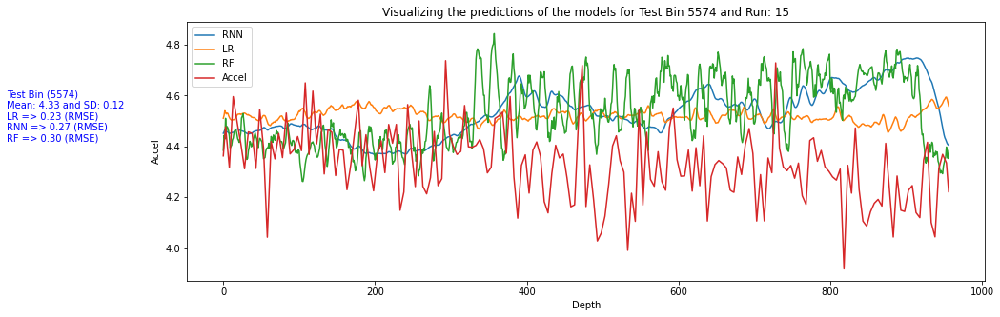

==========>
Rank of the models for Metric: RMSE
Test Bin (5574) 
Mean: 4.33 and SD: 0.12
LR => 0.23 (RMSE)
RNN => 0.27 (RMSE)
RF => 0.30 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5574) 
Mean: 4.33 and SD: 0.12
LR => 0.04 (RMSLE)
RNN => 0.05 (RMSLE)
RF => 0.06 (RMSLE)

==========>
Rank of the models for Metric: RMSE
Test Bin (5584) 
Mean: 4.44 and SD: 0.23
LR => 0.22 (RMSE)
RNN => 0.26 (RMSE)
RF => 0.27 (RMSE)

(3.862199235695802, 6.446158304890691)


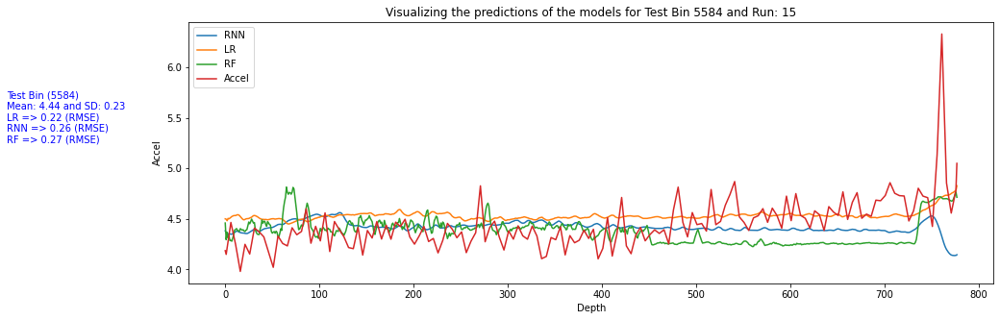

==========>
Rank of the models for Metric: RMSE
Test Bin (5584) 
Mean: 4.44 and SD: 0.23
LR => 0.22 (RMSE)
RNN => 0.26 (RMSE)
RF => 0.27 (RMSE)

==========>
Rank of the models for Metric: RMSLE
Test Bin (5584) 
Mean: 4.44 and SD: 0.23
LR => 0.04 (RMSLE)
RNN => 0.05 (RMSLE)
RF => 0.05 (RMSLE)



In [ ]:
models=["RNN", "LR", "RF"]
mpg = ModelPredictionGenerator(
    experiment_settings="Relational_Bins", df_data= df_org, run=15, 
    features=features, target=target, models = models, metrics = metrics,
    K_fold=10,
    relational_bin_config = {"bin_depth": 10, "test_bin_start": 5, "test_bin_end": 25, "rolling_bin_size": 30},
    lstm_time_step = 60,
    debug = 2, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
mpg.generate_metrics_plot()

# mpg.plot_features(test_bin=5534)
for test_bin in test_bins:
    mpg.plot_model_predictions(test_bin=test_bin, smooth_N=5)

#### RNN exp6

In [ ]:
models=["RNN", "LR", "RF"]
mpg = ModelPredictionGenerator(
    experiment_settings="Relational_Bins", df_data= df_org, run=17, 
    features=features, target=target, models = models, metrics = metrics,
    K_fold=10,
    relational_bin_config = {"bin_depth": 10, "test_bin_start": 2, "test_bin_end": 25, "rolling_bin_size": 30},
    lstm_time_step = 30,
    debug = 2, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
mpg.generate_metrics_plot()

# mpg.plot_features(test_bin=5534)
for test_bin in test_bins:
    mpg.plot_model_predictions(test_bin=test_bin, smooth_N=5)

Run: 17 and total data points: 21817
Test bin index: 13 Train bins: [5804, 5814, 5824, 5834, 5844, 5854, 5864, 5874, 5884, 5894, 5904, 5914, 5924] and Test bin: 5934 #X_train: 6345 #X_test: 787
Test bin index: 14 Train bins: [5804, 5814, 5824, 5834, 5844, 5854, 5864, 5874, 5884, 5894, 5904, 5914, 5924, 5934] and Test bin: 5944 #X_train: 7132 #X_test: 925
Test bin index: 15 Train bins: [5804, 5814, 5824, 5834, 5844, 5854, 5864, 5874, 5884, 5894, 5904, 5914, 5924, 5934, 5944] and Test bin: 5954 #X_train: 8057 #X_test: 964
Test bin index: 16 Train bins: [5804, 5814, 5824, 5834, 5844, 5854, 5864, 5874, 5884, 5894, 5904, 5914, 5924, 5934, 5944, 5954] and Test bin: 5964 #X_train: 9021 #X_test: 1009
Test bin index: 17 Train bins: [5804, 5814, 5824, 5834, 5844, 5854, 5864, 5874, 5884, 5894, 5904, 5914, 5924, 5934, 5944, 5954, 5964] and Test bin: 5974 #X_train: 10030 #X_test: 995
Test bin index: 18 Train bins: [5804, 5814, 5824, 5834, 5844, 5854, 5864, 5874, 5884, 5894, 5904, 5914, 5924, 5934, 

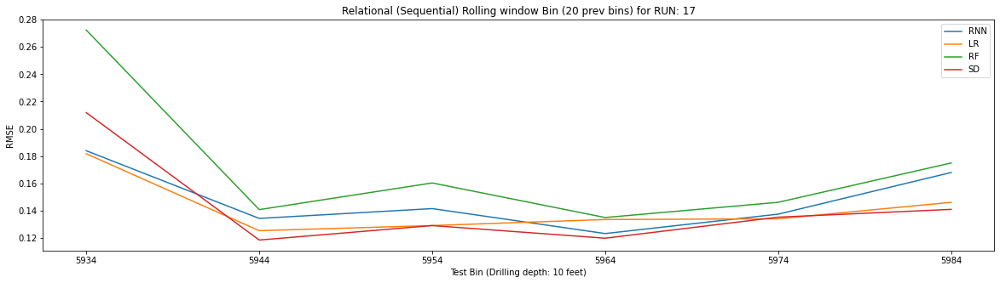

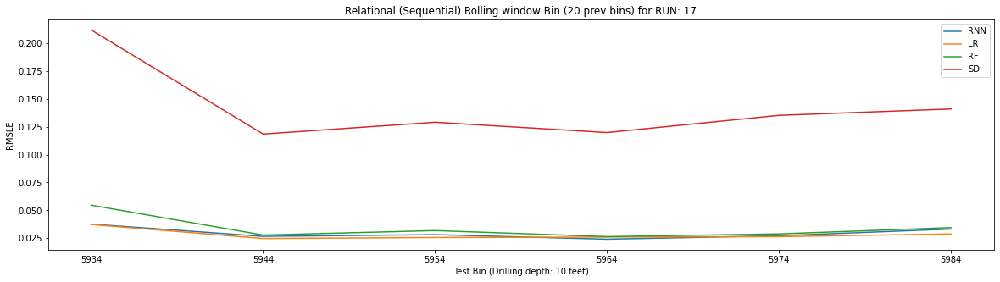

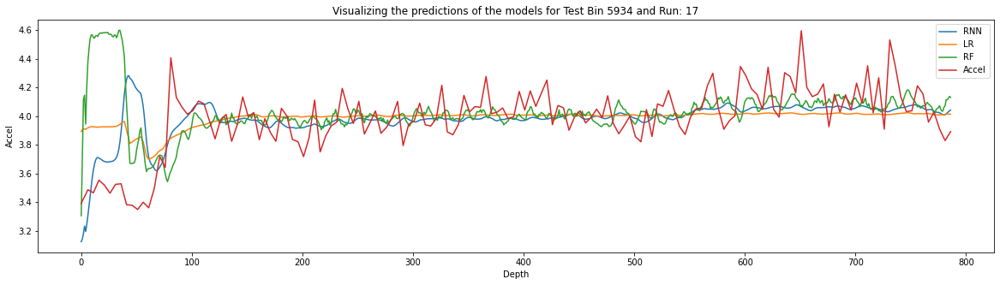

==========>
Rank of the models for Metric: RMSE
LR => 0.18 (RMSE)
RNN => 0.18 (RMSE)
RF => 0.27 (RMSE)
==========>
Rank of the models for Metric: RMSLE
LR => 0.04 (RMSLE)
RNN => 0.04 (RMSLE)
RF => 0.05 (RMSLE)


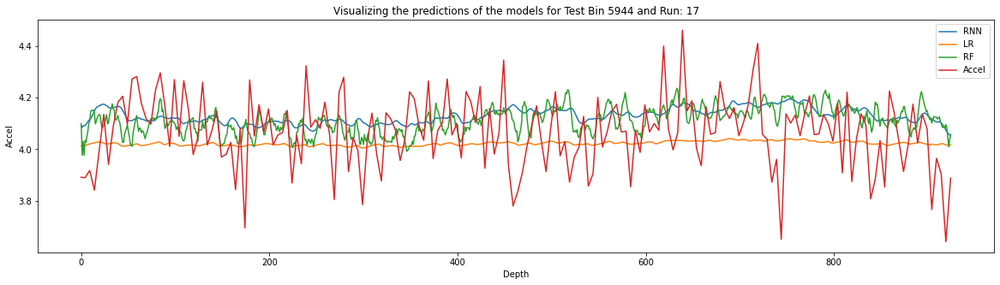

==========>
Rank of the models for Metric: RMSE
LR => 0.13 (RMSE)
RNN => 0.13 (RMSE)
RF => 0.14 (RMSE)
==========>
Rank of the models for Metric: RMSLE
LR => 0.02 (RMSLE)
RNN => 0.03 (RMSLE)
RF => 0.03 (RMSLE)


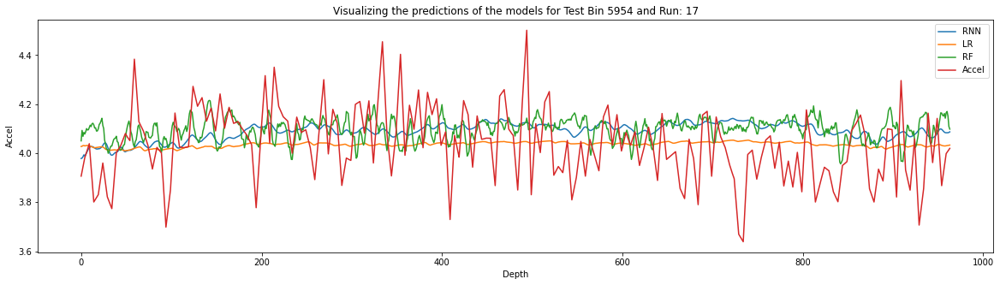

==========>
Rank of the models for Metric: RMSE
LR => 0.13 (RMSE)
RNN => 0.14 (RMSE)
RF => 0.16 (RMSE)
==========>
Rank of the models for Metric: RMSLE
LR => 0.03 (RMSLE)
RNN => 0.03 (RMSLE)
RF => 0.03 (RMSLE)


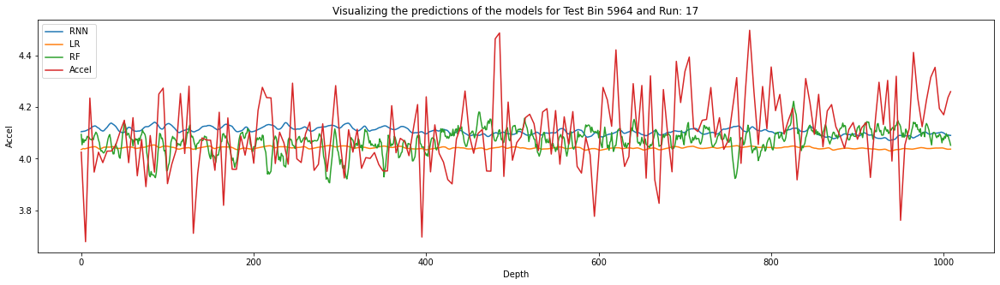

==========>
Rank of the models for Metric: RMSE
RNN => 0.12 (RMSE)
LR => 0.13 (RMSE)
RF => 0.13 (RMSE)
==========>
Rank of the models for Metric: RMSLE
RNN => 0.02 (RMSLE)
LR => 0.03 (RMSLE)
RF => 0.03 (RMSLE)


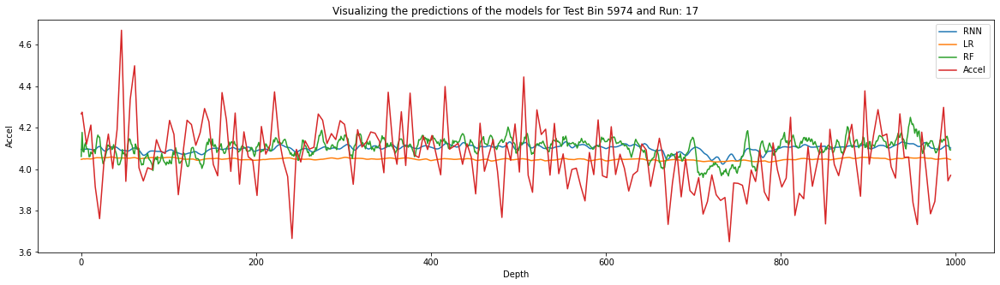

==========>
Rank of the models for Metric: RMSE
LR => 0.13 (RMSE)
RNN => 0.14 (RMSE)
RF => 0.15 (RMSE)
==========>
Rank of the models for Metric: RMSLE
LR => 0.03 (RMSLE)
RNN => 0.03 (RMSLE)
RF => 0.03 (RMSLE)


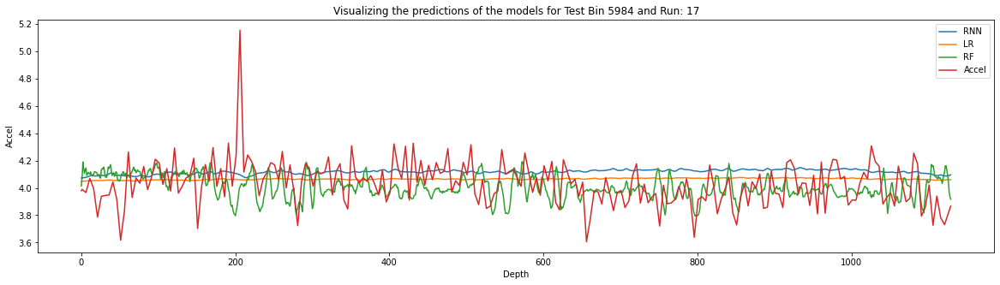

==========>
Rank of the models for Metric: RMSE
LR => 0.15 (RMSE)
RNN => 0.17 (RMSE)
RF => 0.17 (RMSE)
==========>
Rank of the models for Metric: RMSLE
LR => 0.03 (RMSLE)
RNN => 0.03 (RMSLE)
RF => 0.03 (RMSLE)


In [ ]:
mpg = ModelPredictionGenerator(
    experiment_settings="Relational_Bins", df_data= df_org, run=17, 
    features=features, target=target, models = models, metrics = metrics,
    K_fold=10,
    relational_bin_config = {"bin_depth": 10, "test_bin_start": 13, "test_bin_end": 18, "rolling_bin_size": 20},
    lstm_time_step = 10,
    debug = 4, metrics_plot=True, output_file = output_file)

all_prediction_df, test_bins = mpg.calculate_model_predictions()
mpg.generate_metrics_plot()

# mpg.plot_features(test_bin=5534)
for test_bin in test_bins:
    mpg.plot_model_predictions(test_bin=test_bin, smooth_N=5)

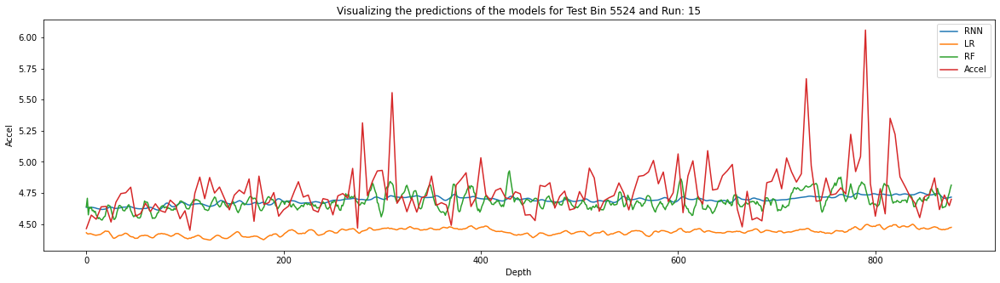

==========>
Rank of the models for Metric: RMSE
RNN => 0.18 (RMSE)
RF => 0.20 (RMSE)
LR => 0.37 (RMSE)
==========>
Rank of the models for Metric: RMSLE
RNN => 0.03 (RMSLE)
RF => 0.03 (RMSLE)
LR => 0.06 (RMSLE)


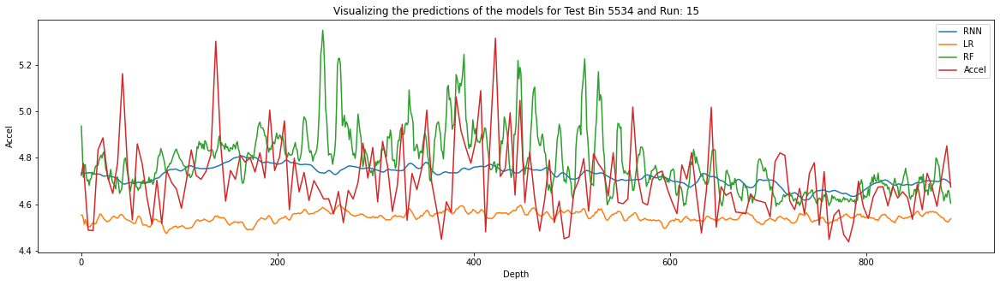

==========>
Rank of the models for Metric: RMSE
RNN => 0.12 (RMSE)
LR => 0.20 (RMSE)
RF => 0.21 (RMSE)
==========>
Rank of the models for Metric: RMSLE
RNN => 0.02 (RMSLE)
RF => 0.04 (RMSLE)
LR => 0.04 (RMSLE)


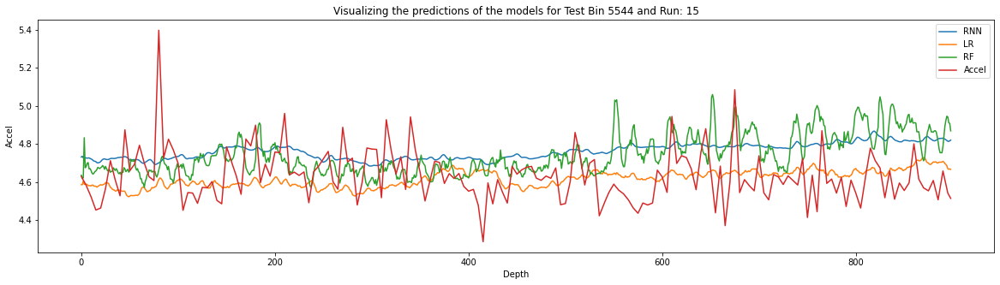

==========>
Rank of the models for Metric: RMSE
LR => 0.13 (RMSE)
RNN => 0.18 (RMSE)
RF => 0.21 (RMSE)
==========>
Rank of the models for Metric: RMSLE
LR => 0.02 (RMSLE)
RNN => 0.03 (RMSLE)
RF => 0.04 (RMSLE)


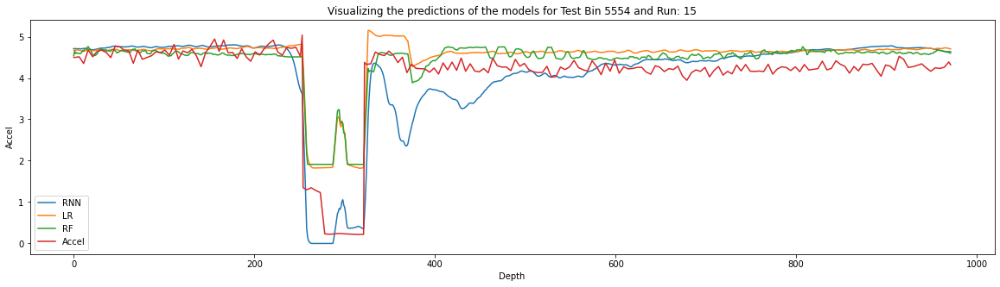

==========>
Rank of the models for Metric: RMSE
RNN => 0.51 (RMSE)
RF => 0.54 (RMSE)
LR => 0.57 (RMSE)
==========>
Rank of the models for Metric: RMSLE
RNN => 0.16 (RMSLE)
LR => 0.22 (RMSLE)
RF => 0.22 (RMSLE)


In [ ]:
# timestep 20 and window 10
for test_bin in test_bins:
    mpg.plot_model_predictions(test_bin=test_bin, smooth_N=5)

In [ ]:
mpg.save_prediction()

The predictions of the models have been saved in file predicted_outputs.csv


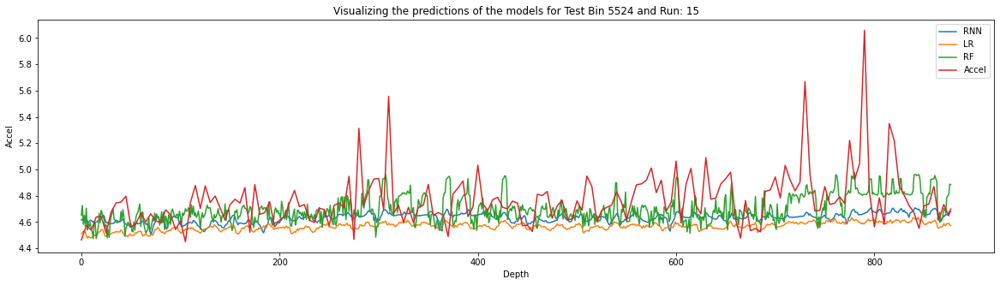

==========>
Rank of the models for Metric: RMSE
RF => 0.19 (RMSE)
RNN => 0.22 (RMSE)
LR => 0.26 (RMSE)
==========>
Rank of the models for Metric: RMSLE
RF => 0.03 (RMSLE)
RNN => 0.04 (RMSLE)
LR => 0.04 (RMSLE)


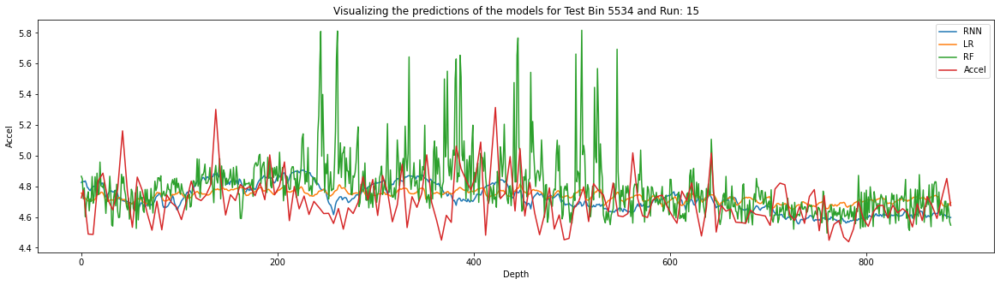

==========>
Rank of the models for Metric: RMSE
LR => 0.13 (RMSE)
RNN => 0.13 (RMSE)
RF => 0.22 (RMSE)
==========>
Rank of the models for Metric: RMSLE
LR => 0.02 (RMSLE)
RNN => 0.02 (RMSLE)
RF => 0.04 (RMSLE)


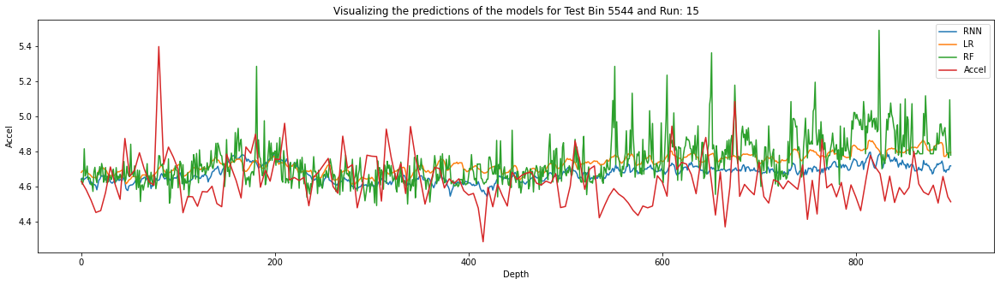

==========>
Rank of the models for Metric: RMSE
RNN => 0.13 (RMSE)
LR => 0.17 (RMSE)
RF => 0.21 (RMSE)
==========>
Rank of the models for Metric: RMSLE
RNN => 0.02 (RMSLE)
LR => 0.03 (RMSLE)
RF => 0.04 (RMSLE)


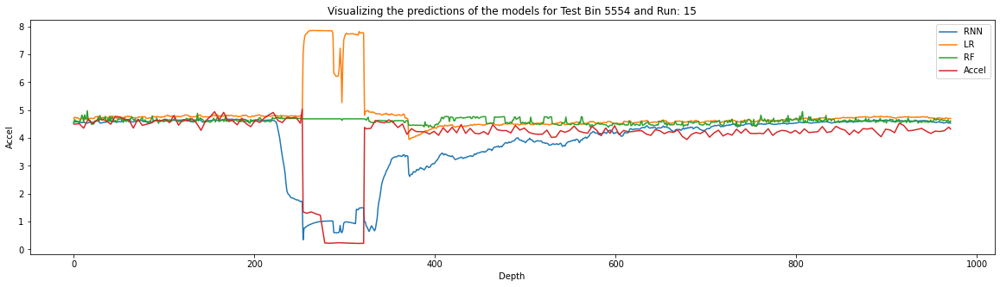

==========>
Rank of the models for Metric: RMSE
RNN => 0.81 (RMSE)
RF => 1.14 (RMSE)
LR => 1.88 (RMSE)
==========>
Rank of the models for Metric: RMSLE
RNN => 0.23 (RMSLE)
RF => 0.36 (RMSLE)
LR => 0.47 (RMSLE)


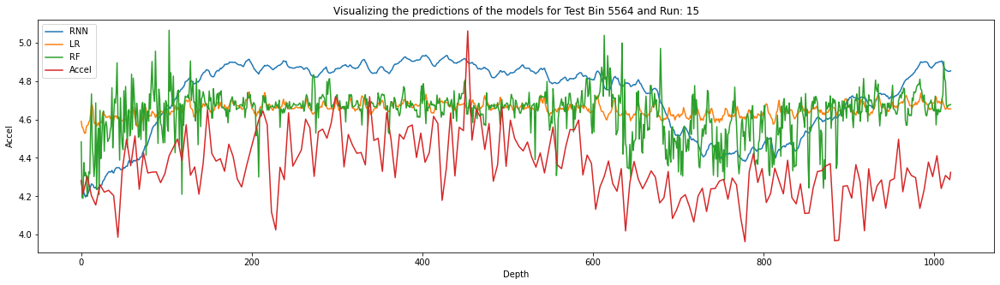

==========>
Rank of the models for Metric: RMSE
RF => 0.32 (RMSE)
LR => 0.33 (RMSE)
RNN => 0.40 (RMSE)
==========>
Rank of the models for Metric: RMSLE
RF => 0.06 (RMSLE)
LR => 0.06 (RMSLE)
RNN => 0.07 (RMSLE)


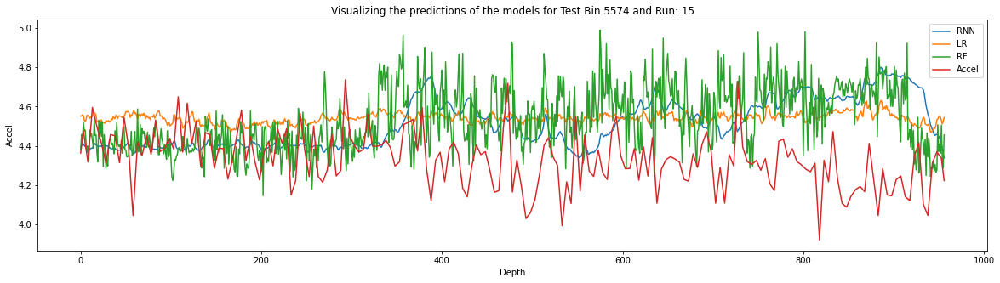

==========>
Rank of the models for Metric: RMSE
LR => 0.25 (RMSE)
RNN => 0.27 (RMSE)
RF => 0.30 (RMSE)
==========>
Rank of the models for Metric: RMSLE
LR => 0.05 (RMSLE)
RNN => 0.05 (RMSLE)
RF => 0.05 (RMSLE)


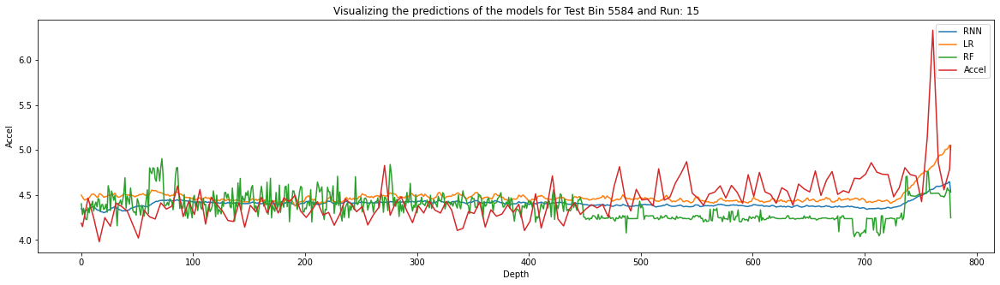

==========>
Rank of the models for Metric: RMSE
LR => 0.21 (RMSE)
RNN => 0.22 (RMSE)
RF => 0.30 (RMSE)
==========>
Rank of the models for Metric: RMSLE
LR => 0.04 (RMSLE)
RNN => 0.04 (RMSLE)
RF => 0.05 (RMSLE)


In [ ]:
# timestep = 60, prev window = 5
for test_bin in test_bins:
    mpg.plot_model_predictions(test_bin=test_bin)

In [ ]:
a = [[1], [2], [3]]
print(a)
print(a.tolist())

In [ ]:
df = mpg.all_prediction_df
print(df.head())

In [ ]:
l1 = [1, 2, 3]
l2 = [44, 55, 66]

l3 = l1 + l2
print(l3)
l2 = [2,34, 444444]
print(l3)


[1, 2, 3, 44, 55, 66]
[1, 2, 3, 44, 55, 66]


In [ ]:
li = [1, 2, 4, 5, 6, 7]
print(li[:3])

[1, 2, 4]


#### Tmp

In [ ]:
# def make_dataset(data, target, window_size, suffle=False):
#   data = np.array(X, dtype=np.float32)
#   target = np.array(y, dtype=np.float32)

#   ds = tf.keras.utils.timeseries_dataset_from_array(
#       data=data,
#       targets=target,
#       sequence_length=window_size,
#       sequence_stride=1,
#       shuffle=suffle,
#       batch_size=3,
#       )

# #   ds = ds.map(self.split_window)
#   return ds

# # X = []
# # for r in range(10):
# #     t = [r, 10+r, 20+r]
# #     X.append(t)
# # print(X)

# m = {"f1": np.arange(10), "f2": np.arange(20, 30), "t": np.arange(100, 110)}
# df = pd.DataFrame(m)
# print(df)

# pre = df.tail(3)
# print(pre)

# print(type(df))



In [ ]:
# K_mses_relational_bins_rolling_window = non_linear_relationship(settings="Relational_Bins_rolling_window", df_data= df_org, run=15, features=features, target=target, models = models, K=15, window_size=10, metric="RMSLE", debug = 5)

In [ ]:
# K_mses_relational_bins_rolling_window = non_linear_relationship(settings="Relational_Bins_rolling_window", df_data= df_org, run=15, features=features, target=target, models = models, K=15, window_size=10, debug = 5)

In [ ]:
# K_mses_relational_bins_rolling_window = non_linear_relationship(settings="Relational_Bins_rolling_window", df_data= df_org, run=17, features=features, target=target, models = models, K=10, window_size=10, debug = 5)


In [ ]:
# K_mses_bins_K_fold = non_linear_relationship(settings="Bins_K_fold", df_data= df_org, run=15, features=features, target=target, models = models, K=5, debug = 0)

In [ ]:
# from sklearn.model_selection import KFold
# from sklearn.metrics import mean_squared_error
# from sklearn.metrics import mean_squared_log_error
# import statistics

# '''
# Parameters
# ----------
# :param train_test_pair: touple of 4 lists (X_train, y_train, X_test, y_test) 
# :param models: str list of ML models
# :param metrics: str list of output metrics

# Returns
# -------
# :return predictions: A map {Model => [prediction values]}
# :return performance_metrics: 

# '''
# def train_models_and_predict(train_test_pair, models, metrics, features):
#     (X_train, y_train, X_test, y_test) = train_test_pair
#     X_train, X_test = get_normalized_data(X_train, X_test, features)

#     predictions = {}
#     performance_metrics = {}
#     for model in models:
#         performance_metrics[model] = {}
#     for algo in models:
#         if algo == "SD":
#             for metric in metrics:
#                 performance_metrics[algo][metric] =  statistics.stdev(y_test.tolist())
#             continue
#         if (algo == "LR"):
#             y_pred, model_LR = get_prediction_LR(X_train, y_train, X_test)
#         if (algo == "RF"):
#             y_pred, model_RF = get_prediction_RF(X_train, y_train, X_test)            
#         if (algo == "SVM"):
#             y_pred, model_SVM = get_prediction_SVM(X_train, y_train, X_test)            
#         if (algo == "AutoSKlearn"):
#             y_pred, model_SVM = get_prediction_autoSKlearn(X_train, y_train, X_test, max_time=120)
#         if (algo == "RNN"):
#             # y_pred, model_RNN = get_prediction_RNN(X_train, y_train, X_test)
#             y_pred, model_RNN = get_prediction_RNN(X_train, y_train, X_test, y_test)
        
#         y_pred_list = y_pred.tolist()
#         y_true = y_test.tolist()

#         for metric in metrics:
#             if metric == "MSE":
#                 err = mean_squared_error(y_true, y_pred_list)
#                 performance_metrics[algo][metric] =  err
#             if metric == "RMSE":
#                 err = math.sqrt(mean_squared_error(y_true, y_pred_list))
#                 performance_metrics[algo][metric] =  err
#             if metric == "RMSLE":
#                 err = math.sqrt(mean_squared_log_error(y_true, y_pred_list))
#                 performance_metrics[algo][metric] =  err
#         # print(performance_metrics)
#         # res.append(err)
#         predictions[algo] = y_pred_list
#     predictions["Original Value"] = y_true
#     performance_metrics["Standard Deviation"] =  statistics.stdev(y_true)
    
#     return predictions, performance_metrics
#     # return res, org_test_preds







# def model_predictions(settings, models, features, target,  df_data, run, metrics = ["RMSE"],
#                             K_fold=10, start_test_bin = 10, end_test_bin=12, prev_train_bin_size=1, 
#                             plot=True, debug=0, detail_visualization=False, output_file=None):


#     # all_performance_metics = {}
#     all_prediction_df = pd.DataFrame()

#     # for algo in models:
#     #     all_performance_metics[algo] = {}
#     #     for metric in metrics:
#     #         all_performance_metics[algo][metric] = []
    
#     # print(all_performance_metics)

#     if(settings == "Random_K_fold"):
#         train_test_pairs = K_fold_train_test_dataset(df_data, run, features, target, K, random = True, debug=debug)
#         plot_title = "Random (Time based) %d-fold MSE for RUN: %d" % (K, run)
#         x_ticks_labels = [str(i) for i in range(K)]
#         xlabel="Test Fold (Time-based)"

#     if(settings == "Seqential_K_fold"):
#         train_test_pairs = K_fold_train_test_dataset(df_data, run, features, target, K, random = False, debug=debug)
#         plot_title = "Sequential (Time based) %d-fold MSE for RUN: %d" % (K, run)
#         x_ticks_labels = [str(i) for i in range(K)]
#         xlabel="Test Fold (Time-based)"
    
#     if(settings == "Non_relational_Bins_K_fold"):
#         train_test_pairs, test_bins = Bins_K_fold_train_test_dataset(df_data, run, features, target, K, bin_size)
#         plot_title = "Non relational Sequential Bin (Depth based: %d feet drilling) MSE for RUN: %d" % (bin_size, run)
#         x_ticks_labels = [str(bin) for bin in bins]
#         xlabel="Test Bin (Drilling depth)"
        
#     if(settings == "Relational_Bins"):
#         df_run_bin, train_test_pairs, test_bins = relational_Bins_rolling_window_train_test(
#             df_data, run, features, target, K, bin_size, start_window, end_window, window_size)
#         plot_title = "Relational (Sequential) Rolling window Bin (Window size: %d bins)  (Depth based: %d feet drilling) for RUN: %d" % (window_size, bin_size, run)
#         x_ticks_labels = [str(bin) for bin in test_bins]
#         xlabel="Test Bin (Drilling depth)"
#         print(test_bins)
#         # return

#     print("=========> train_test pair size: %d" % len(train_test_pairs))
#     # k = 0

#     for exp_ind, train_test_pair in enumerate(train_test_pairs):

#         if (debug >= 1):
#             print("====> Experiment number: %d test bin: %d" % (exp_ind, test_bins[exp_ind]))
#         predictions, performance_metrics = train_models_and_predict(train_test_pair, models, metrics, features)

#         if output_file is not None:            
#             test_bin = x_ticks_labels[k]
#             if (debug >= 2):
#                 print("%s bin %s" % (test_bin, predictions))
#             m = predictions.copy()
#             m["Run"] = run
#             m["Test_bin"] = test_bin
#             # print(pd.Series(m))
#             output_df = output_df.append(m, ignore_index=True)


#         if (debug >= 2):
#             print("==> Train test complete Algo: %s and %s and %s" % (models, metrics, performance_metrics))
#         # for i in range(len(models)):
#         #     K_mses[models[i]].append(mses[i])
#         for model in models:
#             for metric in metrics:
#                 all_performance_metics[model][metric].append(performance_metrics[model][metric])
#         # all_performance_metics["Standard Deviation"] = performance_metrics["Standard Deviation"]
        

#         if(detail_visualization == True):
#             test_bin = x_ticks_labels[k]
#             plot_title = "Original Acceleration vs predicted Accel on Test Bin %s and Run: %d" % ( test_bin, run)
#             plot_prediction(map_preds=predictions,  plot_title = plot_title)
            
#             df_plot_data = df_run_bin[df_run_bin["Bins"] == int(test_bin)]
#             print("+++ len: %d" % len(df_plot_data))
#             plot_title = "Visualizing features of the dataset for Test Bin %s and Run: %d" % (test_bin, run)
#             visualize_test_data_bin(df_plot_data, plot_title)
#             # return


#         k += 1

#     print("===> All metrics %s" % all_performance_metics)
#     if output_file is not None:
#         output_df.to_csv(output_file, index=False, quotechar='"', quoting=csv.QUOTE_NONNUMERIC)
#         print("The predictions of the models have been saved in file %s" % output_file)
#     if(plot == True):
#         for metric in metrics:
#             # if(debug >= 2):
#             #     print(K_mses)
#             plot_performance_metrices(all_performance_metics, metric, title=plot_title, x_ticks_labels=x_ticks_labels, xlabel=xlabel)

#     return all_performance_metics



# class ModelPredictionGenerator():
#   def __init__(self, settings, models, features, target,  df_data, run, metrics = ["RMSE"],
#                 K_fold=10, relational_bin_config = None, 
#                 metrics_plot=True, debug=0, feature_plot=False, output_file=None):
#     # Store the raw data.
#     self.settings = settings
#     self.models = models
#     self.features = features
#     self.target = target
#     self.df_data = df_data
#     self.run = run
#     self.metrics = metrics
#     self.K_fold = K_fold
#     self.relational_bin_config = relational_bin_config
#     if self.relational_bin_config is not None:
#         self.bin_depth = relational_bin_config["bin_depth"]
#         self.test_bin_start = relational_bin_config["test_bin_start"]
#         self.test_bin_end = relational_bin_config["test_bin_end"]
#         self.rolling_bin_size = relational_bin_config["rolling_bin_size"]
#     self.debug = debug
#     self.metrics_plot = metrics_plot
#     self.feature_plot = feature_plot
#     self.output_file = output_file
    


#     if(settings == "Random_K_fold"):
#         train_test_pairs = K_fold_train_test_dataset(df_data, run, features, target, K_fold, random = True, debug=debug)
#         plot_title = "Random (Time based) %d-fold MSE for RUN: %d" % (K, run)
#         x_ticks_labels = [str(i) for i in range(K)]
#         xlabel="Test Fold (Time-based)"

#     if(settings == "Seqential_K_fold"):
#         train_test_pairs = K_fold_train_test_dataset(df_data, run, features, target, K_fold, random = False, debug=debug)
#         plot_title = "Sequential (Time based) %d-fold MSE for RUN: %d" % (K, run)
#         x_ticks_labels = [str(i) for i in range(K)]
#         xlabel="Test Fold (Time-based)"
    
#     if(settings == "Non_relational_Bins_K_fold"):
#         train_test_pairs, test_bins = Bins_K_fold_train_test_dataset(df_data, run, features, target, K, bin_size)
#         plot_title = "Non relational Sequential Bin (Depth based: %d feet drilling) MSE for RUN: %d" % (bin_size, run)
#         x_ticks_labels = [str(bin) for bin in bins]
#         xlabel="Test Bin (Drilling depth)"
        
#     if(settings == "Relational_Bins"):
#         self.train_test_pairs, self.test_bins = self.relational_Bins_train_test()
#         plot_title = "Relational (Sequential) Rolling window Bin (Window size: %d bins)  \
#         (Depth based: %d feet drilling) for RUN: %d" % (self.rolling_bin_size, self.bin_depth, self.run)
#         x_ticks_labels = [str(bin) for bin in self.test_bins]
#         xlabel="Test Bin (Drilling depth)"




# def relational_Bins_train_test(self):
#     df_bin = classify_to_bins(df_org, bin_type="depth", bin_size=self.bin_depth)
#     df_run_bin = df_bin[df_bin['Run'] == self.run]
#     if(self.debug > 1):
#         print("Run: %d and total data points: %d" % (self.run, len(df_run_bin)))
#     cur_columns = features + [target, "Bins"]
#     df_run_bin = df_run_bin[cur_columns]

#     bins = df_run_bin['Bins'].unique().tolist()
#     # if(self.debug > 1):
#     #     print("Total bins: %d: %s" % (len(bins), bins))
    
#     train_test_pairs = []
#     test_bins = []
#     start_bin = self.test_bin_start
#     end_bin = min(self.test_bin_end+1, len(bins))
#     for test_bin_ind in range(start_bin, end_bin):
#         train_bin = [bins[i] for i in range(test_bin_ind)][-self.rolling_bin_size-1:]
#         test_bin = bins[test_bin_ind]
#         test_bins.append(test_bin)
#         # if(self.debug > 1):
#         #     print("Train bins: %s and Test bin: %s" % (train_bin, test_bin))
#         df_train = df_run_bin[df_run_bin["Bins"].isin(train_bin)]
#         df_test =  df_run_bin[df_run_bin["Bins"] == test_bin]
        
#         X_train = df_train[features]
#         y_train = df_train[target]
#         X_test = df_test[features]
#         y_test = df_test[target]
#         train_test_pair = (X_train, y_train, X_test, y_test)
#         train_test_pairs.append(train_test_pair)

#         if(self.debug > 2):
#             print("Test bin index: %d Train bins: %s and Test bin: %s #X_train: %d #X_test: %d" % 
#                   (test_bin_ind, train_bin, test_bin, len(X_train), len(X_test)))

#     return train_test_pairs, test_bins

# ModelPredictionGenerator.relational_Bins_train_test = relational_Bins_train_test

# # plot_mse(K_mses_bins_K_fold, title="Manual", x_ticks = x_ticks, xlabel="Test Bins")

# features = ["ROP", "Torque", "Weight_on_Bit", "Run_Depth"]
# target = "Accel"

# models=["LR", "RF", "SVM"]
# models=["SD", "LR", "RF", "RNN"]
# models=["LR", "RF"]

# metrics = ["RMSE", "RMSLE"]
# output_file = "predicted_outputs.csv"

# # relational_bin_config

# # K_mses_relational_bins_rolling_window = model_predictions(
# #     settings="Relational_Bins_rolling_window", df_data= df_org, run=15, 
# #     features=features, target=target, models = models, metrics = metrics,
# #     K_fold=10, start_test_bin = 10, end_test_bin=12, prev_train_bin_size=1, 
# #     debug = 4, detail_visualization=False, output_file = output_file)

# mpg = ModelPredictionGenerator(
#     settings="Relational_Bins", df_data= df_org, run=15, 
#     features=features, target=target, models = models, metrics = metrics,
#     K_fold=10,
#     relational_bin_config = {"bin_depth": 10, "test_bin_start": 10, "test_bin_end": 12, "rolling_bin_size": 5}, 
#     debug = 4, metrics_plot=False, output_file = output_file)


Run: 15 and total data points: 11262
Test bin index: 10 Train bins: [5464, 5474, 5484, 5494, 5504, 5514] and Test bin: 5524 #X_train: 3906 #X_test: 878
Test bin index: 11 Train bins: [5474, 5484, 5494, 5504, 5514, 5524] and Test bin: 5534 #X_train: 4307 #X_test: 887
Test bin index: 12 Train bins: [5484, 5494, 5504, 5514, 5524, 5534] and Test bin: 5544 #X_train: 4654 #X_test: 899


In [ ]:
# K_mses_relational_bins_rolling_window = non_linear_relationship(settings="Relational_Bins_rolling_window", df_data= df_org, run=15, features=features, target=target, models = models, K=10, window_size=10, debug = 5)


# models=["LR", "RF", "SVM", "AutoSKlearn"]
# K_mses_random_K_fold = non_linear_relationship(settings="K_fold", df_data= df_org, run=15, features=features, target=target, models = models, K=10, debug = 0)
# K_mses_random_K_fold = non_linear_relationship(settings="Random_K_fold", df_data= df_org, run=15, features=features, target=target, models = models, K=10, debug = 0)
# K_mses_sequential_K_fold = non_linear_relationship(settings="Seqential_K_fold", df_data= df_org, run=15, features=features, target=target, models = models, K=10, debug = 0)
# K_mses_bins_K_fold = non_linear_relationship(settings="Bins_K_fold", df_data= df_org, run=15, features=features, target=target, models = models, K=10, debug = 0)

# Bins_relational_specific_test(df_data=df_bin, run=15, features=features, target=target, models = models, test_bin=5544)
# Bins_relational_test(df_data=df_bin, run=15, features=features, target=target, models = models, bin_sliding_window=10)

# plot_mse(K_mses_bins_K_fold, title="Manual", x_ticks=None)

11262
17
[5424, 5434, 5444, 5454, 5464, ..., 5544, 5554, 5564, 5574, 5584]
Length: 17
Categories (113, int64): [5424 < 5434 < 5444 < 5454 ... 6514 < 6524 < 6534 < 6544]


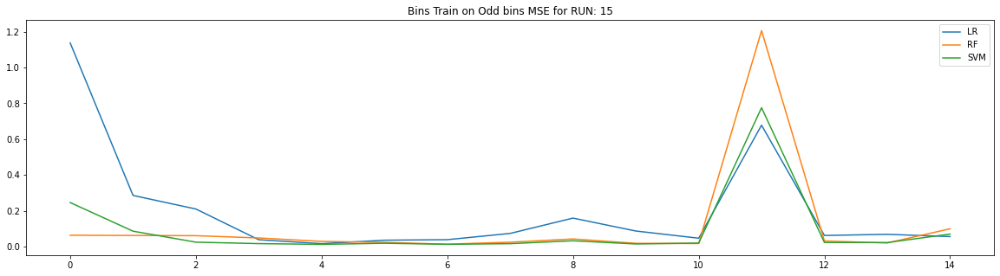

time: 1min 30s


In [ ]:
K_mses_bins_K_fold = non_linear_relationship(settings="Bins_K_fold", df_data= df_org, run=15, features=features, target=target, models = models, K=15, debug = 0)

##### K-fold random

11262
[0.07985630593995617, 0.08656323138128941, 0.0701025323577698, 0.08404730877174715, 0.08586727567575846, 0.07841899397330483, 0.08313370854482127, 0.07974939409006841, 0.08742501075688494, 0.09758051820951018]
[0.0029231213621202378, 0.003982497839676353, 0.003104243222878016, 0.004616361978776355, 0.003964716164131607, 0.0031355607833978695, 0.003462451002226108, 0.0032468361030255125, 0.004486873410536844, 0.0039381949840818645]
[0.01754513728144843, 0.02841548044530347, 0.02097604200777816, 0.02203313654180433, 0.01899968095144911, 0.015985164950352463, 0.020011290808657222, 0.01873865332930557, 0.017588588950106468, 0.02290256757679816]


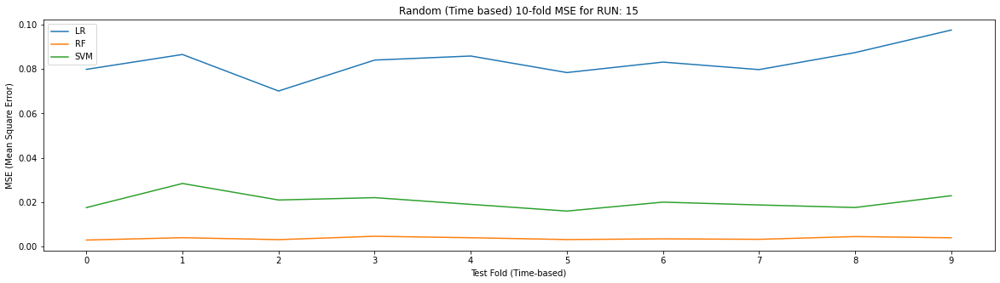

time: 1min 9s


In [ ]:
K_mses_random_K_fold = non_linear_relationship(settings="Random_K_fold", df_data= df_org, run=15, features=features, target=target, models = models, K=10, debug = 0)

21817
[0.04257446924697006, 0.04109301238702848, 0.04246445439899745, 0.044653908397258614, 0.040118100142350836, 0.04143181064376349, 0.041409373670557185, 0.03771501586918953, 0.043508328849824376, 0.042612158095052276]
[0.0038734871955055424, 0.003849432663135738, 0.003969554655101643, 0.0045015125885633795, 0.0038298621654910244, 0.005409781272846675, 0.004755846103148627, 0.0036291016918646, 0.004200726887146736, 0.0039828912570865375]
[0.023545080457824698, 0.02363188902949253, 0.023931887797842777, 0.026296487274174, 0.024300427303980403, 0.02379221724584815, 0.025896930417014144, 0.021594122447211542, 0.025450775161994958, 0.024590990833056013]


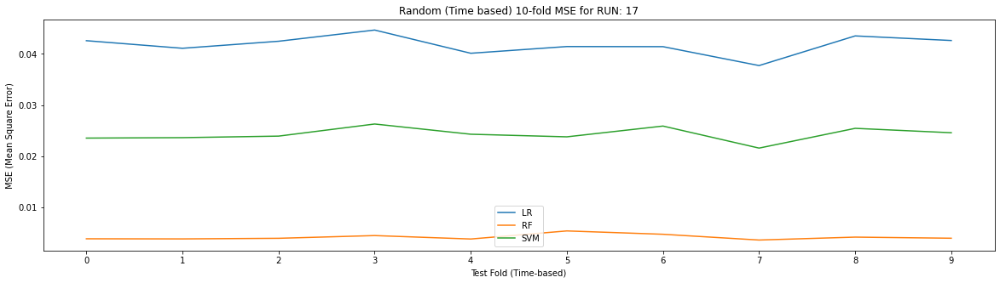

time: 3min 22s


In [ ]:
K_mses_random_K_fold = non_linear_relationship(settings="Random_K_fold", df_data= df_org, run=17, features=features, target=target, models = models, K=10, debug = 0)
# K_mses_bins_K_fold = non_linear_relationship(settings="K_fold", df_data= df_org, run=17, features=features, target=target, models = models, K=10, debug = 0)

##### K-fold sequential

11262
[5.831188986170722, 0.08031858232192032, 0.03278472254746847, 0.04964355242833134, 0.13123028826078997, 0.11051482725417451, 0.675812300716312, 0.07266665029220776, 0.07867880961055411, 0.07881307985333773]
[0.07745352514749757, 0.027534335440110247, 0.0399933405426947, 0.014865184475278945, 0.028636739683935576, 0.03536090280137415, 1.04248854514365, 0.07460296515586147, 0.03631458908623041, 0.08457756725908484]
[0.8783055749936081, 0.015455635959825617, 0.019171293422173465, 0.017675811047393405, 0.019239962665962364, 0.025597725770990346, 0.6826560432765402, 0.03438975539644572, 0.018596692099997494, 0.048200658420537355]


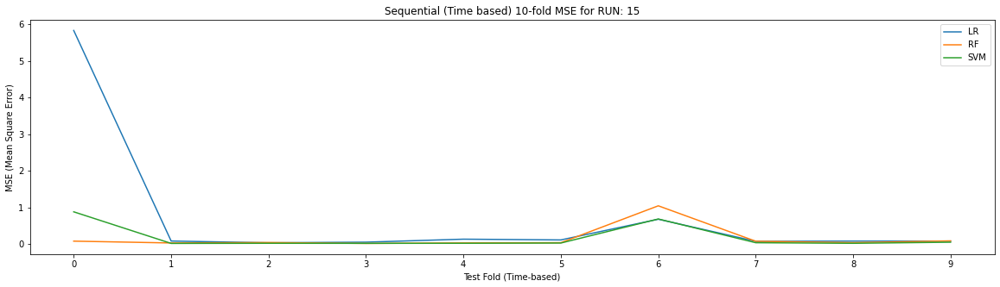

time: 59.6 s


In [ ]:
K_mses_sequential_K_fold = non_linear_relationship(settings="Seqential_K_fold", df_data= df_org, run=15, features=features, target=target, models = models, K=10, debug = 0)

21817
[0.757112376824941, 0.022193464266983973, 0.046849759530395364, 0.02174636564040273, 0.02878270642769452, 0.02456080078252659, 0.0655247711656712, 0.04108429403390813, 0.09413842595016797, 0.04739856287291509]
[0.24077608418315488, 0.016373744287829096, 0.051795453932709415, 0.03826161226091355, 0.022314822428841086, 0.05520139988268592, 0.04009544584098423, 0.032206553047778926, 0.09187512609082146, 0.0691205977029527]
[0.043194960641904055, 0.015009900622497267, 0.05976443604724725, 0.01844372476958471, 0.0383483990209145, 0.021367520948176694, 0.0705747362374888, 0.057872100739495023, 0.10792034690408579, 0.13515476285113867]


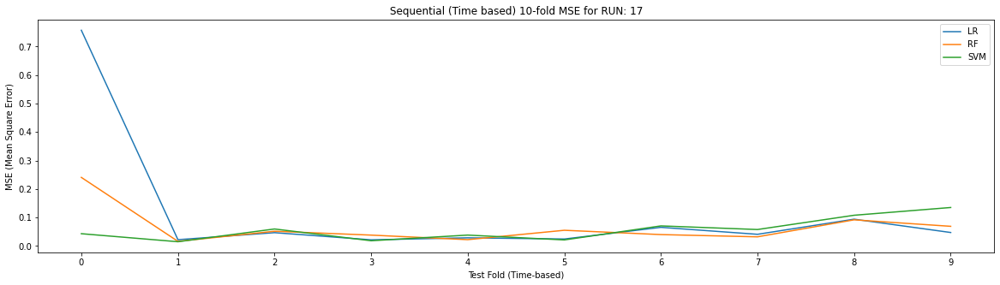

time: 3min 10s


In [ ]:
K_mses_sequential_K_fold = non_linear_relationship(settings="Seqential_K_fold", df_data= df_org, run=17, features=features, target=target, models = models, K=10, debug = 0)

##### Non-relational Bins K-fold

11262
17
[5424, 5434, 5444, 5454, 5464, 5474, 5484, 5494, 5504, 5514, 5524, 5534, 5544, 5554, 5564, 5574, 5584]
[1.2308988548750237, 0.11072149542924466, 0.1826605289669759, 0.3283300605833237, 0.21032998573372752, 0.038864686530986965, 0.01694574220624456, 0.036243244451831705, 0.039217399648400306, 0.07411124952564929, 0.15958668109705737, 0.08750646776730298, 0.04740344399997378, 0.6780974557554736, 0.06270674067540184, 0.06907534544158672, 0.05655303199006841]
[0.024727144144955616, 0.02737361531655646, 0.06517070155967829, 0.050393964814038954, 0.057464733507737155, 0.03849196406589422, 0.029245945258662004, 0.024270813938794766, 0.01384408791386086, 0.026083424478507915, 0.04216051819456136, 0.019167856310011333, 0.018560777385376464, 1.2047074192036344, 0.029111466646862687, 0.020192735872642763, 0.1053271450961011]
[0.33497693744639834, 0.01731610417275559, 0.03784668643245935, 0.08136358736480981, 0.02529186927019155, 0.017261441642796502, 0.012966251894256133, 0.0192865638828

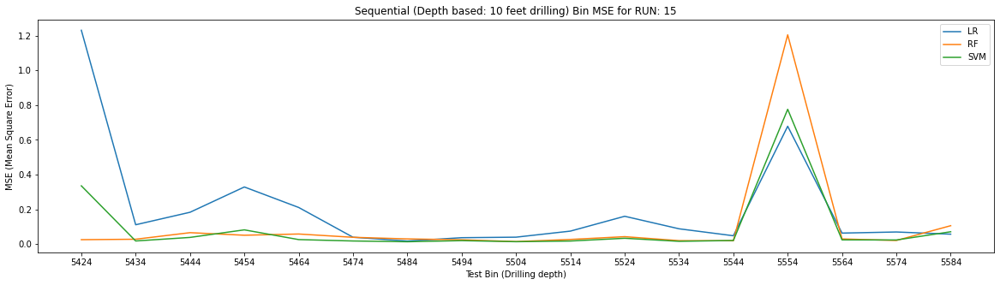

time: 1min 47s


In [ ]:
K_mses_bins_K_fold = non_linear_relationship(settings="Non_relational_Bins_K_fold", df_data= df_org, run=15, features=features, target=target, models = models, K=10, debug = 0)
# K_mses_sequential_K_fold = non_linear_relationship(settings="Seqential_K_fold", df_data= df_org, run=15, features=features, target=target, models = models, K=10, debug = 0)
# K_mses_bins_K_fold = non_linear_relationship(settings="Bins_K_fold", df_data= df_org, run=15, features=features, target=target, models = models, K=10, debug = 0)

21817
28
[5804, 5814, 5824, 5834, 5844, 5854, 5864, 5874, 5884, 5894, 5904, 5914, 5924, 5934, 5944, 5954, 5964, 5974, 5984, 5994, 6004, 6014, 6024, 6034, 6044, 6054, 6064, 6074]
[0.3941959262560049, 0.33542503196724527, 0.14386494596449256, 0.04005714597096297, 0.09129832947560768, 0.09264519289673324, 0.06012468611298669, 0.017294558940472493, 0.01131682305932586, 0.026094743824474895, 0.01544377065217001, 0.018073748775242326, 0.07167042154946104, 0.03737133965553748, 0.020378035473757956, 0.01728190555601315, 0.03076639986910314, 0.029242453267845307, 0.025263004232747407, 0.024753177548006905, 0.09571440483208259, 0.0270471442982678, 0.03854061228626711, 0.039884251146993496, 0.05783929756501145, 0.1381826148944367, 0.04845881544634469, 0.1486367443080404]
[0.23165870017309953, 0.03833123745654741, 0.012079936875394066, 0.03174563633255319, 0.004867467607100918, 0.012861772665771916, 0.010241938162046393, 0.019488148244739822, 0.012937514551322346, 0.015568833068126715, 0.014563291

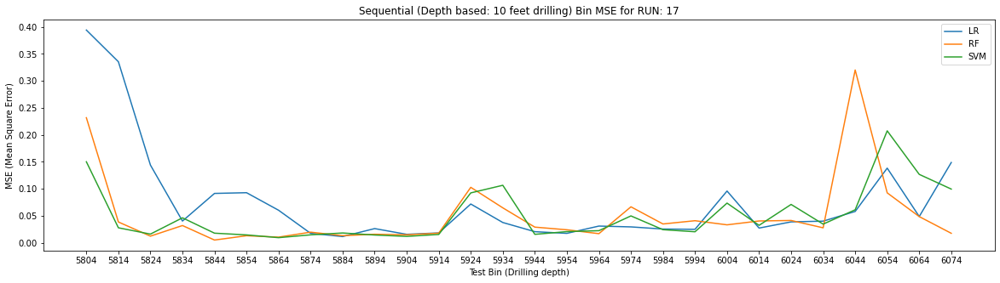

time: 9min 45s


In [ ]:
K_mses_bins_K_fold = non_linear_relationship(settings="Non_relational_Bins_K_fold", df_data= df_org, run=17, features=features, target=target, models = models, K=10, debug = 0)


9949
15
[5424, 5434, 5444, 5464, 5474, 5484, 5494, 5504, 5514, 5524, 5534, 5544, 5564, 5574, 5584]
[0.5864592979214444, 0.03228099862100775, 0.21497255926097447, 0.2979731169847736, 0.09127723449375603, 0.03455997426125097, 0.027374438697773344, 0.023909759746975363, 0.055443506142086686, 0.13456025272585553, 0.07193006928192706, 0.03878596715554936, 0.0742339288998191, 0.08296529467127642, 0.06755742968536994]
[0.02510512467038919, 0.02130896078937621, 0.030791656606105656, 0.07639210519999295, 0.05051301868822022, 0.030644228804601187, 0.023860996425709973, 0.013588730181654369, 0.025276235174279005, 0.042323427509765504, 0.01927364217790239, 0.0297866573930279, 0.02705737927605109, 0.020806590859919774, 0.08801216163178137]
[0.151948421734539, 0.027068024546230748, 0.028316633024768775, 0.02306315599172997, 0.018871276702636445, 0.012974031487387966, 0.019416542203393526, 0.013251043264502197, 0.016369169474310646, 0.03511557248510557, 0.015754269110897588, 0.017211696273775664, 0.0

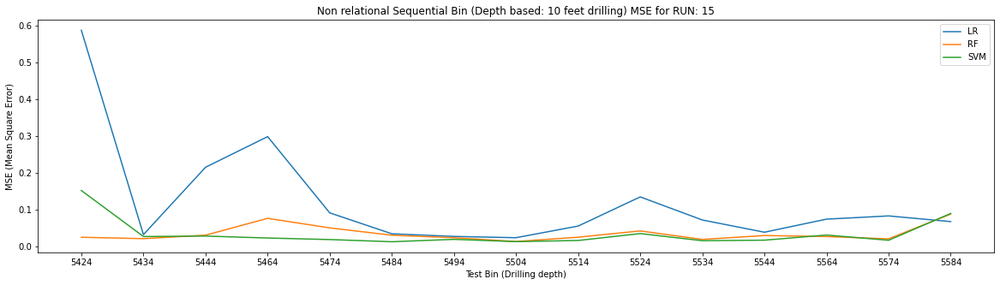

time: 1min 20s


In [ ]:
K_mses_bins_K_fold = non_linear_relationship(settings="Non_relational_Bins_K_fold", df_data= df_removed_bin, run=15, features=features, target=target, models = models, K=10, debug = 0)


16644
22
[5804, 5814, 5824, 5834, 5844, 5854, 5864, 5874, 5884, 5894, 5904, 5914, 5944, 5954, 5964, 5984, 5994, 6014, 6024, 6034, 6044, 6064]
[0.10632263842957203, 0.2659029941440478, 0.07363311902796833, 0.025519816002222806, 0.11195077187231632, 0.09218273810143922, 0.05051857119433703, 0.013890801549226709, 0.011352742793946437, 0.017326317708700443, 0.010557852172476675, 0.024224708213035115, 0.023006272741234304, 0.018391766172761646, 0.031060438126873837, 0.023543892450869266, 0.029925256780333646, 0.03507431641450062, 0.031772714279304885, 0.026558308637544513, 0.04145695634797453, 0.09049136046504203]
[0.294955045615455, 0.045617522782046546, 0.01103172072190483, 0.03042761799306895, 0.004838504490516232, 0.012697670971760885, 0.010583762273415726, 0.02081657719946096, 0.013405744032280302, 0.0153649822346121, 0.01533376418734377, 0.02775386310597506, 0.02212855289608903, 0.024263758890001038, 0.02736465909202232, 0.045914322601925704, 0.032429515109255236, 0.091610859137824, 0

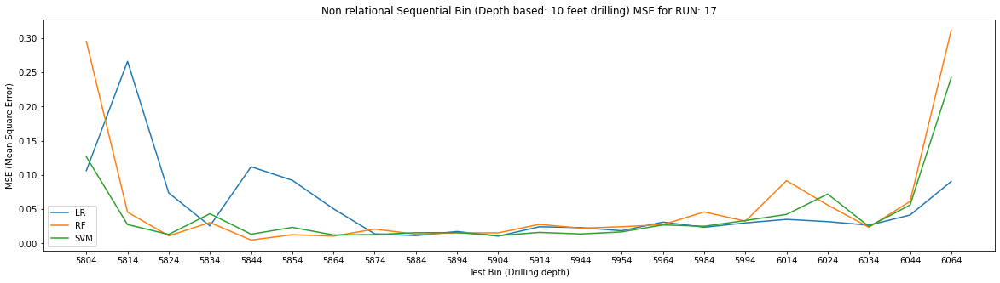

time: 4min 32s


In [ ]:
K_mses_bins_K_fold = non_linear_relationship(settings="Non_relational_Bins_K_fold", df_data= df_removed_bin, run=17, features=features, target=target, models = models, K=10, debug = 0)


##### Relational Bins

11262
17
[5424, 5434, 5444, 5454, 5464, 5474, 5484, 5494, 5504, 5514, 5524, 5534, 5544, 5554, 5564, 5574, 5584]
[0.014906919004344939, 0.01649123838758685, 0.04903582185531131, 0.045033375652815996, 0.046138191031710095, 0.11990164141336833, 0.15820700112823063, 0.9128650758773185, 0.2197721524844497, 0.11142748374061662, 0.05655303199006841]
[0.08135302662439219, 0.06816948129282419, 0.015265489829238652, 0.021481712408426175, 0.06042846208270935, 0.03077626460754723, 0.031261137481168114, 1.2597466844524046, 0.035066271307082224, 0.02078672950005423, 0.11013199268299491]
[0.021325970565286734, 0.06210955746359628, 0.06626016055873014, 0.018870492085428688, 0.03676205819888924, 0.04037755852560129, 0.016332016033919334, 0.7256892625350163, 0.04722587522345331, 0.11670116356601584, 0.07043596023089717]


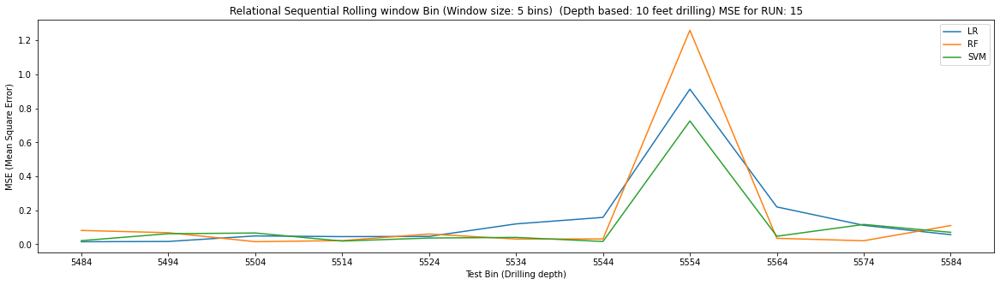

time: 35.7 s


In [ ]:
K_mses_relational_bins_rolling_window = non_linear_relationship(settings="Relational_Bins_rolling_window", df_data= df_org, run=15, features=features, target=target, models = models, K=10, window_size=5, debug = 0)


11262
17
[5424, 5434, 5444, 5454, 5464, 5474, 5484, 5494, 5504, 5514, 5524, 5534, 5544, 5554, 5564, 5574, 5584]
[0.11990164141336833, 0.15820700112823063, 0.9128650758773185, 0.2197721524844497, 0.11142748374061662, 0.05655303199006841]
[0.021113887400065756, 0.027505749420410164, 1.2671528329960016, 0.030982373634018966, 0.019959292713892345, 0.10191398537370035]
[0.04037755852560129, 0.016332016033919334, 0.7256892625350163, 0.04722587522345331, 0.11670116356601584, 0.07043596023089717]


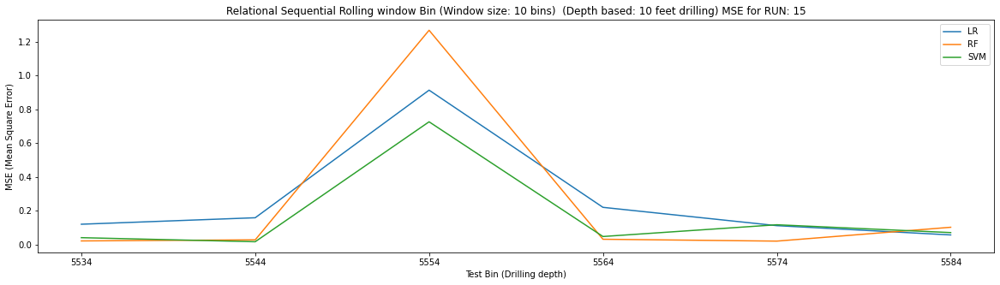

time: 26.6 s


In [ ]:
K_mses_relational_bins_rolling_window = non_linear_relationship(settings="Relational_Bins_rolling_window", df_data= df_org, run=15, features=features, target=target, models = models, K=10, window_size=10, debug = 0)


##### Viusualization

21817
28
[5804, 5814, 5824, 5834, 5844, 5854, 5864, 5874, 5884, 5894, 5904, 5914, 5924, 5934, 5944, 5954, 5964, 5974, 5984, 5994, 6004, 6014, 6024, 6034, 6044, 6054, 6064, 6074]
====> Fold: 0
Algo: [0.01503494150780085, 0.024412890499996634, 0.015924946667420937] 


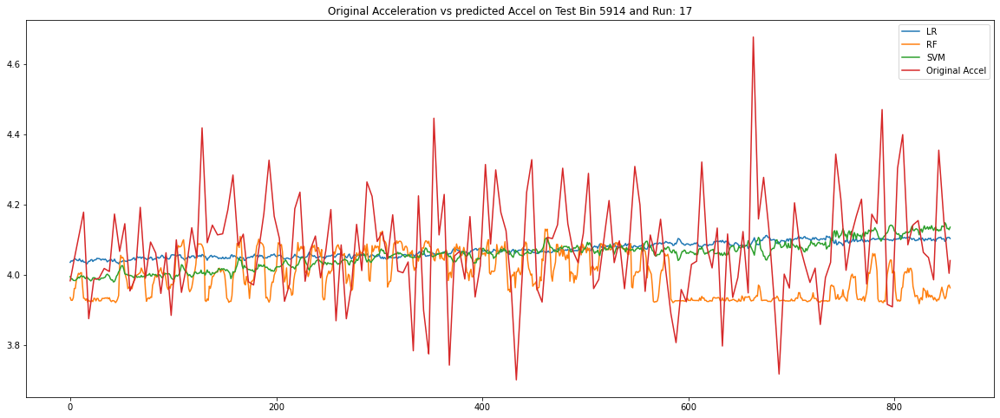

+++ len: 855
['ROP', 'Torque', 'Weight_on_Bit', 'Run_Depth', 'Accel', 'Bins'] <class 'list'>


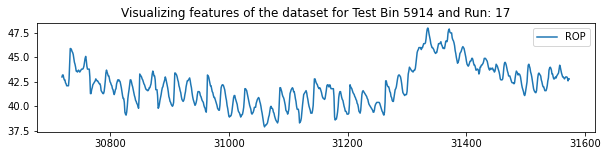

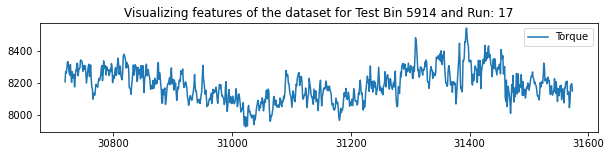

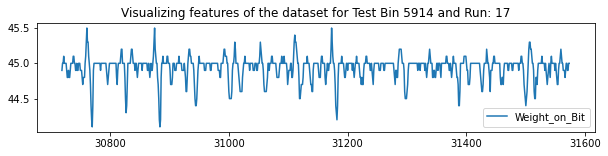

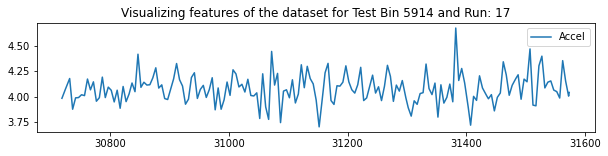

====> Fold: 1
Algo: [0.022127730827266708, 0.051196129090454255, 0.07362384392315373] 


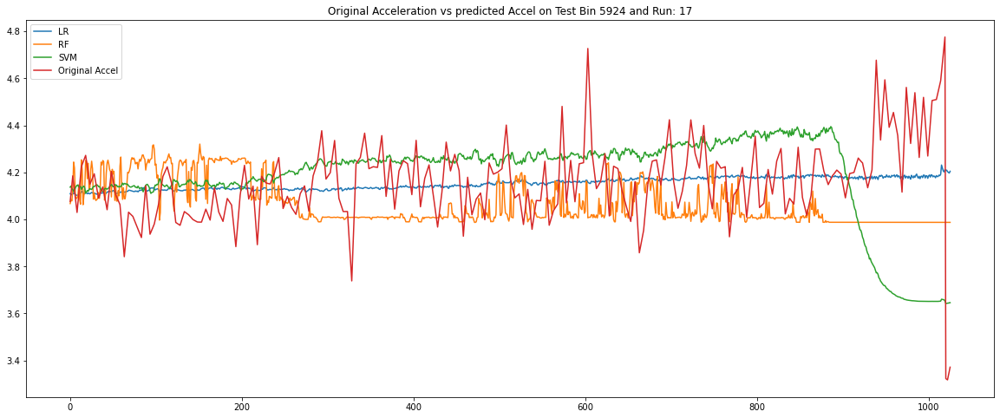

+++ len: 1026
['ROP', 'Torque', 'Weight_on_Bit', 'Run_Depth', 'Accel', 'Bins'] <class 'list'>


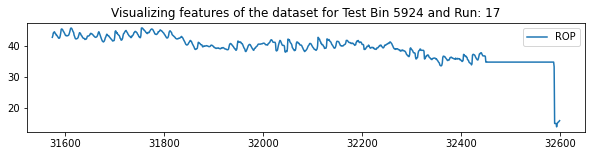

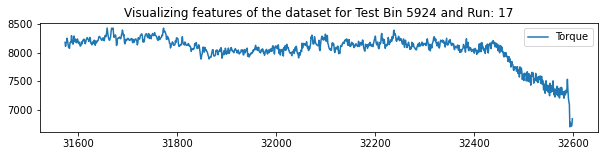

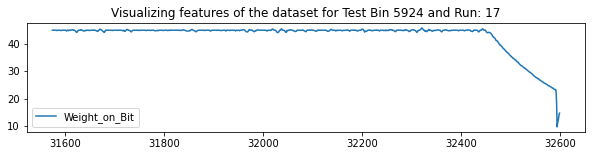

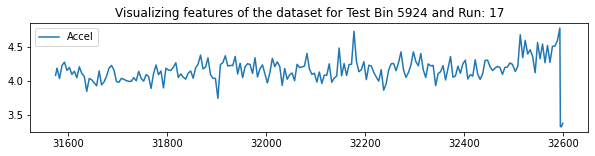

====> Fold: 2
Algo: [0.10723417124797338, 0.060359497614214636, 0.07461407674429747] 


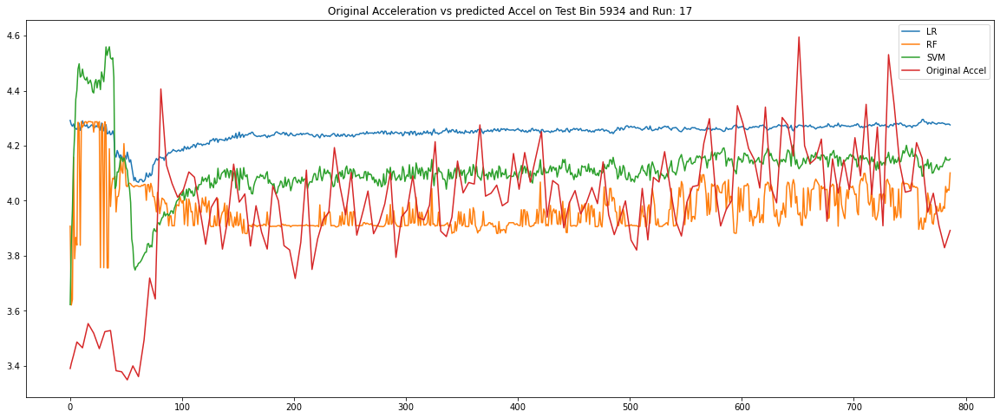

+++ len: 787
['ROP', 'Torque', 'Weight_on_Bit', 'Run_Depth', 'Accel', 'Bins'] <class 'list'>


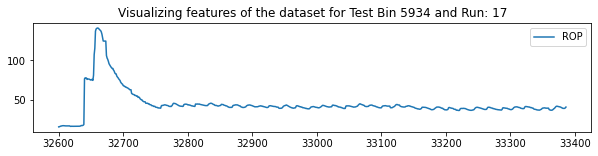

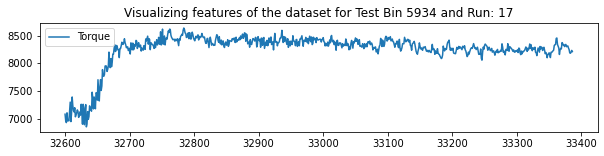

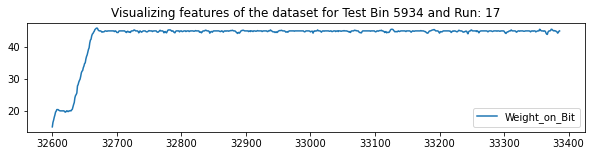

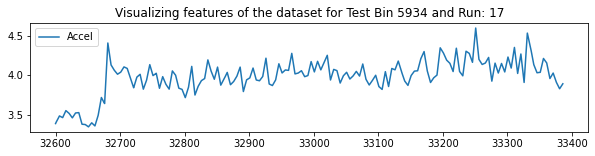

====> Fold: 3
Algo: [0.026987281614240476, 0.03895867711863973, 0.016087276165115735] 


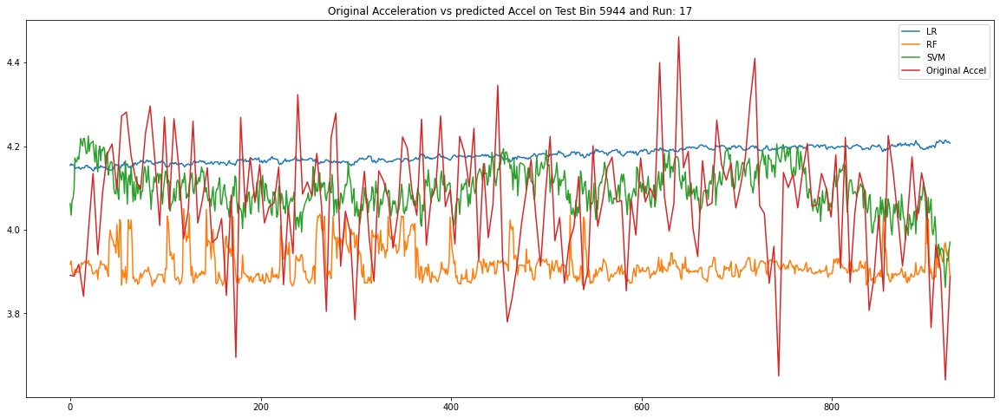

+++ len: 925
['ROP', 'Torque', 'Weight_on_Bit', 'Run_Depth', 'Accel', 'Bins'] <class 'list'>


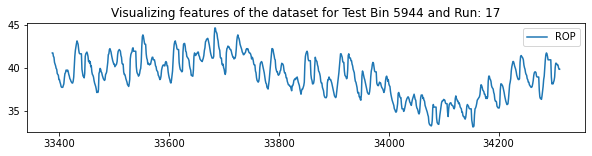

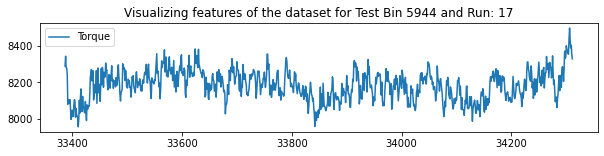

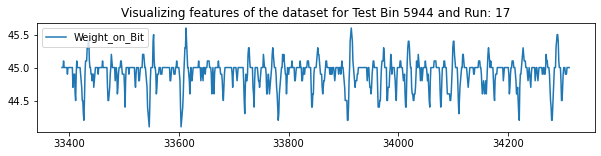

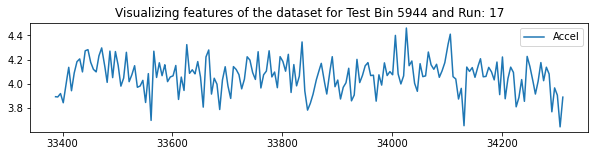

====> Fold: 4
Algo: [0.033779770033214036, 0.021911718408774566, 0.01757356318715889] 


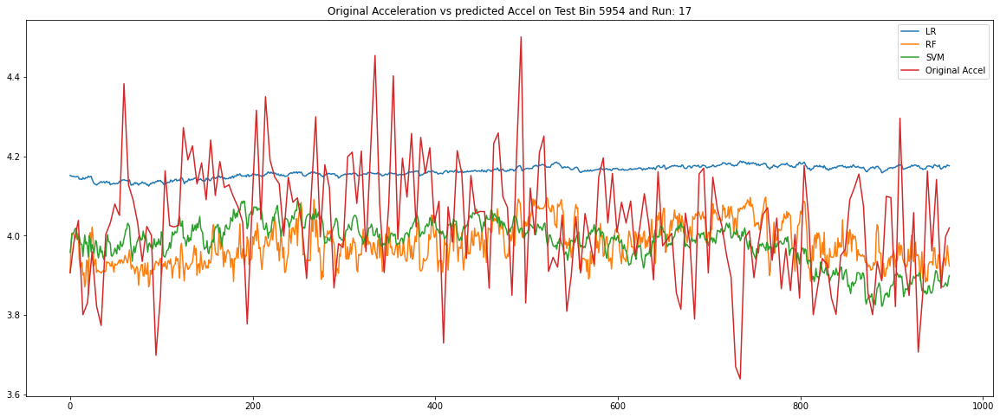

+++ len: 964
['ROP', 'Torque', 'Weight_on_Bit', 'Run_Depth', 'Accel', 'Bins'] <class 'list'>


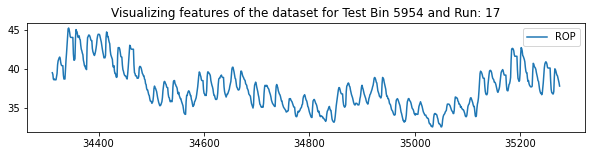

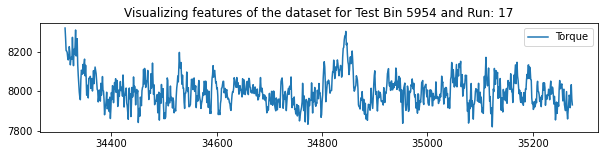

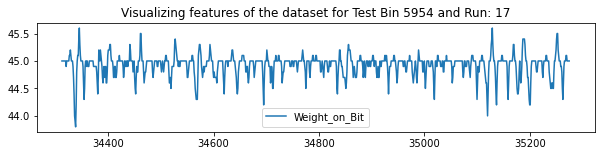

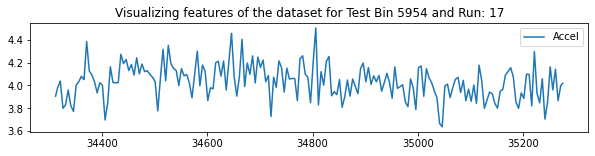

====> Fold: 5
Algo: [0.015354395523675993, 0.024188564362863707, 0.07562376463076048] 


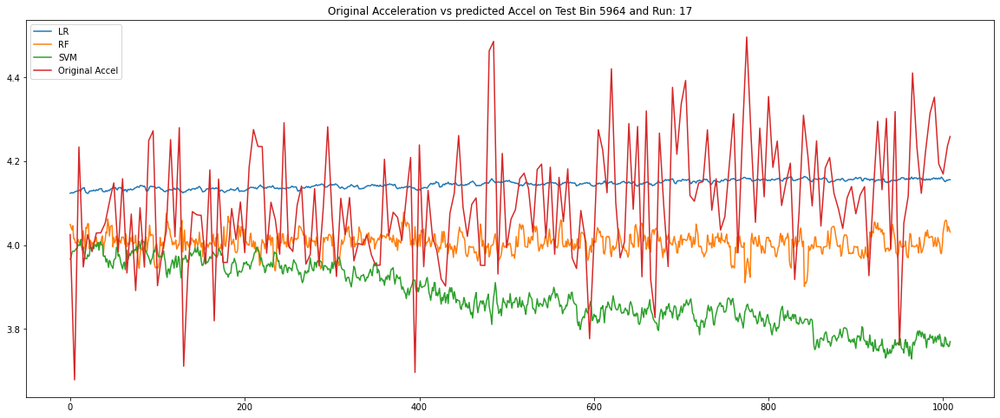

+++ len: 1009
['ROP', 'Torque', 'Weight_on_Bit', 'Run_Depth', 'Accel', 'Bins'] <class 'list'>


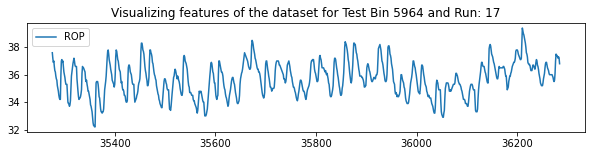

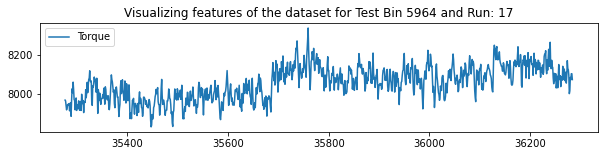

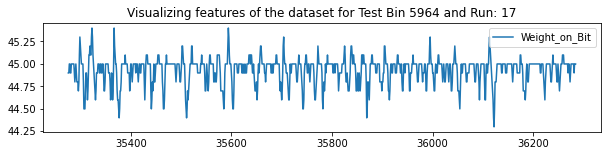

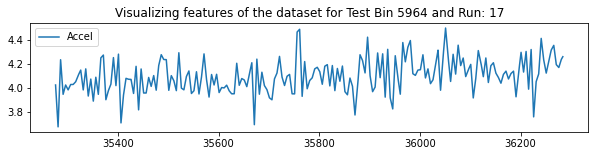

====> Fold: 6
Algo: [0.028518139638697013, 0.0411750708982908, 0.04042963898304061] 


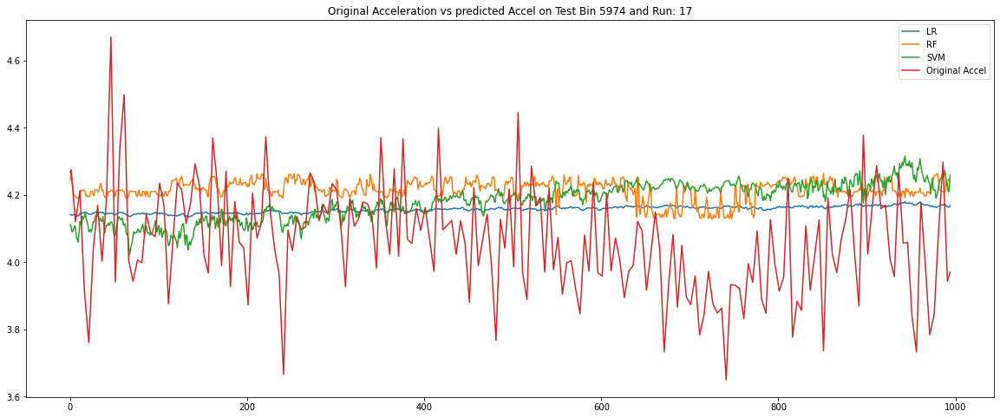

+++ len: 995
['ROP', 'Torque', 'Weight_on_Bit', 'Run_Depth', 'Accel', 'Bins'] <class 'list'>


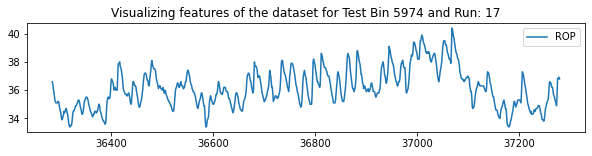

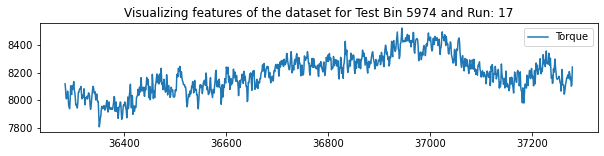

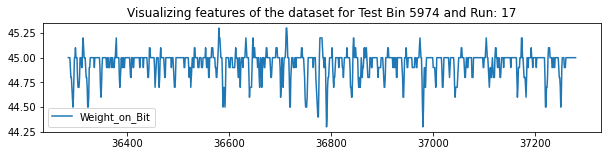

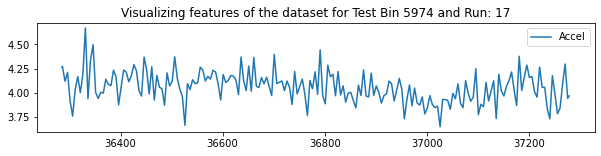

====> Fold: 7
Algo: [0.03416209191686953, 0.03743108346262101, 0.04732801220739879] 


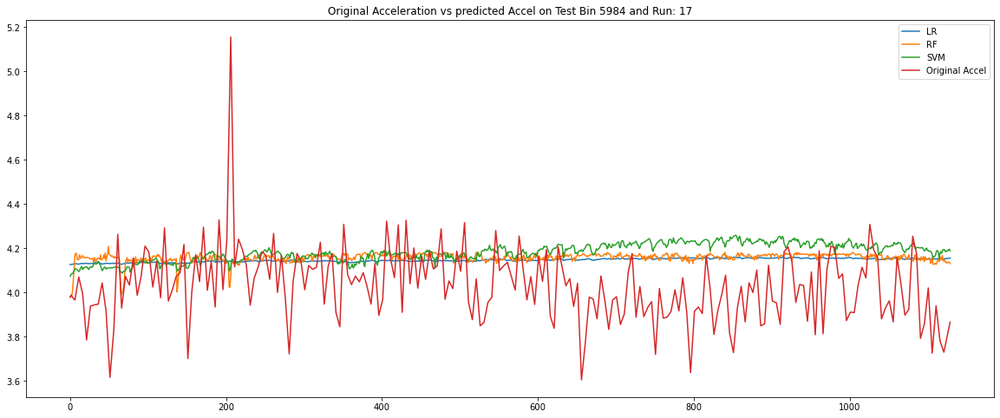

+++ len: 1130
['ROP', 'Torque', 'Weight_on_Bit', 'Run_Depth', 'Accel', 'Bins'] <class 'list'>


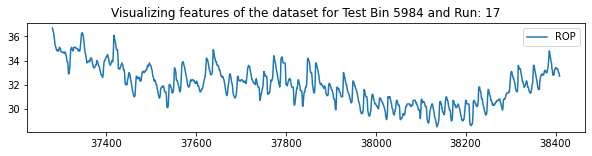

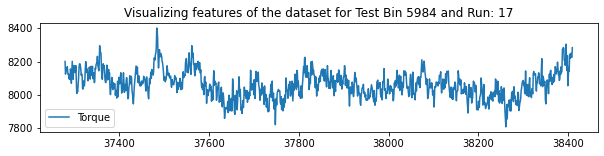

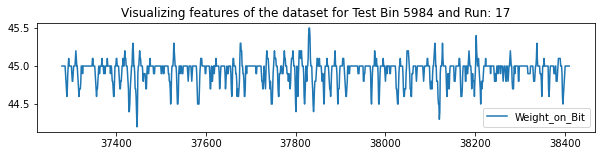

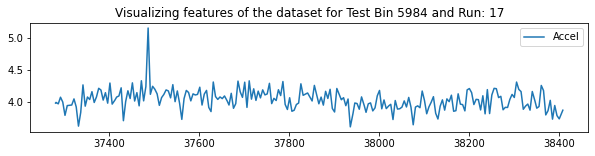

====> Fold: 8
Algo: [0.07910161243095405, 0.01988698988058846, 0.03121919132049779] 


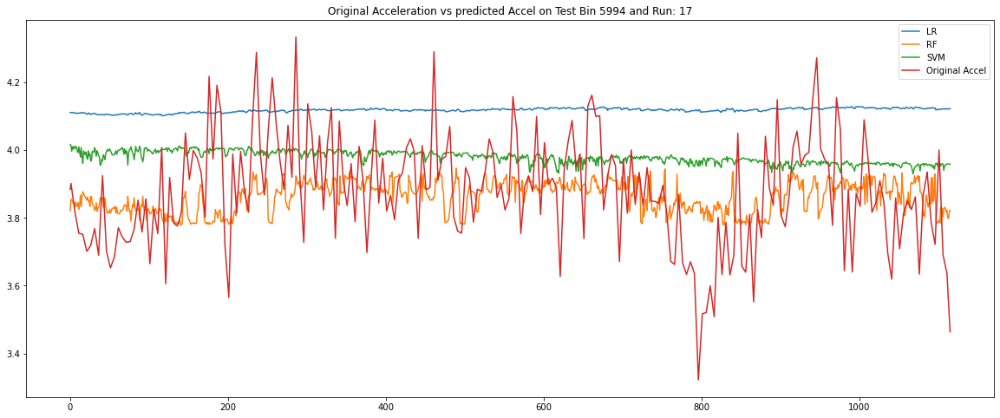

+++ len: 1116
['ROP', 'Torque', 'Weight_on_Bit', 'Run_Depth', 'Accel', 'Bins'] <class 'list'>


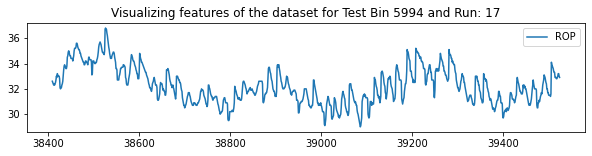

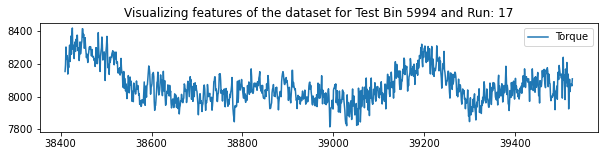

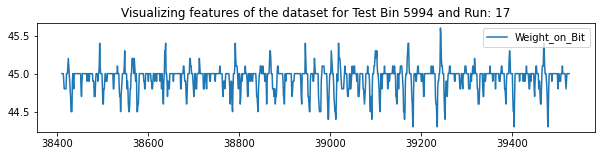

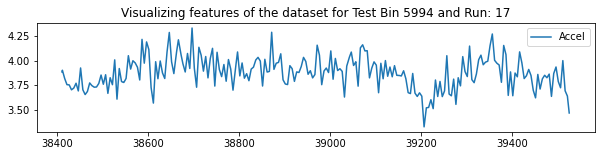

====> Fold: 9
Algo: [0.16422029446116365, 0.05071304548546729, 0.021307378297939564] 


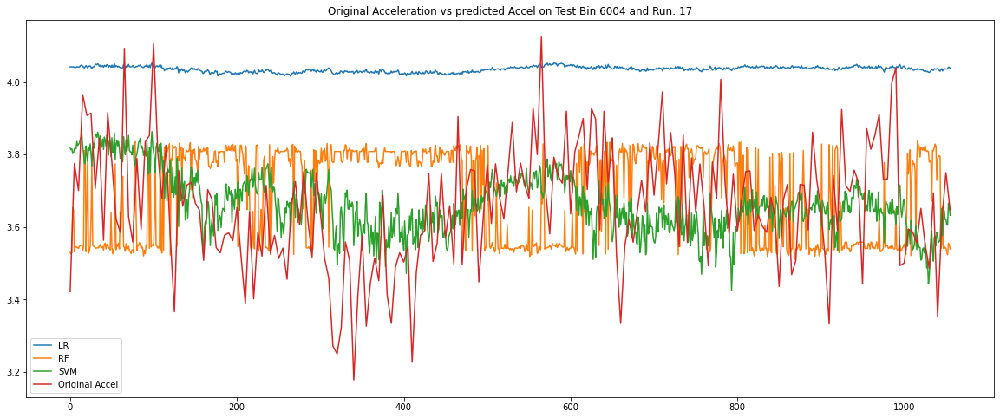

+++ len: 1056
['ROP', 'Torque', 'Weight_on_Bit', 'Run_Depth', 'Accel', 'Bins'] <class 'list'>


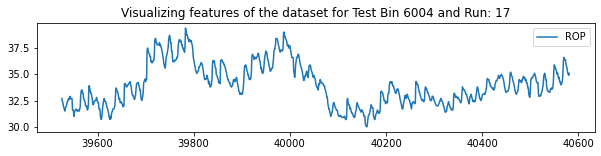

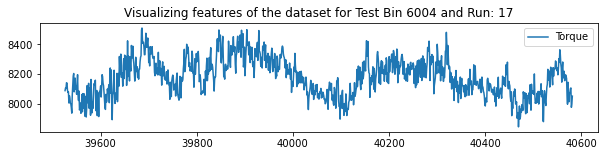

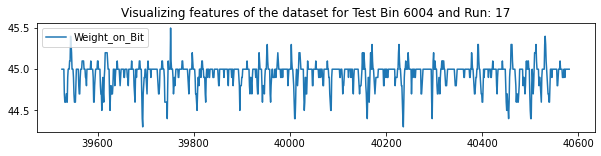

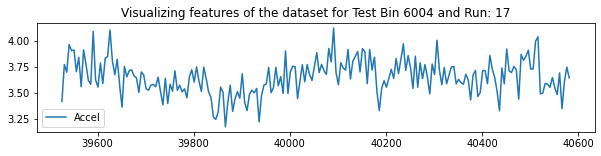

====> Fold: 10
Algo: [0.026286895313853316, 0.07295215538387124, 0.08090849833618047] 


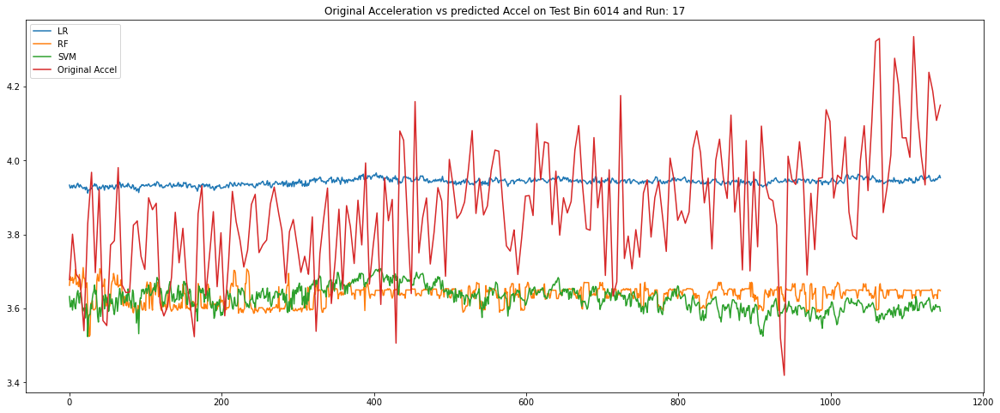

+++ len: 1145
['ROP', 'Torque', 'Weight_on_Bit', 'Run_Depth', 'Accel', 'Bins'] <class 'list'>


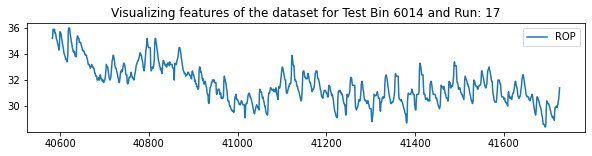

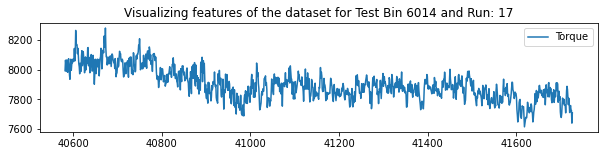

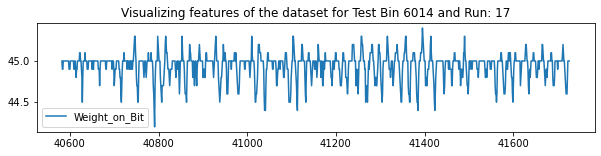

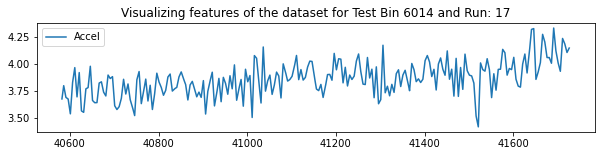

====> Fold: 11
Algo: [0.041471225486944804, 0.07411456906593558, 0.10397788418773136] 


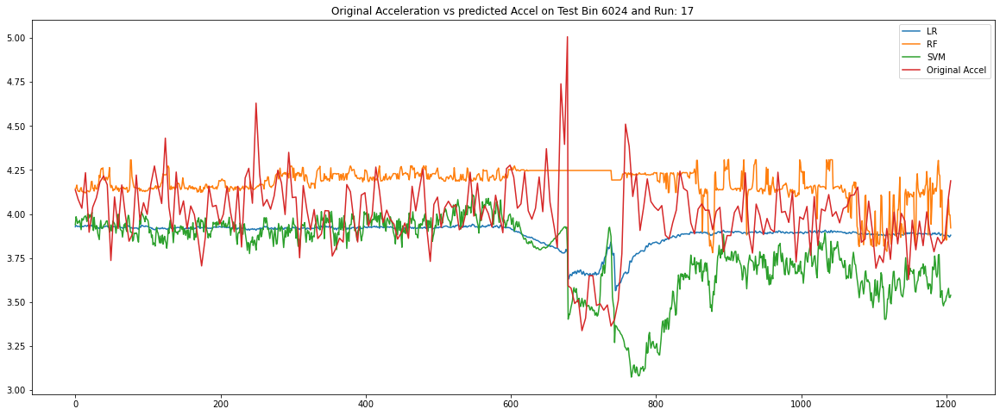

+++ len: 1207
['ROP', 'Torque', 'Weight_on_Bit', 'Run_Depth', 'Accel', 'Bins'] <class 'list'>


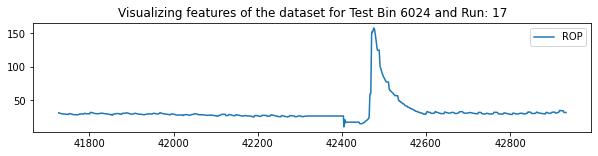

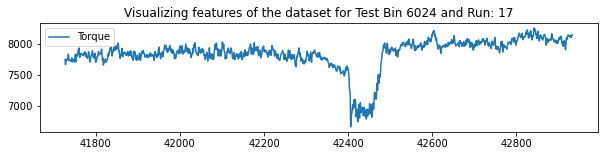

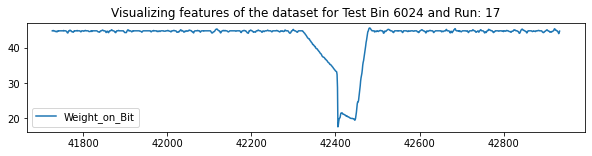

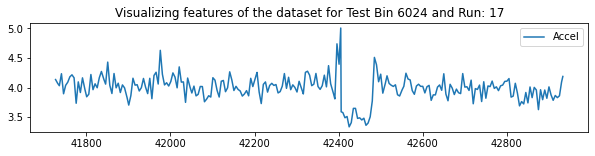

====> Fold: 12
Algo: [0.030718031262331774, 0.020555348956376986, 0.02549401025146419] 


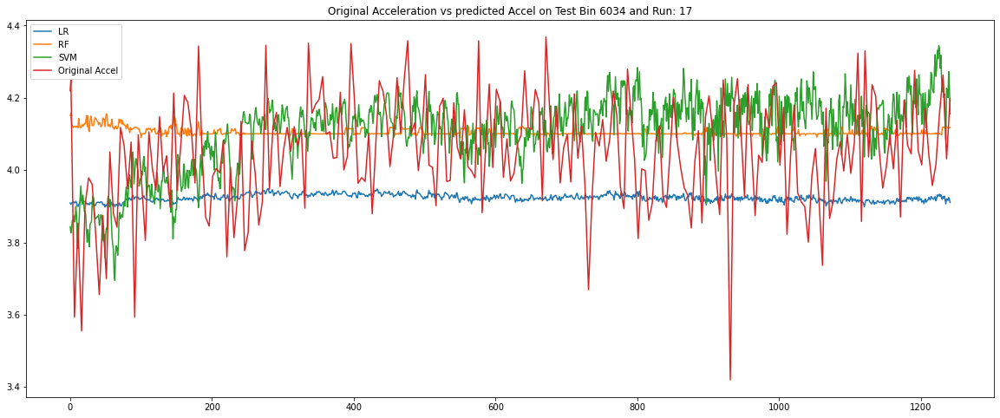

+++ len: 1242
['ROP', 'Torque', 'Weight_on_Bit', 'Run_Depth', 'Accel', 'Bins'] <class 'list'>


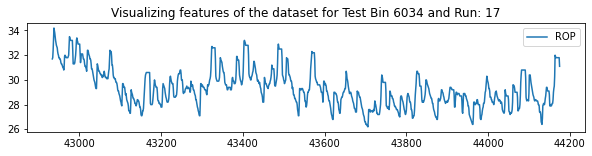

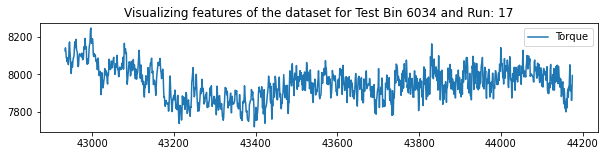

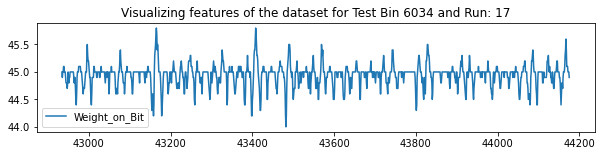

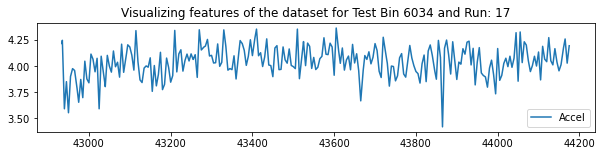

====> Fold: 13
Algo: [0.041186171489903715, 0.05854860816985621, 0.08900318542873799] 


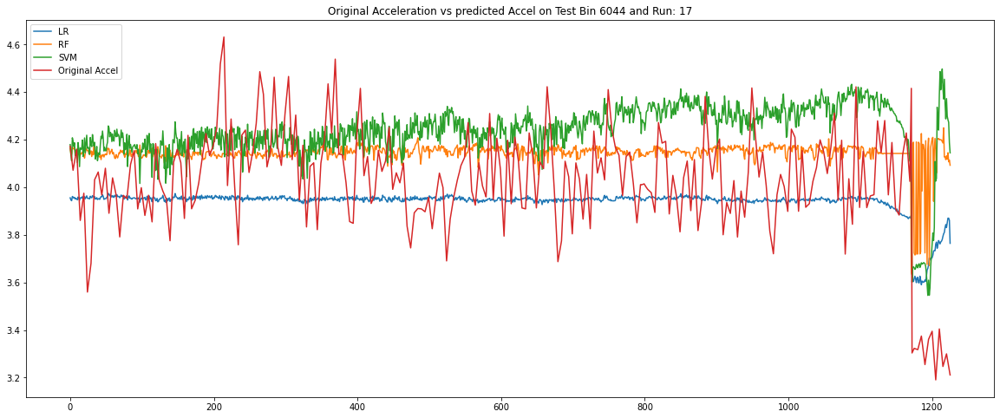

+++ len: 1226
['ROP', 'Torque', 'Weight_on_Bit', 'Run_Depth', 'Accel', 'Bins'] <class 'list'>


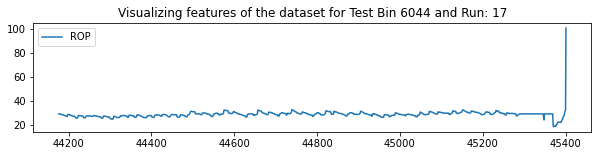

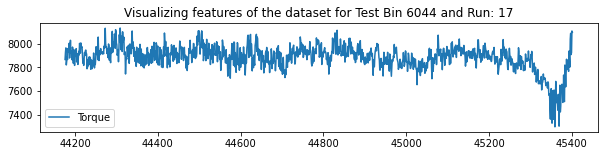

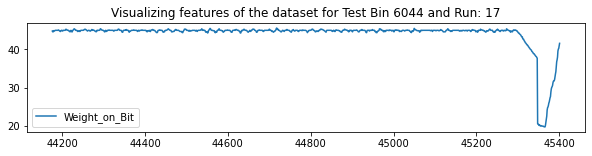

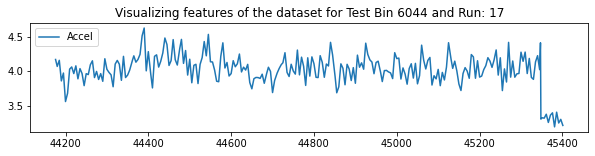

====> Fold: 14
Algo: [0.1613027070890587, 0.2195758055380454, 0.18991318816103037] 


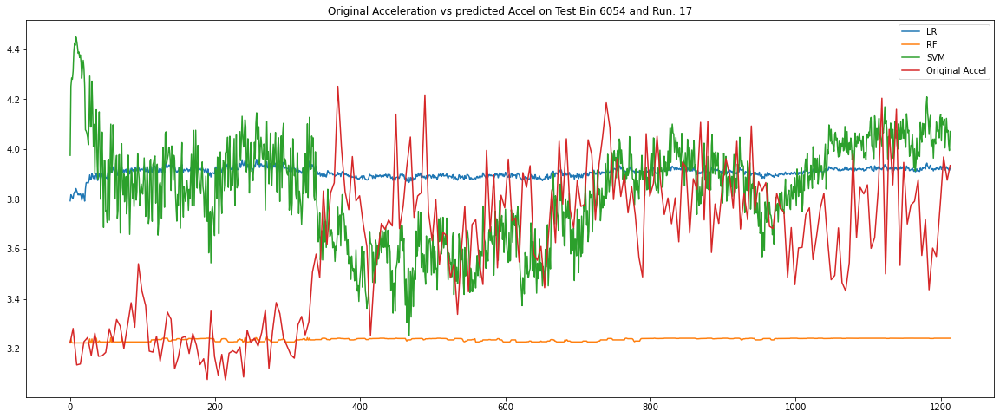

+++ len: 1214
['ROP', 'Torque', 'Weight_on_Bit', 'Run_Depth', 'Accel', 'Bins'] <class 'list'>


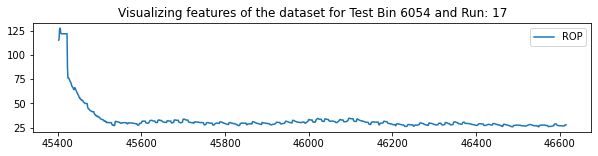

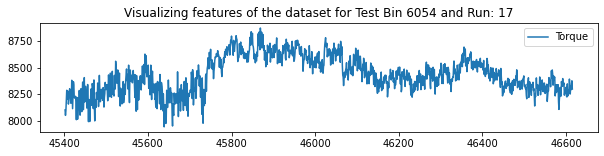

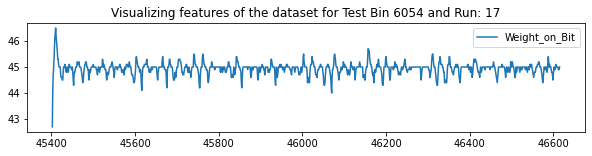

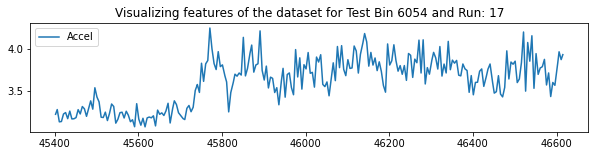

====> Fold: 15
Algo: [0.04732127612009062, 0.04416242188571262, 0.15590507864696512] 


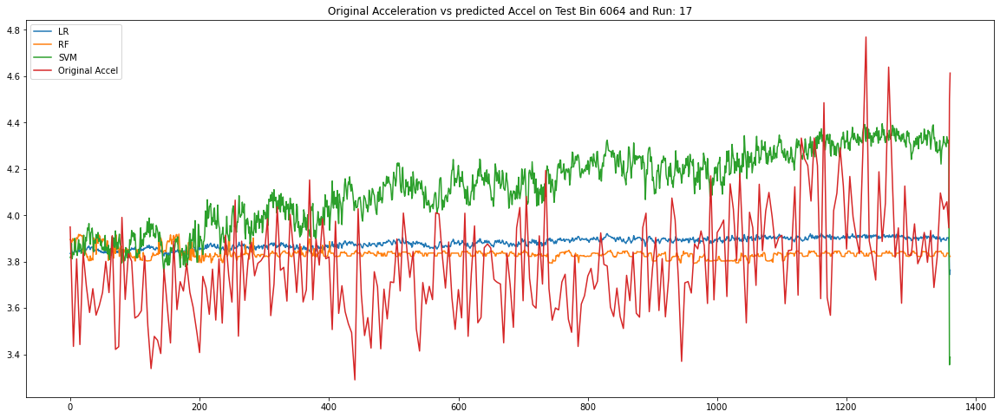

+++ len: 1361
['ROP', 'Torque', 'Weight_on_Bit', 'Run_Depth', 'Accel', 'Bins'] <class 'list'>


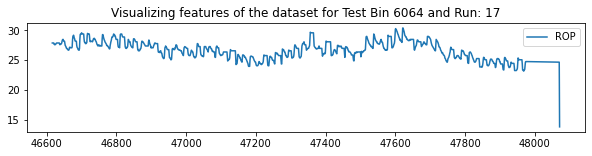

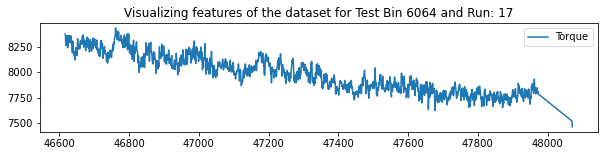

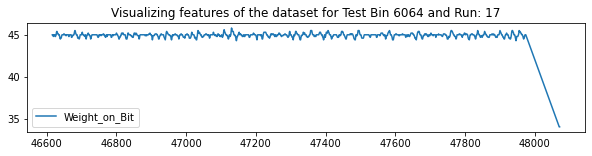

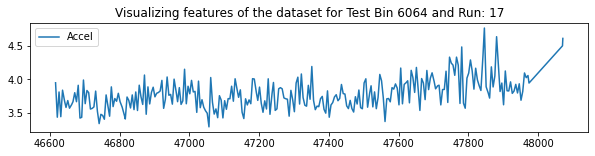

====> Fold: 16
Algo: [0.1486367443080404, 0.01670865989507891, 0.09934313983938026] 


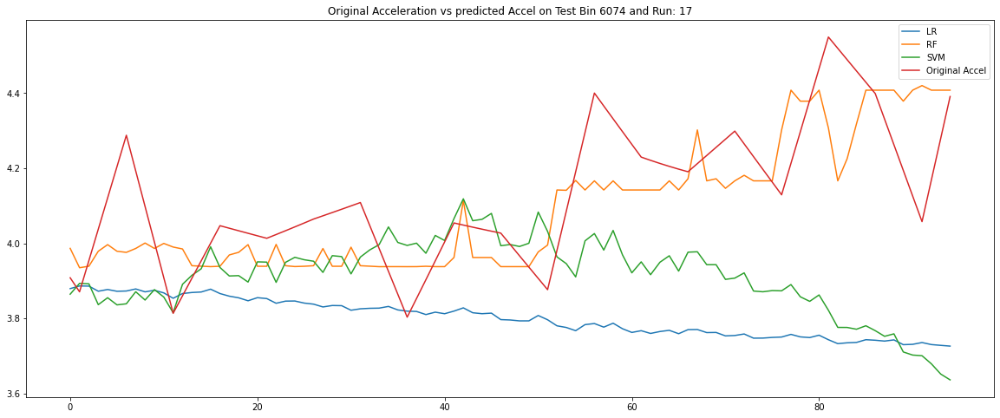

+++ len: 95
['ROP', 'Torque', 'Weight_on_Bit', 'Run_Depth', 'Accel', 'Bins'] <class 'list'>


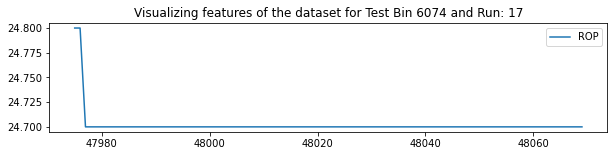

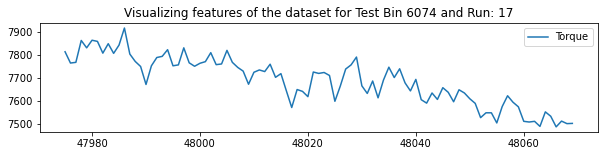

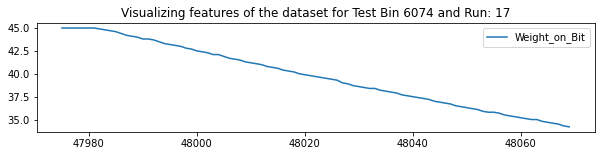

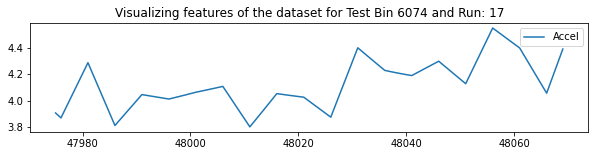

{'LR': [0.01503494150780085, 0.022127730827266708, 0.10723417124797338, 0.026987281614240476, 0.033779770033214036, 0.015354395523675993, 0.028518139638697013, 0.03416209191686953, 0.07910161243095405, 0.16422029446116365, 0.026286895313853316, 0.041471225486944804, 0.030718031262331774, 0.041186171489903715, 0.1613027070890587, 0.04732127612009062, 0.1486367443080404], 'RF': [0.024412890499996634, 0.051196129090454255, 0.060359497614214636, 0.03895867711863973, 0.021911718408774566, 0.024188564362863707, 0.0411750708982908, 0.03743108346262101, 0.01988698988058846, 0.05071304548546729, 0.07295215538387124, 0.07411456906593558, 0.020555348956376986, 0.05854860816985621, 0.2195758055380454, 0.04416242188571262, 0.01670865989507891], 'SVM': [0.015924946667420937, 0.07362384392315373, 0.07461407674429747, 0.016087276165115735, 0.01757356318715889, 0.07562376463076048, 0.04042963898304061, 0.04732801220739879, 0.03121919132049779, 0.021307378297939564, 0.08090849833618047, 0.10397788418773

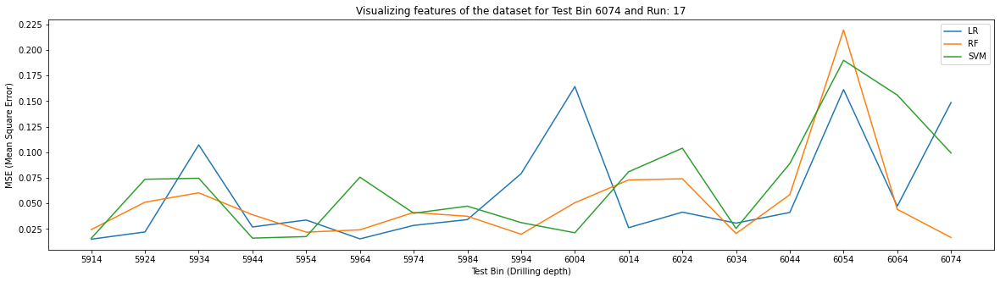

time: 2min 52s


In [ ]:
K_mses_relational_bins_rolling_window = non_linear_relationship(settings="Relational_Bins_rolling_window", df_data= df_org, run=17, features=features, target=target, models = models, K=10, window_size=10, debug = 5)


21817
28
[5804, 5814, 5824, 5834, 5844, 5854, 5864, 5874, 5884, 5894, 5904, 5914, 5924, 5934, 5944, 5954, 5964, 5974, 5984, 5994, 6004, 6014, 6024, 6034, 6044, 6054, 6064, 6074]
[0.09337245620281547, 0.10601559773283709, 0.013482126297079898, 0.06283669958964877, 0.016356945957973212, 0.01503494150780085, 0.022127730827266708, 0.10723417124797338, 0.026987281614240476, 0.033779770033214036, 0.015354395523675993, 0.028518139638697013, 0.03416209191686953, 0.07910161243095405, 0.16422029446116365, 0.026286895313853316, 0.041471225486944804, 0.030718031262331774, 0.041186171489903715, 0.1613027070890587, 0.04732127612009062, 0.1486367443080404]
[0.01829507699844798, 0.04333152789254825, 0.01894397125420617, 0.07488758494601709, 0.009814070568871631, 0.02385589201734568, 0.04824552109307446, 0.051262369556513185, 0.036312449205089664, 0.02120473193155737, 0.025043507764418035, 0.04204342664424919, 0.038278112130114325, 0.019125478335107512, 0.04848786134415561, 0.06387558969522253, 0.07635

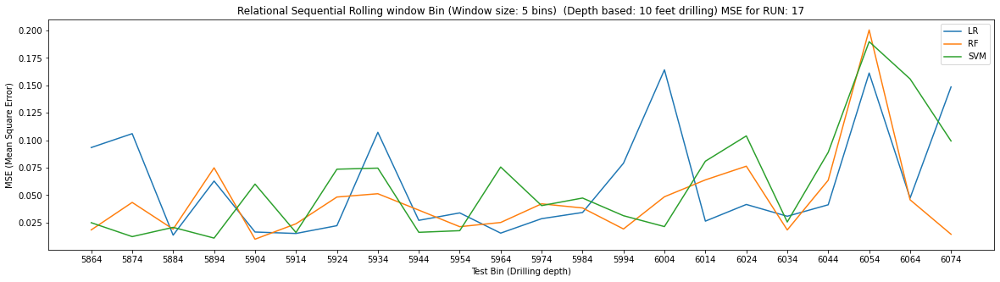

time: 2min 43s


In [ ]:
# K_mses_relational_bins_rolling_window = non_linear_relationship(settings="Relational_Bins_rolling_window", df_data= df_org, run=17, features=features, target=target, models = models, K=10, window_size=5, debug = 0)


21817
28
[5804, 5814, 5824, 5834, 5844, 5854, 5864, 5874, 5884, 5894, 5904, 5914, 5924, 5934, 5944, 5954, 5964, 5974, 5984, 5994, 6004, 6014, 6024, 6034, 6044, 6054, 6064, 6074]
[0.01503494150780085, 0.022127730827266708, 0.10723417124797338, 0.026987281614240476, 0.033779770033214036, 0.015354395523675993, 0.028518139638697013, 0.03416209191686953, 0.07910161243095405, 0.16422029446116365, 0.026286895313853316, 0.041471225486944804, 0.030718031262331774, 0.041186171489903715, 0.1613027070890587, 0.04732127612009062, 0.1486367443080404]
[0.02429419145325044, 0.04794014243795794, 0.05930023309017499, 0.04163730785539557, 0.02471111305340509, 0.025872074333843018, 0.040589653586011985, 0.03955707801123604, 0.019878849132507783, 0.04802953891416189, 0.06724882079164703, 0.07646706937808043, 0.01772208841560651, 0.05936683718172565, 0.21659138449182902, 0.04462144571227734, 0.015249195810554618]
[0.015924946667420937, 0.07362384392315373, 0.07461407674429747, 0.016087276165115735, 0.017573

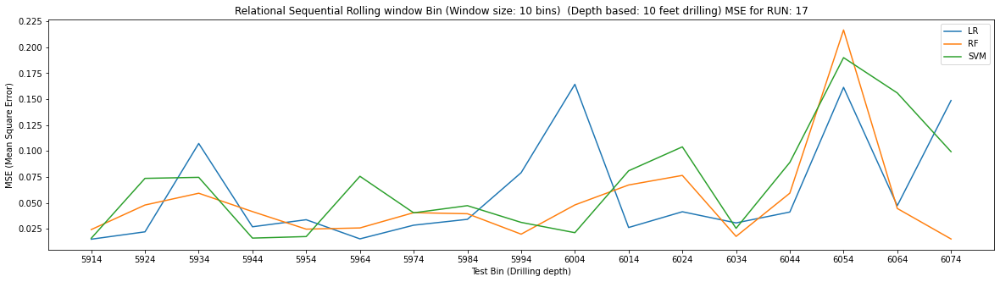

time: 2min 46s


In [ ]:
K_mses_relational_bins_rolling_window = non_linear_relationship(settings="Relational_Bins_rolling_window", df_data= df_org, run=17, features=features, target=target, models = models, K=10, window_size=10, debug = 0)


#### AutoSKlearn

In [ ]:
!pip3 install auto-sklearn

In [ ]:
import autosklearn.regression

automl = autosklearn.classification.AutoSklearnClassifier()
automl.fit(X_train, y_train)
y_hat = automl.predict(X_test)

# Shared Code for Ajoy Data filtering

### Performance with filtered data

#### Helper Methods

In [ ]:
## Uncomment and execute the codes in Google Colab environment
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error

def calculate_MSE(train_test_pair, models):
    (X_train, y_train, X_test, y_test) = train_test_pair
    print("Train size: %d Test size: %d" % (len(y_train), len(y_test)))
    X_train, X_test = get_normalized_data(X_train, X_test, features)

    org_test_preds = {}
    mses = []
    for algo in models:
        if (algo == "LR"):
            y_pred, model_LR = get_prediction_LR(X_train, y_train, X_test)
        if (algo == "RF"):
            y_pred, model_RF = get_prediction_RF(X_train, y_train, X_test)            
        if (algo == "SVM"):
            y_pred, model_SVM = get_prediction_SVM(X_train, y_train, X_test)            
        if (algo == "AutoSKlearn"):
            y_pred, model_SVM = get_prediction_autoSKlearn(X_train, y_train, X_test, max_time=120)
        
        y_pred_list = y_pred.tolist()
        y_true = y_test.tolist()
        mse = mean_squared_error(y_true, y_pred_list)

        mses.append(mse)
        org_test_preds[algo] = y_pred_list

        print("Algo: %s len_y_pred: %d len_y_true: %d" % (algo, len(y_pred), len(y_true)))
    org_test_preds["Original Accel"] = y_test.tolist()
    
    return mses, org_test_preds


def K_fold_train_test_dataset(df_data, run, features, target, K, random, debug):
    df_run = df_data[df_data['Run'] == run]
    print(len(df_run))
    cur_columns = features + [target]
    df_run = df_run[cur_columns]
    # print(df_run.head())
    kf = KFold(n_splits=K, shuffle=random)

    if (debug >= 1):
        print(df_run[target].describe())

    train_test_pairs = []
    for train_index, test_index in kf.split(df_run):
        df_train = df_run.iloc[train_index] 
        df_test =  df_run.iloc[test_index]
        
        X_train = df_train[features]
        y_train = df_train[target]
        X_test = df_test[features]
        y_test = df_test[target]
        train_test_pair = (X_train, y_train, X_test, y_test)

        train_test_pairs.append(train_test_pair)
    return train_test_pairs







def Bins_K_fold_train_test_dataset(df_data, run, features, target, K, bin_size):
    df_bin = classify_to_bins(df_data, bin_type="depth", bin_size=10)
    df_run = df_bin[df_bin['Run'] == run]
    print(len(df_run))
    cur_columns = features + [target, "Bins"]
    df_run = df_run[cur_columns]

    bins = df_run['Bins'].unique().tolist()
    print(len(bins))
    print(bins)
    
    train_test_pairs = []
    test_bins = []


    for test_bin in bins:
        train_bin = bins.copy()
        train_bin.remove(test_bin)
        test_bins.append(test_bin)
        # print(train_bin, test_bin)
        # test_bin = [bins[i] for i in test_bin_idx]
        # print(train_bin, test_bin)
        df_train = df_run[df_run["Bins"].isin(train_bin)]
        df_test =  df_run[df_run["Bins"] == test_bin]
        
        X_train = df_train[features]
        y_train = df_train[target]
        X_test = df_test[features]
        y_test = df_test[target]
        train_test_pair = (X_train, y_train, X_test, y_test)

        train_test_pairs.append(train_test_pair)

    return train_test_pairs, test_bins







def relational_Bins_rolling_window_train_test(df_data, run, features, target, K, bin_size, window_size):
    df_bin = classify_to_bins(df_org, bin_type="depth", bin_size=10)
    df_run_bin = df_bin[df_bin['Run'] == run]
    print(len(df_run_bin))
    cur_columns = features + [target, "Bins"]
    df_run_bin = df_run_bin[cur_columns]

    bins = df_run_bin['Bins'].unique().tolist()
    print(len(bins))
    print(bins)
    
    train_test_pairs = []
    test_bins = []

    for test_ind in range(window_size+1, len(bins)):
        # for i in range(test_ind):
        train_bin = [bins[i] for i in range(test_ind)]
        test_bin = bins[test_ind]
        test_bins.append(test_bin)
        # print(train_bin, test_bin)
        # test_bin = [bins[i] for i in test_bin_idx]
        # print(train_bin, test_bin)
        df_train = df_run_bin[df_run_bin["Bins"].isin(train_bin)]
        df_test =  df_run_bin[df_run_bin["Bins"] == test_bin]
        
        X_train = df_train[features]
        y_train = df_train[target]
        X_test = df_test[features]
        y_test = df_test[target]
        train_test_pair = (X_train, y_train, X_test, y_test)

        train_test_pairs.append(train_test_pair)

    return df_run_bin, train_test_pairs, test_bins


def plot_prediction(map_preds, plot_title):
    # plot_title = "Original Acceleration vs predicted Accel on Test Bin %d" % (test_bin)
    ax = plt.figure(figsize=(20, 8)) # width, height

    for algo in map_preds:
        plt.plot(map_preds[algo],  label=algo) 

    plt.legend(loc='best')
    plt.title(plot_title)
    plt.show()

def visualize_test_data_bin(df_data, plot_title):
    # plot_title = "Visualizing Original dataset for Bin: %d" % (test_bin)
    # ax = plt.figure(figsize=(20, 5)) # width, height
    # df_data = df[df["Bins"] == test_bin]
    columns = df_data.columns.tolist()
   
    print(columns, type(columns))
    columns.remove("Bins")
    columns.remove("Run_Depth")
    for col in columns:
        fig = plt.figure(figsize=(10, 2)) # width, height
        plt.plot(df_data[col], label=col)
        plt.legend(loc='best')
        plt.title(plot_title)
    plt.show()

    # fig, axes = plt.subplots() # width, height
    # for col in columns:
    #     axes.plot(df_data[col], label=col)
    # plt.legend(loc='best')
    # plt.title(plot_title)
    # plt.show()
    



def non_linear_relationship(settings, df_data, run, features, target, models, K=10, bin_size = 10, window_size=10, plot=True, debug=0, output_file=None):

    K_mses = {}
    for algo in models:
        K_mses[algo] = []
    
    if(settings == "Random_K_fold"):
        train_test_pairs = K_fold_train_test_dataset(df_data, run, features, target, K, random = True, debug=debug)
        plot_title = "Random (Time based) %d-fold MSE for RUN: %d" % (K, run)
        x_ticks_labels = [str(i) for i in range(K)]
        xlabel="Test Fold (Time-based)"

    if(settings == "Seqential_K_fold"):
        train_test_pairs = K_fold_train_test_dataset(df_data, run, features, target, K, random = False, debug=debug)
        plot_title = "Sequential (Time based) %d-fold MSE for RUN: %d" % (K, run)
        x_ticks_labels = [str(i) for i in range(K)]
        xlabel="Test Fold (Time-based)"
    
    if(settings == "Non_relational_Bins_K_fold"):
        train_test_pairs, bins = Bins_K_fold_train_test_dataset(df_data, run, features, target, K, bin_size)
        plot_title = "Non relational Sequential Bin (Depth based: %d feet drilling) MSE for RUN: %d" % (bin_size, run)
        x_ticks_labels = [str(bin) for bin in bins]
        xlabel="Test Bin (Drilling depth)"
        
    if(settings == "Relational_Bins_rolling_window"):
        df_run_bin, train_test_pairs, bins = relational_Bins_rolling_window_train_test(df_data, run, features, target, K, bin_size, window_size)
        plot_title = "Relational Sequential Rolling window Bin (Window size: %d bins)  (Depth based: %d feet drilling) MSE for RUN: %d" % (window_size, bin_size, run)
        x_ticks_labels = [str(bin) for bin in bins]
        xlabel="Test Bin (Drilling depth)"
        # return

    k = 0
    output_df = pd.DataFrame()
    for train_test_pair in train_test_pairs:
        (X_train, y_train, X_test, y_test) = train_test_pair
        test_bin = x_ticks_labels[k]
        # print("Bin: %s Traind: %d Test: %d" % (x_ticks_labels[k], len(y_train), len(y_test)))
        # k += 1
        # continue
        # print("should not print")
        if (debug >= 1):
            print("\n\n====> Fold: %d Test bin: %s and #test_datapoint: %d" % (k, test_bin, len(y_test)))
        mses, org_preds = calculate_MSE(train_test_pair, models)
        # print("Test bin: %s and len_pred: %")
        if output_file is not None:            
           
            print("%s bin %s" % (test_bin, org_preds))
            m = org_preds.copy()
            m["Run"] = run
            m["Test_bin"] = test_bin
            # print(pd.Series(m))
            output_df = output_df.append(m, ignore_index=True)
            # if k == 0:
            #     output_df.to_csv(output_file, index=False, quotechar='"', quoting=csv.QUOTE_NONNUMERIC)
            # else:
            #     output_df.to_csv(output_file, index=False, quotechar='"', quoting=csv.QUOTE_NONNUMERIC, mode="a", header=False)
            # break
        for i in range(len(models)):
            K_mses[models[i]].append(mses[i])    
        if (debug >= 2):
            print("Algo: %s " % (mses))
        

        if(debug >= 5):
            test_bin = x_ticks_labels[k]
            plot_title = "Original Acceleration vs predicted Accel on Test Bin %s and Run: %d" % ( test_bin, run)
            plot_prediction(map_preds=org_preds,  plot_title = plot_title)
            
            df_plot_data = df_run_bin[df_run_bin["Bins"] == int(test_bin)]
            print("+++ len: %d" % len(df_plot_data))
            plot_title = "Visualizing features of the dataset for Test Bin %s and Run: %d" % (test_bin, run)
            visualize_test_data_bin(df_plot_data, plot_title)
            # return


        k += 1

    output_df.to_csv(output_file, index=False, quotechar='"', quoting=csv.QUOTE_NONNUMERIC)
    ax = None
    if(plot == True):
        if(debug >= 2):
            print(K_mses)
        ax = plot_mse(K_mses, title=plot_title, x_ticks_labels=x_ticks_labels, xlabel=xlabel)

    return K_mses, ax, output_df


# K_mses_bins_K_fold, ax = non_linear_relationship(settings="Non_relational_Bins_K_fold", df_data= df_org, run=run, features=features, 
#                                              target=target, models = models, bin_size = 10, debug = 0, output_file=output_file)


In [ ]:
df_org.columns

In [ ]:
import glob, os, sys
import matplotlib.pylab as plt
import numpy as np
# import tensorflow as tf
# print(tf.__version__)
import pandas as pd
import csv
import pickle
import math

from sklearn.preprocessing import StandardScaler

def get_normalized_data(X_train, X_test, feature_columns):
    autoscaler = StandardScaler()
    autoscaler.fit(X_train)
    X_train[feature_columns] = autoscaler.transform(X_train[feature_columns])
    X_test[feature_columns] = autoscaler.transform(X_test[feature_columns])

    return X_train, X_test


from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_classification
from sklearn.metrics import mean_squared_error, r2_score

def get_train_test_set(df, feature_columns, train_stand, test_stand, pred_column="ROP"):
    df_data = df.copy(deep=True)
    # df_data.drop('Date_Time', axis = 1, inplace=True)
    df_data = df_data.fillna(0)

    df_train = df_data[df_data['Stand'].isin(train_stand)]
    df_test = df_data[df_data['Stand'].isin(test_stand)]
    print("Train size: %d and Test size: %d" % (len(df_train), len(df_test)))

    X_train = df_train[feature_columns]
    y_train = df_train[pred_column]
    X_test = df_test[feature_columns]
    y_test = df_test[pred_column]

    print(X_train.shape)
    print(X_test.shape)
    print(y_train.shape)
    print(y_test.shape)

    return X_train, X_test, y_train, y_test




def get_normalized_data(X_train, X_test, feature_columns):
    autoscaler = StandardScaler()
    autoscaler.fit(X_train)

    # X_train[feature_columns] = autoscaler.transform(X_train[feature_columns])
    # X_test[feature_columns] = autoscaler.transform(X_test[feature_columns])
    X_train = autoscaler.transform(X_train)
    X_test = autoscaler.transform(X_test)

    return X_train, X_test



def get_prediction_LR(X_train, y_train, X_test):
    # creating an object of LinearRegression class
    LR = LinearRegression(normalize=True)
    # fitting the training data
    LR.fit(X_train, y_train)
    # print("Print Linear regression score: %0.2f" % LR.score(X_train, y_train))
    y_pred = LR.predict(X_test)
    return y_pred, LR


def get_prediction_RF(X_train, y_train, X_test, num_trees=100):
    clf = RandomForestRegressor(num_trees)
    clf.fit(X_train, y_train)
    # RandomForestClassifier(...)
    y_pred = clf.predict(X_test)
    return y_pred, clf

def plot_prediction(y_true, y_pred, title):
    y_pred = y_pred.clip(min=0)
    ax = plt.figure(figsize=(20, 5)) # 10 is width, 7 is height
    plt.plot(y_pred,  label='Prediction') 
    # plt.plot([1,2,3,4,5], [2,3,4,5,11],
    plt.plot(y_true,  label='Original Value')  # green dots
    plt.legend(loc='best')
    plt.title(title)
    plt.show()

def plot_original_and_smooth_graph(y_true, y_pred_LR, y_pred_RF, title, figsize = (22, 8)):
    
    # df = pd.DataFrame()
    # df["RF prediction"] = y_pred_RF
    # df["LR prediction"] = y_pred_LR
    # df['Original'] = y_true
    # df.plot(figsize=figsize, title=title)
    # plt.show()

    df = pd.DataFrame()
    df["RF prediction"] = get_smooth_data(y_pred_RF, N=10)
    df["LR prediction"] = get_smooth_data(y_pred_LR, N=10)
    df['Original'] = y_true
    df.plot(figsize=figsize, title=title)
    plt.show()

def get_smooth_data(data, N):
    # print(data)
    ret = np.cumsum(data, dtype=float)
    # print(ret)
    ret[N:] = ret[N:] - ret[:-N]
    # print(ret)
    ret_avg =  ret[N - 1:] / N
    # print(ret_avg)
    ret = np.concatenate([data[:N-1], ret_avg])
    # print("org_len: %d and ret_len: %d" % (len(data), len(ret)))
    # print(data[:200])
    # print(ret[:200])
    assert len(data) == len(ret)
    return ret



def remove_small_stands(df, min_length=600):
    stands = df.groupby("Stand").size().tolist()
    stands_chosen = []
    for ind, size in enumerate(stands):
        stand_num = ind+1
        # print(stand_num, size)
        if(size > min_length):
            stands_chosen.append(stand_num)
    # print(stands_chosen)
    df_modified = df[df['Stand'].isin(stands_chosen)]
    # print(len(df), len(df_modified))
    # print(stands)
    return df_modified, stands_chosen

from sklearn.preprocessing import StandardScaler

def get_normalized_data(X_train, X_test, feature_columns):
    autoscaler = StandardScaler()
    autoscaler.fit(X_train)
    X_train[feature_columns] = autoscaler.transform(X_train[feature_columns])
    X_test[feature_columns] = autoscaler.transform(X_test[feature_columns])

    return X_train, X_test


from sklearn.svm import SVR

def get_prediction_SVM(X_train, y_train, X_test):
    regressor = SVR(kernel = 'rbf')
    regressor.fit(X_train, y_train)
    y_test = regressor.predict(X_test)
    return y_test, regressor


# import sklearn.metrics
# import autosklearn.regression

# def get_prediction_autoSKlearn(X_train, y_train, X_test, max_time = 600):

#     automl = autosklearn.regression.AutoSklearnRegressor(
#         time_left_for_this_task=max_time
#         )
#     automl.fit(X_train, y_train)

#     ensemble_dict = automl.show_models()
#     print(ensemble_dict)

#     y_test = automl.predict(X_test)
#     return y_test, automl


#ajoy
def plot_mse(K_mses, title, x_ticks_labels=None, xlabel=None):
    # y_pred = y_pred.clip(min=0)
    fig = plt.figure(figsize=(15, 4)) # 10 is width, 7 is height
    ax = fig.gca()

    if (x_ticks_labels):
        x_ticks = [i for i in range(len(x_ticks_labels))]
        ax.set_xticks(x_ticks)
        ax.set_xticklabels(x_ticks_labels)

    for algo in K_mses:
        print(K_mses[algo])
        plt.plot(K_mses[algo],  label=algo) 

    ax.set_ylim([0, 2])
    ax.legend(loc='best')
    plt.title(title)
    ax.set_ylabel("MSE (Mean Square Error)")
    if xlabel:
        ax.set_xlabel(xlabel)

    plt.show()
    return ax

def classify_to_bins(df, bin_type, bin_size):
  df = df.copy()
  if bin_type == 'depth':
    bin_size = int(bin_size)
    bin_col = 'Bit_Depth'
    depth_bins = np.arange(math.floor(df[bin_col].min()), math.ceil(df[bin_col].max()) + bin_size, bin_size).tolist()
    bin_labels = depth_bins[:-1]
    df['Bins'] = pd.cut(df[bin_col], bins=depth_bins, labels=bin_labels)#.value_counts()
  if bin_type == 'time':
    bin_col = 'Date_Time'
    groups = df.set_index(bin_col).groupby(pd.Grouper(level= bin_col, freq= bin_size)).groups.keys()
    for k in groups:
      df.loc[df[bin_col] >= k, 'Bins'] = k

  return df


#### Generate graph (Ajoy)

In [ ]:
# Alamin
data_file = r"C:\Alamin\courses\XGeoML\XGeoML\dataset\catoosa\catoosa_surface_downhole_run_15_to_19_computed_rundepth.csv"
data_file = r"C:\Alamin\courses\XGeoML\XGeoML\dataset\catoosa\catoosa_surface_downhole_run_15_to_19_rundepth_filter_percentile_10ft_only_inputs_separately.csv"
# data_file = r"catoosa_surface_downhole_run_15_to_19_computed_rundepth.csv"

In [ ]:
# Ajoy
data_dir = '/content/drive/MyDrive/Research/Datasets/XGeoML/XGeoML Data Share/Eavor Data'
### length
# data_file = f'{data_dir}/catoosa_surface_downhole_run_15_to_19_computed_rundepth.csv'
# data_file = f'{data_dir}/catoosa_surface_downhole_run_15_to_19_rundepth_filter_std_10ft.csv'
# data_file = f'{data_dir}/catoosa_surface_downhole_run_15_to_19_rundepth_filter_percentile_10ft.csv'
# data_file = f'{data_dir}/catoosa_surface_downhole_run_15_to_19_rundepth_filter_percentile_10ft_only_inputs.csv'
data_file = f'{data_dir}/catoosa_surface_downhole_run_15_to_19_rundepth_filter_percentile_10ft_only_inputs_separately.csv'
### time
# data_file = f'{data_dir}/catoosa_surface_downhole_run_15_to_19_filter_percentile_time_10min_only_inputs_separately.csv'

# output_file = "predicted_outputs.csv"
# output_file = data_dir +'/' +'.'.join(os.path.split(data_file)[1].split('.')[:-1])+'_'+output_file
# print(output_file)

In [ ]:
data_dir = "."
output_file = "predicted_outputs.csv"
# output_file = data_dir +'/' +'.'.join(os.path.split(data_file)[1].split('.')[:-1])+'_'+output_file
# print(output_file)

In [ ]:
df_org = pd.read_csv(data_file, dtype={'Stand': int})
print(len(df_org))
for run in range (15, 20):
    df_temp = df_bin.copy(deep=True)
    df_temp = df_temp[df_temp['Run'] == run]
    print("\n\n%s Run: %d  Len: %d" % ("=" * 30, run, len(df_temp)))
    bins = df_temp['Bins'].unique().tolist()
    print(bins)
    df = df_temp.groupby(["Bins"]).size().reset_index(name='counts')
    df = df[df['counts'] > 0]
    print(df)
    # print(df_temp)

62574
/content/drive/MyDrive/Research/Datasets/XGeoML/XGeoML Data Share/Eavor Data/catoosa_surface_downhole_run_15_to_19_rundepth_filter_percentile_10ft_only_inputs_separately_run_15_predicted_outputs.csv
9155
17
[5427, 5437, 5447, 5457, 5467, 5477, 5487, 5497, 5507, 5517, 5527, 5537, 5547, 5557, 5567, 5577, 5587]
Train size: 9048 Test size: 107
Algo: LR len_y_pred: 107 len_y_true: 107


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  FutureWarning,


Algo: RF len_y_pred: 107 len_y_true: 107
Algo: SVM len_y_pred: 107 len_y_true: 107
5427 bin {'LR': [2.584904721391982, 2.586459663937317, 2.6500722530316962, 2.6382370370759434, 2.6009817739208803, 2.627018564066635, 2.6378345433956145, 2.593400645847026, 2.4307112916677602, 2.3635096279554917, 2.399896682858149, 2.426765042243054, 2.3834158253471585, 2.291332492220561, 2.311602470919199, 2.372123831737071, 2.4000412209269513, 2.3010103415662826, 2.305855178837361, 2.3881275556242536, 2.394707486401184, 2.3905604731948884, 2.4034144329271077, 2.4240175553977505, 2.458509946627594, 2.4029741918319627, 2.3919772313846184, 2.4761821540598308, 2.539612769082019, 2.560706220692491, 2.5306316386388943, 2.58574062287814, 2.6019084285926066, 2.553897160424522, 2.571072286868292, 2.597996275365131, 2.599230631483293, 2.6371864618992404, 2.6868066563730646, 2.6781865855205362, 2.7197025806325534, 2.729401764418364, 2.724807968449299, 2.7189756197735027, 2.6835733695049577, 2.6783988678386073, 2.

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  FutureWarning,


Algo: RF len_y_pred: 38 len_y_true: 38
Algo: SVM len_y_pred: 38 len_y_true: 38
5437 bin {'LR': [3.237920011256901, 3.2256310001215116, 3.227390320597785, 3.2079281895445786, 3.2277400355088783, 3.2549530383322014, 3.210754674902169, 3.2069784746249432, 3.23334262045237, 3.223324863897183, 3.228586419522593, 3.244823255728428, 3.246426384493694, 3.2631173206345063, 3.24131087072878, 3.231998061787677, 3.2443372831154127, 3.245319302163002, 3.2520290572268564, 3.234814904773623, 3.237065322563362, 3.263514280113929, 3.2637442032129, 3.259956851858923, 3.2786926899231816, 3.2884020109512258, 3.3034678502838624, 3.3195251310087888, 3.290246170550142, 3.2793676076749216, 3.308301337101251, 3.3255664102045484, 3.3138981313341764, 3.307203185578956, 3.280302988077909, 3.2664231486600785, 3.4201029190498806, 3.3799808399417968], 'RF': [4.131679326805016, 4.170043843225532, 4.151894318111094, 4.188350797091224, 4.191222714743889, 4.173216049470533, 4.191222714743889, 4.188350797091224, 4.188350

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  FutureWarning,


Algo: RF len_y_pred: 276 len_y_true: 276
Algo: SVM len_y_pred: 276 len_y_true: 276
5447 bin {'LR': [3.435824644463873, 3.499751873007975, 3.415724725829736, 3.4184624225726745, 3.451794885216195, 3.4380400909658517, 3.4450540641515137, 3.4636194120860346, 3.45233317145782, 3.419643445104117, 3.435818576952655, 3.41494535946846, 3.4076870535411743, 3.41066192400518, 3.4036276951951687, 3.4168916628496255, 3.4385027465386364, 3.4304937910278452, 3.45113199590361, 3.470362183639831, 3.345794511850461, 3.204479860459859, 3.192185308373154, 3.2042709603634747, 3.1532810201958923, 3.1343199755804836, 3.140908130573044, 3.1422191699100552, 3.117689763006402, 3.1431251924329855, 3.170960158078748, 3.1952209676162573, 3.2462242369171985, 3.2378466358939098, 3.2179603709503763, 3.1795847650815943, 3.168966534719299, 3.19207329321719, 3.134878111359247, 3.1223613300427995, 3.139014505108534, 3.086351413680766, 3.084290037985353, 3.1159307091022983, 3.1308904772834976, 3.119057176035134, 3.1406421

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  FutureWarning,


Algo: RF len_y_pred: 291 len_y_true: 291
Algo: SVM len_y_pred: 291 len_y_true: 291
5457 bin {'LR': [3.8791370892334482, 3.906803061347034, 3.9140746379980094, 3.9373695076571162, 3.9435747552433362, 3.964883212335533, 4.00356611853516, 4.047375911356653, 4.06241817368879, 4.100055514200548, 4.076076472799599, 4.07292036716146, 4.028853698203928, 3.985433439380275, 3.967743778305258, 4.026392527821759, 4.047811713749816, 4.058501214815369, 4.063400432739638, 4.110410280142027, 4.093809956389875, 4.062968280910319, 4.057522405329526, 4.0457835497392205, 4.019525892061887, 4.014345434941115, 3.9902958366557164, 3.971537424326957, 3.9646138430745137, 3.944354539508232, 3.9602365295941624, 4.005521306637055, 3.9748171452428163, 3.9808824565547334, 4.020201974024324, 3.9885326026905807, 3.966520565282014, 3.973654627847673, 3.97499840727205, 3.997583686587755, 3.979844054697409, 3.9942898777109965, 4.046694452384259, 4.017094082401478, 3.9888495160377704, 3.9716790343921495, 3.94386660801222

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  FutureWarning,


Algo: RF len_y_pred: 408 len_y_true: 408
Algo: SVM len_y_pred: 408 len_y_true: 408
5467 bin {'LR': [4.107520120276838, 4.091830653878615, 4.107639793577659, 4.120758489269157, 4.1103246057493745, 4.119979740869147, 4.118731717601359, 4.087850724997685, 4.089587443169284, 4.108724261455776, 4.10570702652215, 4.117814389556222, 4.111502108118187, 4.084229879486798, 4.118968227953358, 4.109734998088438, 4.092379292748025, 4.121133676185513, 4.12573262624603, 4.1111361800708845, 4.121977209517626, 4.116780620354748, 4.105434964498335, 4.124953121434449, 4.1233982055044915, 4.126904273930728, 4.1650327071031485, 4.14077319128604, 4.142974385028477, 4.15364180112925, 4.153339707764016, 4.171106248611836, 4.143238107411241, 4.134470601422451, 4.158247767907476, 4.1583510178087195, 4.137796552470635, 4.165261930268712, 4.155987856620969, 4.139917605928316, 4.177237100898952, 4.172749612439471, 4.185289790089034, 4.196846606456073, 4.168883427054025, 4.198000284466397, 4.190150959853546, 4.1839

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  FutureWarning,


Algo: RF len_y_pred: 446 len_y_true: 446
Algo: SVM len_y_pred: 446 len_y_true: 446
5477 bin {'LR': [4.1919372234211085, 4.177869921653935, 4.178084244245511, 4.1616296660947905, 4.150329503720087, 4.153759990648815, 4.152046226931733, 4.137748939509575, 4.1163566700529595, 4.129670301351506, 4.122237454186431, 4.130163354214432, 4.139788977033199, 4.138645650264048, 4.1353673930666925, 4.120359956472878, 4.142884556832242, 4.161505575821763, 4.152148059246549, 4.154802885751267, 4.1444740462763106, 4.127638590096697, 4.126449848550723, 4.137104542269928, 4.153243294746522, 4.154426538359295, 4.134529921291061, 4.132425114414877, 4.140849565239004, 4.128582102486571, 4.131221637766487, 4.147553045216771, 4.1406886049596885, 4.1352499609791185, 4.150845762902736, 4.122377454813506, 4.154661472719866, 4.135192535315926, 4.134668528164787, 4.1520923496741995, 4.1174298336559225, 4.131824004687314, 4.13775764451177, 4.127141852616218, 4.140425916485127, 4.135829370648283, 4.140014084168022,

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  FutureWarning,


Algo: RF len_y_pred: 566 len_y_true: 566
Algo: SVM len_y_pred: 566 len_y_true: 566
5487 bin {'LR': [4.321819275139614, 4.3377637454588065, 4.323344182482934, 4.309692497689654, 4.305644226670951, 4.295999483424582, 4.314897231522237, 4.308338207923362, 4.311856770326113, 4.336126269806319, 4.33037788698265, 4.328577143038494, 4.336214290850299, 4.324182721028596, 4.319052067864866, 4.330877952775001, 4.32293991242337, 4.310486615410267, 4.332539068265848, 4.321493343680999, 4.3186805319821655, 4.322028147855367, 4.325547876836955, 4.3332289538202104, 4.331050411856102, 4.3334121824924505, 4.341859971079463, 4.336904522377378, 4.328223659782137, 4.329924938165938, 4.320237432326959, 4.329697288668648, 4.335976217734584, 4.328085197907663, 4.3348445613379, 4.335624721663188, 4.330593696760894, 4.339390727692359, 4.3497662775816295, 4.343035140874369, 4.342023073119693, 4.331946653696907, 4.327604676722656, 4.344386010334879, 4.338818256483794, 4.3315945032708285, 4.33035478601886, 4.3596

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  FutureWarning,


Algo: RF len_y_pred: 524 len_y_true: 524
Algo: SVM len_y_pred: 524 len_y_true: 524
5497 bin {'LR': [4.440375137516519, 4.45400475054619, 4.4480614379448715, 4.416562427392082, 4.424884157502315, 4.420019992310985, 4.394557517858928, 4.418309302229503, 4.411521268968217, 4.4002735457976945, 4.430607544801701, 4.41422176997066, 4.39964726808114, 4.427953343804921, 4.424608571401455, 4.407172474555746, 4.428062663970128, 4.407988567207399, 4.395640230592187, 4.4081657578269375, 4.401302494750701, 4.405243237116882, 4.410046476554345, 4.390189030130321, 4.413056851394909, 4.407752440825705, 4.390763534058337, 4.412605971693187, 4.386364967289968, 4.385534767964236, 4.403617126202678, 4.405775421022658, 4.412772942649032, 4.4141404978624434, 4.407807231313269, 4.4029216000872395, 4.417503461337379, 4.416304774098488, 4.418776415106822, 4.406186489767973, 4.399419922541387, 4.396367030291579, 4.380450326233734, 4.390074798793126, 4.405657105288073, 4.394925271970529, 4.417651672711364, 4.375

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  FutureWarning,


Algo: RF len_y_pred: 671 len_y_true: 671
Algo: SVM len_y_pred: 671 len_y_true: 671
5507 bin {'LR': [4.420572640354339, 4.4221149042596934, 4.432590049433926, 4.432653489485257, 4.421387767316743, 4.435069215477828, 4.4189577012090835, 4.399964408304717, 4.412542720639508, 4.399951668428006, 4.398351069397838, 4.404063307564776, 4.407977302452974, 4.403016751197107, 4.398451488438384, 4.396340841755441, 4.406184164100751, 4.398654237613469, 4.36888582515176, 4.380132102278669, 4.4033975441513515, 4.389110578795652, 4.3881029125111946, 4.393815150678133, 4.394319629902519, 4.3998924035178915, 4.389314928209116, 4.3902642593687595, 4.373445053198668, 4.371053877174218, 4.380106622525248, 4.3785060234950794, 4.391924631690076, 4.386388837063916, 4.372356095415416, 4.3853811707794605, 4.395226248790958, 4.368092407278181, 4.377330367856691, 4.380275586543641, 4.371062175933254, 4.388926027377017, 4.387108339056672, 4.382110653383784, 4.4004544340838105, 4.385631115441028, 4.383239939416578,

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  FutureWarning,


Algo: RF len_y_pred: 695 len_y_true: 695
Algo: SVM len_y_pred: 695 len_y_true: 695
5517 bin {'LR': [4.425946978485847, 4.4339318304305335, 4.443409828086581, 4.436134338582691, 4.440091257763425, 4.436212027649604, 4.422503918942132, 4.430938115433272, 4.4274435630848465, 4.4047077200091245, 4.408525873920019, 4.405898051319396, 4.39266857466669, 4.405095653330571, 4.412180891100461, 4.421856734715544, 4.4311368864125535, 4.4202553586655355, 4.425380745222774, 4.436064427010755, 4.424136931934614, 4.420625024971896, 4.432420613593482, 4.451303429158138, 4.440186838696651, 4.443162122307239, 4.454418567430396, 4.439955037878786, 4.446636989505566, 4.44543130537363, 4.45886622221041, 4.445167873892191, 4.433429376786627, 4.448616538487766, 4.445969195108633, 4.444951596546479, 4.453836056325417, 4.461001149326438, 4.466736515974284, 4.464558044260663, 4.451792188203689, 4.461140268578357, 4.465813225683582, 4.4542158370031135, 4.457520314608579, 4.471079897656957, 4.4774230718906445, 4.4

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  FutureWarning,


Algo: RF len_y_pred: 758 len_y_true: 758
Algo: SVM len_y_pred: 758 len_y_true: 758
5527 bin {'LR': [4.449897896618564, 4.44854566780974, 4.460540617710603, 4.46719669612759, 4.464883720446682, 4.463499226771505, 4.460742416711899, 4.447204564020648, 4.449475140861596, 4.455516798493925, 4.45797804931644, 4.4589588837641285, 4.458133701422298, 4.46477226890143, 4.4590795139942765, 4.449847165525647, 4.467881196421084, 4.466531544250012, 4.457572443754118, 4.459843020595065, 4.446096982984394, 4.455041149180184, 4.462078575560305, 4.445489939163983, 4.462543135611731, 4.472995182722203, 4.478291655366117, 4.469021070286903, 4.4422843140275745, 4.449296852505593, 4.469631681791189, 4.4707084389385265, 4.480390413158481, 4.475573787815098, 4.45610753075742, 4.45911333898478, 4.4563639058894235, 4.475959694508235, 4.479356804300729, 4.470932127236076, 4.477189346752075, 4.480503244456277, 4.478561482764899, 4.471203609245583, 4.474801526993249, 4.470474349603399, 4.487715815972362, 4.470374

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  FutureWarning,


Algo: RF len_y_pred: 781 len_y_true: 781
Algo: SVM len_y_pred: 781 len_y_true: 781
5537 bin {'LR': [4.499726243246063, 4.490779318612966, 4.4887123328270935, 4.486811555416791, 4.478608407956368, 4.491769118292686, 4.484828109049251, 4.47660522567123, 4.488315286374974, 4.486228564671506, 4.487116951658726, 4.485011198516653, 4.48480365566246, 4.474533522416163, 4.4795324197706785, 4.467610386446891, 4.475249408618533, 4.487314189113438, 4.479258218589984, 4.4781209542699525, 4.4807025758132815, 4.483119851624468, 4.487932804685816, 4.476940492827868, 4.484728554579907, 4.490077741959736, 4.476296265704267, 4.469559074028165, 4.489472282192332, 4.478999035857692, 4.481189032897089, 4.492138147632988, 4.4801963783916054, 4.476064269463285, 4.472695673625234, 4.461167127448807, 4.46955178943655, 4.474589870922913, 4.466737013487802, 4.473945643799311, 4.4688819507617215, 4.486339115758506, 4.496937940469091, 4.47939881099406, 4.4728881936107525, 4.475677358008275, 4.466194199056699, 4.47

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  FutureWarning,


Algo: RF len_y_pred: 760 len_y_true: 760
Algo: SVM len_y_pred: 760 len_y_true: 760
5547 bin {'LR': [4.436713086227796, 4.437497088501476, 4.42900594697764, 4.4402999868343995, 4.457021357182492, 4.4422834159500075, 4.434184142844401, 4.435193590874023, 4.431939668310603, 4.437984578413329, 4.451297514329333, 4.454300342981369, 4.440298893566698, 4.420265358127022, 4.434374854957207, 4.433519918796252, 4.424613087266947, 4.435301458305935, 4.426988517519395, 4.420504361261184, 4.442260147679668, 4.4381749778239215, 4.436144303689667, 4.437546666140231, 4.433699118271267, 4.435516257443196, 4.414365491995606, 4.416396431567081, 4.417239722371637, 4.409151579494158, 4.414792710385033, 4.426894308665492, 4.431917859944974, 4.439957063954213, 4.437523523892213, 4.420340131804108, 4.421907870914246, 4.424507833638535, 4.411349542309808, 4.417989123720787, 4.417347987959378, 4.420352643179616, 4.437263992340012, 4.41949770701866, 4.419498620302761, 4.435446985886691, 4.4142248883959985, 4.415

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  FutureWarning,


Algo: RF len_y_pred: 739 len_y_true: 739
Algo: SVM len_y_pred: 739 len_y_true: 739
5557 bin {'LR': [5.060344953960941, 5.032697743868165, 5.040236631058235, 5.0006955685975925, 4.893036500104921, 4.880159358896485, 4.8454003879619405, 4.664561432011812, 4.5362995322258595, 4.520922752649688, 4.451831468503753, 4.477777836808787, 4.467704958847079, 4.463225518519835, 4.507019294838739, 4.498826530154099, 4.523916298376869, 4.555698738139628, 4.5005893879393195, 4.527301872214201, 4.528368967324682, 4.5535961218566054, 4.553572670758236, 4.518667421798714, 4.523947872314809, 4.516521223600017, 4.475522505957813, 4.502582871570064, 4.508363353134378, 4.5407745225578315, 4.5601508422303345, 4.525093443559966, 4.508336581754945, 4.5042284738634395, 4.509751558202796, 4.503786788132593, 4.5070818778575115, 4.502336352608636, 4.560452953249368, 4.504593682610412, 4.505146500144334, 4.575397577122025, 4.5600300021158855, 4.527217058197153, 4.5764451314785015, 4.554636471058309, 4.5435730001761

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  FutureWarning,


Algo: RF len_y_pred: 842 len_y_true: 842
Algo: SVM len_y_pred: 842 len_y_true: 842
5567 bin {'LR': [4.495094165535773, 4.525468993032917, 4.531030999743353, 4.513826189311128, 4.518926980789632, 4.505675618887057, 4.515165285659485, 4.520036155764105, 4.512384968546347, 4.523436683416442, 4.5127926461072745, 4.491734492862826, 4.490941289803898, 4.512247291828902, 4.503299881941172, 4.503265105149944, 4.489787213056637, 4.506829391776862, 4.494715012015412, 4.498115539667749, 4.5145515050612355, 4.489415684771097, 4.486652756053573, 4.500818148347965, 4.5189279428851234, 4.50397268075165, 4.5238313258604, 4.5364638497079355, 4.5216364424952324, 4.50285558675288, 4.513855136436132, 4.510086471681409, 4.4921350262366815, 4.502521392968619, 4.49535220056156, 4.497321926220155, 4.502635250676931, 4.508693249410523, 4.495543953961062, 4.511693069126507, 4.541056505482727, 4.519445431360965, 4.500894496992497, 4.496626449031463, 4.5184152793402665, 4.527554197405922, 4.529719067647173, 4.506

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  FutureWarning,


Algo: RF len_y_pred: 834 len_y_true: 834
Algo: SVM len_y_pred: 834 len_y_true: 834
5577 bin {'LR': [4.502357039328, 4.5114008921573445, 4.5021943582823996, 4.503711990379714, 4.511021765743335, 4.5046397116079, 4.505783878204496, 4.502357785157489, 4.478986086453516, 4.492349715707684, 4.512761592310081, 4.4850044678112555, 4.478095131414186, 4.487100308339333, 4.485905580791317, 4.48520373243686, 4.482008990568019, 4.506528241848832, 4.50310196619297, 4.489398251646697, 4.489706067777384, 4.497931679321969, 4.498166233871527, 4.490000610783681, 4.4803549620379854, 4.480882426908474, 4.478597297086672, 4.479190411327192, 4.489980226669482, 4.503582636704065, 4.491124393266079, 4.480735016890338, 4.475933223459712, 4.488918931768186, 4.503770016282448, 4.489565810331516, 4.485188043353028, 4.49519527255222, 4.490427882189672, 4.492535425156115, 4.493167215300833, 4.472026699487, 4.472592840261688, 4.48253442009085, 4.487547180585446, 4.490132696935691, 4.47952367182015, 4.49108739162970

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_base.py:145: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  FutureWarning,


Algo: RF len_y_pred: 419 len_y_true: 419
Algo: SVM len_y_pred: 419 len_y_true: 419
5587 bin {'LR': [4.414968497138431, 4.420176251156379, 4.430964099823304, 4.432508771939368, 4.431979223946956, 4.422660734289461, 4.4295192573752304, 4.43992989624592, 4.417824650919659, 4.414848324371569, 4.421806581077163, 4.402378583207524, 4.390855138160433, 4.395925453981152, 4.401412517926416, 4.407174240449961, 4.399524577041541, 4.4065121234255304, 4.424233808284862, 4.409042629986855, 4.403282959030387, 4.430877319868985, 4.417095427056892, 4.392569875255216, 4.401092573241028, 4.396203885294877, 4.4097085197467285, 4.422173609561739, 4.405874276436365, 4.409516180375029, 4.427795294106099, 4.431304629012741, 4.423839836028858, 4.408628888566699, 4.409276105592183, 4.433318350645864, 4.420618140580878, 4.414326870064922, 4.417504593651733, 4.41690502666973, 4.424690719476311, 4.4291335874356985, 4.417629911552764, 4.441804725638465, 4.453007913630868, 4.432381972780114, 4.434662241276344, 4.433

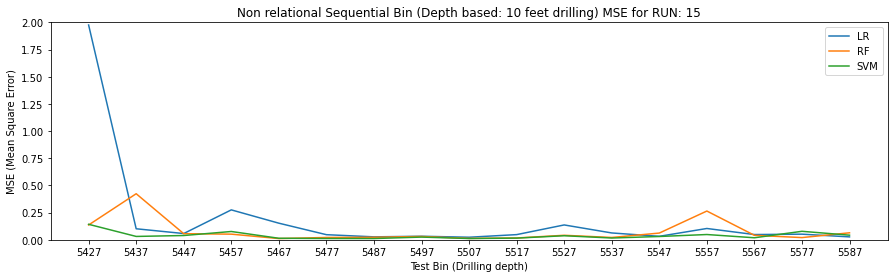

In [ ]:
import os

df_org = pd.read_csv(data_file, dtype={'Stand': int})
print(len(df_org))


features = ["ROP", "Torque", "Weight_on_Bit", "Run_Depth"]
target = "Accel"
models=["LR", "RF", "SVM"]

run = 15
output_file = "predicted_outputs.csv"
output_file = data_dir +'/' +'.'.join(os.path.split(data_file)[1].split('.')[:-1])+'_run_'+str(run)+'_'+output_file
print(output_file)
# settings="Non_relational_Bins_K_fold" means the model will test on first bin and train on the the rest of the bin. 
# This will continue until all the bins have been used a  test bin.

K_mses_bins_K_fold, ax, output_df = non_linear_relationship(settings="Non_relational_Bins_K_fold", df_data= df_org, run=run, features=features, 
                                             target=target, models = models, bin_size = 10, debug = 0, output_file=output_file)